# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

100% 255k/255k [00:00<00:00, 442kB/s]
100% 255k/255k [00:00<00:00, 442kB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

100% 66.1k/66.1k [00:00<00:00, 358kB/s]
100% 66.1k/66.1k [00:00<00:00, 357kB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.09G/1.09G [01:01<00:00, 21.9MB/s]
100% 1.09G/1.09G [01:01<00:00, 19.1MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 1.9 MB/s eta 0:00:00


In [ ]:
import torch

In [ ]:

import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ViTConfig, ViTModel, ViTFeatureExtractor
import tensorflow as tf

In [ ]:
pd.show_versions()

/usr/local/lib/python3.10/dist-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")



INSTALLED VERSIONS
------------------
commit           : 2e218d10984e9919f0296931d92ea851c6a6faf5
python           : 3.10.12.final.0
python-bits      : 64
OS               : Linux
OS-release       : 6.1.58+
Version          : #1 SMP PREEMPT_DYNAMIC Sat Nov 18 15:31:17 UTC 2023
machine          : x86_64
processor        : x86_64
byteorder        : little
LC_ALL           : en_US.UTF-8
LANG             : en_US.UTF-8
LOCALE           : en_US.UTF-8

pandas           : 1.5.3
numpy            : 1.25.2
pytz             : 2023.4
dateutil         : 2.8.2
setuptools       : 67.7.2
pip              : 23.1.2
Cython           : 3.0.9
pytest           : 7.4.4
hypothesis       : None
sphinx           : 5.0.2
blosc            : None
feather          : None
xlsxwriter       : None
lxml.etree       : 4.9.4
html5lib         : 1.1
pymysql          : None
psycopg2         : 2.9.9
jinja2           : 3.1.3
IPython          : 7.34.0
pandas_datareader: 0.10.0
bs4              : 4.12.3
bottleneck       : None


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 33.7 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
! pip install torchsummary

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
pip install scipy

In [ ]:
from scipy.stats import spearmanr
import time

# Preprocess & Split

In [ ]:
df_landscape = pd.read_csv("/content/landscape.csv")
df_landscape["image_file"] =df_landscape["image_file"].apply(lambda file: "/content/landscape" +"/"+ file) # Create image path
df_landscape["memorability_wo_fa_correction"] = df_landscape["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_landscape.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,4001,/content/landscape/00da7332b7397d6f.jpg,landscape,badlands,342.0,455.0,open images,Badlands,0.111134,67,16,116,0.577586,0.439655
1,4002,/content/landscape/059749eaad9544d9.jpg,landscape,badlands,303.0,404.0,open images,Badlands,0.123819,47,10,103,0.456311,0.359223
2,4003,/content/landscape/0a41e7b2e1f24787.jpg,landscape,badlands,259.0,346.0,open images,Badlands,0.135316,55,11,108,0.509259,0.407407
3,4004,/content/landscape/0bdbfdfbf9606d17.jpg,landscape,badlands,449.0,673.0,open images,Badlands,0.129940,75,1,95,0.789474,0.778947
4,4005,/content/landscape/0c25ec21ea3806e6.jpg,landscape,badlands,389.0,519.0,open images,Badlands,0.200469,71,2,90,0.788889,0.766667


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 117.6827192416029
Standard deviation of pixel values: 66.35625502037836


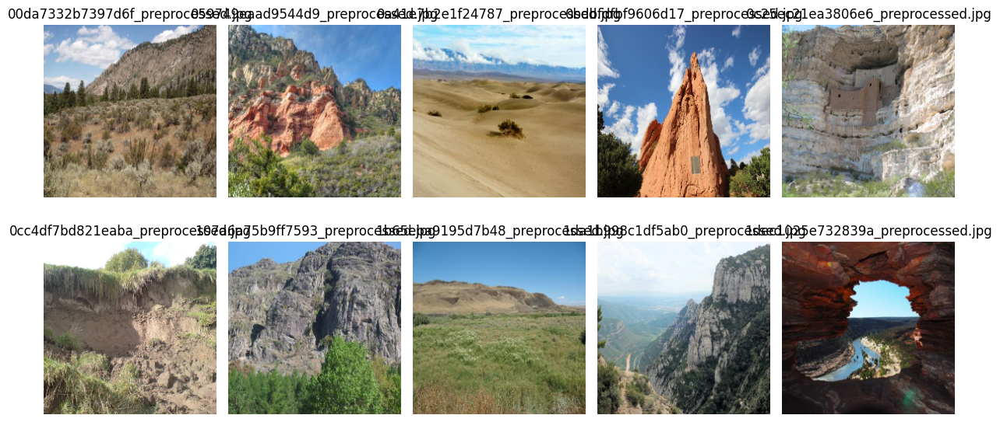

In [ ]:
# Sample data (replace this with your DataFrame)
df_landscape = pd.DataFrame({
    'image_file': df_landscape["image_file"],
    'memoscore': df_landscape["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_landscape['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_landscape.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_landscape.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_landscape.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_landscape.head()

,image_file,memoscore,preprocessed_image_path
0,/content/landscape/00da7332b7397d6f.jpg,0.577586,/content/landscape/00da7332b7397d6f_preprocess...
1,/content/landscape/059749eaad9544d9.jpg,0.456311,/content/landscape/059749eaad9544d9_preprocess...
2,/content/landscape/0a41e7b2e1f24787.jpg,0.509259,/content/landscape/0a41e7b2e1f24787_preprocess...
3,/content/landscape/0bdbfdfbf9606d17.jpg,0.789474,/content/landscape/0bdbfdfbf9606d17_preprocess...
4,/content/landscape/0c25ec21ea3806e6.jpg,0.788889,/content/landscape/0c25ec21ea3806e6_preprocess...


In [ ]:
del df_landscape["image_file"]

In [ ]:
df_landscape.head()

,memoscore,preprocessed_image_path
0,0.577586,/content/landscape/00da7332b7397d6f_preprocess...
1,0.456311,/content/landscape/059749eaad9544d9_preprocess...
2,0.509259,/content/landscape/0a41e7b2e1f24787_preprocess...
3,0.789474,/content/landscape/0bdbfdfbf9606d17_preprocess...
4,0.788889,/content/landscape/0c25ec21ea3806e6_preprocess...


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_landscape.drop('memoscore', axis=1)), pd.DataFrame(df_landscape['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
419,/content/landscape/sun_aanjgkilxhsgjsyw_prepro...
1409,/content/landscape/n09376198_21260_preprocesse...
340,/content/landscape/sun_augiwpnmzxrwivst_prepro...
47,/content/landscape/d5a7faf3171bfdaa_preprocess...
737,/content/landscape/n09308572_1178_preprocessed...


In [ ]:
merged_train_landscape= pd.concat([X_train, y_train], axis=1)
merged_train_landscape

,preprocessed_image_path,memoscore
419,/content/landscape/sun_aanjgkilxhsgjsyw_prepro...,0.628571
1409,/content/landscape/n09376198_21260_preprocesse...,0.644231
340,/content/landscape/sun_augiwpnmzxrwivst_prepro...,0.552083
47,/content/landscape/d5a7faf3171bfdaa_preprocess...,0.556818
737,/content/landscape/n09308572_1178_preprocessed...,0.639535
...,...,...
1916,/content/landscape/6679fa5f2762ade8_preprocess...,0.627451
467,/content/landscape/sun_adkwweprgeumpslv_prepro...,0.556701
665,/content/landscape/n09288635_3879_preprocessed...,0.797980
230,/content/landscape/dd97cf9ce8a82992_preprocess...,0.610000


In [ ]:
merged_val_landscape = pd.concat([X_val, y_val], axis=1)
merged_val_landscape

,preprocessed_image_path,memoscore
206,/content/landscape/641cb302c6e9b8a1_preprocess...,0.723404
1096,/content/landscape/n07801091_66989_preprocesse...,0.342857
1264,/content/landscape/n09415671_2335_preprocessed...,0.455446
31,/content/landscape/a0c9618ba54fff18_preprocess...,0.793814
451,/content/landscape/cd55c673f7709018_preprocess...,0.633663
...,...,...
1755,/content/landscape/n09472597_39958_preprocesse...,0.421053
71,/content/landscape/sun_antdfwhuefttipaf_prepro...,0.810526
1516,/content/landscape/n09428293_2560_preprocessed...,0.716049
2,/content/landscape/0a41e7b2e1f24787_preprocess...,0.509259


In [ ]:
merged_test_landscape = pd.concat([X_test, y_test], axis=1)
merged_test_landscape

,preprocessed_image_path,memoscore
1928,/content/landscape/80463d4656037235_preprocess...,0.426087
1730,/content/landscape/n09472597_23273_preprocesse...,0.677778
1681,/content/landscape/n09468604_58896_preprocesse...,0.421569
21,/content/landscape/75a33eb7832e35bf_preprocess...,0.531532
823,/content/landscape/b787fb20a8bfdabf_preprocess...,0.452830
...,...,...
1688,/content/landscape/n09468604_7588_preprocessed...,0.584906
1129,/content/landscape/0a13e0401b30a8ab_preprocess...,0.471154
739,/content/landscape/n09308572_13624_preprocesse...,0.800000
629,/content/landscape/n09288635_13593_preprocesse...,0.708738


# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_landscape= '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/landscape_Vit.csv'
merged_train_landscape.to_csv(csv_train_landscape, index=False)

In [ ]:
csv_val_landscape = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/landscape_Vit.csv'
merged_val_landscape.to_csv(csv_val_landscape, index=False)

In [ ]:
csv_test_landscape = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/landscape_Vit.csv'
merged_test_landscape.to_csv(csv_test_landscape, index=False)

#Load Dataset

In [ ]:
df_train_landscape = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/landscape_Vit.csv")
df_val_landscape = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/landscape_Vit.csv')
df_test_landscape = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/landscape_Vit.csv')

In [ ]:
df_train_landscape.head()

,preprocessed_image_path,memoscore
0,/content/landscape/sun_axhrgmuqrljrfnpd_prepro...,0.433962
1,/content/landscape/sun_agqnaqaigkgpfvia_prepro...,0.429907
2,/content/landscape/n09289331_6504_preprocessed...,0.714286
3,/content/landscape/sun_aayounnakjpewywf_prepro...,0.567797
4,/content/landscape/n09270735_44665_preprocesse...,0.548387


In [ ]:
df_train_landscape.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_landscape["memoscore"]
        self.images = df_train_landscape["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds = Dataset(df_train_landscape, trans_transform=trans_transform)
train_dl = DataLoader(train_ds, batch_size=32, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


'for image_trans, label in train_dl:\n    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch\n    print(image_trans)\n    break'

In [ ]:
class ViTMem_model_train(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit =  ViTMem_model_train( arch="vit_base_patch16_224_miil")



model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

In [ ]:
# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_train().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)




----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model_vit  = to_device(model_vit  , device)

In [ ]:
params = [param for param in list(model_vit.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)





 Epoch: (1/50) Loss = 0.17080648243427277

 Epoch: (1/50) Loss_rmse = 0.4132874011993408

 Epoch: (1/50) R^2 = -6.317294120788574

 Epoch: (1/50) MAE = 0.384007066488266
Spearman correlation coefficient: SignificanceResult(statistic=0.025735944962385706, pvalue=0.2762091360463662)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.53260

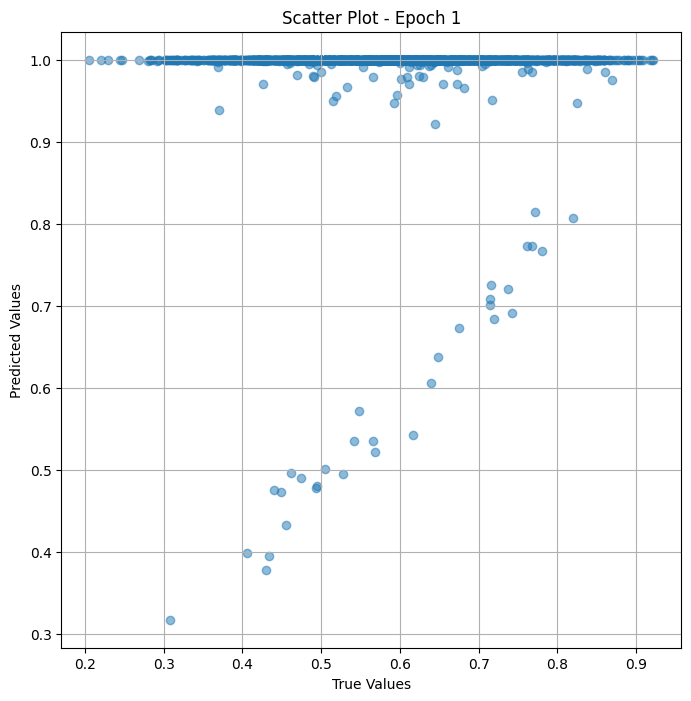

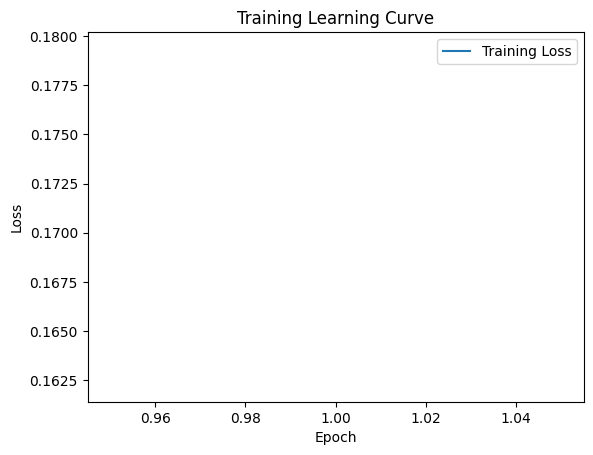


 Epoch: (2/50) Loss = 0.023574505001306534

 Epoch: (2/50) Loss_rmse = 0.15353991091251373

 Epoch: (2/50) R^2 = -0.009924173355102539

 Epoch: (2/50) MAE = 0.11447033286094666
Spearman correlation coefficient: SignificanceResult(statistic=0.05235495984106787, pvalue=0.02667337189756007)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 

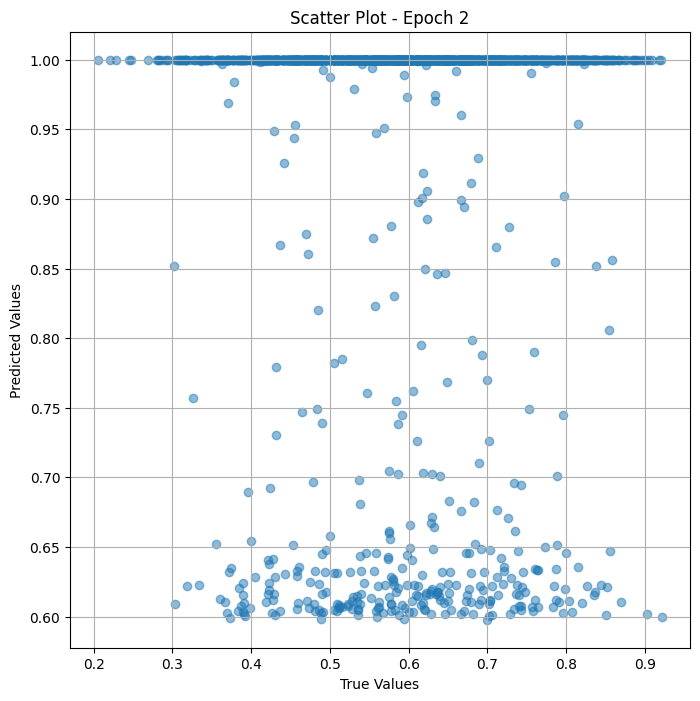

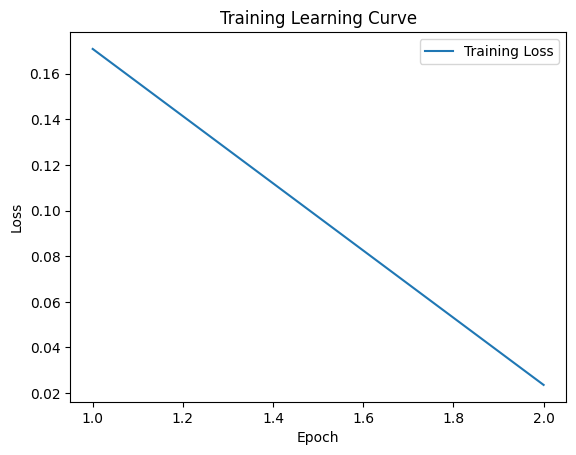


 Epoch: (3/50) Loss = 0.023499494418501854

 Epoch: (3/50) Loss_rmse = 0.15329544246196747

 Epoch: (3/50) R^2 = -0.006710648536682129

 Epoch: (3/50) MAE = 0.11485804617404938
Spearman correlation coefficient: SignificanceResult(statistic=0.004053718092044446, pvalue=0.8638439608819364)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 

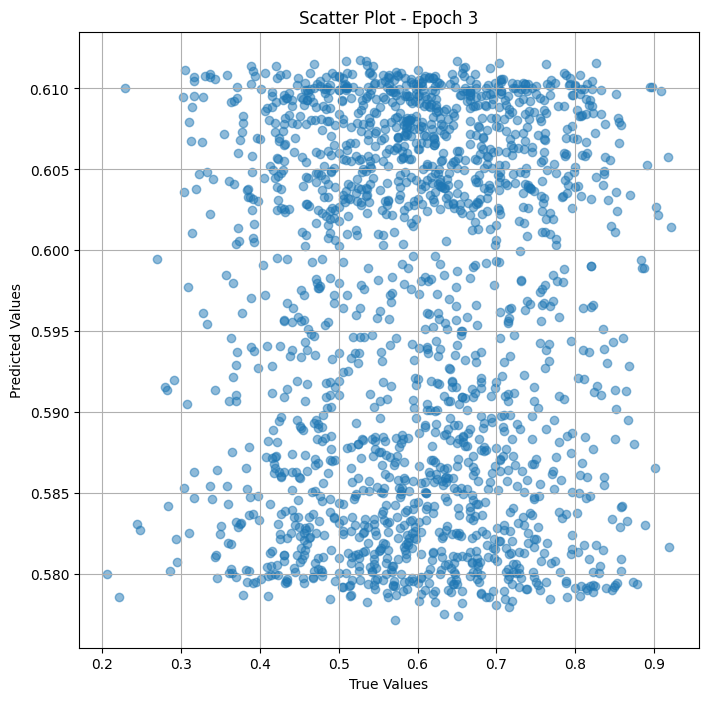

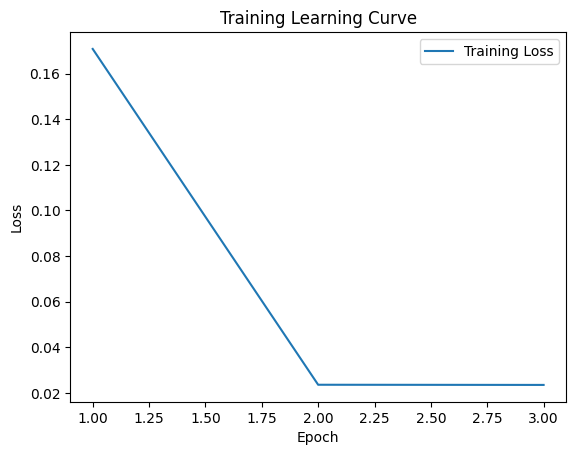


 Epoch: (4/50) Loss = 0.02346428856253624

 Epoch: (4/50) Loss_rmse = 0.1531805694103241

 Epoch: (4/50) R^2 = -0.005202531814575195

 Epoch: (4/50) MAE = 0.11453975737094879
Spearman correlation coefficient: SignificanceResult(statistic=0.01143870681341894, pvalue=0.6284557537747121)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5

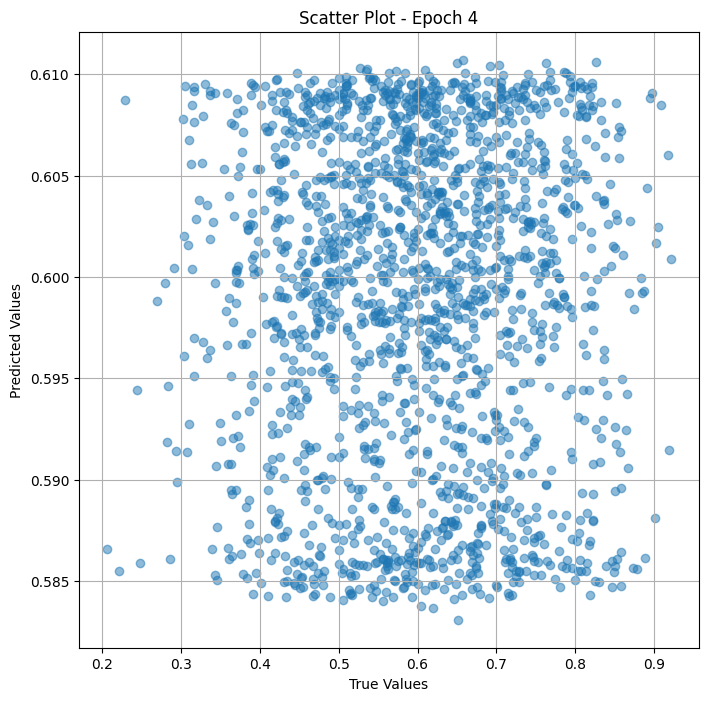

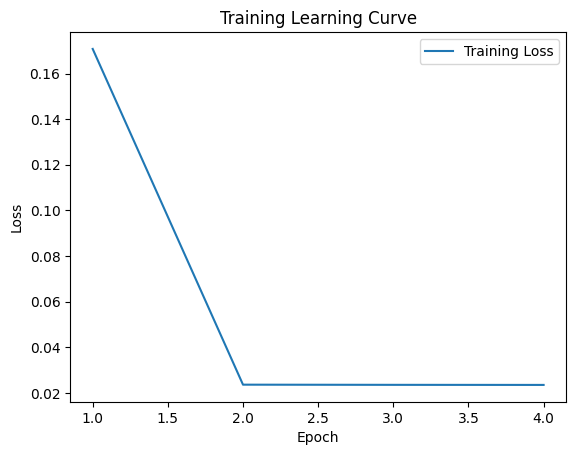


 Epoch: (5/50) Loss = 0.023424629122018814

 Epoch: (5/50) Loss_rmse = 0.15305106341838837

 Epoch: (5/50) R^2 = -0.00350344181060791

 Epoch: (5/50) MAE = 0.11408770084381104
Spearman correlation coefficient: SignificanceResult(statistic=0.03723221798363221, pvalue=0.11512688517081052)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0

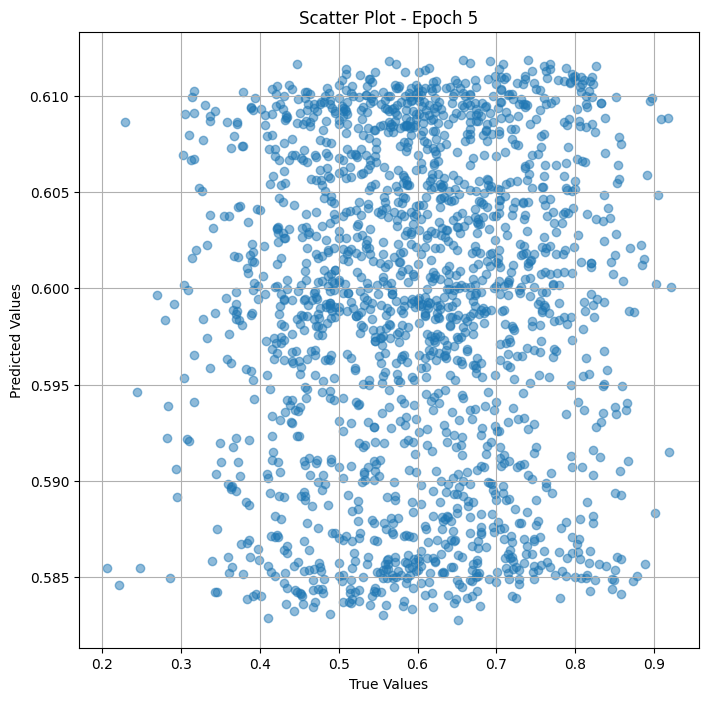

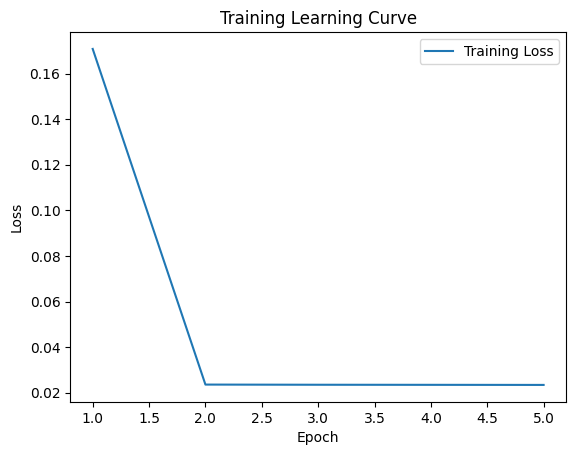


 Epoch: (6/50) Loss = 0.02335475943982601

 Epoch: (6/50) Loss_rmse = 0.15282264351844788

 Epoch: (6/50) R^2 = -0.0005103349685668945

 Epoch: (6/50) MAE = 0.11351773142814636
Spearman correlation coefficient: SignificanceResult(statistic=0.062394282990812476, pvalue=0.008241622908836807)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093

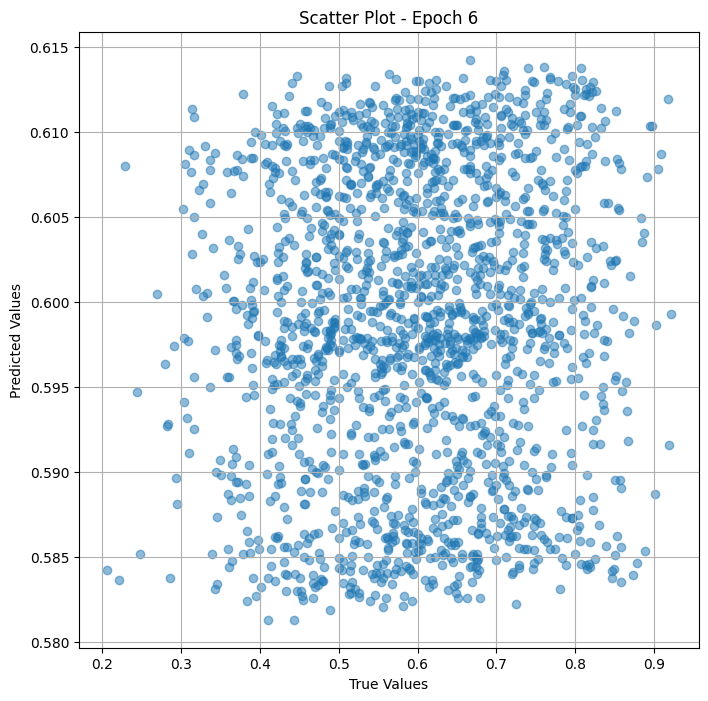

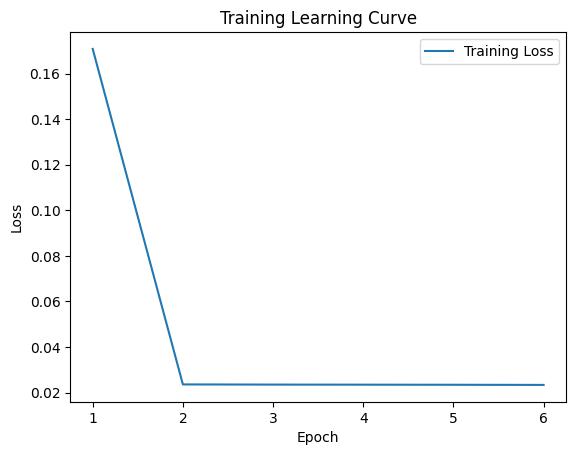


 Epoch: (7/50) Loss = 0.023201575502753258

 Epoch: (7/50) Loss_rmse = 0.15232063829898834

 Epoch: (7/50) R^2 = 0.006052076816558838

 Epoch: (7/50) MAE = 0.11262950301170349
Spearman correlation coefficient: SignificanceResult(statistic=0.09575100183467099, pvalue=4.910720119966576e-05)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093,

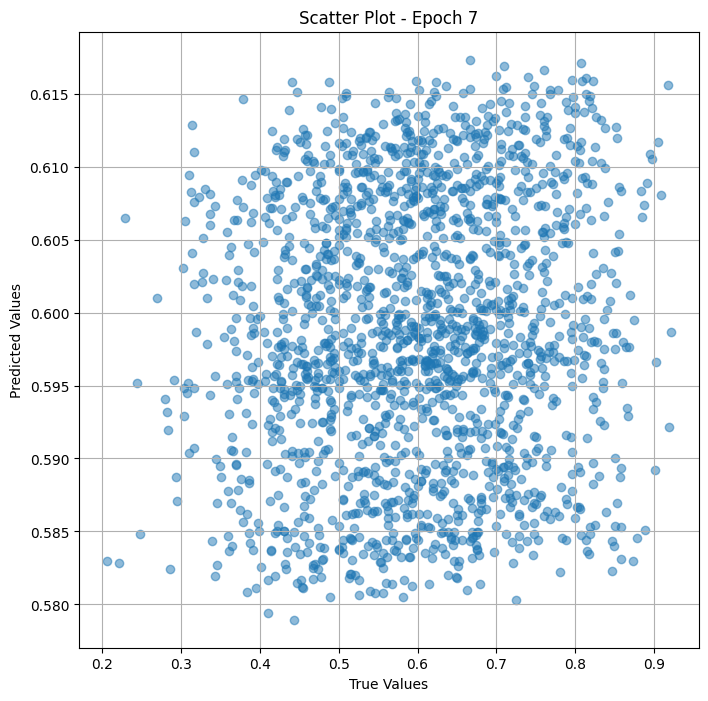

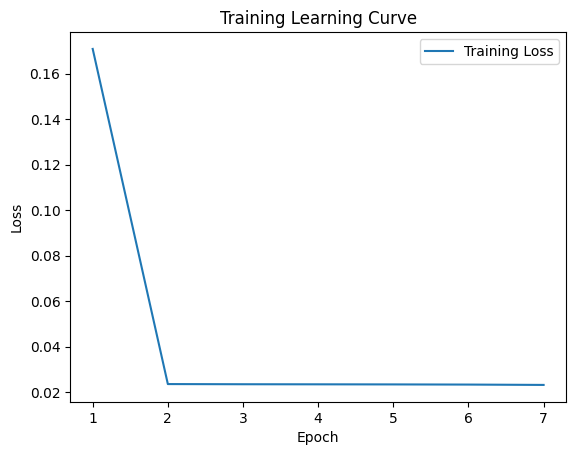


 Epoch: (8/50) Loss = 0.02273488976061344

 Epoch: (8/50) Loss_rmse = 0.15078093111515045

 Epoch: (8/50) R^2 = 0.026044726371765137

 Epoch: (8/50) MAE = 0.11068658530712128
Spearman correlation coefficient: SignificanceResult(statistic=0.15300866837708052, pvalue=7.464202891131748e-11)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 

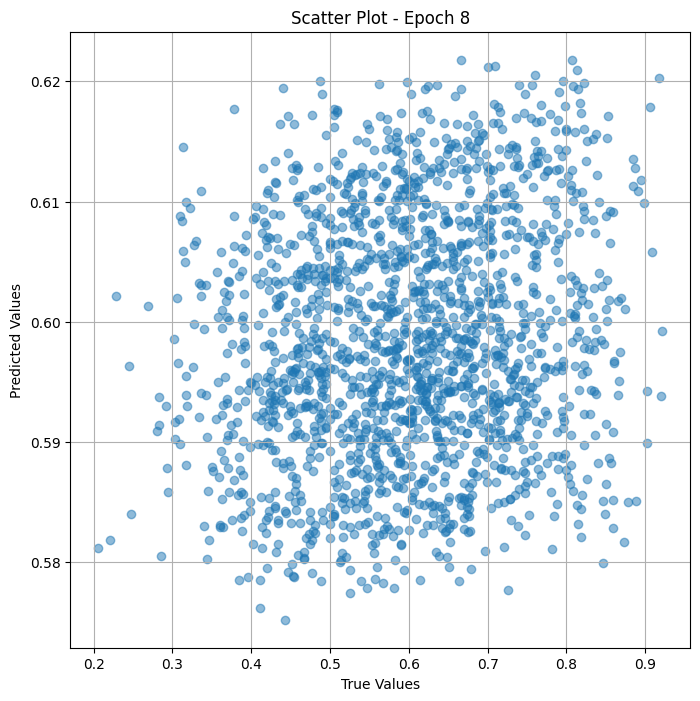

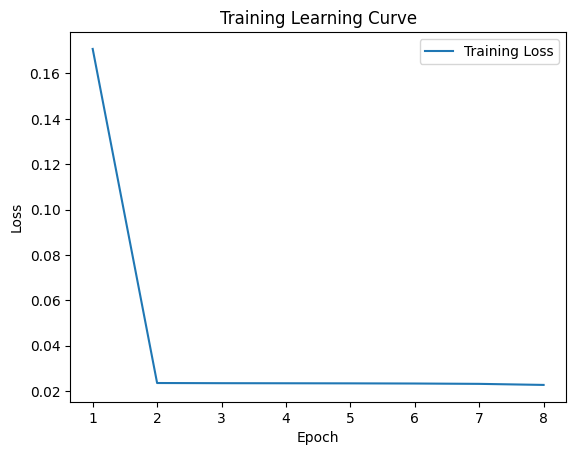


 Epoch: (9/50) Loss = 0.020822040736675262

 Epoch: (9/50) Loss_rmse = 0.14429844915866852

 Epoch: (9/50) R^2 = 0.107990562915802

 Epoch: (9/50) MAE = 0.10500714182853699
Spearman correlation coefficient: SignificanceResult(statistic=0.2770594409601635, pvalue=6.106273761159566e-33)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5

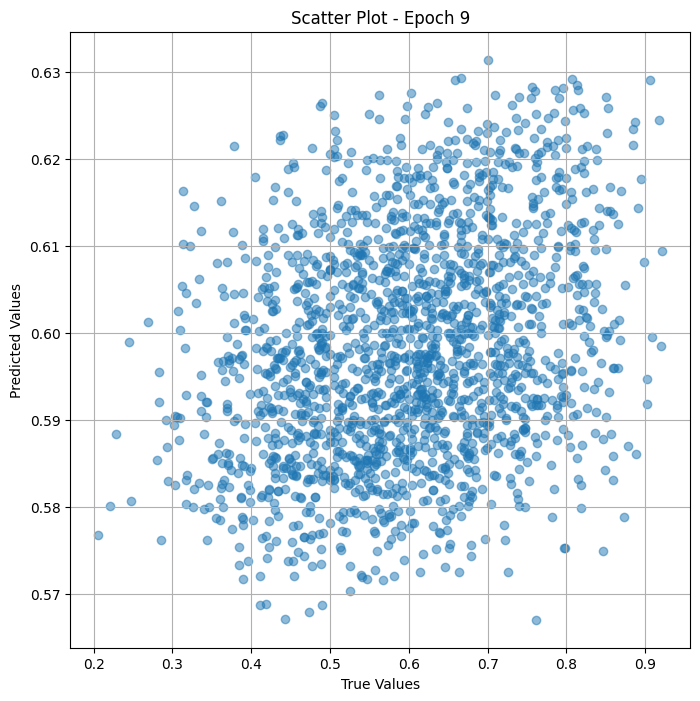

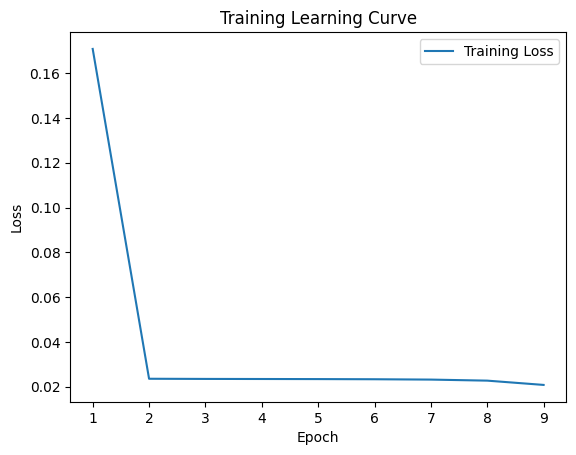


 Epoch: (10/50) Loss = 0.018127936869859695

 Epoch: (10/50) Loss_rmse = 0.13464002311229706

 Epoch: (10/50) R^2 = 0.22340506315231323

 Epoch: (10/50) MAE = 0.10171318054199219
Spearman correlation coefficient: SignificanceResult(statistic=0.4006695083329087, pvalue=4.500298663829873e-70)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.837209

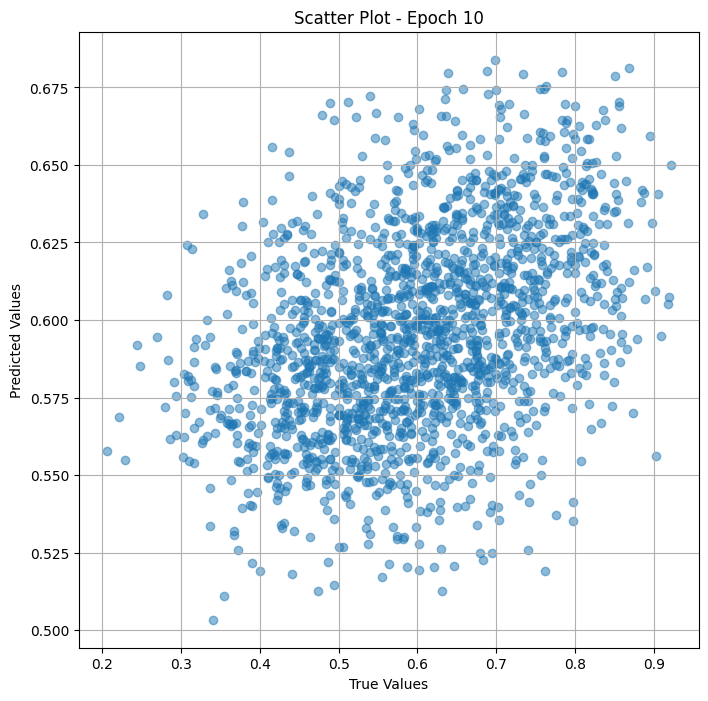

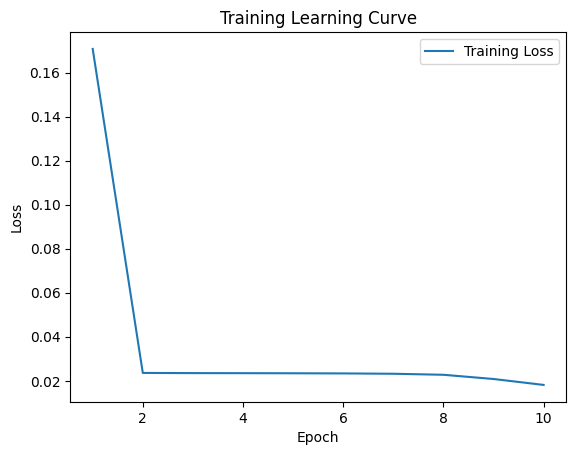


 Epoch: (11/50) Loss = 0.01122351922094822

 Epoch: (11/50) Loss_rmse = 0.10594110935926437

 Epoch: (11/50) R^2 = 0.5191880464553833

 Epoch: (11/50) MAE = 0.07428653538227081
Spearman correlation coefficient: SignificanceResult(statistic=0.44630261268851423, pvalue=1.930530918739159e-88)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093

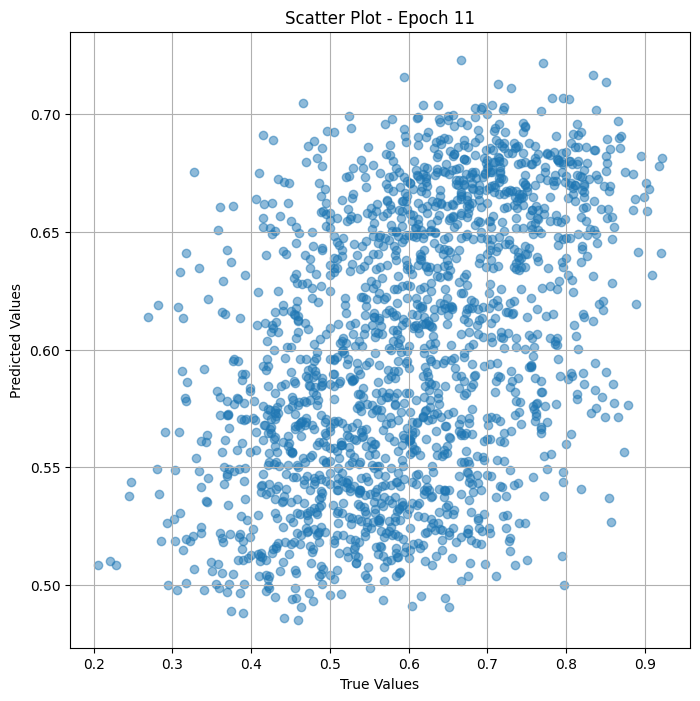

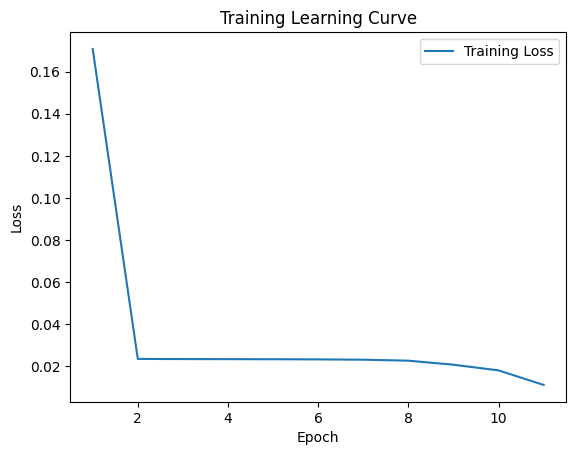


 Epoch: (12/50) Loss = 0.021186817437410355

 Epoch: (12/50) Loss_rmse = 0.14555692672729492

 Epoch: (12/50) R^2 = 0.09236365556716919

 Epoch: (12/50) MAE = 0.11012628674507141
Spearman correlation coefficient: SignificanceResult(statistic=0.48017473956925794, pvalue=5.196704804467302e-104)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372

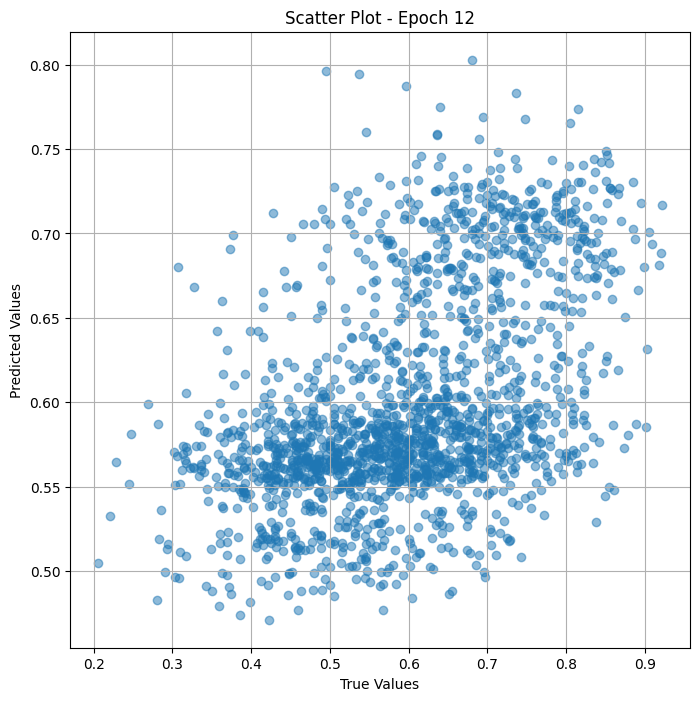

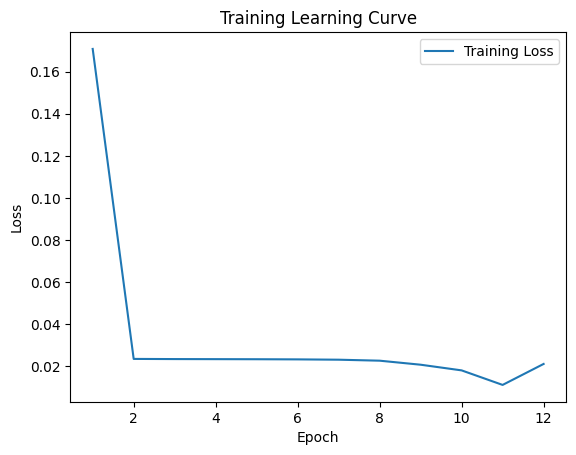


 Epoch: (13/50) Loss = 0.009160771034657955

 Epoch: (13/50) Loss_rmse = 0.09571191668510437

 Epoch: (13/50) R^2 = 0.6075555086135864

 Epoch: (13/50) MAE = 0.07092711329460144
Spearman correlation coefficient: SignificanceResult(statistic=0.5252311491220232, pvalue=1.2344527181950382e-127)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.83720

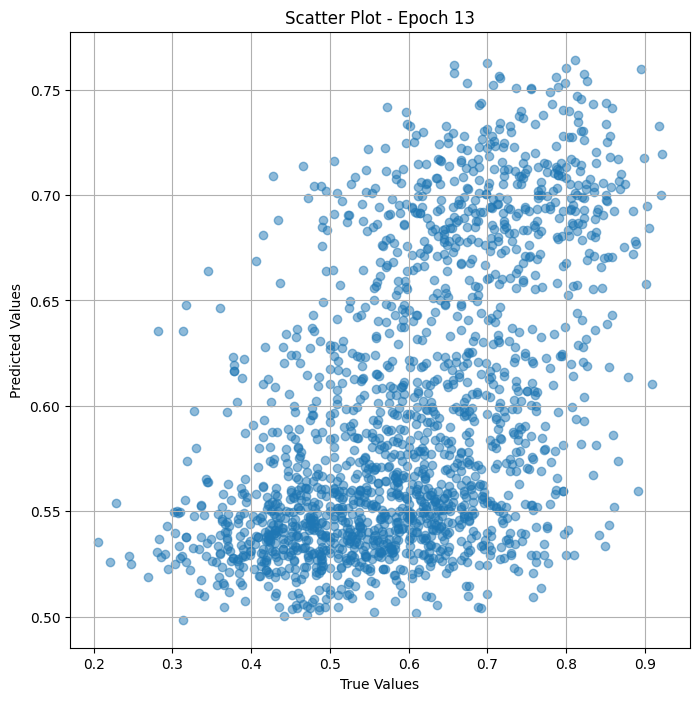

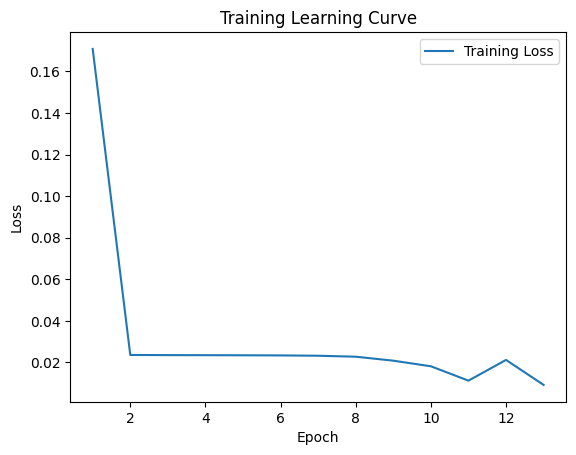


 Epoch: (14/50) Loss = 0.005371286999434233

 Epoch: (14/50) Loss_rmse = 0.07328906655311584

 Epoch: (14/50) R^2 = 0.7698957920074463

 Epoch: (14/50) MAE = 0.06360095739364624
Spearman correlation coefficient: SignificanceResult(statistic=0.5933231858793161, pvalue=6.948802586110034e-171)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.837209

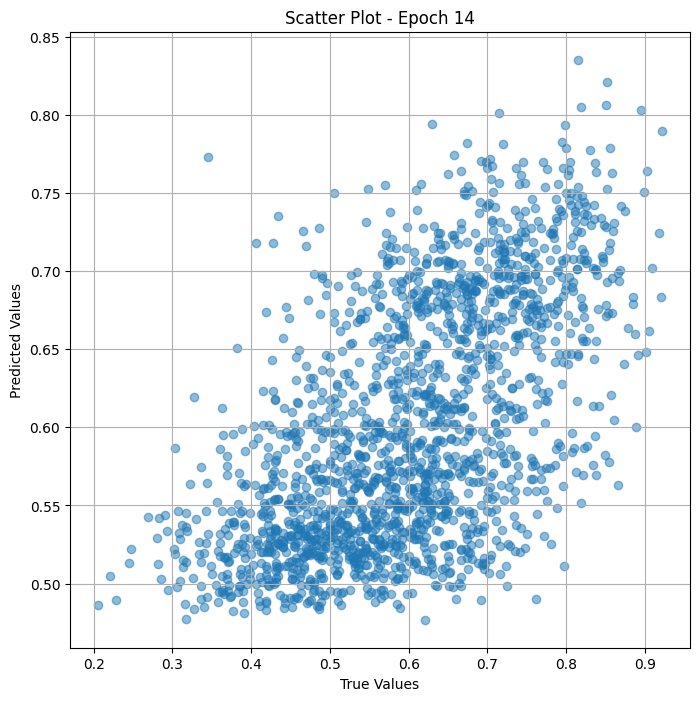

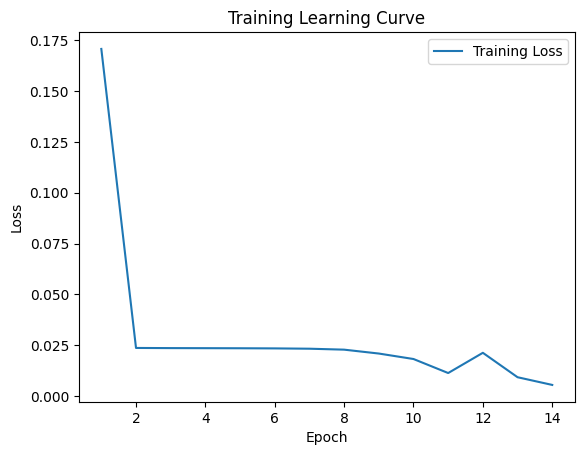


 Epoch: (15/50) Loss = 0.0028148910496383905

 Epoch: (15/50) Loss_rmse = 0.053055547177791595

 Epoch: (15/50) R^2 = 0.879410982131958

 Epoch: (15/50) MAE = 0.04637104645371437
Spearman correlation coefficient: SignificanceResult(statistic=0.6663050734767136, pvalue=2.087682665977423e-230)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.83720

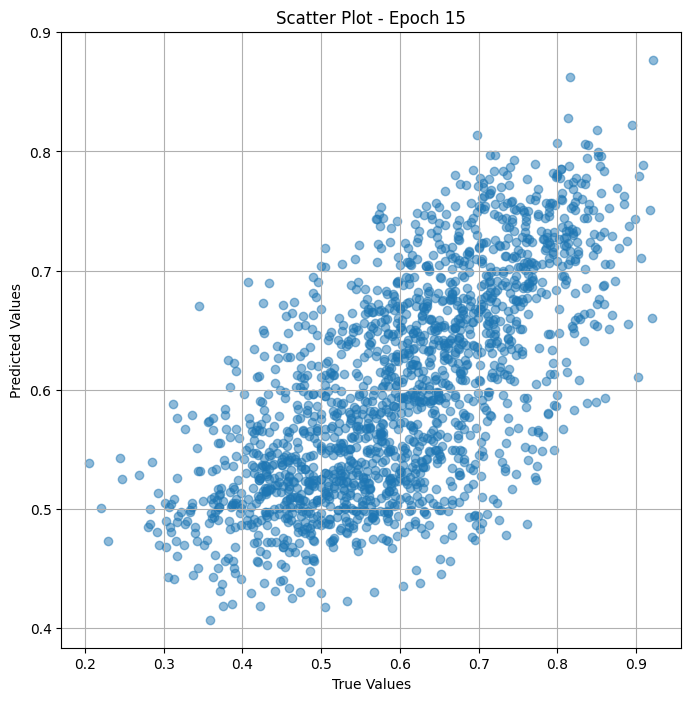

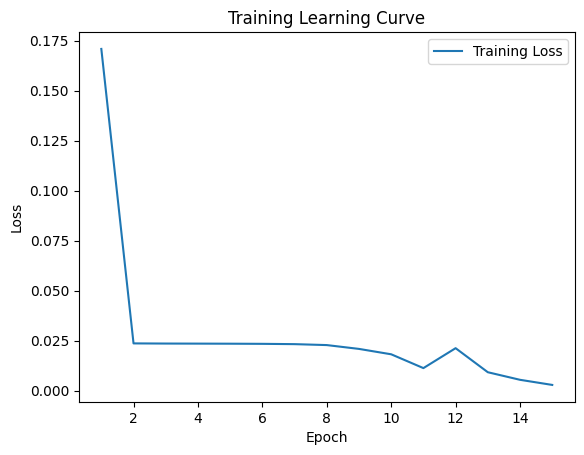


 Epoch: (16/50) Loss = 0.001536024734377861

 Epoch: (16/50) Loss_rmse = 0.03919215127825737

 Epoch: (16/50) R^2 = 0.934197187423706

 Epoch: (16/50) MAE = 0.03139061480760574
Spearman correlation coefficient: SignificanceResult(statistic=0.769345282436505, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.51546

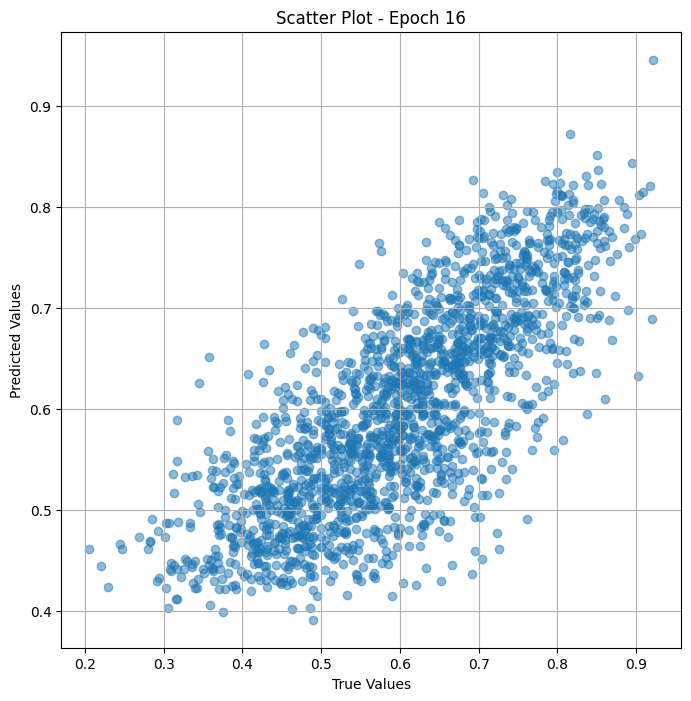

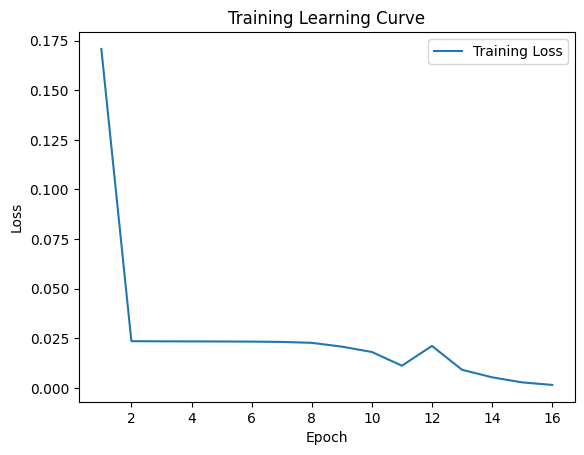


 Epoch: (17/50) Loss = 0.0011660961899906397

 Epoch: (17/50) Loss_rmse = 0.03414814919233322

 Epoch: (17/50) R^2 = 0.9500448107719421

 Epoch: (17/50) MAE = 0.03177986666560173
Spearman correlation coefficient: SignificanceResult(statistic=0.8514794418907483, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.51

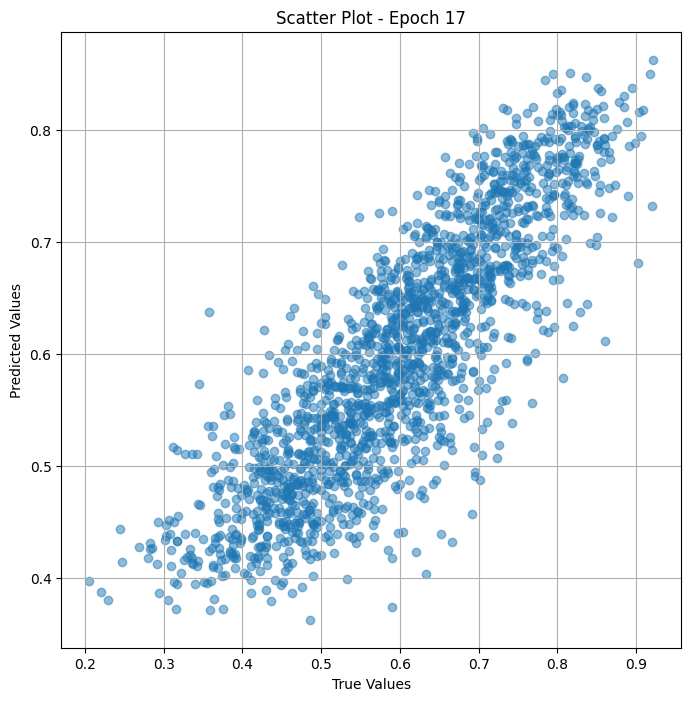

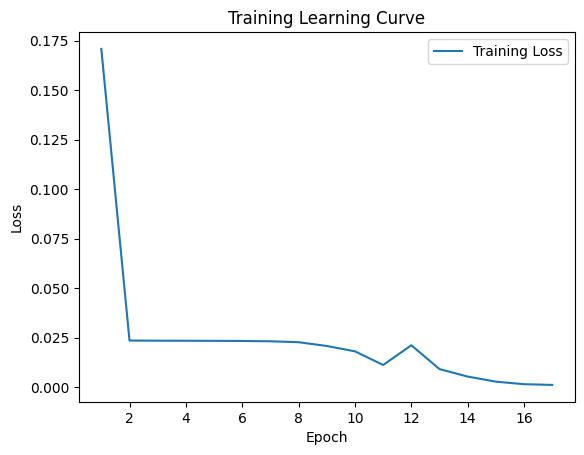


 Epoch: (18/50) Loss = 0.0005359979695640504

 Epoch: (18/50) Loss_rmse = 0.02315163053572178

 Epoch: (18/50) R^2 = 0.9770380258560181

 Epoch: (18/50) MAE = 0.021110717207193375
Spearman correlation coefficient: SignificanceResult(statistic=0.9003687520401502, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

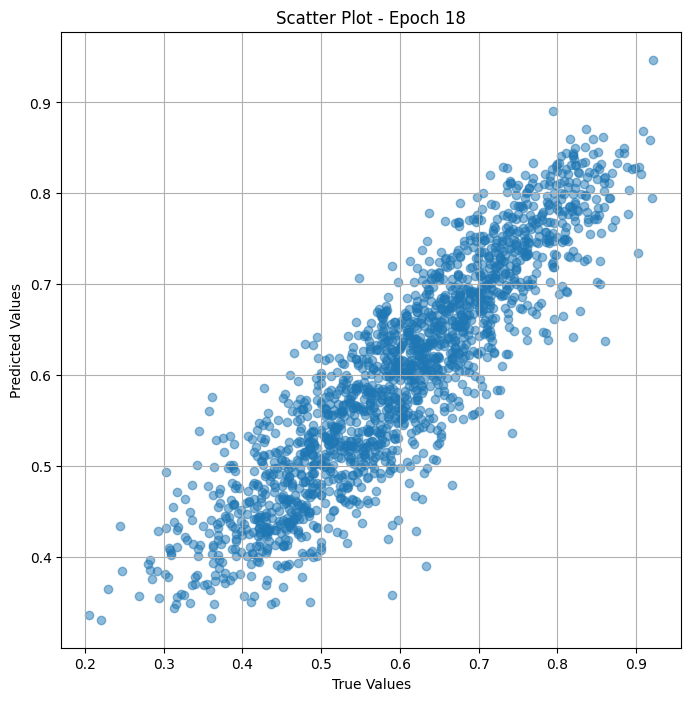

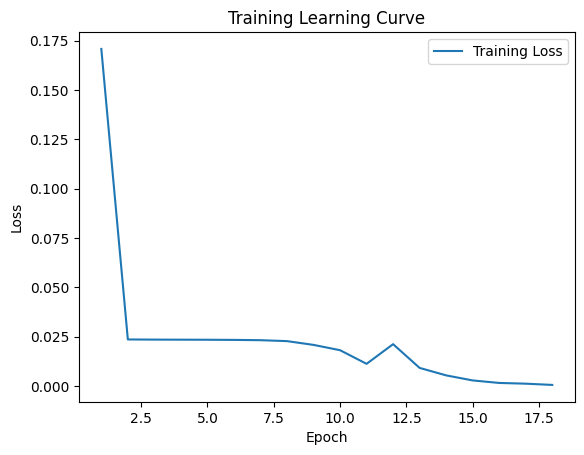


 Epoch: (19/50) Loss = 0.012948031537234783

 Epoch: (19/50) Loss_rmse = 0.11378941684961319

 Epoch: (19/50) R^2 = 0.4453105330467224

 Epoch: (19/50) MAE = 0.09463797509670258
Spearman correlation coefficient: SignificanceResult(statistic=0.8376244987143412, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.515

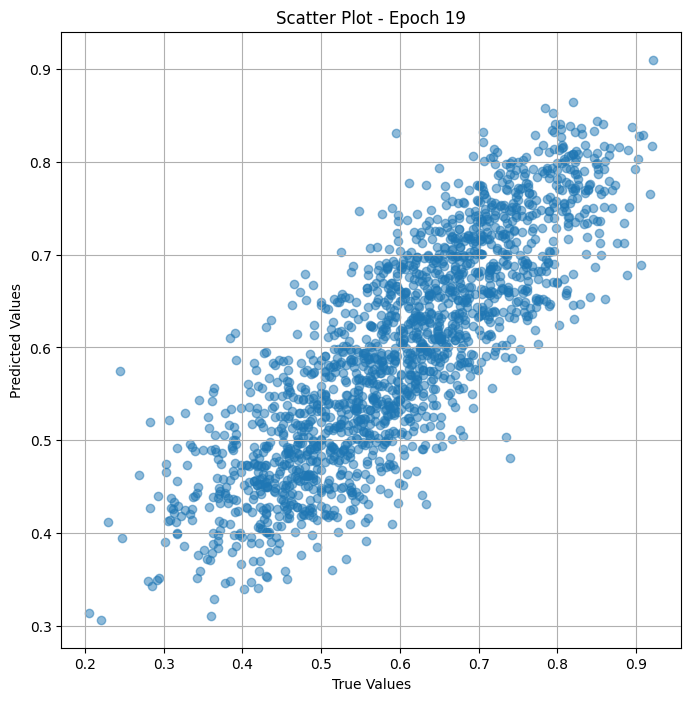

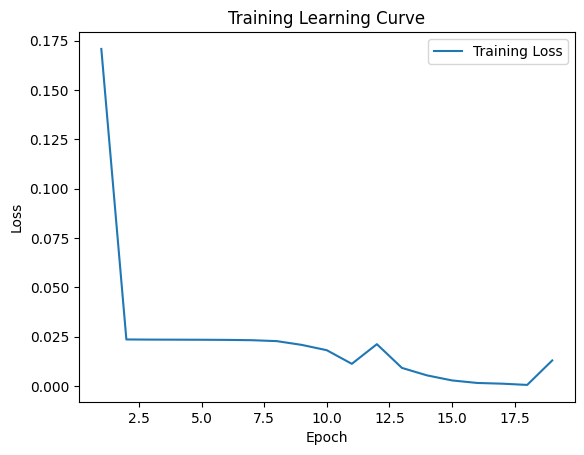


 Epoch: (20/50) Loss = 0.0020640897564589977

 Epoch: (20/50) Loss_rmse = 0.045432254672050476

 Epoch: (20/50) R^2 = 0.9115750789642334

 Epoch: (20/50) MAE = 0.037867993116378784
Spearman correlation coefficient: SignificanceResult(statistic=0.7887812465527207, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

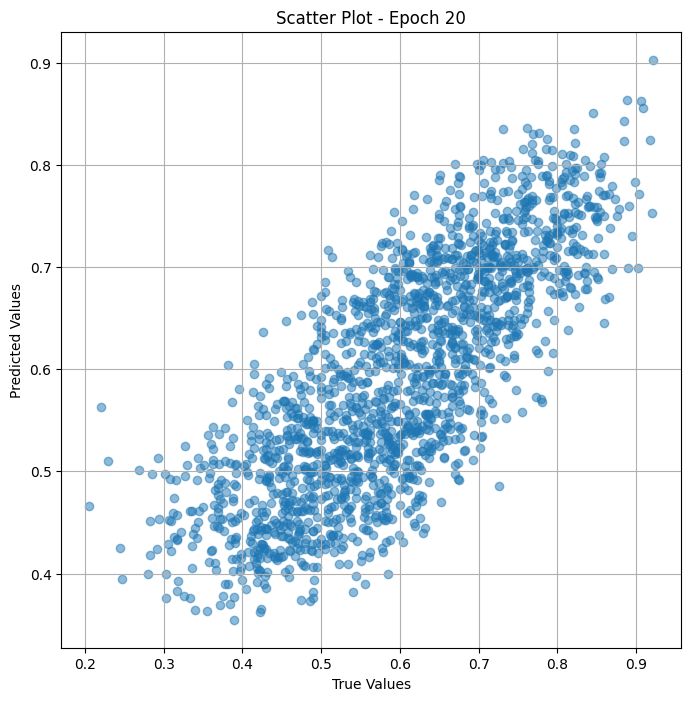

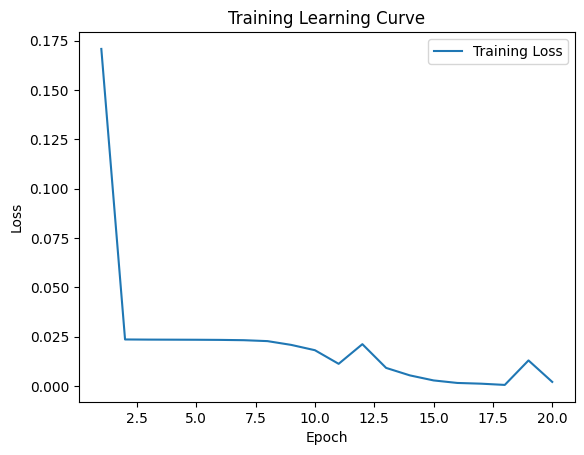

Epoch 0.05: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (21/50) Loss = 0.002252677921205759

 Epoch: (21/50) Loss_rmse = 0.04746238514780998

 Epoch: (21/50) R^2 = 0.9034960269927979

 Epoch: (21/50) MAE = 0.044065359979867935
Spearman correlation coefficient: SignificanceResult(statistic=0.9028556039503478, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60

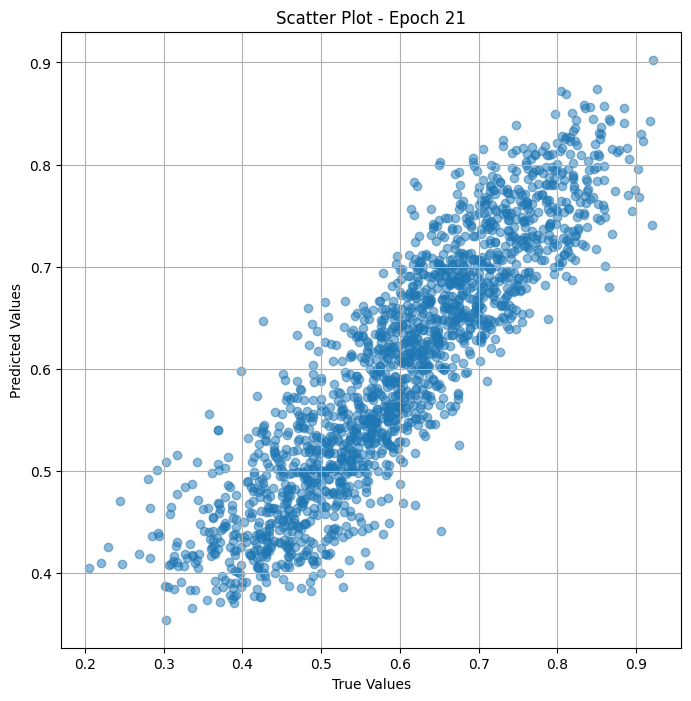

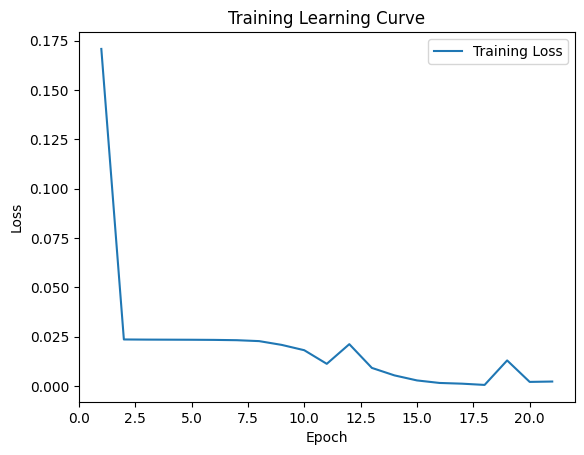


 Epoch: (22/50) Loss = 0.0016650429461151361

 Epoch: (22/50) Loss_rmse = 0.04080493748188019

 Epoch: (22/50) R^2 = 0.9286701083183289

 Epoch: (22/50) MAE = 0.035765476524829865
Spearman correlation coefficient: SignificanceResult(statistic=0.9525527827162829, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

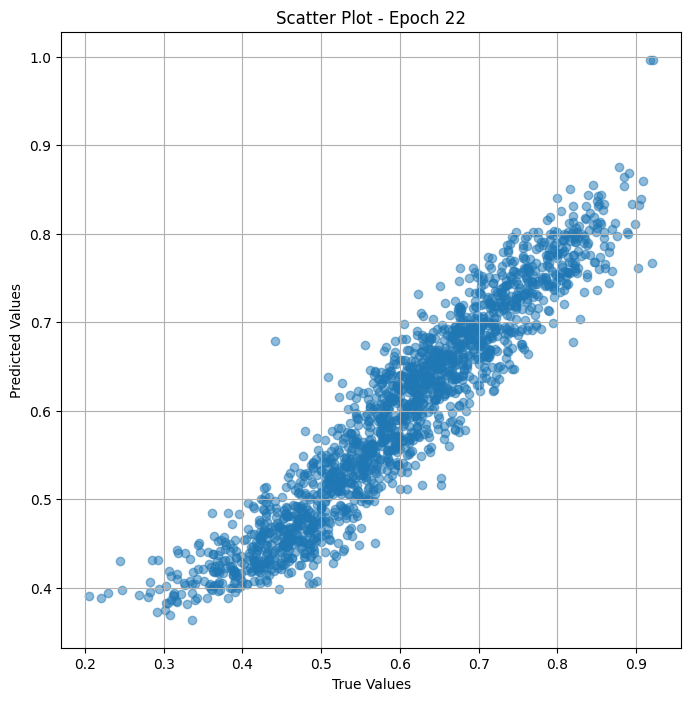

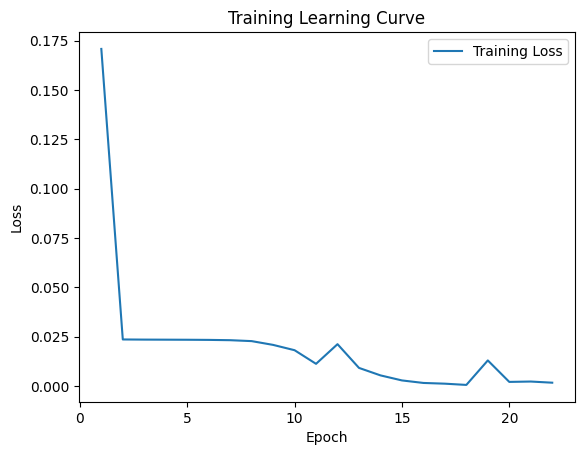


 Epoch: (23/50) Loss = 0.0010482494253665209

 Epoch: (23/50) Loss_rmse = 0.03237668052315712

 Epoch: (23/50) R^2 = 0.9550933241844177

 Epoch: (23/50) MAE = 0.028747007250785828
Spearman correlation coefficient: SignificanceResult(statistic=0.9634989753490465, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

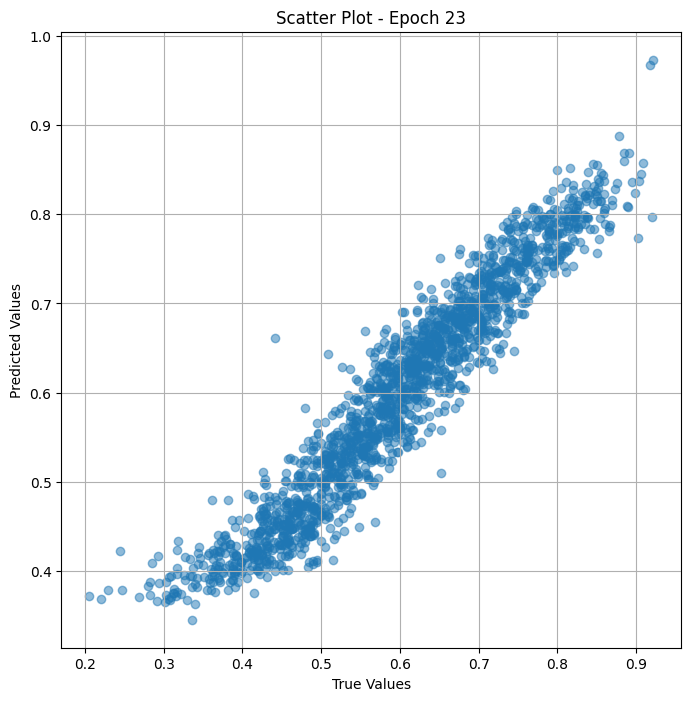

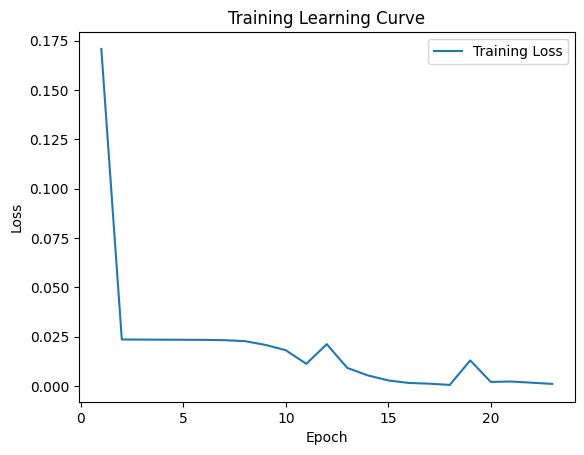

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (24/50) Loss = 0.0006241830997169018

 Epoch: (24/50) Loss_rmse = 0.024983657523989677

 Epoch: (24/50) R^2 = 0.973260223865509

 Epoch: (24/50) MAE = 0.021900683641433716
Spearman correlation coefficient: SignificanceResult(statistic=0.9685224979930522, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.6

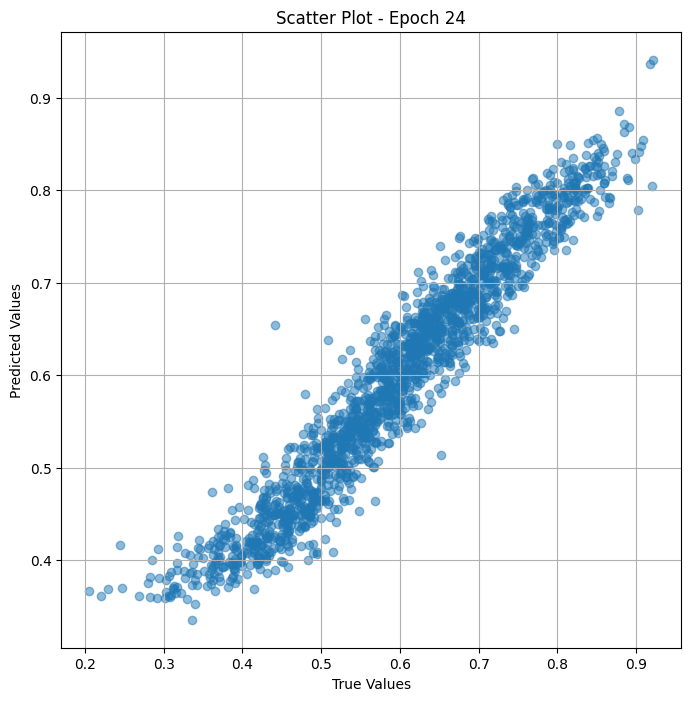

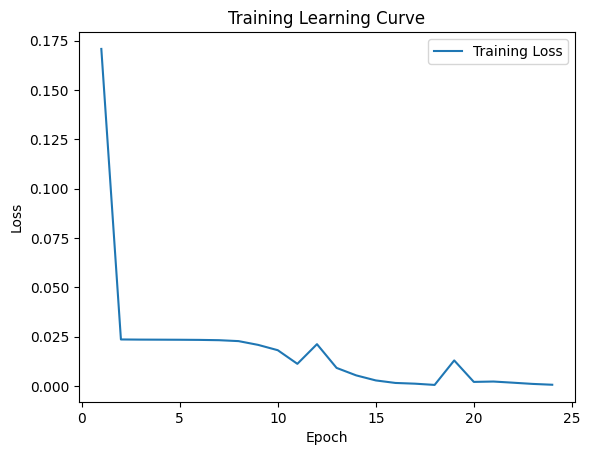


 Epoch: (25/50) Loss = 0.0005814231699332595

 Epoch: (25/50) Loss_rmse = 0.024112718179821968

 Epoch: (25/50) R^2 = 0.9750919938087463

 Epoch: (25/50) MAE = 0.020325258374214172
Spearman correlation coefficient: SignificanceResult(statistic=0.9739049463840093, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

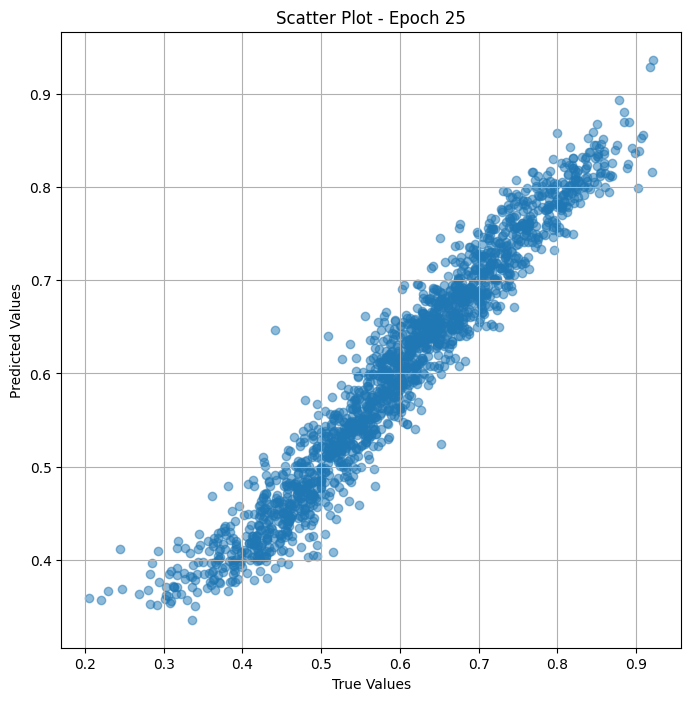

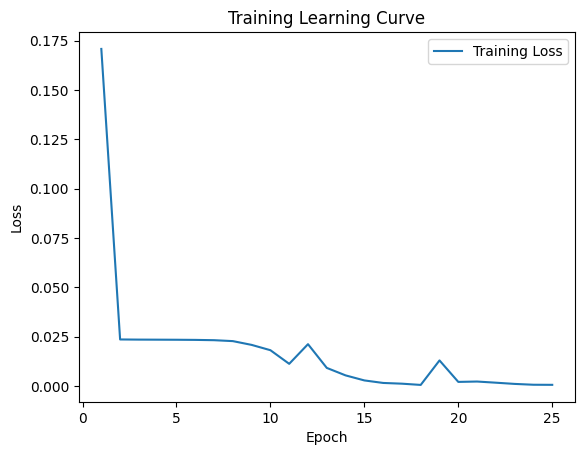


 Epoch: (26/50) Loss = 0.0005730633274652064

 Epoch: (26/50) Loss_rmse = 0.02393874153494835

 Epoch: (26/50) R^2 = 0.9754501581192017

 Epoch: (26/50) MAE = 0.019875474274158478
Spearman correlation coefficient: SignificanceResult(statistic=0.9743409171196229, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

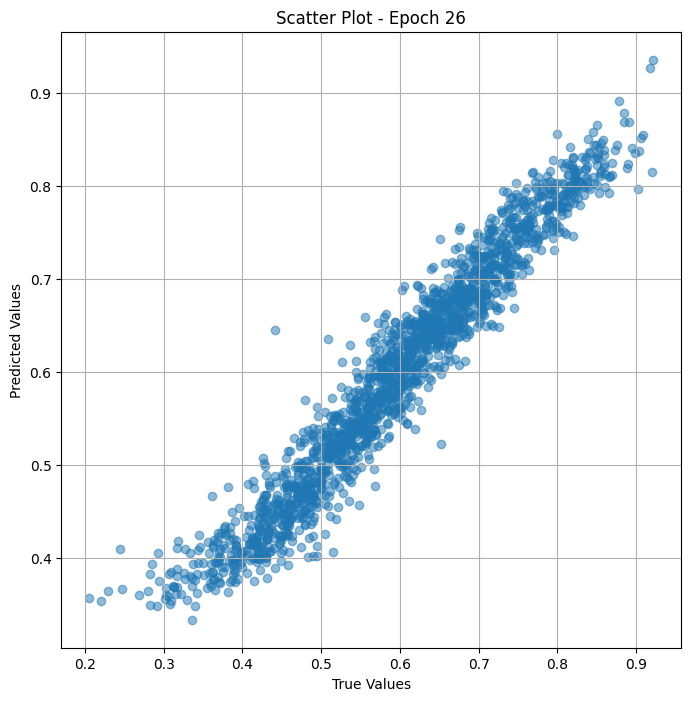

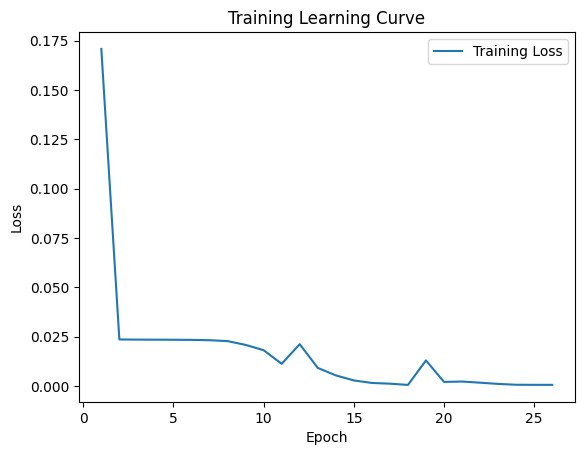

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (27/50) Loss = 0.0005647176294587553

 Epoch: (27/50) Loss_rmse = 0.023763788864016533

 Epoch: (27/50) R^2 = 0.9758076667785645

 Epoch: (27/50) MAE = 0.019604291766881943
Spearman correlation coefficient: SignificanceResult(statistic=0.9747157151162373, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.

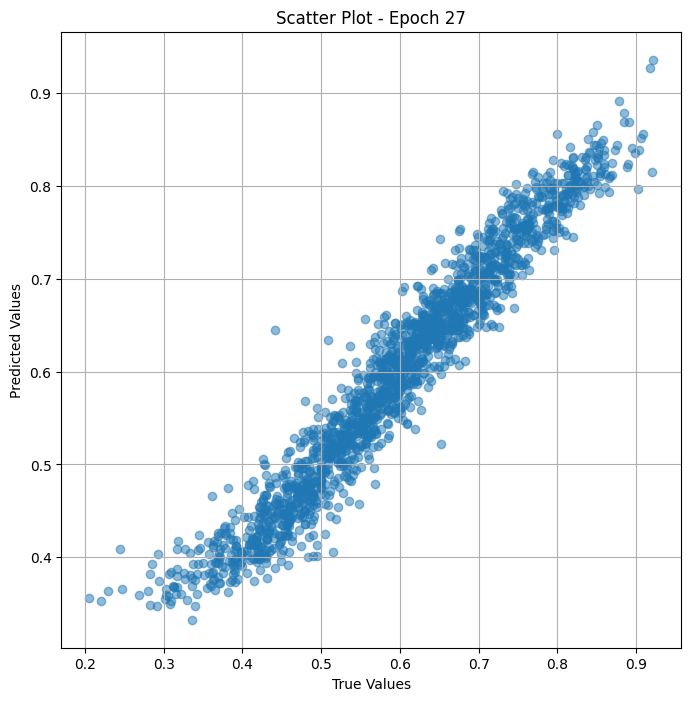

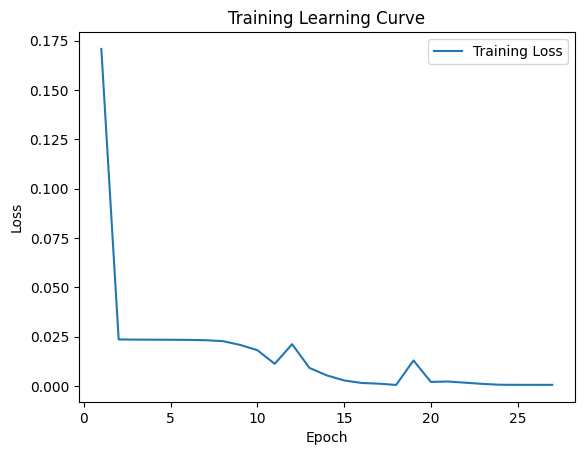


 Epoch: (28/50) Loss = 0.0005625172634609044

 Epoch: (28/50) Loss_rmse = 0.023717446252703667

 Epoch: (28/50) R^2 = 0.9759019613265991

 Epoch: (28/50) MAE = 0.019541766494512558
Spearman correlation coefficient: SignificanceResult(statistic=0.9752866526397906, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

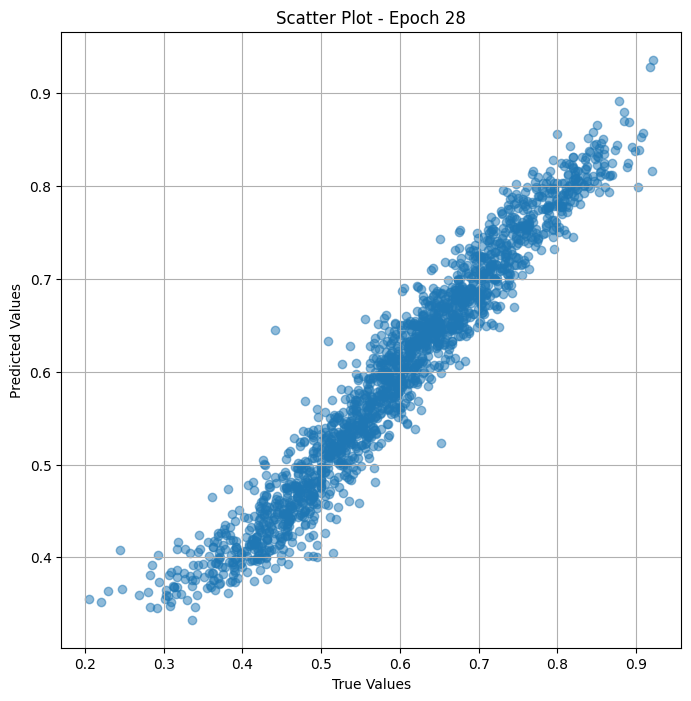

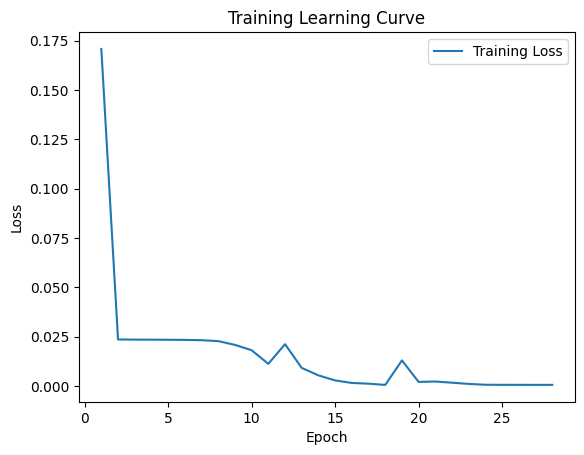


 Epoch: (29/50) Loss = 0.0005616290727630258

 Epoch: (29/50) Loss_rmse = 0.023698715493083

 Epoch: (29/50) R^2 = 0.9759399890899658

 Epoch: (29/50) MAE = 0.019510358572006226
Spearman correlation coefficient: SignificanceResult(statistic=0.9753233174134017, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.515

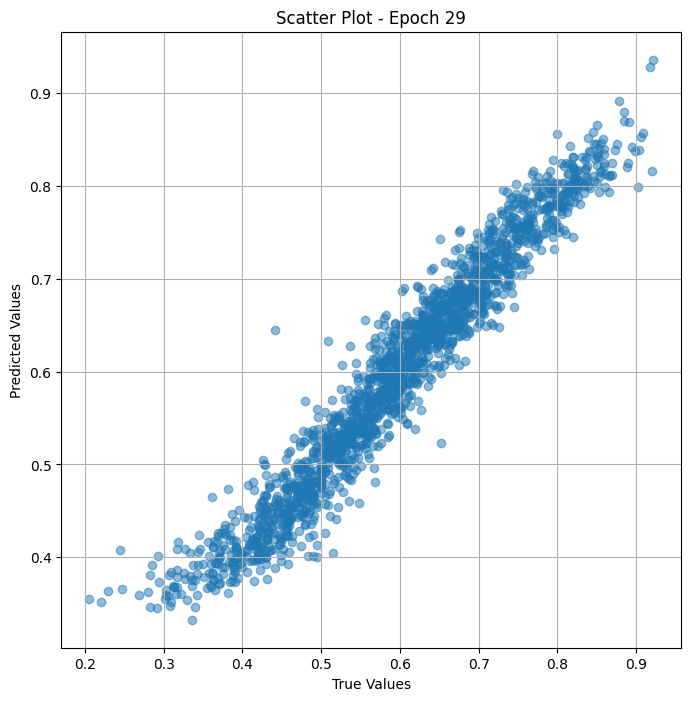

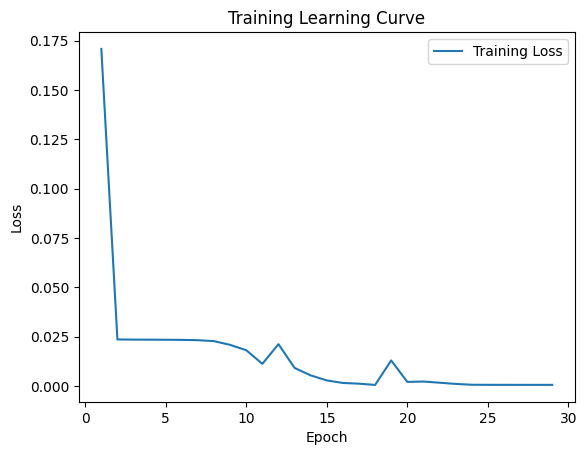

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (30/50) Loss = 0.0005607023485936224

 Epoch: (30/50) Loss_rmse = 0.023679153993725777

 Epoch: (30/50) R^2 = 0.9759796857833862

 Epoch: (30/50) MAE = 0.019479304552078247
Spearman correlation coefficient: SignificanceResult(statistic=0.9753558939464357, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.

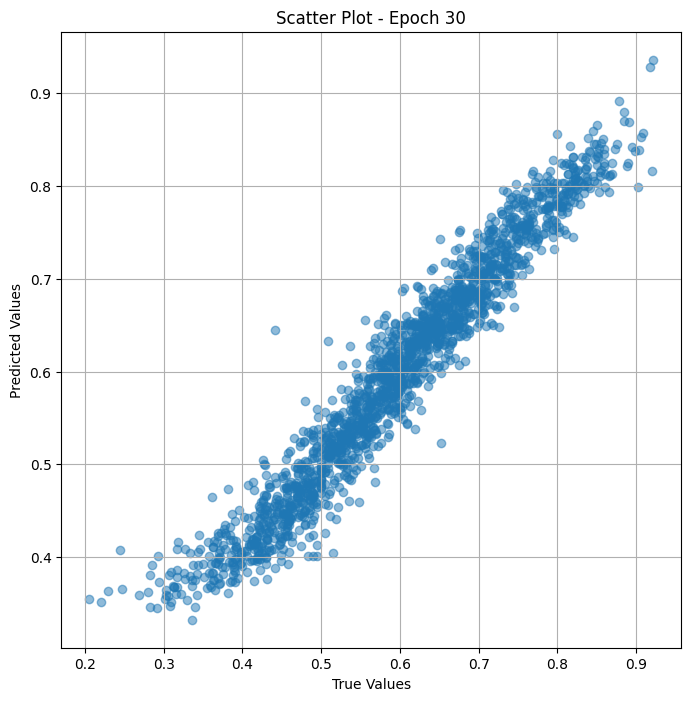

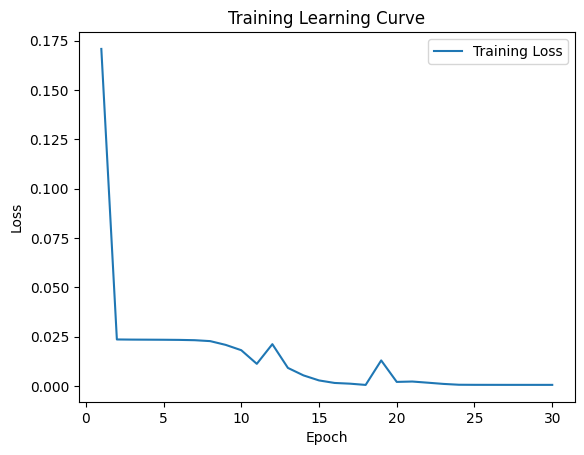


 Epoch: (31/50) Loss = 0.0005605147453024983

 Epoch: (31/50) Loss_rmse = 0.023675192147493362

 Epoch: (31/50) R^2 = 0.9759877324104309

 Epoch: (31/50) MAE = 0.01947377249598503
Spearman correlation coefficient: SignificanceResult(statistic=0.9754147275154252, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

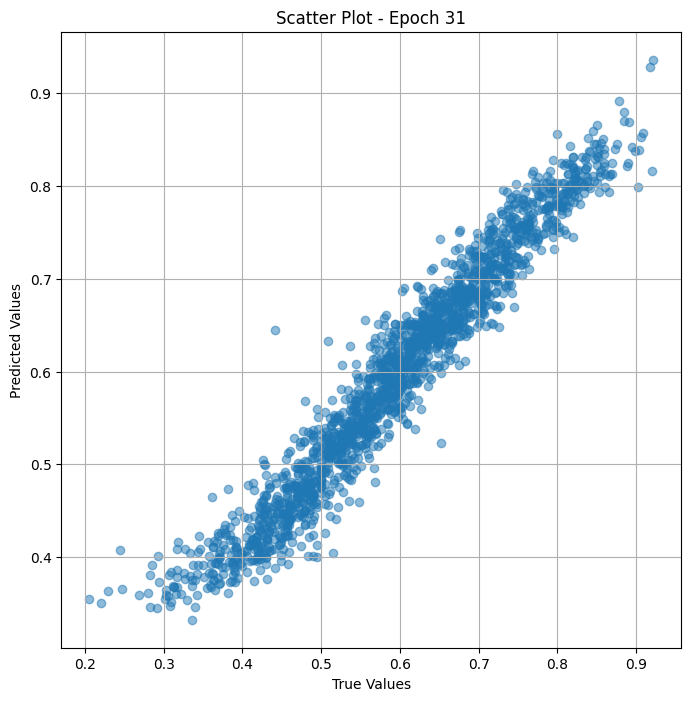

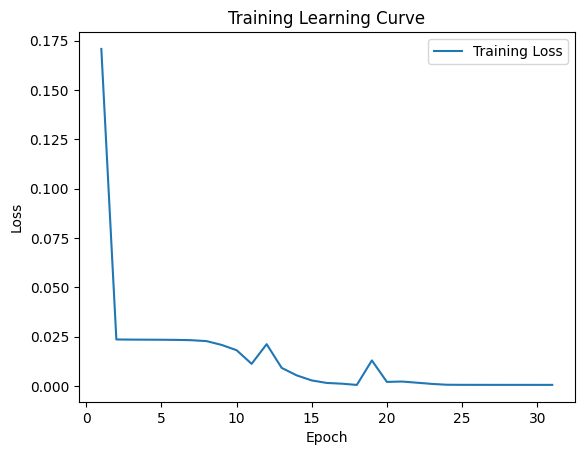


 Epoch: (32/50) Loss = 0.0005604711477644742

 Epoch: (32/50) Loss_rmse = 0.023674272000789642

 Epoch: (32/50) R^2 = 0.975989580154419

 Epoch: (32/50) MAE = 0.019471753388643265
Spearman correlation coefficient: SignificanceResult(statistic=0.9754163905409722, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

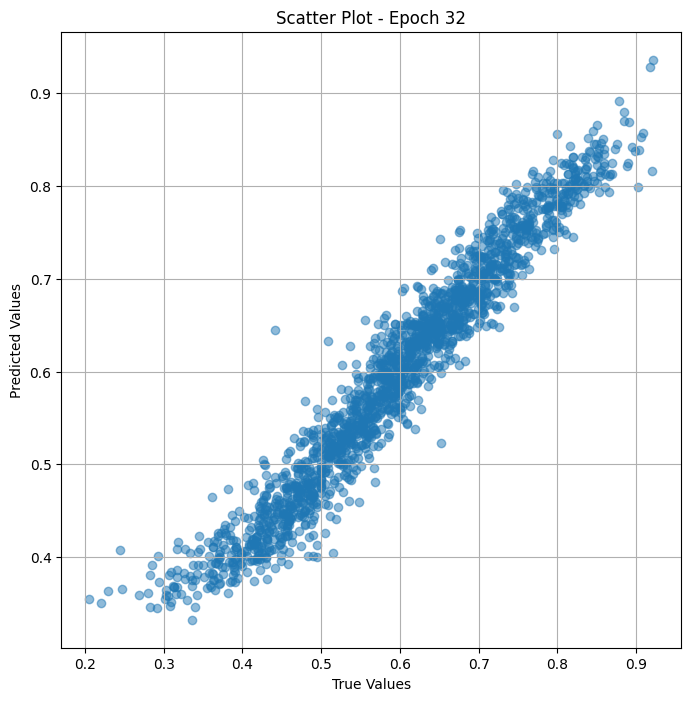

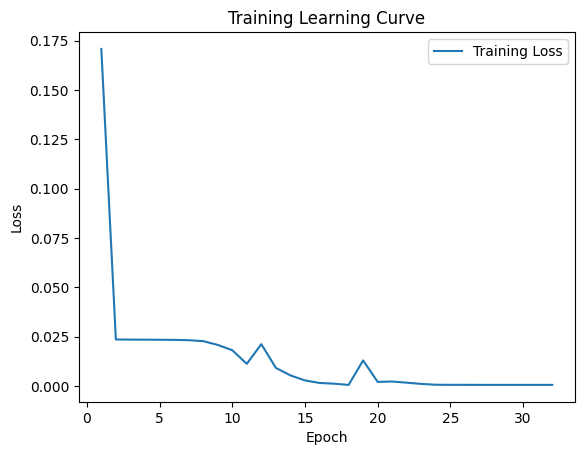


 Epoch: (33/50) Loss = 0.0005604208563454449

 Epoch: (33/50) Loss_rmse = 0.02367321029305458

 Epoch: (33/50) R^2 = 0.9759917259216309

 Epoch: (33/50) MAE = 0.019469596445560455
Spearman correlation coefficient: SignificanceResult(statistic=0.9754174191016366, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

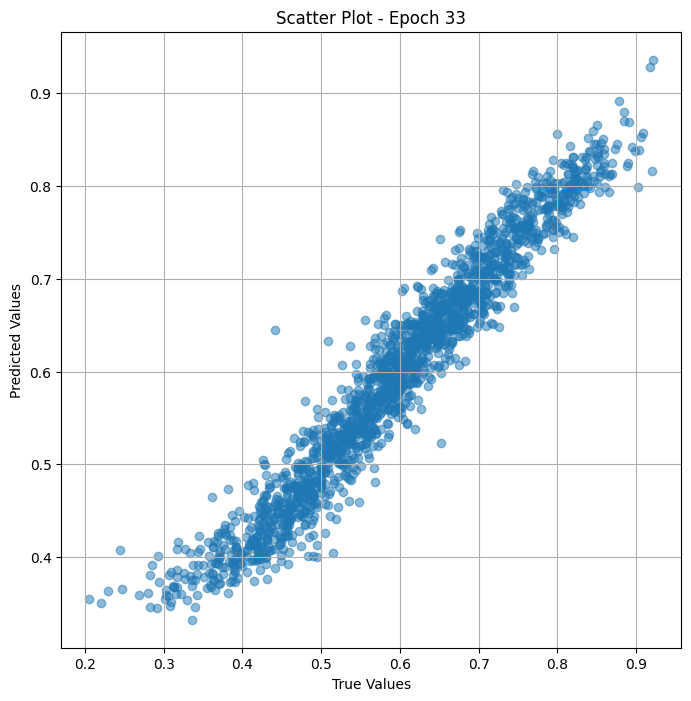

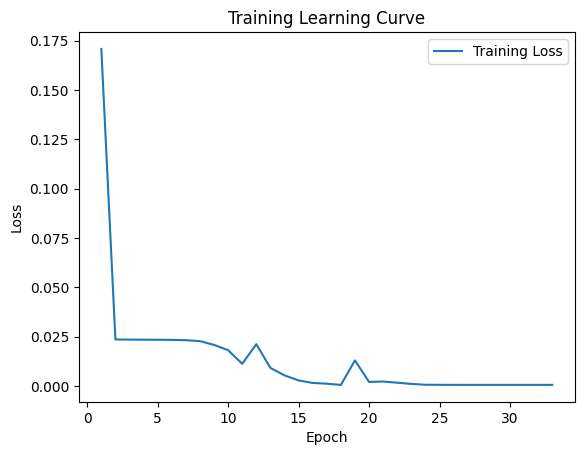


 Epoch: (34/50) Loss = 0.0005603731260634959

 Epoch: (34/50) Loss_rmse = 0.023672200739383698

 Epoch: (34/50) R^2 = 0.975993812084198

 Epoch: (34/50) MAE = 0.019467439502477646
Spearman correlation coefficient: SignificanceResult(statistic=0.9754207185779913, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

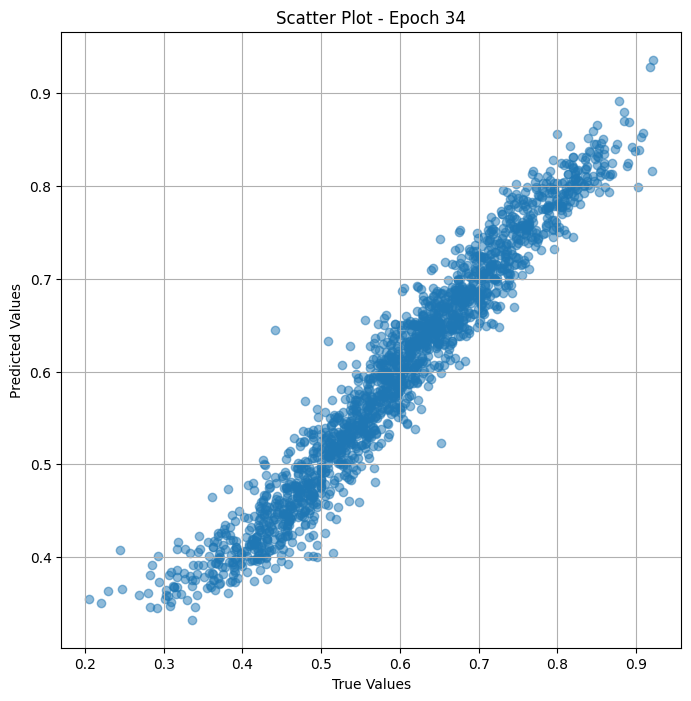

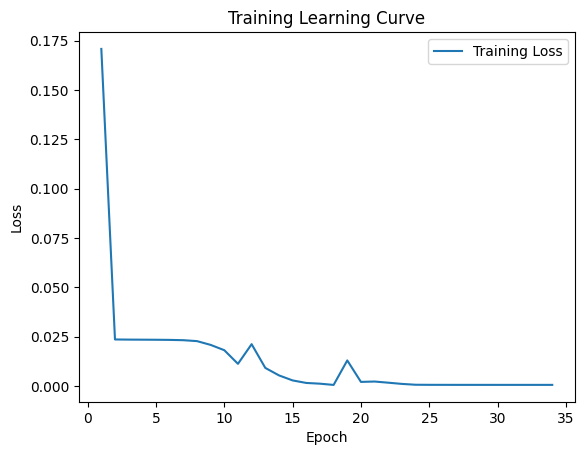


 Epoch: (35/50) Loss = 0.0005603192839771509

 Epoch: (35/50) Loss_rmse = 0.023671064525842667

 Epoch: (35/50) R^2 = 0.9759960770606995

 Epoch: (35/50) MAE = 0.019465100020170212
Spearman correlation coefficient: SignificanceResult(statistic=0.9754226161996185, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

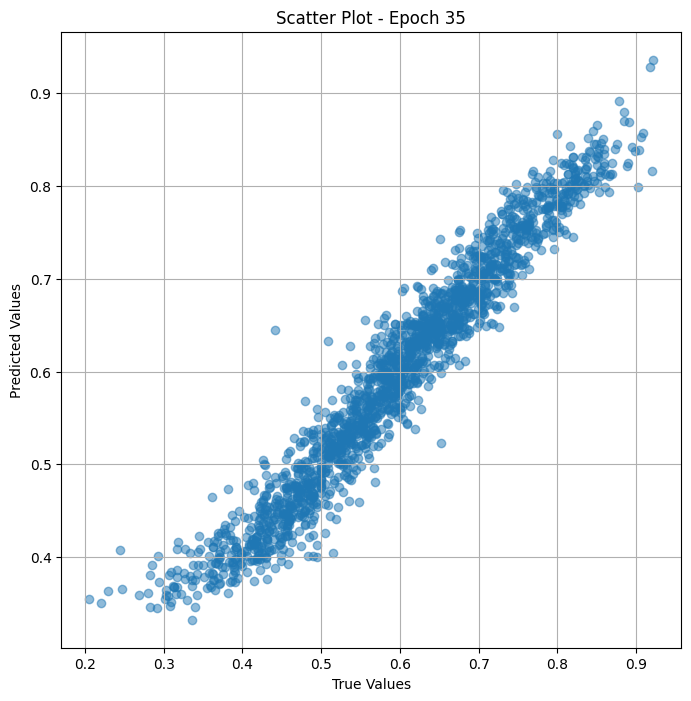

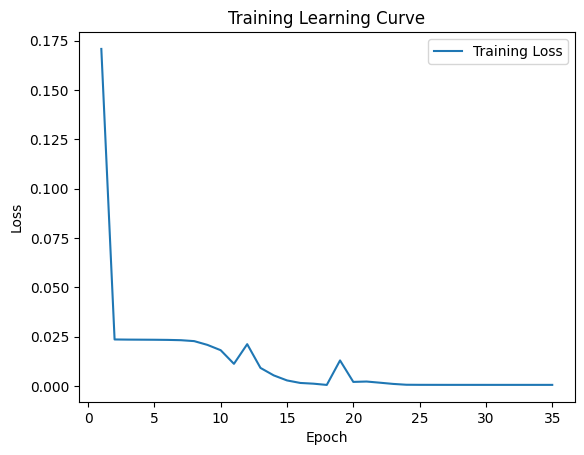


 Epoch: (36/50) Loss = 0.0005602629389613867

 Epoch: (36/50) Loss_rmse = 0.023669874295592308

 Epoch: (36/50) R^2 = 0.9759985208511353

 Epoch: (36/50) MAE = 0.019462689757347107
Spearman correlation coefficient: SignificanceResult(statistic=0.9754254323952313, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

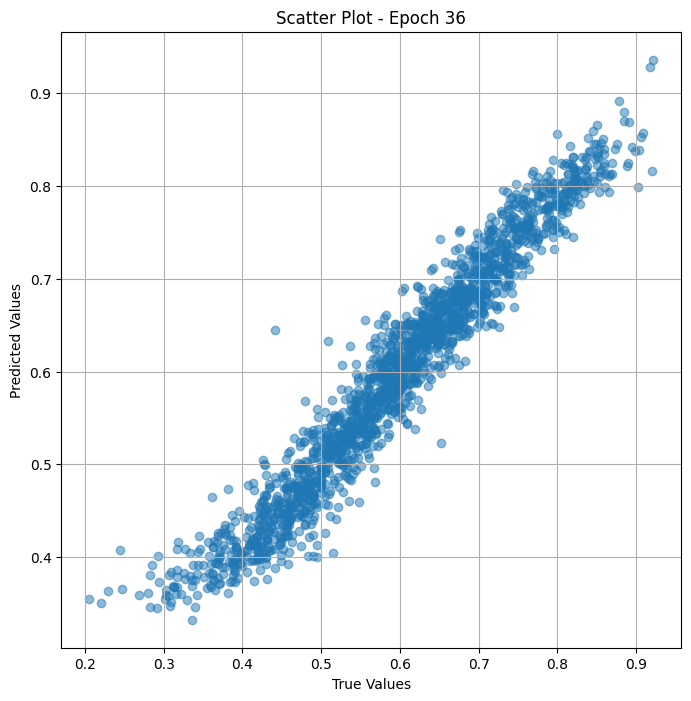

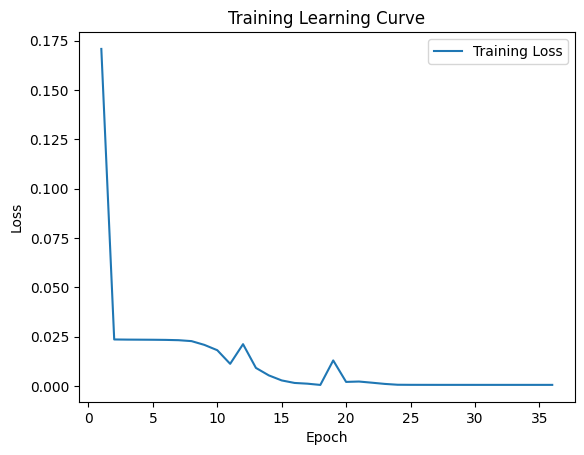


 Epoch: (37/50) Loss = 0.0005602047895081341

 Epoch: (37/50) Loss_rmse = 0.023668644949793816

 Epoch: (37/50) R^2 = 0.9760010242462158

 Epoch: (37/50) MAE = 0.019460201263427734
Spearman correlation coefficient: SignificanceResult(statistic=0.975426860824698, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

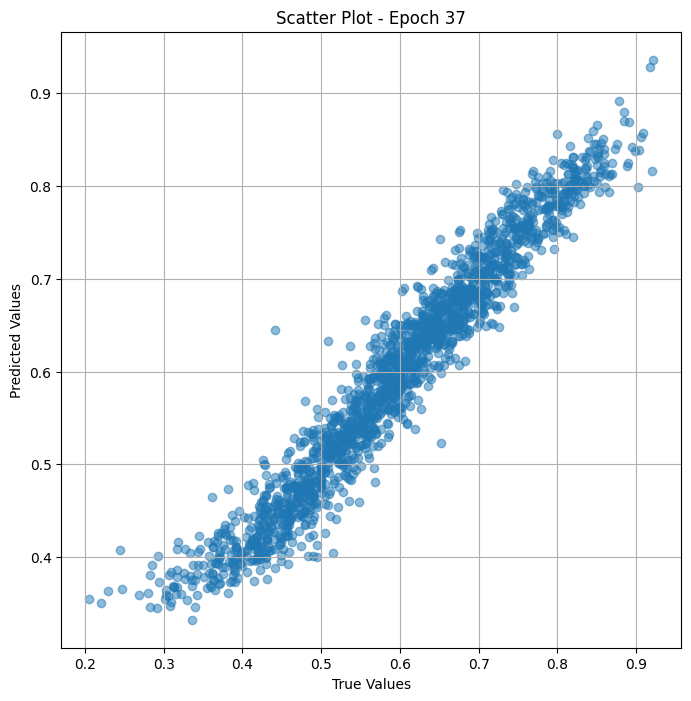

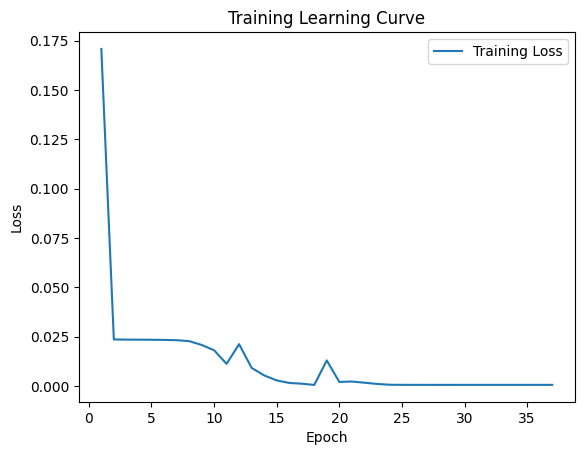


 Epoch: (38/50) Loss = 0.0005601444863714278

 Epoch: (38/50) Loss_rmse = 0.02366737090051174

 Epoch: (38/50) R^2 = 0.9760035872459412

 Epoch: (38/50) MAE = 0.019457653164863586
Spearman correlation coefficient: SignificanceResult(statistic=0.9754278357017426, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

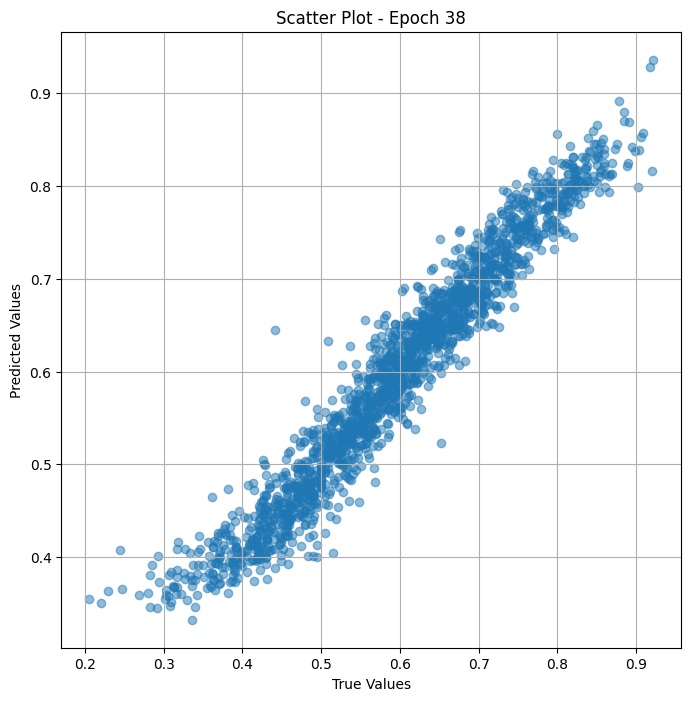

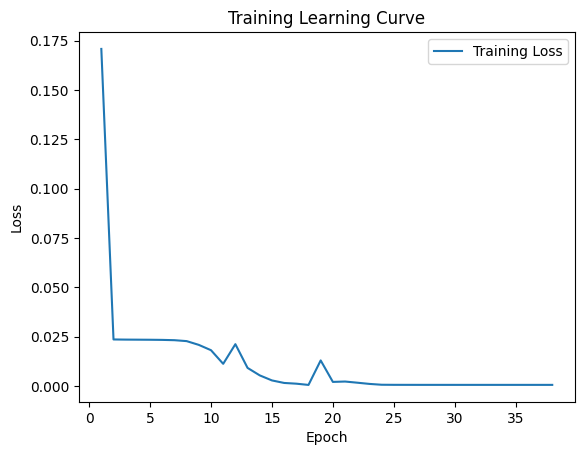


 Epoch: (39/50) Loss = 0.0005600809818133712

 Epoch: (39/50) Loss_rmse = 0.023666029796004295

 Epoch: (39/50) R^2 = 0.9760063290596008

 Epoch: (39/50) MAE = 0.019454997032880783
Spearman correlation coefficient: SignificanceResult(statistic=0.9754337871436373, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

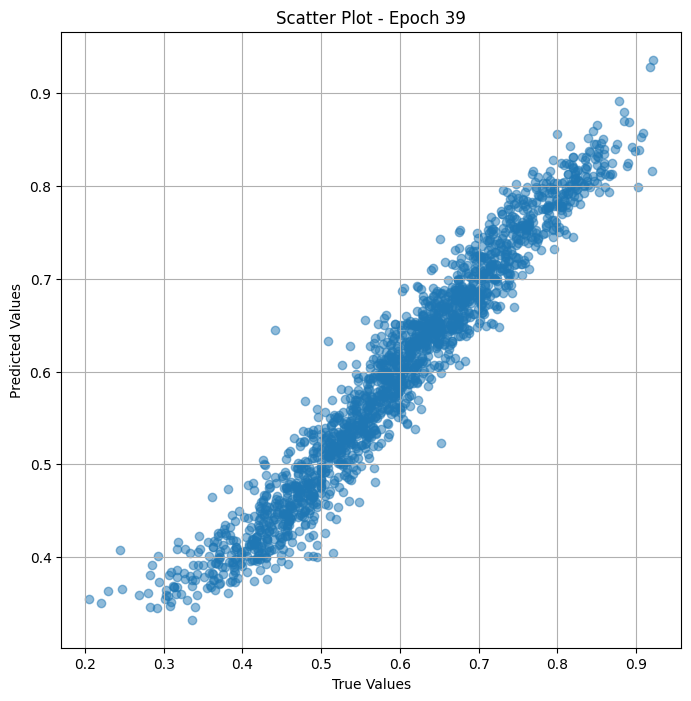

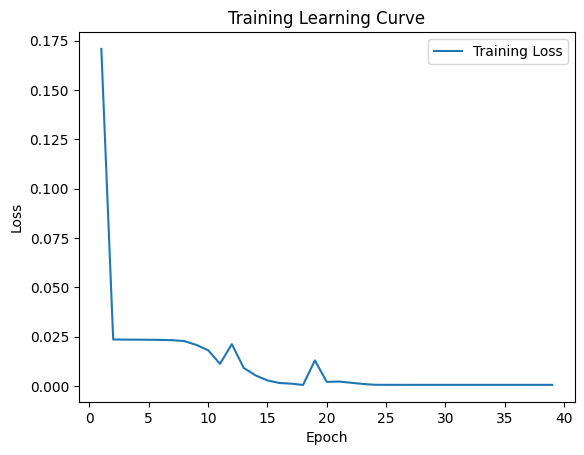


 Epoch: (40/50) Loss = 0.0005600148579105735

 Epoch: (40/50) Loss_rmse = 0.023664632812142372

 Epoch: (40/50) R^2 = 0.9760091304779053

 Epoch: (40/50) MAE = 0.019452277570962906
Spearman correlation coefficient: SignificanceResult(statistic=0.9754359193613449, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

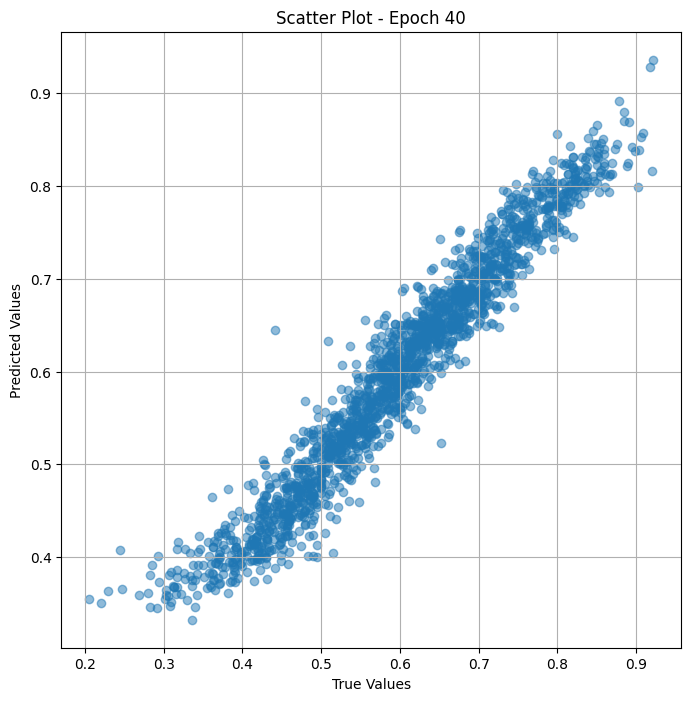

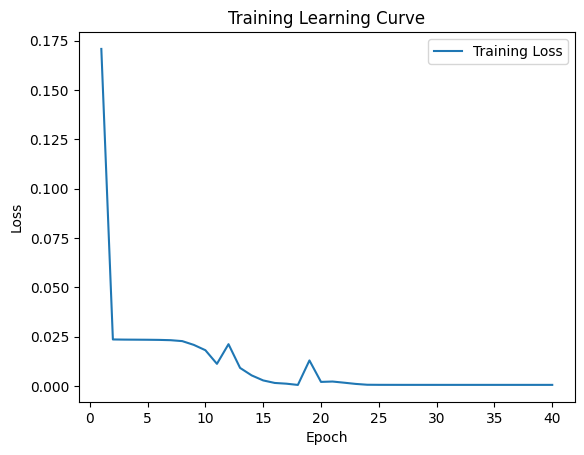


 Epoch: (41/50) Loss = 0.0005599457072094083

 Epoch: (41/50) Loss_rmse = 0.023663172498345375

 Epoch: (41/50) R^2 = 0.976012110710144

 Epoch: (41/50) MAE = 0.019450142979621887
Spearman correlation coefficient: SignificanceResult(statistic=0.9754374843778628, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

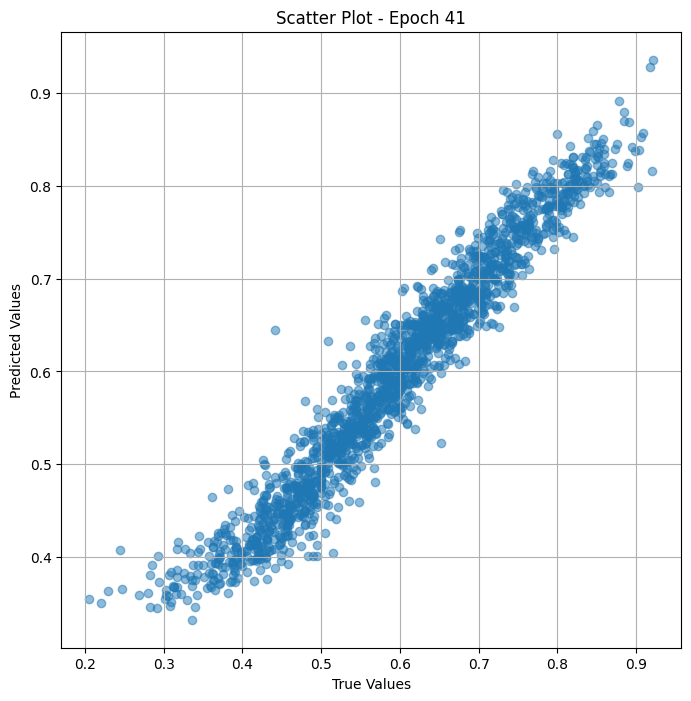

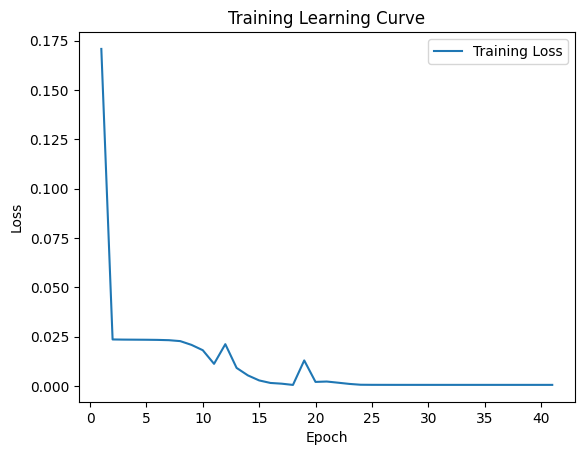


 Epoch: (42/50) Loss = 0.0005598724819719791

 Epoch: (42/50) Loss_rmse = 0.023661624640226364

 Epoch: (42/50) R^2 = 0.9760152697563171

 Epoch: (42/50) MAE = 0.0194489024579525
Spearman correlation coefficient: SignificanceResult(statistic=0.9754395081600489, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.51

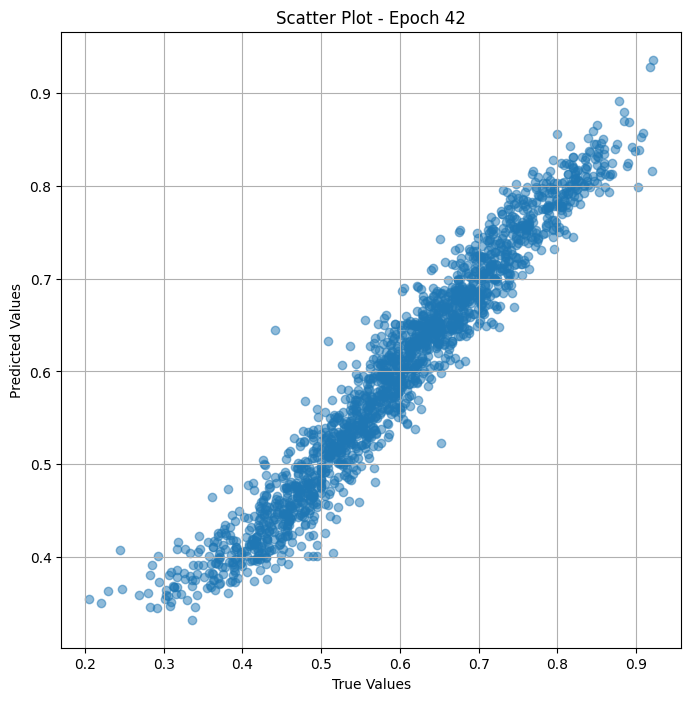

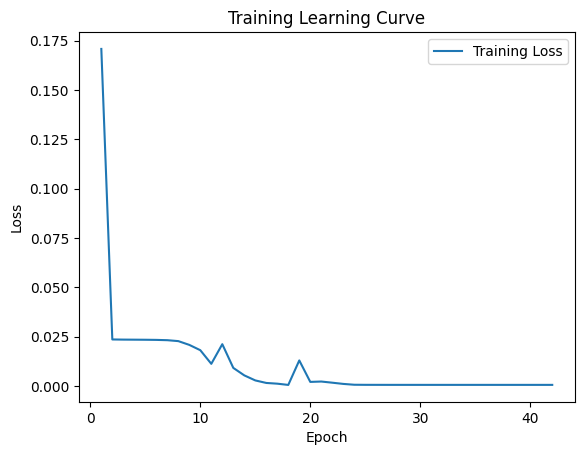


 Epoch: (43/50) Loss = 0.000559795880690217

 Epoch: (43/50) Loss_rmse = 0.023660006001591682

 Epoch: (43/50) R^2 = 0.9760185480117798

 Epoch: (43/50) MAE = 0.01944754272699356
Spearman correlation coefficient: SignificanceResult(statistic=0.9754407937465688, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.51

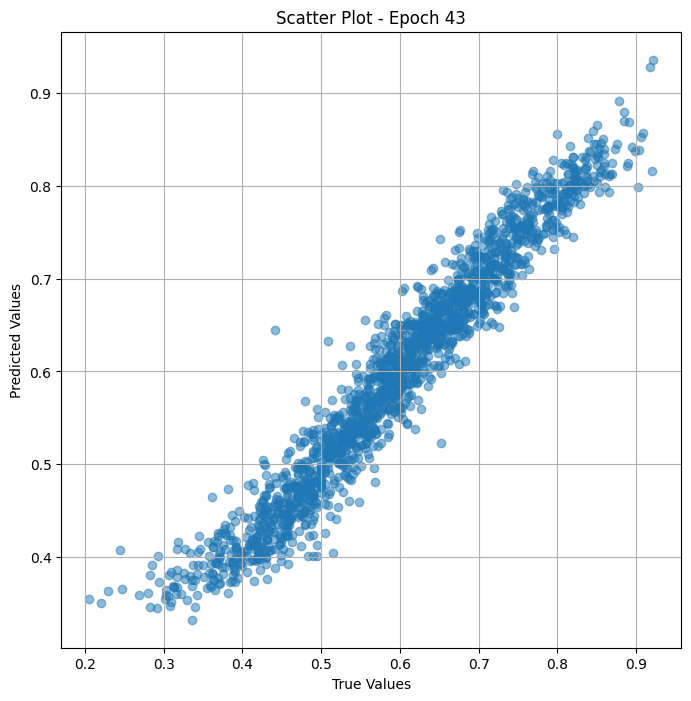

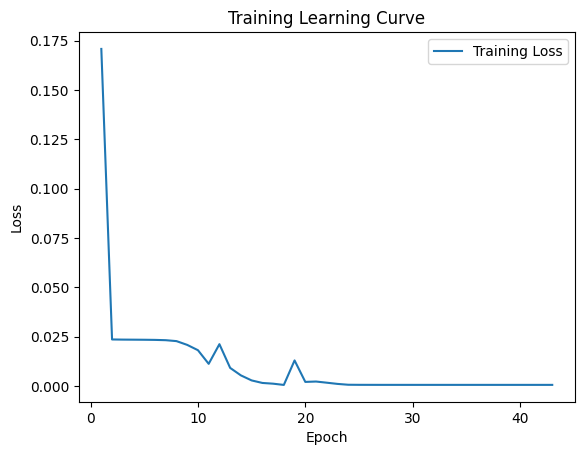


 Epoch: (44/50) Loss = 0.0005597181152552366

 Epoch: (44/50) Loss_rmse = 0.02365836314857006

 Epoch: (44/50) R^2 = 0.9760218858718872

 Epoch: (44/50) MAE = 0.019446175545454025
Spearman correlation coefficient: SignificanceResult(statistic=0.9754443418819521, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

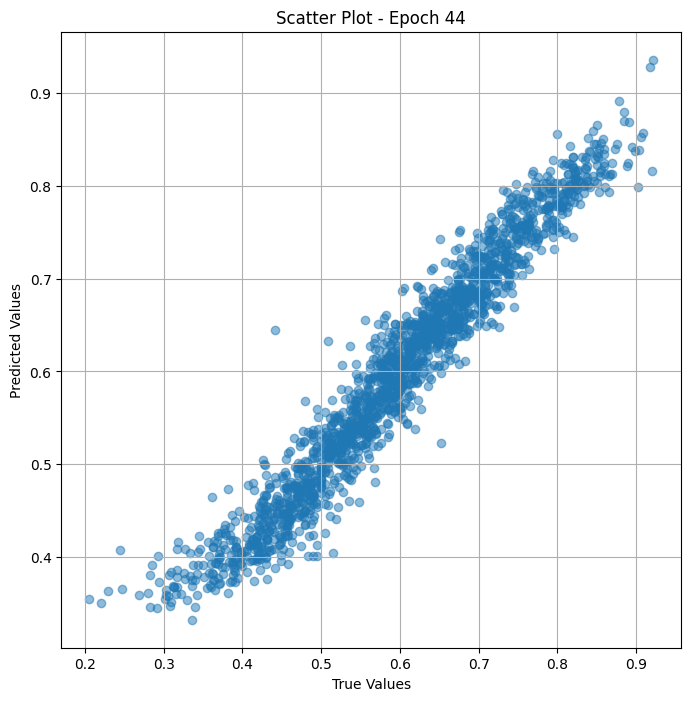

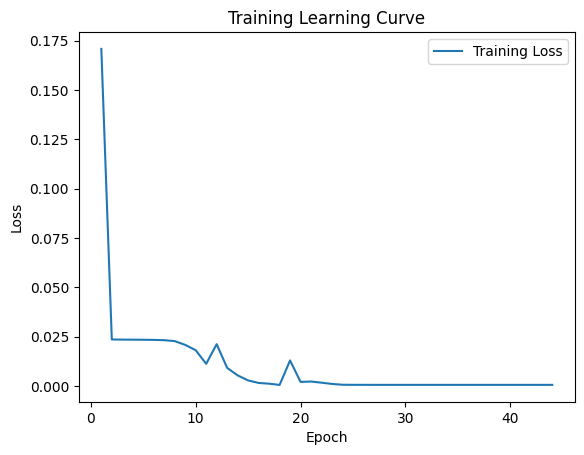


 Epoch: (45/50) Loss = 0.0005596372066065669

 Epoch: (45/50) Loss_rmse = 0.023656653240323067

 Epoch: (45/50) R^2 = 0.9760253429412842

 Epoch: (45/50) MAE = 0.019444741308689117
Spearman correlation coefficient: SignificanceResult(statistic=0.9754472623424894, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

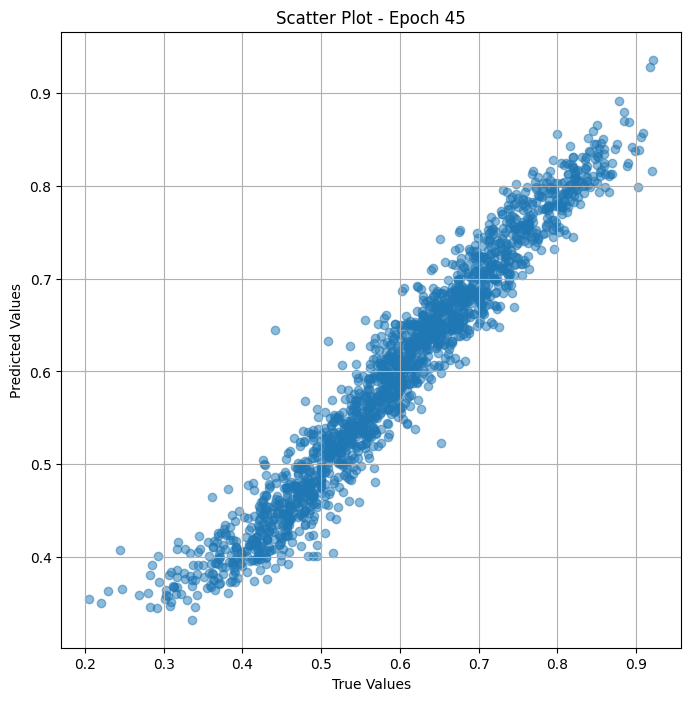

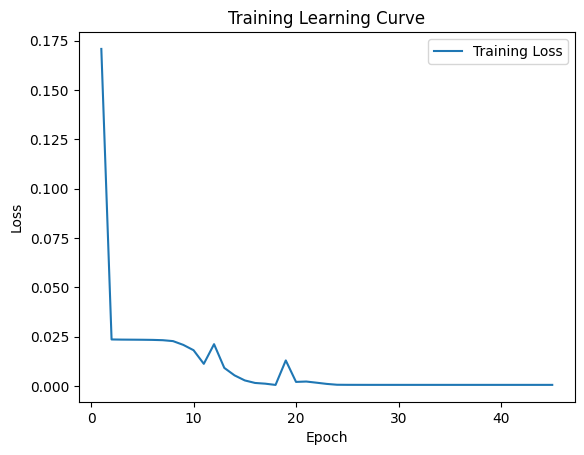


 Epoch: (46/50) Loss = 0.0005595517577603459

 Epoch: (46/50) Loss_rmse = 0.023654846474528313

 Epoch: (46/50) R^2 = 0.9760289788246155

 Epoch: (46/50) MAE = 0.01944321021437645
Spearman correlation coefficient: SignificanceResult(statistic=0.9754505727538446, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

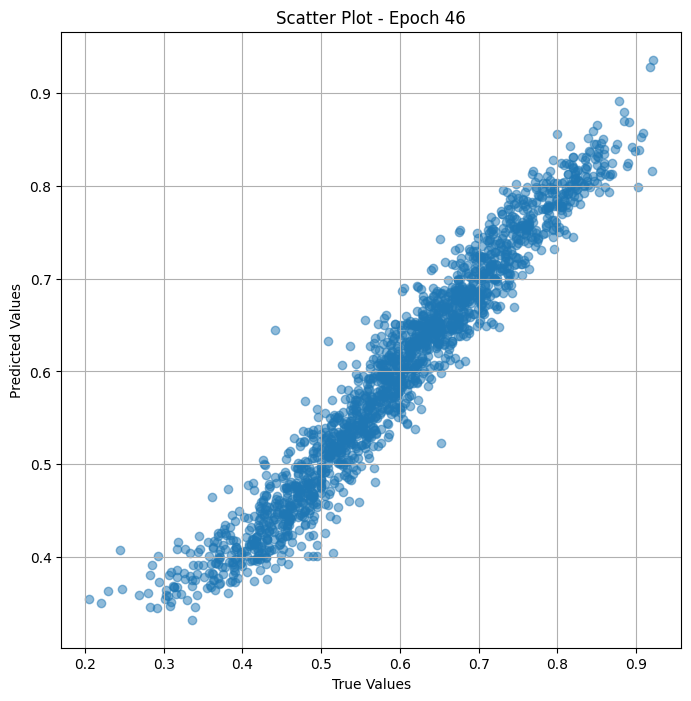

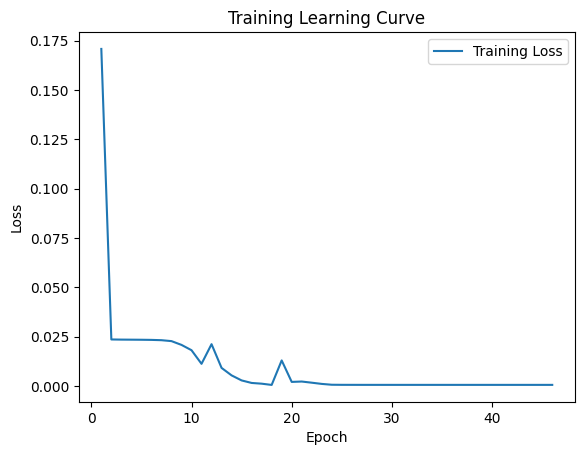


 Epoch: (47/50) Loss = 0.0005594625254161656

 Epoch: (47/50) Loss_rmse = 0.02365295961499214

 Epoch: (47/50) R^2 = 0.9760327935218811

 Epoch: (47/50) MAE = 0.01944161206483841
Spearman correlation coefficient: SignificanceResult(statistic=0.9754553668550765, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.51

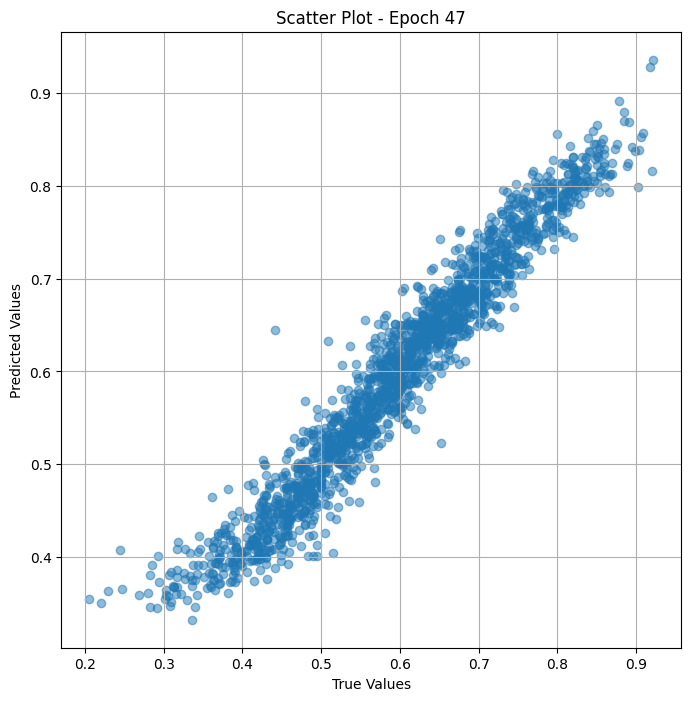

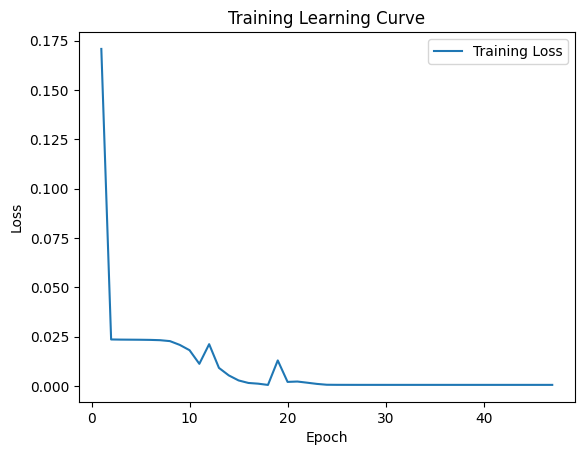


 Epoch: (48/50) Loss = 0.000559371430426836

 Epoch: (48/50) Loss_rmse = 0.023651033639907837

 Epoch: (48/50) R^2 = 0.9760367274284363

 Epoch: (48/50) MAE = 0.0194399356842041
Spearman correlation coefficient: SignificanceResult(statistic=0.9754601474018683, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.515

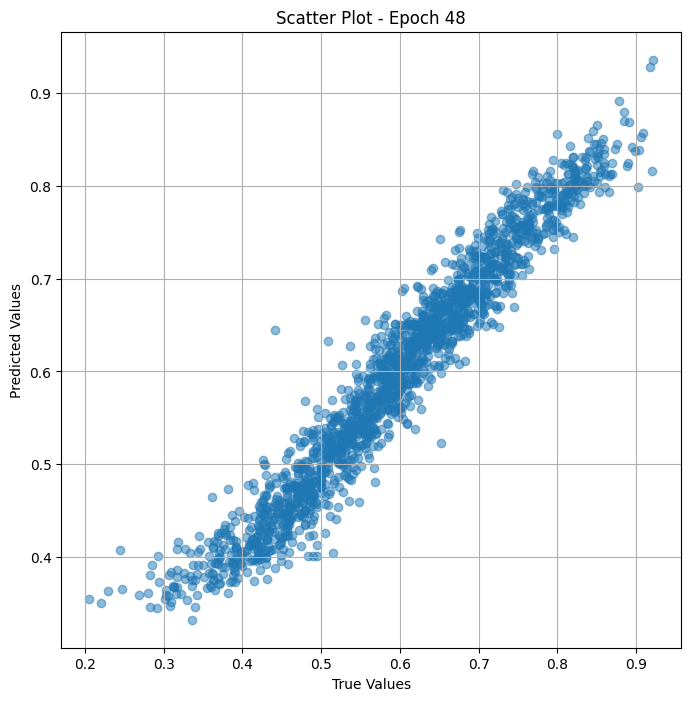

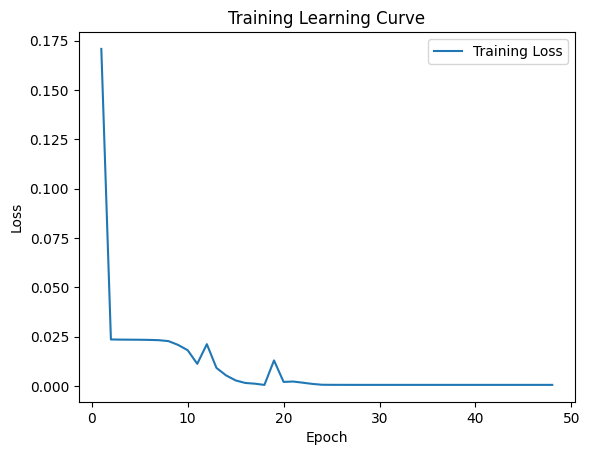


 Epoch: (49/50) Loss = 0.0005592770758084953

 Epoch: (49/50) Loss_rmse = 0.02364903874695301

 Epoch: (49/50) R^2 = 0.976040780544281

 Epoch: (49/50) MAE = 0.0194382481276989
Spearman correlation coefficient: SignificanceResult(statistic=0.9754632065347553, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5154

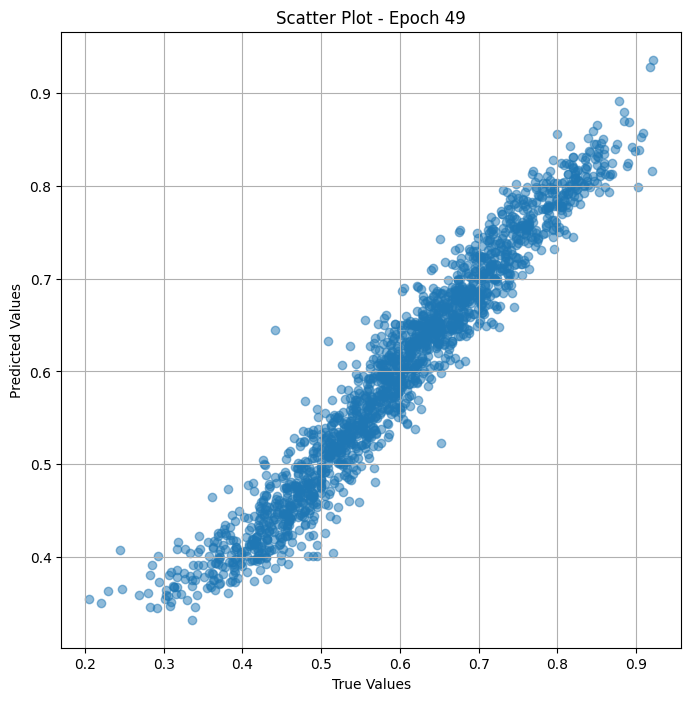

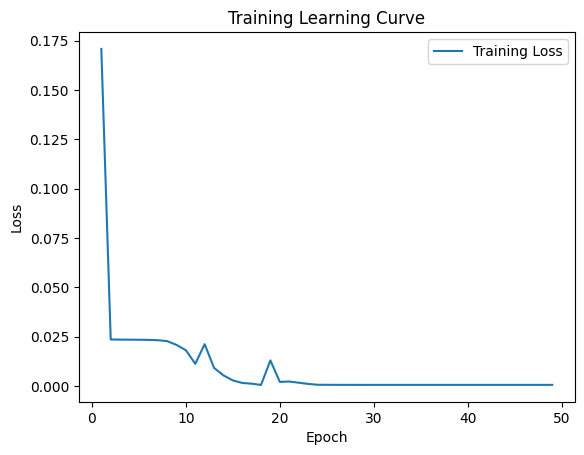


 Epoch: (50/50) Loss = 0.0005591768422164023

 Epoch: (50/50) Loss_rmse = 0.023646920919418335

 Epoch: (50/50) R^2 = 0.9760450720787048

 Epoch: (50/50) MAE = 0.01943640038371086
Spearman correlation coefficient: SignificanceResult(statistic=0.9754667432009969, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

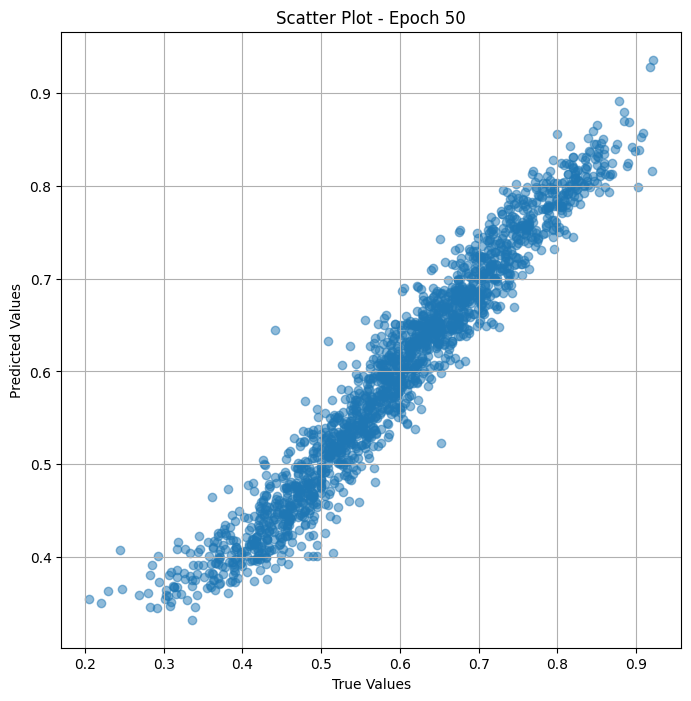

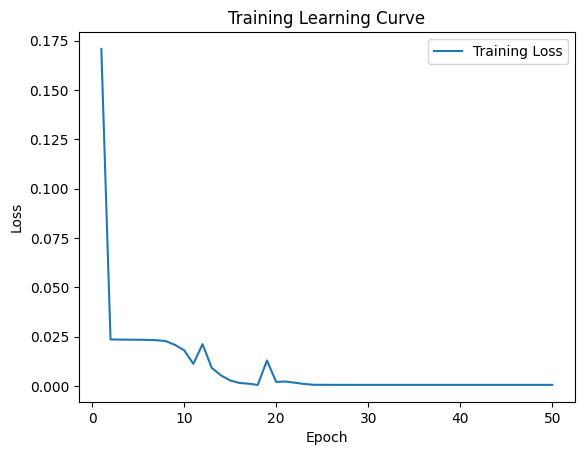

In [ ]:
# Training the model and save weights
fit(50, model_vit , train_dl)
torch.save(model_vit.state_dict(), "model_weights_2")

In [ ]:
true_values_list = []
predicted_values_list = []

for x_trans, yb in train_dl:
    preds = model_vit(x_trans)
    true_values_list.extend(yb.cpu().detach().numpy())
    predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_landscape' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_train_landscape['preprocessed_image_path'],
    'True Value': true_values_list,  # Replace with your actual true values
    'Predicted Value': predicted_values_list  # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)



                                             Image Path  True Value  \
0     /content/landscape/sun_axhrgmuqrljrfnpd_prepro...    0.433962   
1     /content/landscape/sun_agqnaqaigkgpfvia_prepro...    0.429907   
2     /content/landscape/n09289331_6504_preprocessed...    0.714286   
3     /content/landscape/sun_aayounnakjpewywf_prepro...    0.567797   
4     /content/landscape/n09270735_44665_preprocesse...    0.548387   
...                                                 ...         ...   
1795  /content/landscape/n09393605_61186_preprocesse...    0.559633   
1796  /content/landscape/n09428293_46696_preprocesse...    0.588235   
1797  /content/landscape/be93f13ea8c14ee4_preprocess...    0.702128   
1798  /content/landscape/n09376198_15319_preprocesse...    0.594595   
1799  /content/landscape/n09270735_6787_preprocessed...    0.921348   

      Predicted Value  
0            0.395013  
1            0.378669  
2            0.708699  
3            0.522626  
4            0.571652  
...

In [ ]:
from prettytable import PrettyTable

# Assuming 'df_result' is your DataFrame
# The 'Image Path' column should contain the paths to your images

# Create a PrettyTable instance
table = PrettyTable()

# Add column names
table.field_names = df_result.columns.tolist()

# Add rows
for _, row in df_result.iterrows():
    table.add_row(row.tolist())

# Display the table
print(table)

+----------------------------------------------------------+------------+---------------------+
|                        Image Path                        | True Value |   Predicted Value   |
+----------------------------------------------------------+------------+---------------------+
| /content/landscape/sun_axhrgmuqrljrfnpd_preprocessed.jpg | 0.43396226 | 0.39501291513442993 |
| /content/landscape/sun_agqnaqaigkgpfvia_preprocessed.jpg | 0.42990655 |  0.3786690831184387 |
|    /content/landscape/n09289331_6504_preprocessed.jpg    | 0.71428573 |  0.7086992859840393 |
| /content/landscape/sun_aayounnakjpewywf_preprocessed.jpg | 0.5677966  |  0.5226264595985413 |
|   /content/landscape/n09270735_44665_preprocessed.jpg    | 0.5483871  |  0.5716519355773926 |
|   /content/landscape/02f3a888909fa7d0_preprocessed.jpg   | 0.6395349  |  0.6056109666824341 |
|   /content/landscape/00cffe5e669f340e_preprocessed.jpg   | 0.7368421  |  0.7207518219947815 |
|    /content/landscape/n09415671_2335_p

## Valid

In [ ]:
class Dataset_val(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_val_landscape["memoscore"]
        self.images = df_val_landscape["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
val_ds = Dataset_val(df_val_landscape, trans_transform=trans_transform)
val_dl = DataLoader(val_ds, batch_size=32, shuffle=False)

In [ ]:
class ViTMem_model_val(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_sval =  ViTMem_model_val( arch="vit_base_patch16_224_miil")

In [ ]:

# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_val().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
val_dl = DeviceDataLoader(val_dl, device)
model_vit_sval  = to_device(model_vit_sval  , device)

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Validation Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)






 Epoch: (1/50) Loss = 0.17223799228668213

 Epoch: (1/50) Loss_rmse = 0.41501566767692566

 Epoch: (1/50) R^2 = -13.916934967041016

 Epoch: (1/50) MAE = 0.3915374279022217
Spearman correlation coefficient: SignificanceResult(statistic=0.34448190064127454, pvalue=0.0005885610960826658)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.41

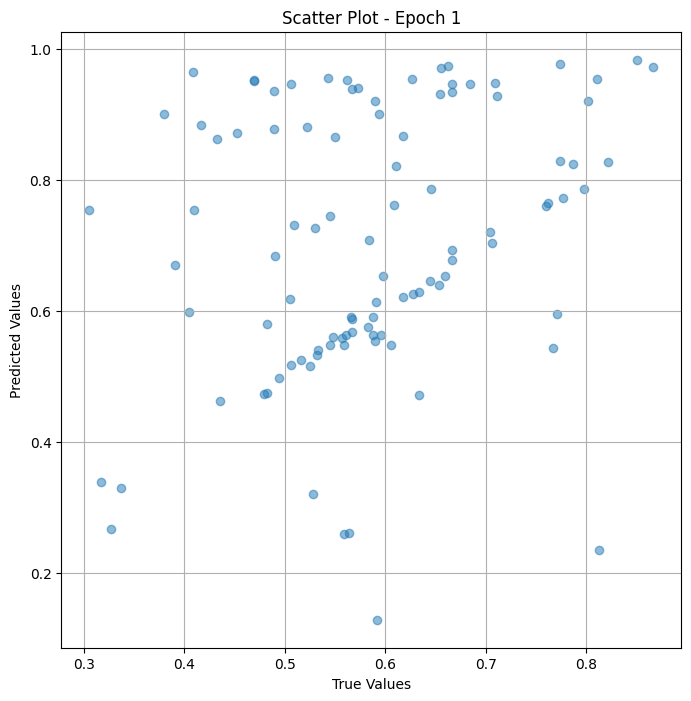

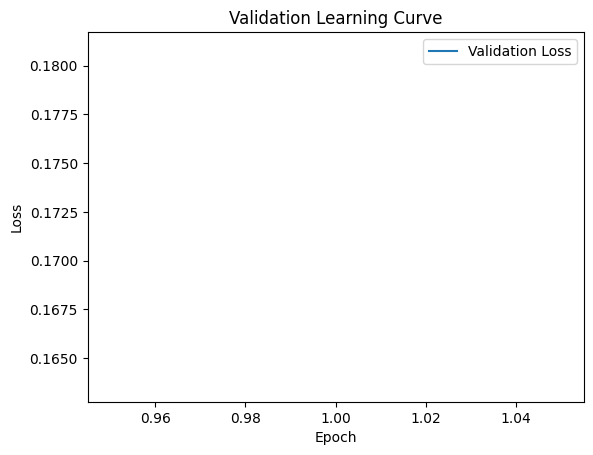


 Epoch: (2/50) Loss = 0.05340550094842911

 Epoch: (2/50) Loss_rmse = 0.2310962975025177

 Epoch: (2/50) R^2 = -3.625265121459961

 Epoch: (2/50) MAE = 0.19301313161849976
Spearman correlation coefficient: SignificanceResult(statistic=0.21120780310444687, pvalue=0.03886046581849563)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.41666

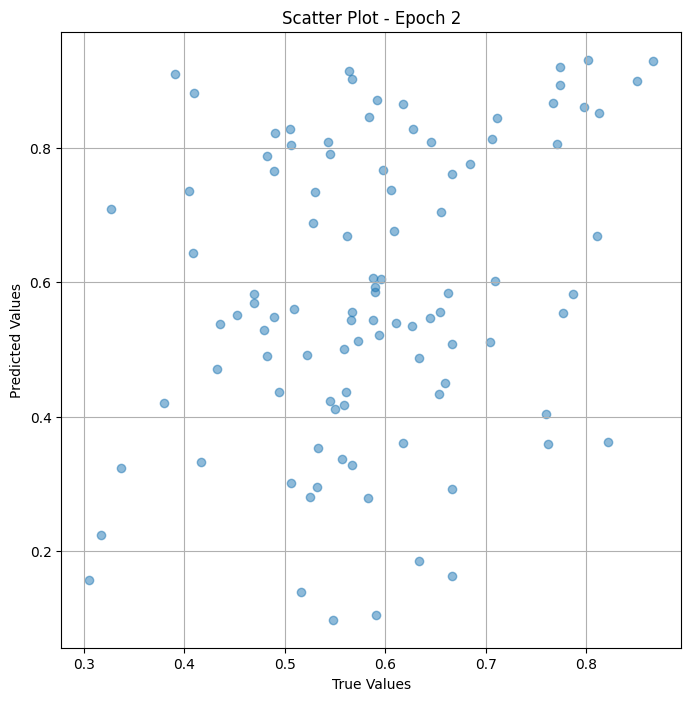

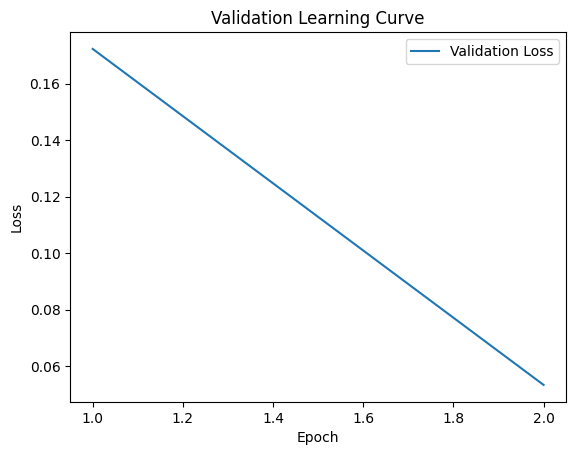


 Epoch: (3/50) Loss = 0.03947983309626579

 Epoch: (3/50) Loss_rmse = 0.1986953318119049

 Epoch: (3/50) R^2 = -2.4192113876342773

 Epoch: (3/50) MAE = 0.17012479901313782
Spearman correlation coefficient: SignificanceResult(statistic=0.21054309438855248, pvalue=0.03949324784679544)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.4166

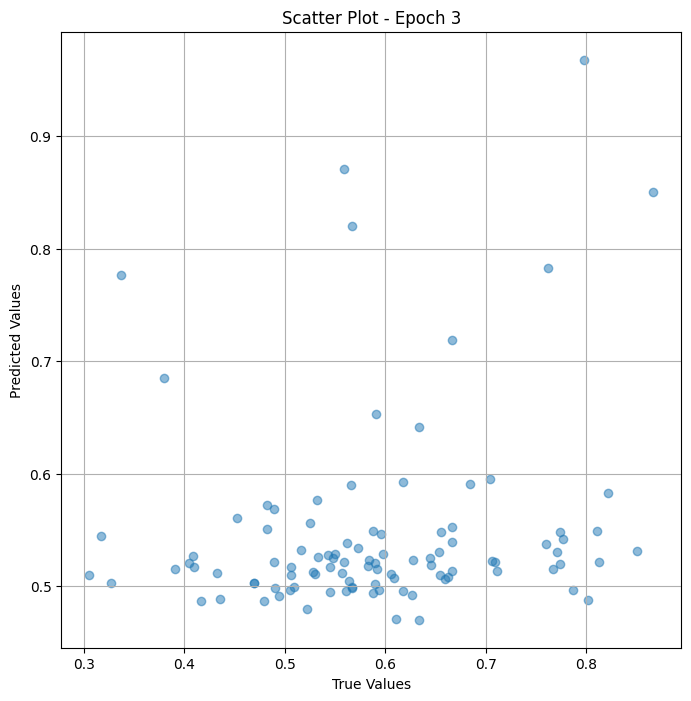

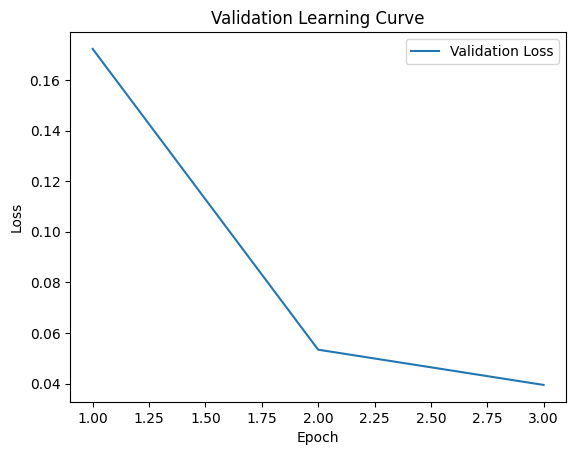


 Epoch: (4/50) Loss = 0.025612175464630127

 Epoch: (4/50) Loss_rmse = 0.1600380390882492

 Epoch: (4/50) R^2 = -1.2181816101074219

 Epoch: (4/50) MAE = 0.13088276982307434
Spearman correlation coefficient: SignificanceResult(statistic=0.22022206722101487, pvalue=0.031083283557825483)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.41

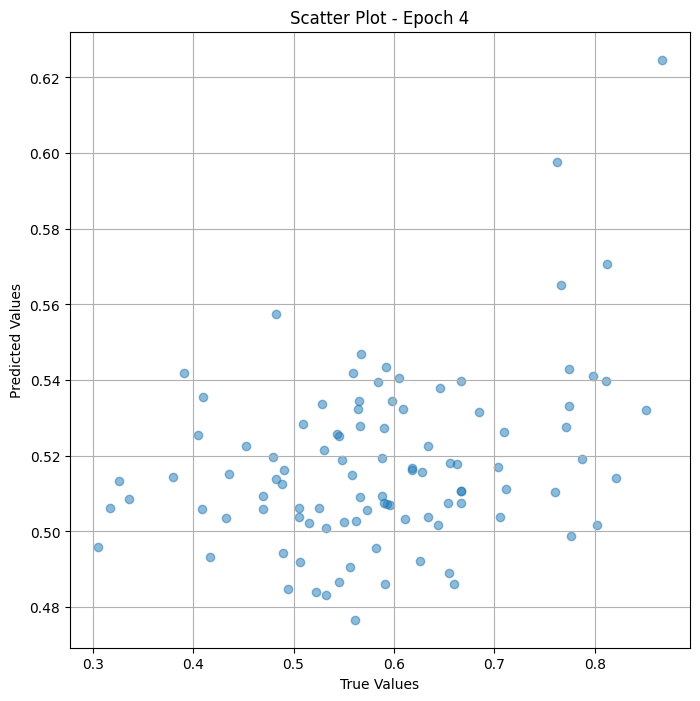

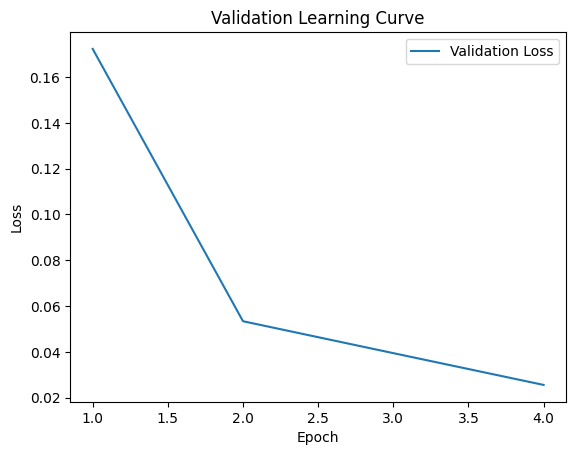


 Epoch: (5/50) Loss = 0.009702982380986214

 Epoch: (5/50) Loss_rmse = 0.0985037162899971

 Epoch: (5/50) R^2 = 0.1596583127975464

 Epoch: (5/50) MAE = 0.07933023571968079
Spearman correlation coefficient: SignificanceResult(statistic=0.2506426650861821, pvalue=0.013775346481236968)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.4166

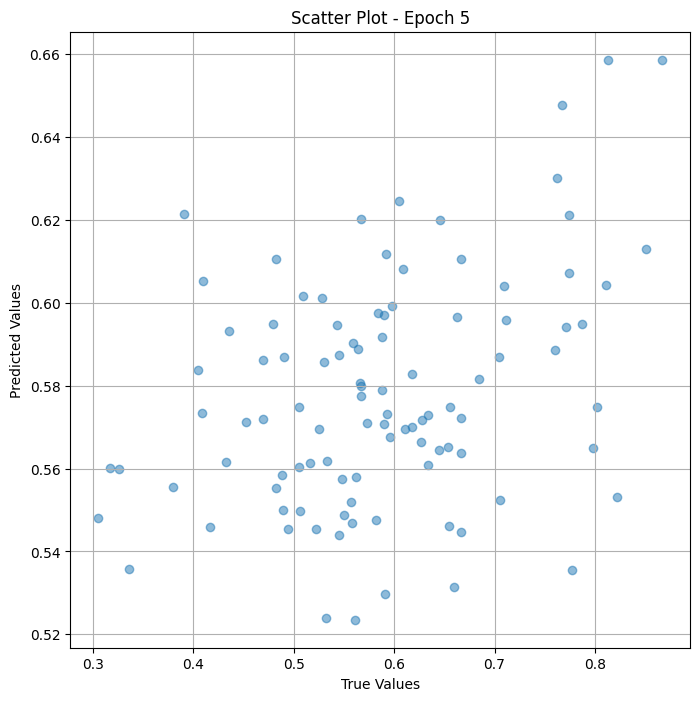

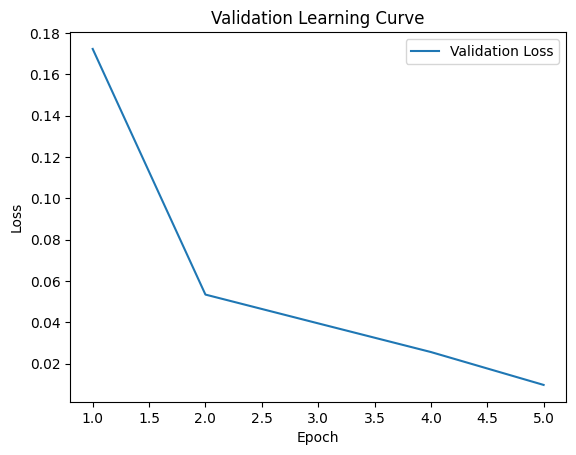


 Epoch: (6/50) Loss = 0.0049565695226192474

 Epoch: (6/50) Loss_rmse = 0.07040290534496307

 Epoch: (6/50) R^2 = 0.5707286596298218

 Epoch: (6/50) MAE = 0.06818625330924988
Spearman correlation coefficient: SignificanceResult(statistic=0.3281558406498682, pvalue=0.0010984218567944089)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.4

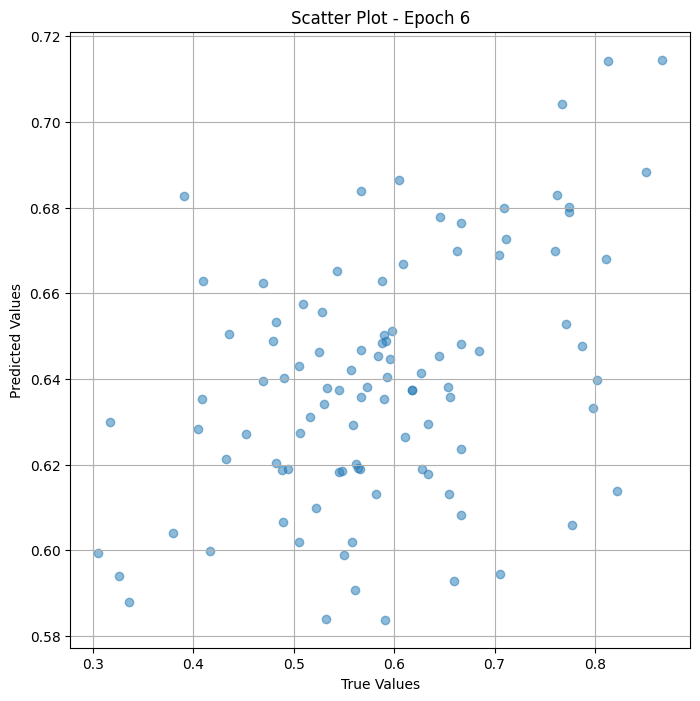

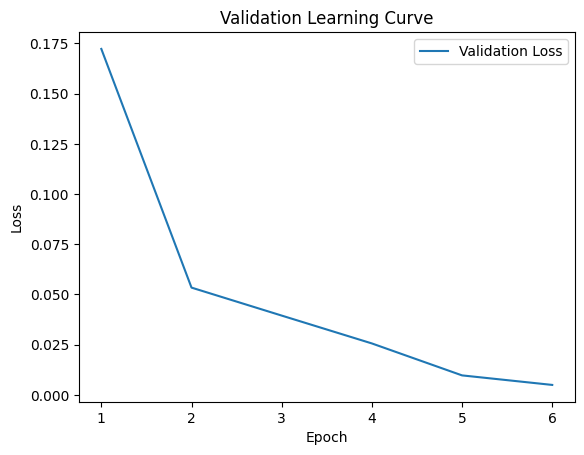


 Epoch: (7/50) Loss = 0.003965908661484718

 Epoch: (7/50) Loss_rmse = 0.0629754588007927

 Epoch: (7/50) R^2 = 0.6565263867378235

 Epoch: (7/50) MAE = 0.05732870101928711
Spearman correlation coefficient: SignificanceResult(statistic=0.418990321499438, pvalue=2.1503585205734224e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.416

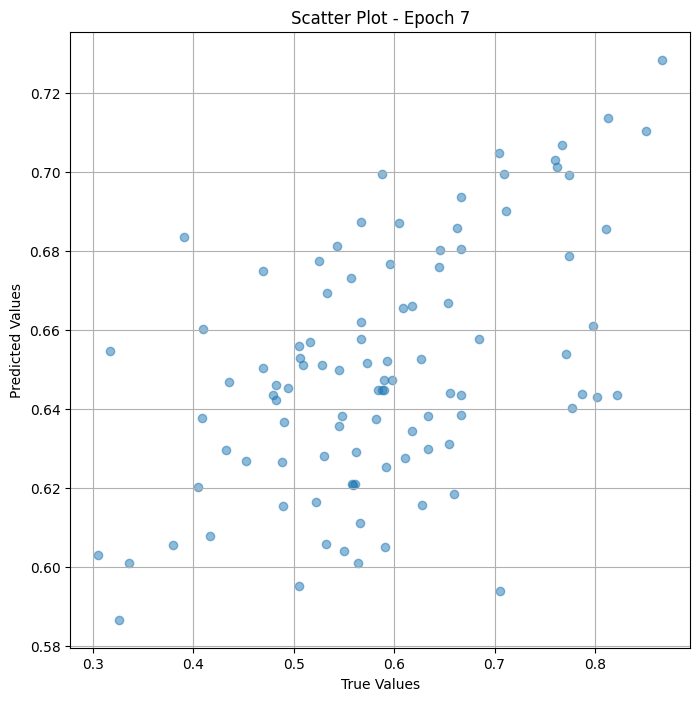

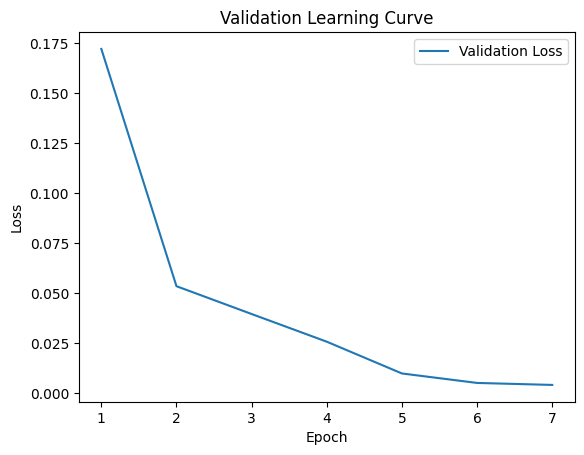


 Epoch: (8/50) Loss = 0.0053498814813792706

 Epoch: (8/50) Loss_rmse = 0.0731428861618042

 Epoch: (8/50) R^2 = 0.5366653203964233

 Epoch: (8/50) MAE = 0.053672343492507935
Spearman correlation coefficient: SignificanceResult(statistic=0.5073016223254085, pvalue=1.3288154472287388e-07)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.

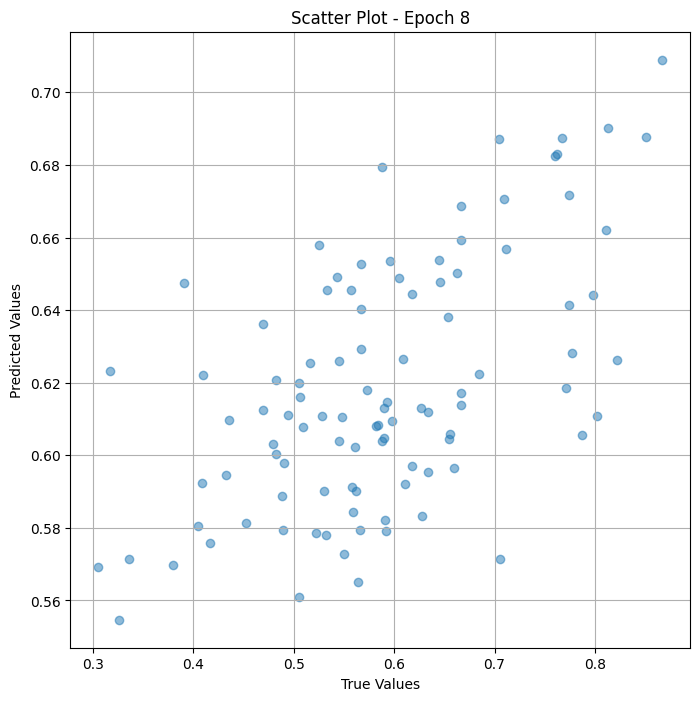

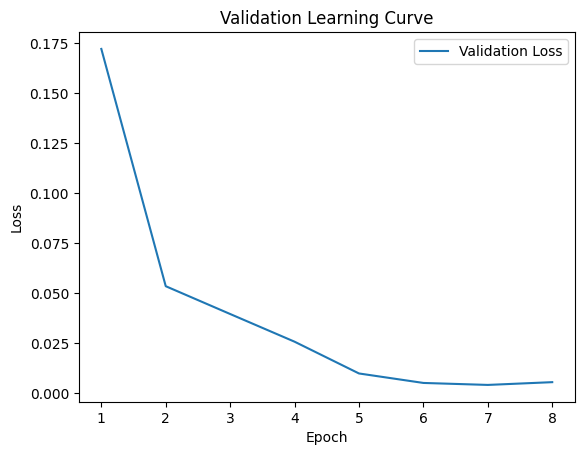


 Epoch: (9/50) Loss = 0.0064904456958174706

 Epoch: (9/50) Loss_rmse = 0.08056329935789108

 Epoch: (9/50) R^2 = 0.43788498640060425

 Epoch: (9/50) MAE = 0.06926785409450531
Spearman correlation coefficient: SignificanceResult(statistic=0.5683734312837064, pvalue=1.5373614848378261e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0

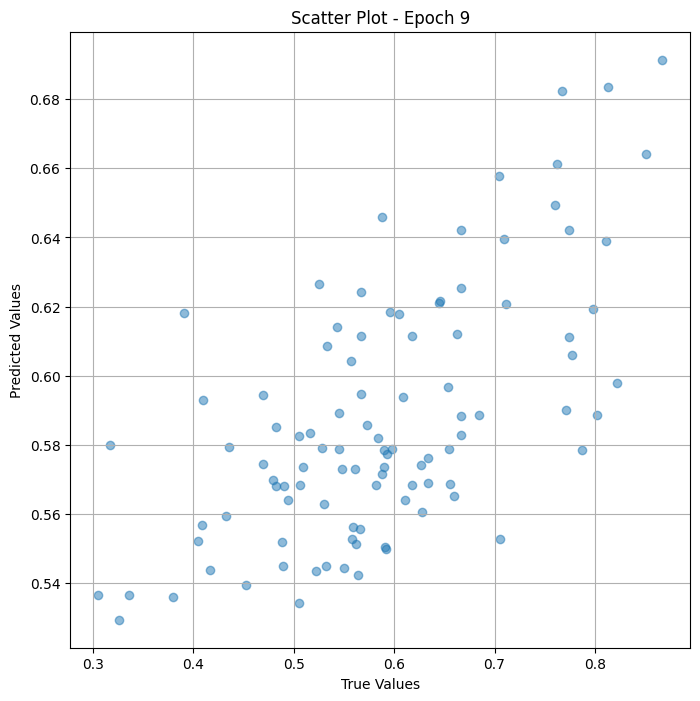

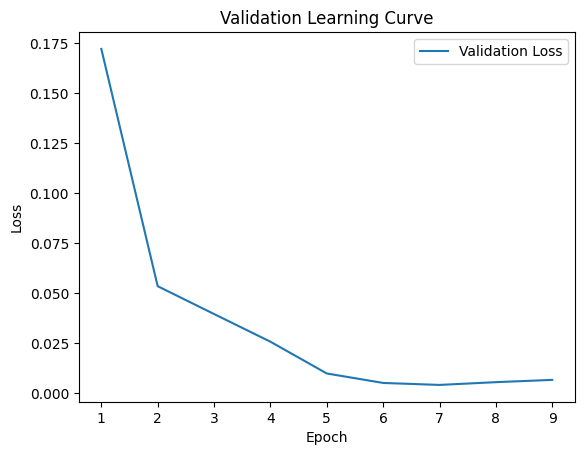

Epoch 0.07: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (10/50) Loss = 0.004384446889162064

 Epoch: (10/50) Loss_rmse = 0.0662151575088501

 Epoch: (10/50) R^2 = 0.6202782392501831

 Epoch: (10/50) MAE = 0.05903443694114685
Spearman correlation coefficient: SignificanceResult(statistic=0.6270238013483891, pvalue=8.217422370760229e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117

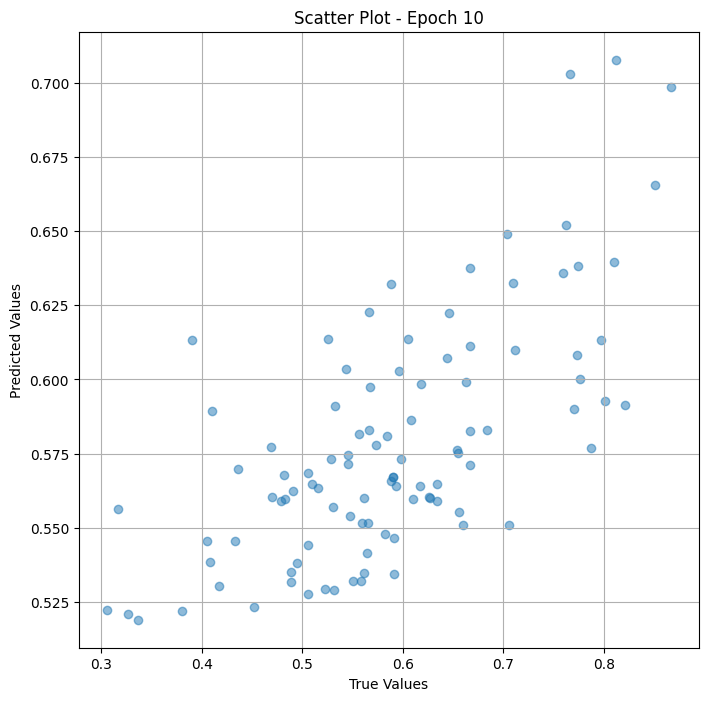

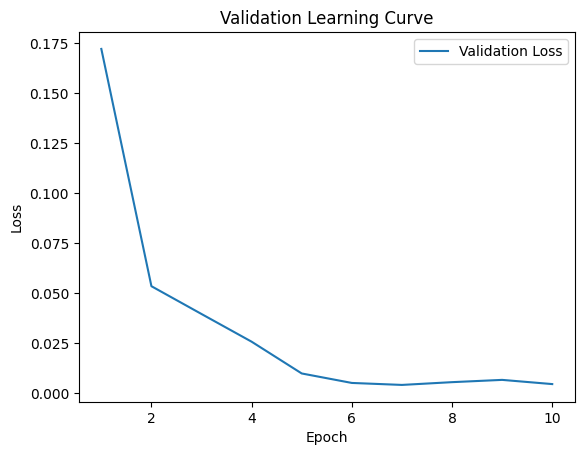


 Epoch: (11/50) Loss = 0.003130642231553793

 Epoch: (11/50) Loss_rmse = 0.05595214292407036

 Epoch: (11/50) R^2 = 0.728865921497345

 Epoch: (11/50) MAE = 0.049739837646484375
Spearman correlation coefficient: SignificanceResult(statistic=0.6577971017975003, pvalue=3.308960677694288e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 

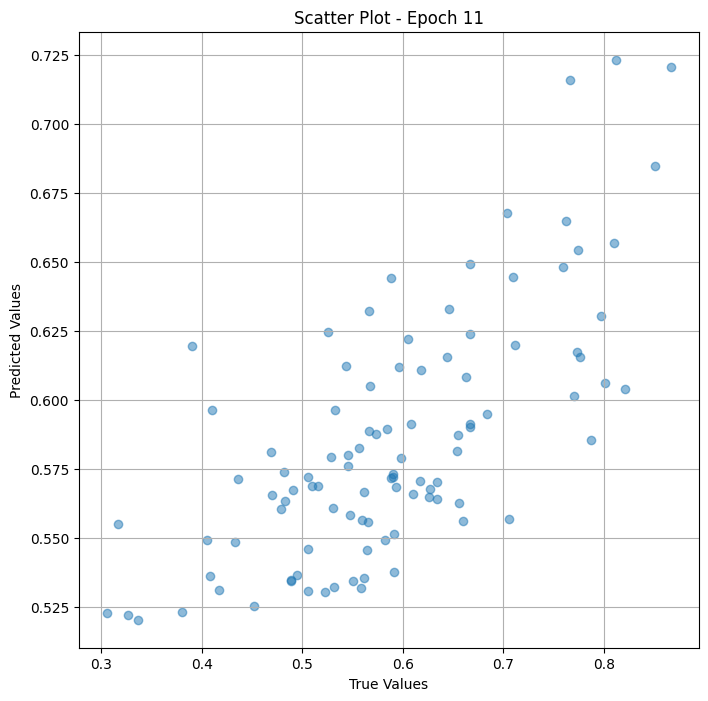

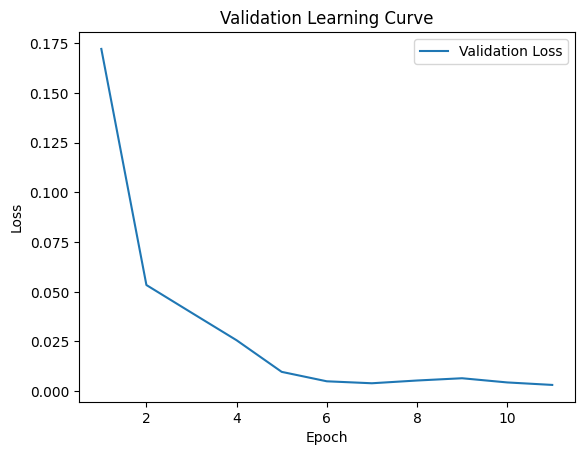


 Epoch: (12/50) Loss = 0.0027286307886242867

 Epoch: (12/50) Loss_rmse = 0.052236296236515045

 Epoch: (12/50) R^2 = 0.7636827230453491

 Epoch: (12/50) MAE = 0.04624427855014801
Spearman correlation coefficient: SignificanceResult(statistic=0.659669138589203, pvalue=2.6889286710108766e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

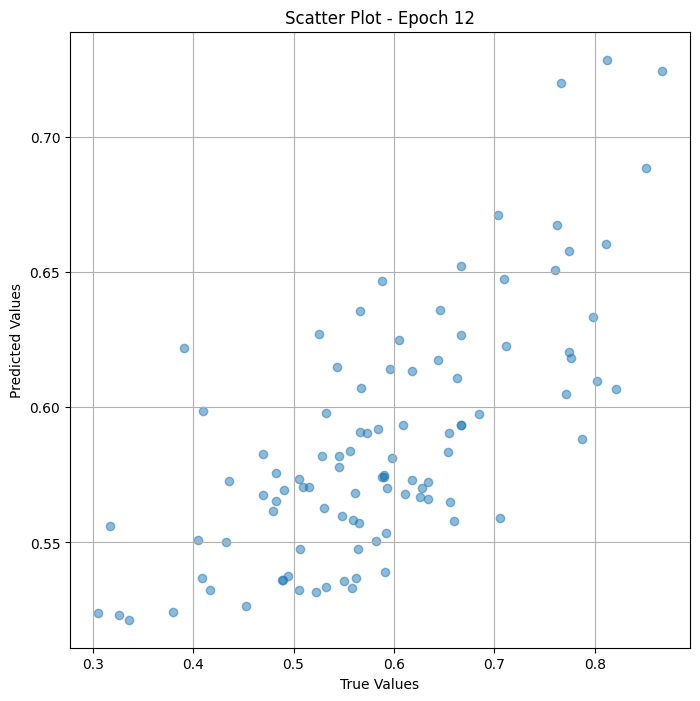

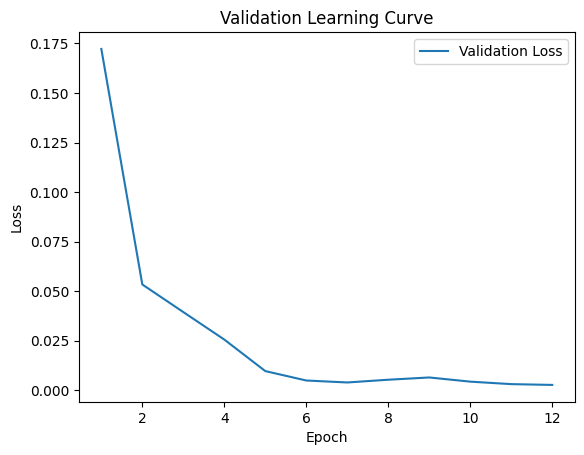


 Epoch: (13/50) Loss = 0.0023257071152329445

 Epoch: (13/50) Loss_rmse = 0.048225585371255875

 Epoch: (13/50) R^2 = 0.7985785603523254

 Epoch: (13/50) MAE = 0.04242794215679169
Spearman correlation coefficient: SignificanceResult(statistic=0.6655701241282657, pvalue=1.3845407746994254e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

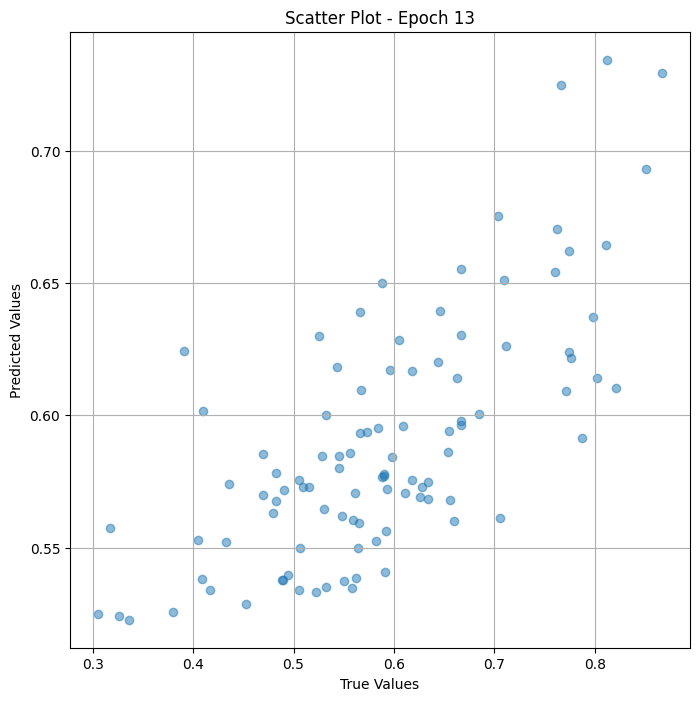

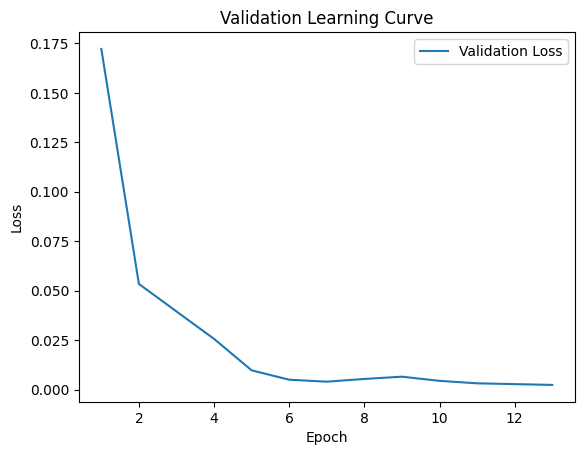


 Epoch: (14/50) Loss = 0.001957353437319398

 Epoch: (14/50) Loss_rmse = 0.04424198716878891

 Epoch: (14/50) R^2 = 0.8304803967475891

 Epoch: (14/50) MAE = 0.03863723576068878
Spearman correlation coefficient: SignificanceResult(statistic=0.6696465520696179, pvalue=8.676297941223564e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 

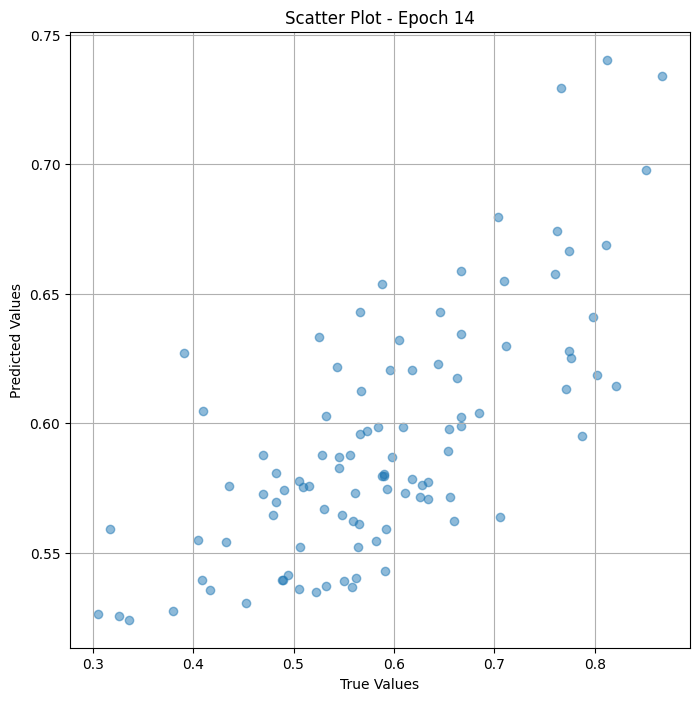

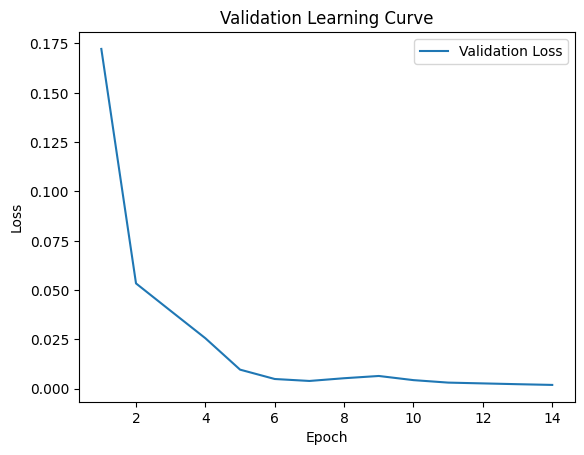


 Epoch: (15/50) Loss = 0.0016427477821707726

 Epoch: (15/50) Loss_rmse = 0.04053082689642906

 Epoch: (15/50) R^2 = 0.8577272891998291

 Epoch: (15/50) MAE = 0.035139620304107666
Spearman correlation coefficient: SignificanceResult(statistic=0.6740485516269187, pvalue=5.1944414487988685e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

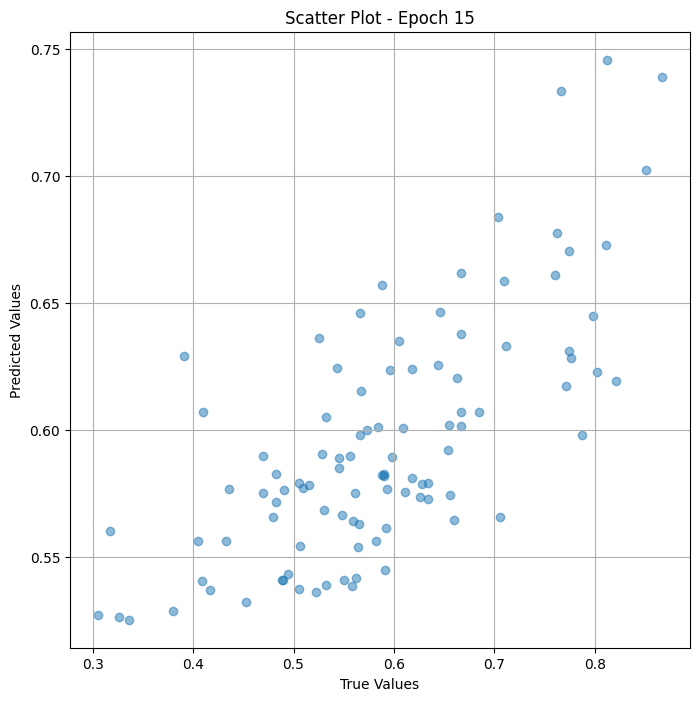

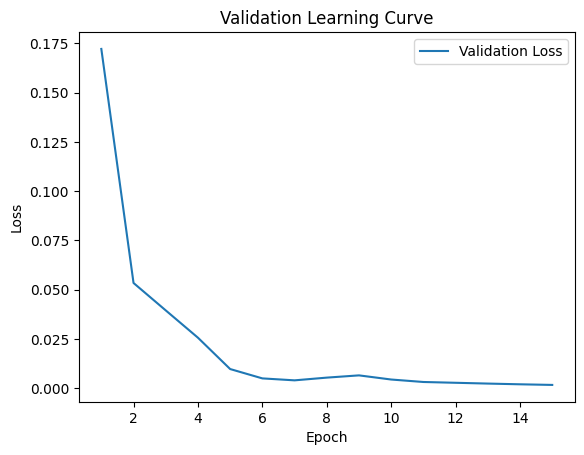


 Epoch: (16/50) Loss = 0.0013879634207114577

 Epoch: (16/50) Loss_rmse = 0.03725538030266762

 Epoch: (16/50) R^2 = 0.8797932863235474

 Epoch: (16/50) MAE = 0.03211696445941925
Spearman correlation coefficient: SignificanceResult(statistic=0.6804853737838961, pvalue=2.4143520340470245e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

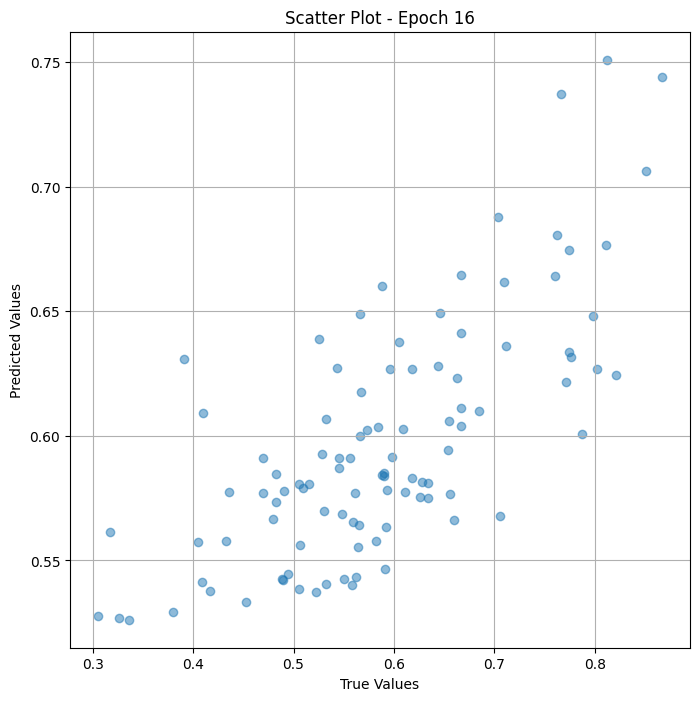

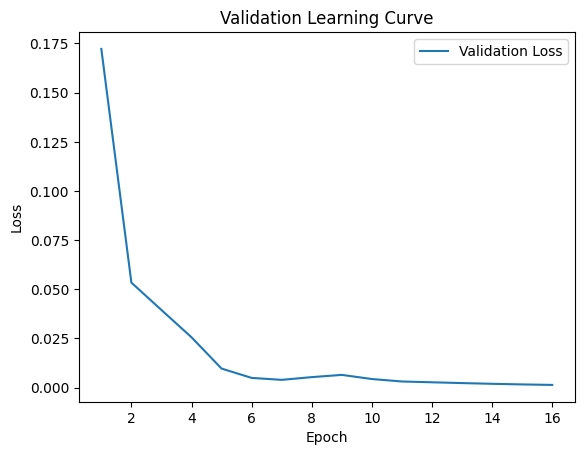


 Epoch: (17/50) Loss = 0.0011899846140295267

 Epoch: (17/50) Loss_rmse = 0.03449615463614464

 Epoch: (17/50) R^2 = 0.8969395756721497

 Epoch: (17/50) MAE = 0.02966180443763733
Spearman correlation coefficient: SignificanceResult(statistic=0.6903430390105061, pvalue=7.186822794763592e-15)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714,

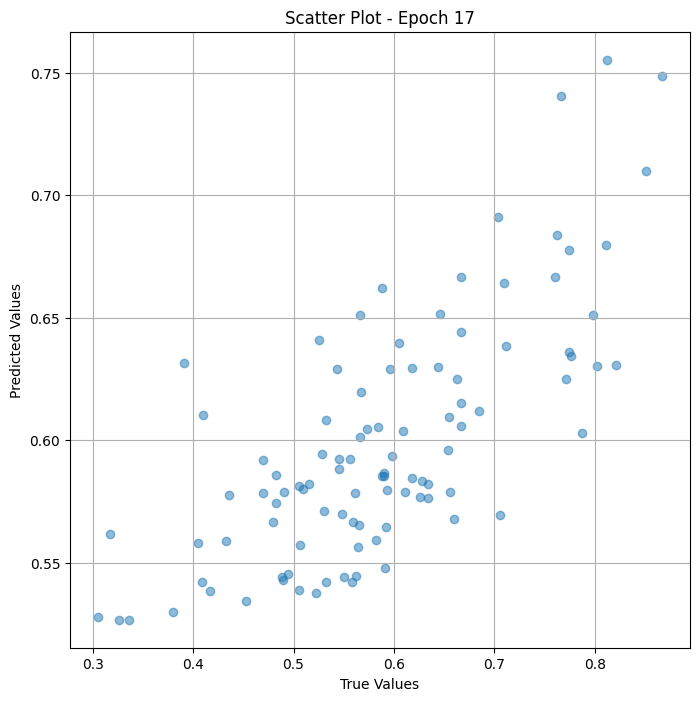

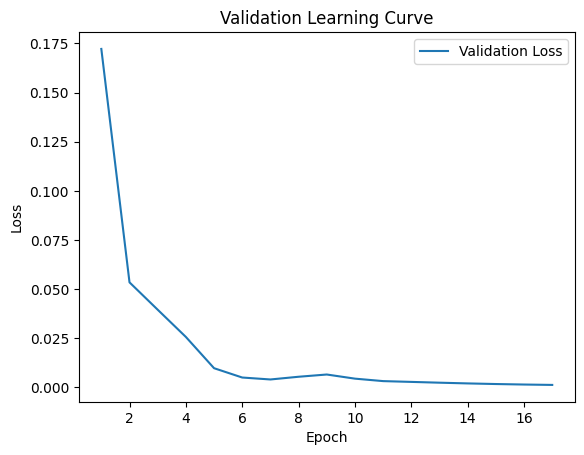


 Epoch: (18/50) Loss = 0.0010405967477709055

 Epoch: (18/50) Loss_rmse = 0.0322582833468914

 Epoch: (18/50) R^2 = 0.9098775386810303

 Epoch: (18/50) MAE = 0.027780994772911072
Spearman correlation coefficient: SignificanceResult(statistic=0.6967910855493056, pvalue=3.1684983645561084e-15)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

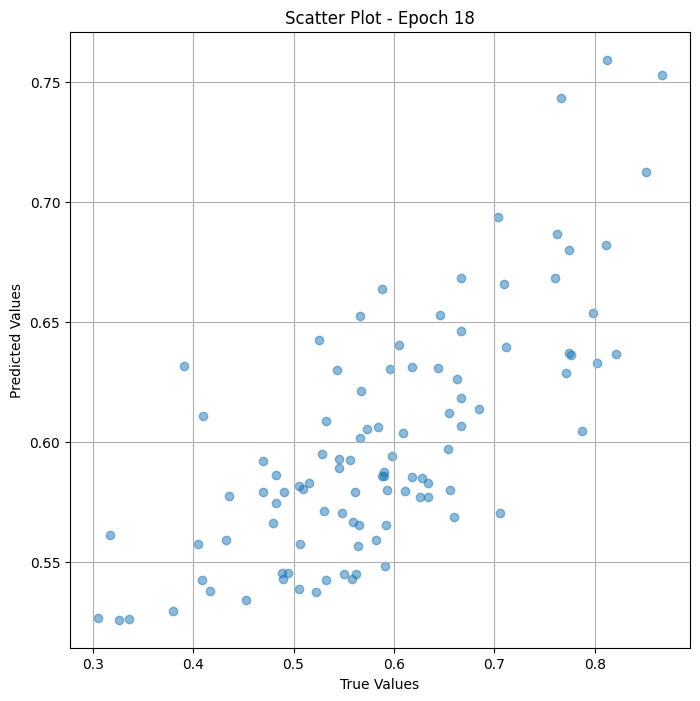

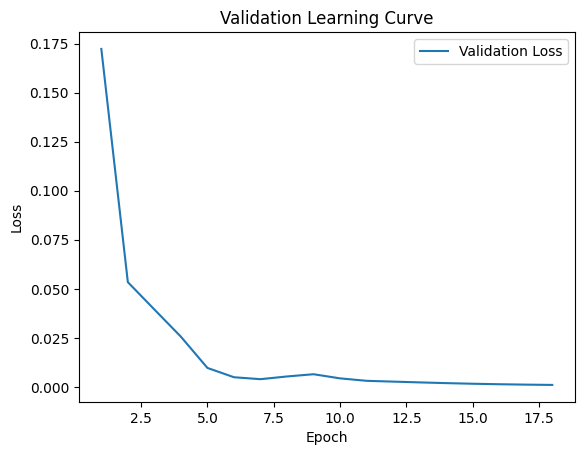


 Epoch: (19/50) Loss = 0.0009297470096498728

 Epoch: (19/50) Loss_rmse = 0.030491752550005913

 Epoch: (19/50) R^2 = 0.9194778203964233

 Epoch: (19/50) MAE = 0.02641347050666809
Spearman correlation coefficient: SignificanceResult(statistic=0.7093798546993058, pvalue=6.00765703881057e-16)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714,

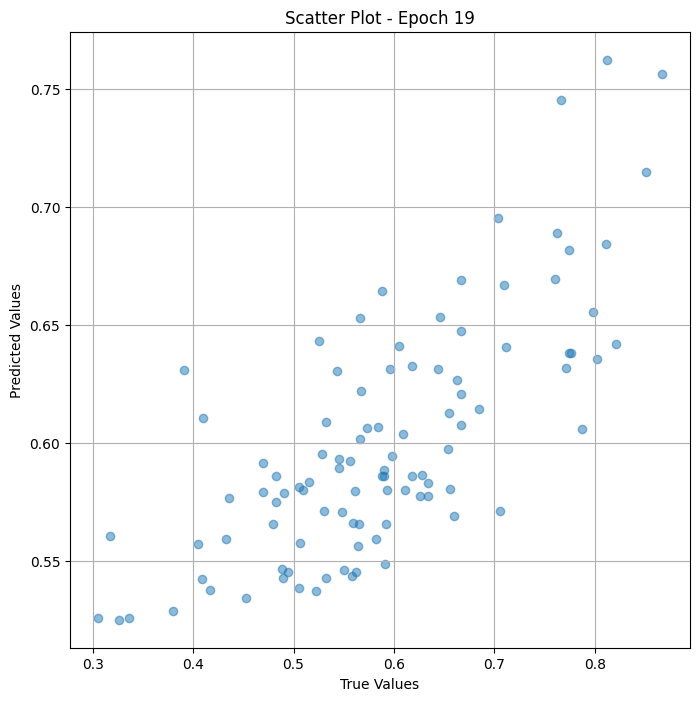

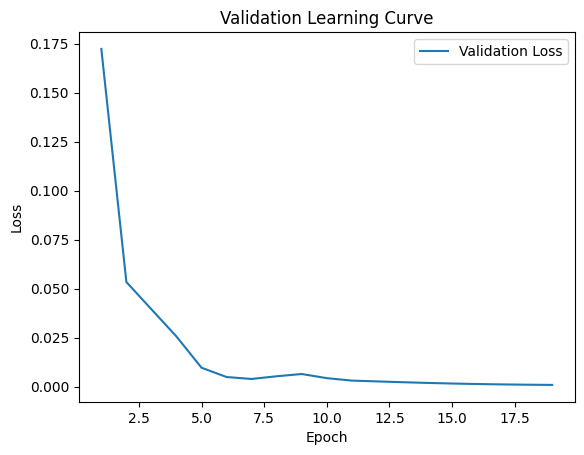


 Epoch: (20/50) Loss = 0.0008476119837723672

 Epoch: (20/50) Loss_rmse = 0.029113776981830597

 Epoch: (20/50) R^2 = 0.9265912771224976

 Epoch: (20/50) MAE = 0.02545444667339325
Spearman correlation coefficient: SignificanceResult(statistic=0.7138700299025925, pvalue=3.249289360738616e-16)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

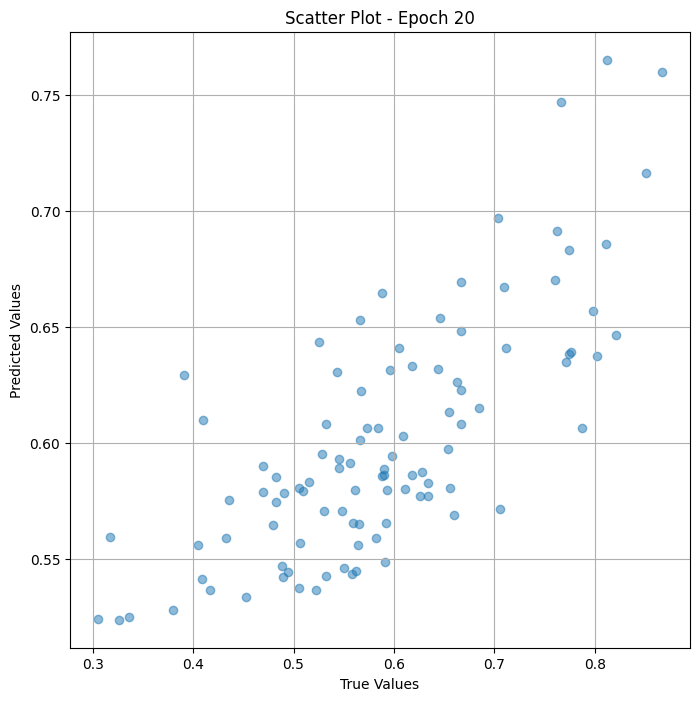

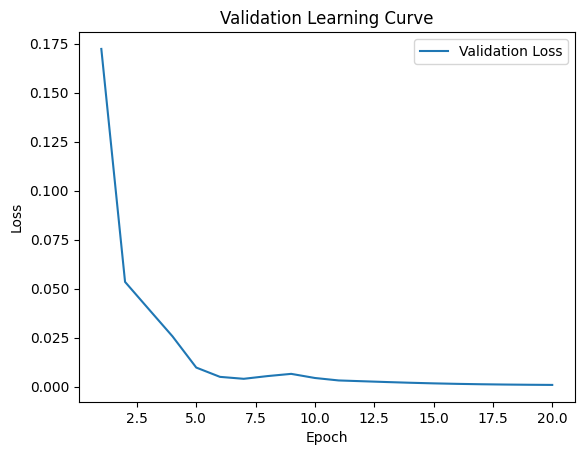


 Epoch: (21/50) Loss = 0.0007854186114855111

 Epoch: (21/50) Loss_rmse = 0.028025321662425995

 Epoch: (21/50) R^2 = 0.9319776296615601

 Epoch: (21/50) MAE = 0.02477879822254181
Spearman correlation coefficient: SignificanceResult(statistic=0.718821431561806, pvalue=1.6273267371159366e-16)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

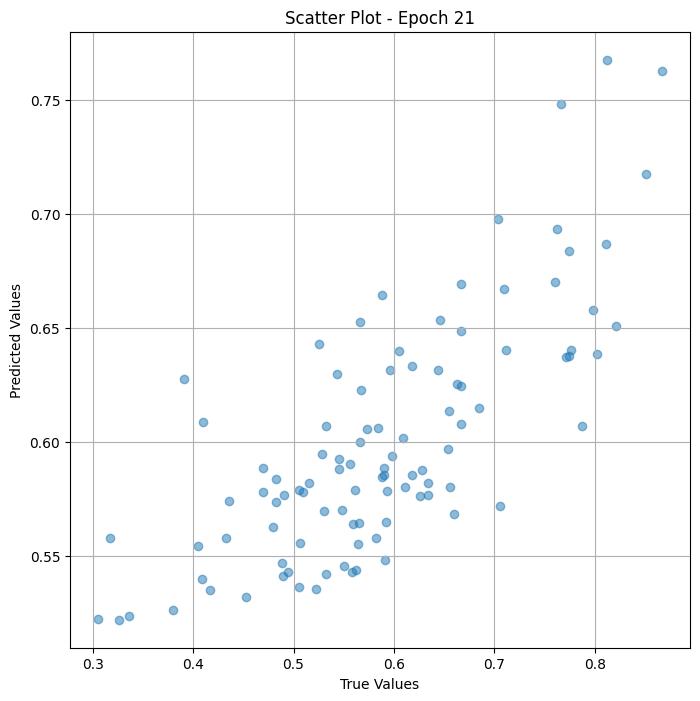

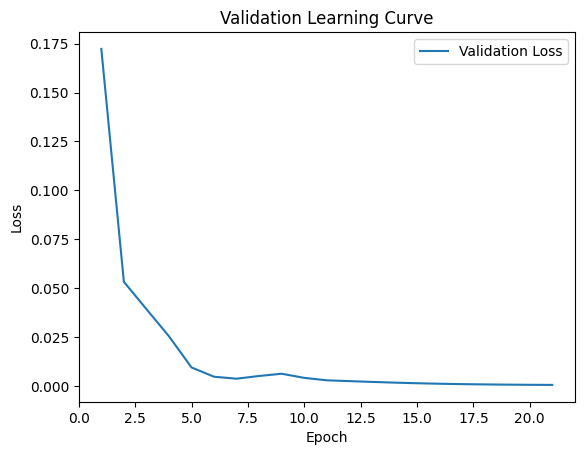


 Epoch: (22/50) Loss = 0.0007356315618380904

 Epoch: (22/50) Loss_rmse = 0.027122529223561287

 Epoch: (22/50) R^2 = 0.9362894892692566

 Epoch: (22/50) MAE = 0.02425926923751831
Spearman correlation coefficient: SignificanceResult(statistic=0.726343492438611, pvalue=5.530533627941903e-17)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714,

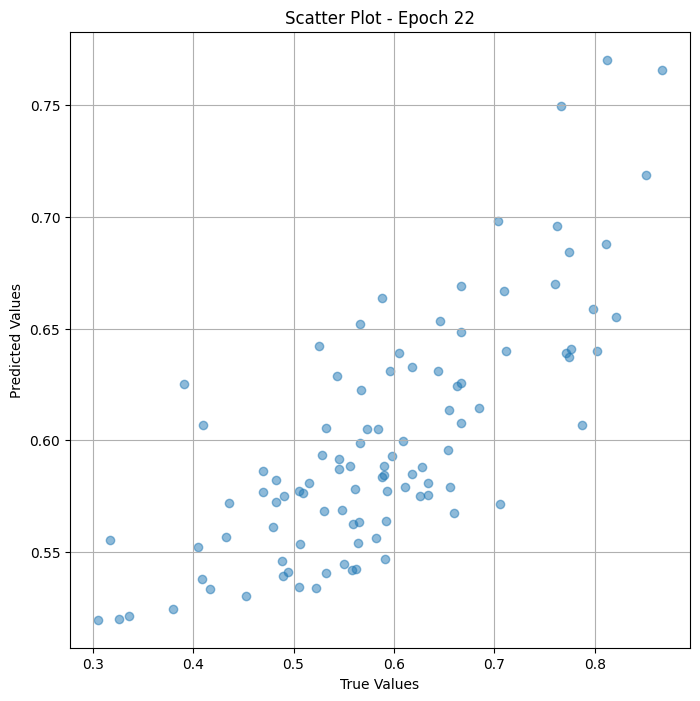

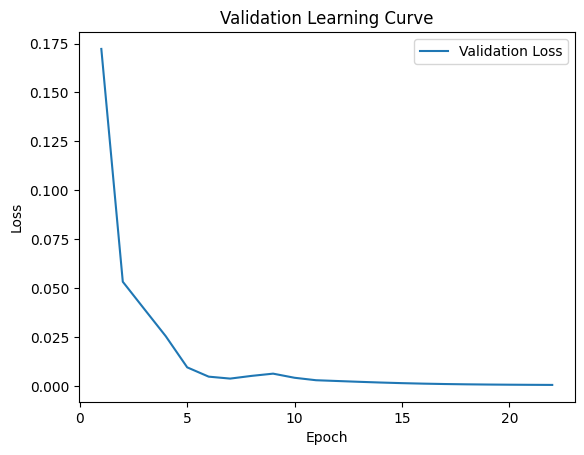


 Epoch: (23/50) Loss = 0.0006920051528140903

 Epoch: (23/50) Loss_rmse = 0.026305990293622017

 Epoch: (23/50) R^2 = 0.9400678277015686

 Epoch: (23/50) MAE = 0.023779243230819702
Spearman correlation coefficient: SignificanceResult(statistic=0.7330244933075494, pvalue=2.0571534427442122e-17)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

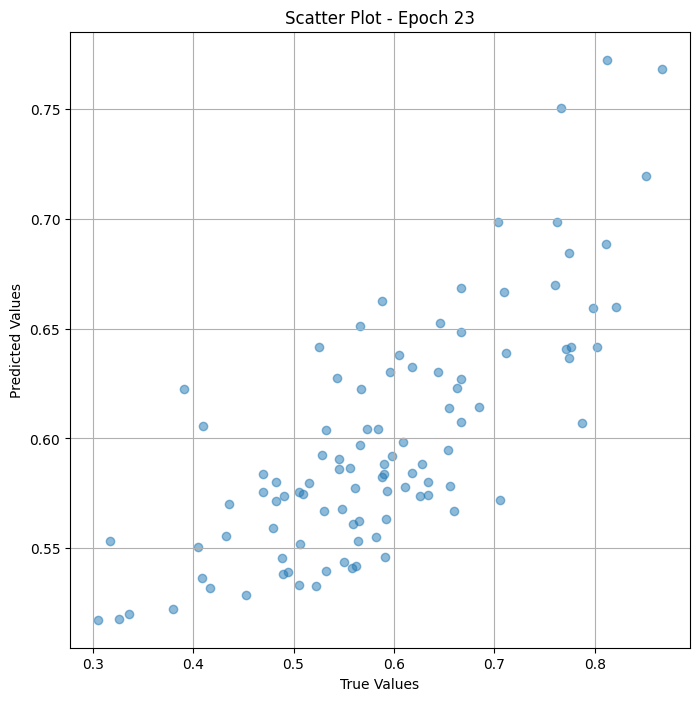

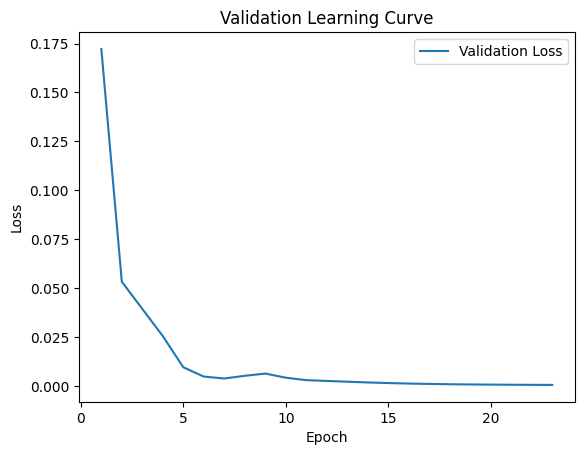


 Epoch: (24/50) Loss = 0.0006498618749901652

 Epoch: (24/50) Loss_rmse = 0.025492388755083084

 Epoch: (24/50) R^2 = 0.9437177181243896

 Epoch: (24/50) MAE = 0.023244589567184448
Spearman correlation coefficient: SignificanceResult(statistic=0.7401463724064182, pvalue=6.93472394241428e-18)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

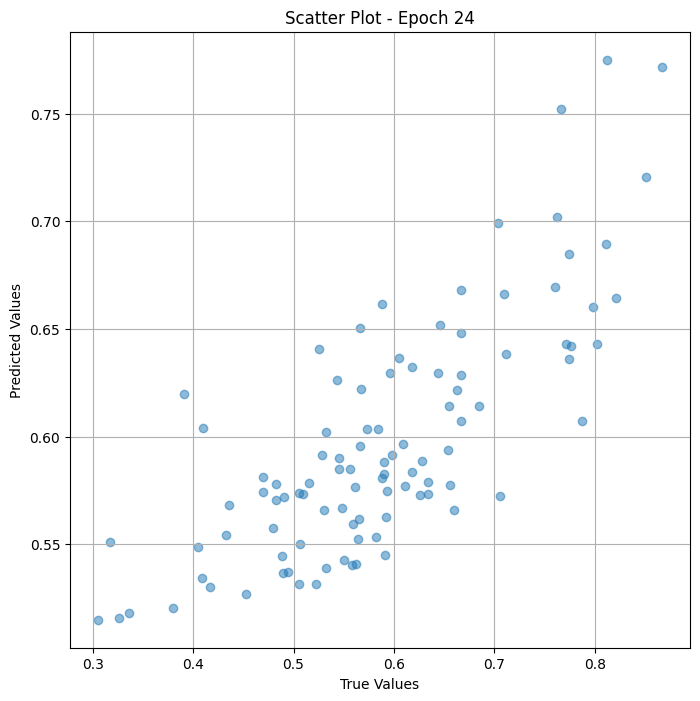

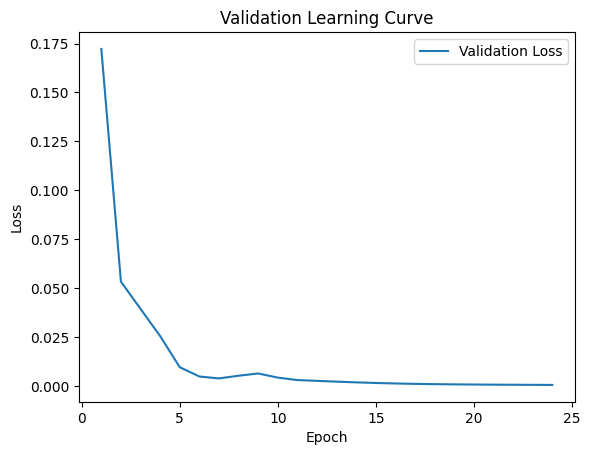


 Epoch: (25/50) Loss = 0.0006063831970095634

 Epoch: (25/50) Loss_rmse = 0.02462484873831272

 Epoch: (25/50) R^2 = 0.947483241558075

 Epoch: (25/50) MAE = 0.022591128945350647
Spearman correlation coefficient: SignificanceResult(statistic=0.7468680697273502, pvalue=2.404314956231085e-18)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714,

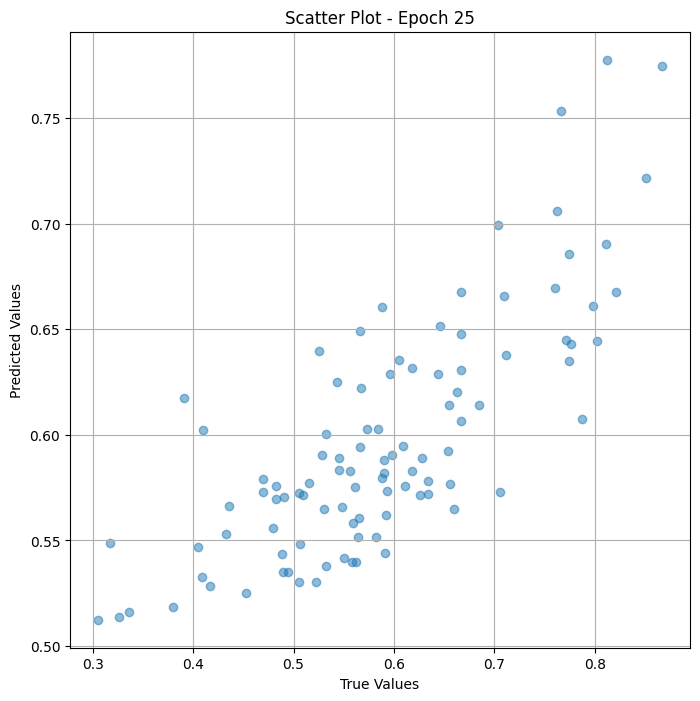

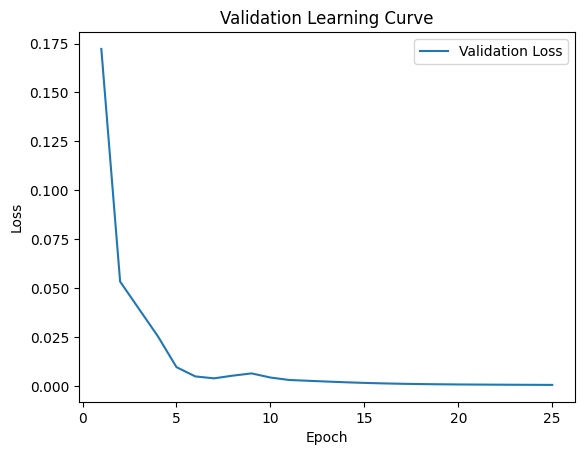


 Epoch: (26/50) Loss = 0.0005606937920674682

 Epoch: (26/50) Loss_rmse = 0.0236789733171463

 Epoch: (26/50) R^2 = 0.9514402747154236

 Epoch: (26/50) MAE = 0.02178773283958435
Spearman correlation coefficient: SignificanceResult(statistic=0.7558552028759226, pvalue=5.531597640732146e-19)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 

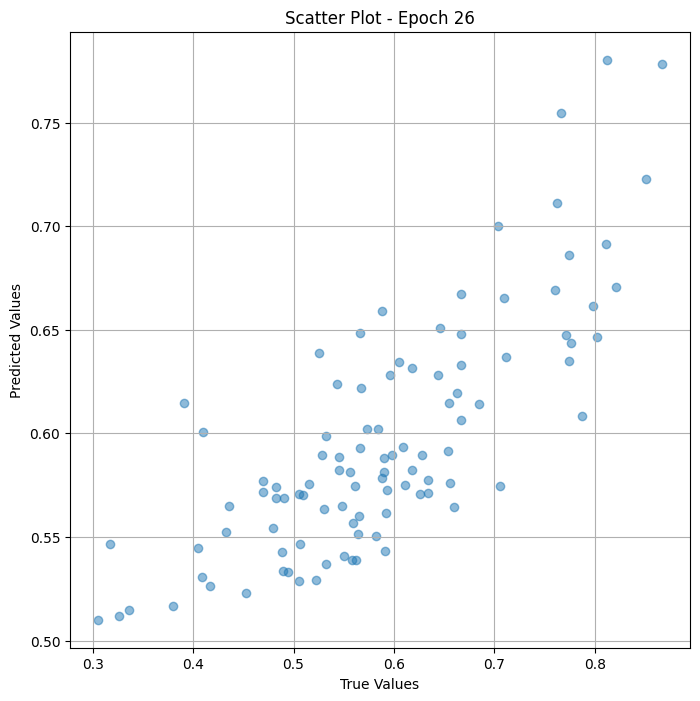

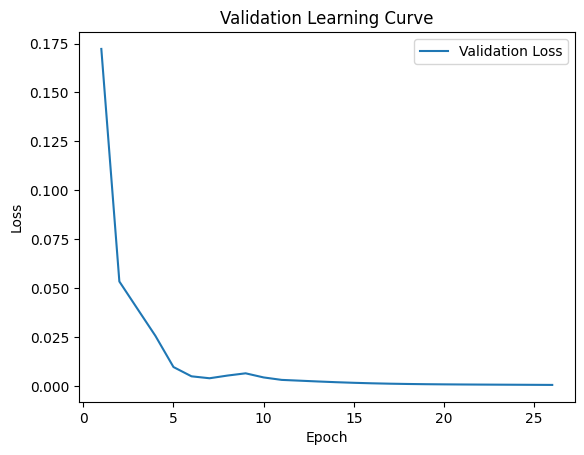


 Epoch: (27/50) Loss = 0.0005134723032824695

 Epoch: (27/50) Loss_rmse = 0.02265992760658264

 Epoch: (27/50) R^2 = 0.9555299282073975

 Epoch: (27/50) MAE = 0.020831987261772156
Spearman correlation coefficient: SignificanceResult(statistic=0.7631398677827653, pvalue=1.6033580744852808e-19)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

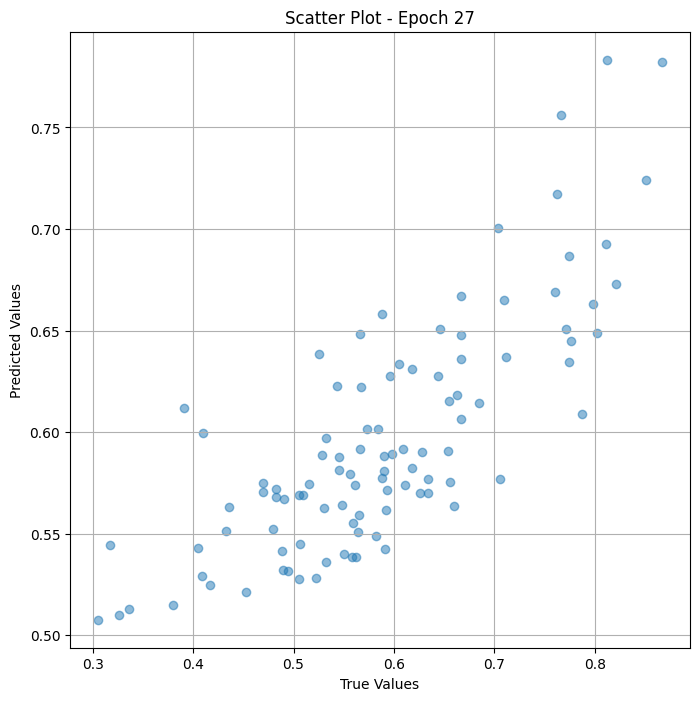

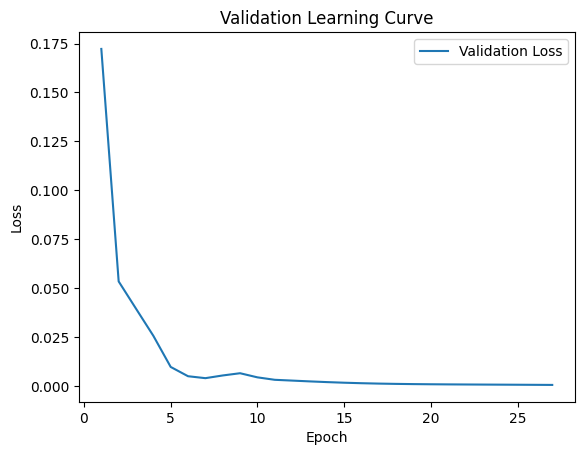


 Epoch: (28/50) Loss = 0.0004666050663217902

 Epoch: (28/50) Loss_rmse = 0.02160104364156723

 Epoch: (28/50) R^2 = 0.9595889449119568

 Epoch: (28/50) MAE = 0.019749224185943604
Spearman correlation coefficient: SignificanceResult(statistic=0.7711231551154969, pvalue=3.9178170463308324e-20)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

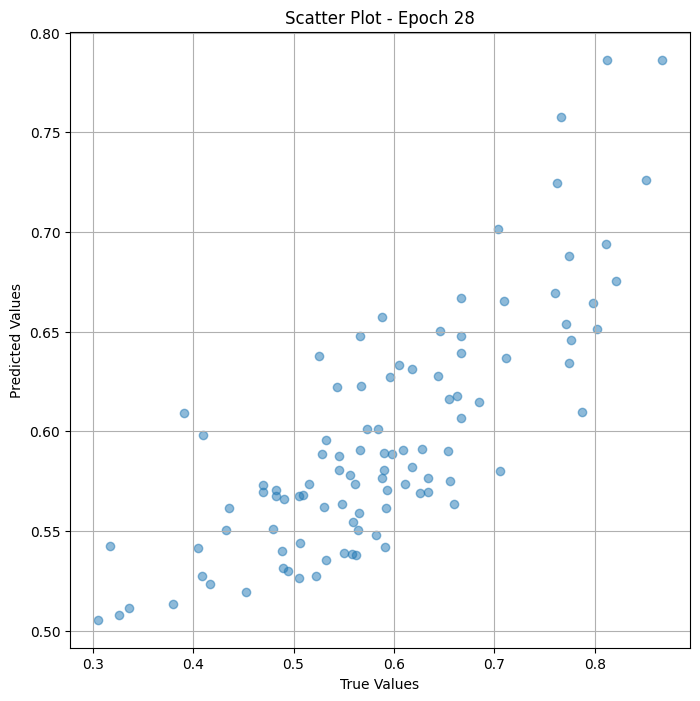

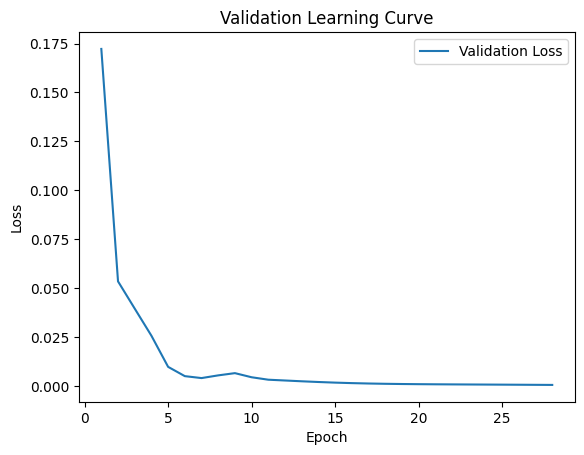


 Epoch: (29/50) Loss = 0.00042218368616886437

 Epoch: (29/50) Loss_rmse = 0.020547108724713326

 Epoch: (29/50) R^2 = 0.9634361267089844

 Epoch: (29/50) MAE = 0.018574312329292297
Spearman correlation coefficient: SignificanceResult(statistic=0.7775124980784821, pvalue=1.2166375501580805e-20)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574

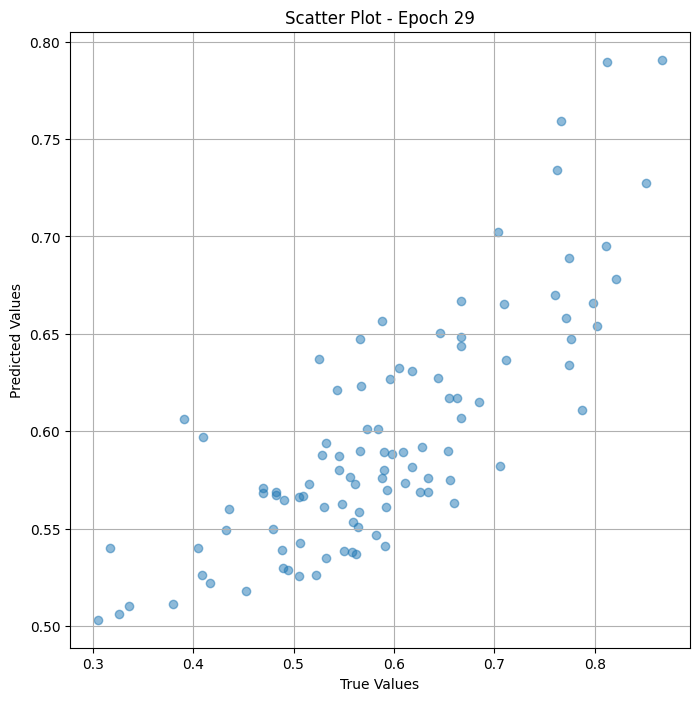

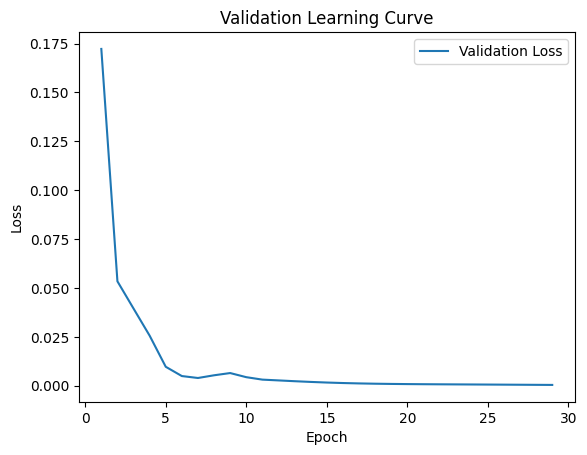


 Epoch: (30/50) Loss = 0.0003822397848125547

 Epoch: (30/50) Loss_rmse = 0.019550953060388565

 Epoch: (30/50) R^2 = 0.9668955206871033

 Epoch: (30/50) MAE = 0.017348110675811768
Spearman correlation coefficient: SignificanceResult(statistic=0.7811005685959119, pvalue=6.2018798734725174e-21)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

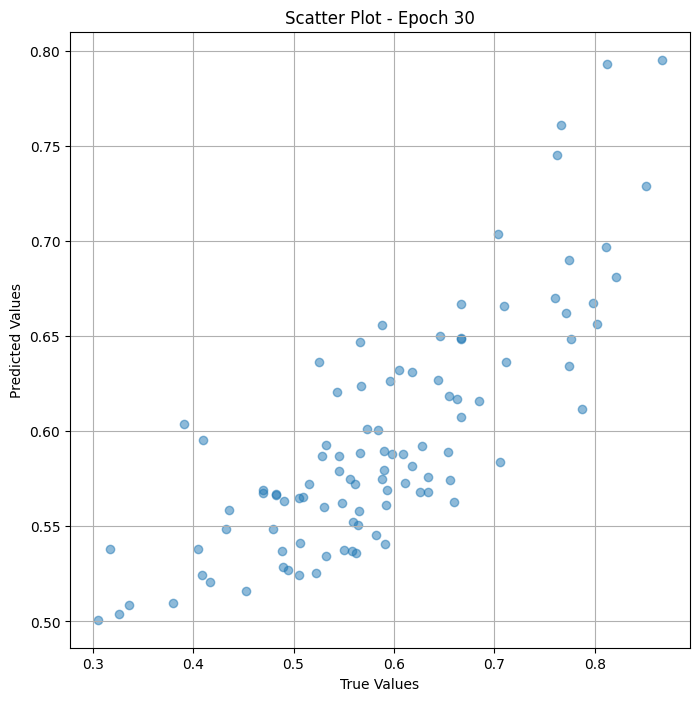

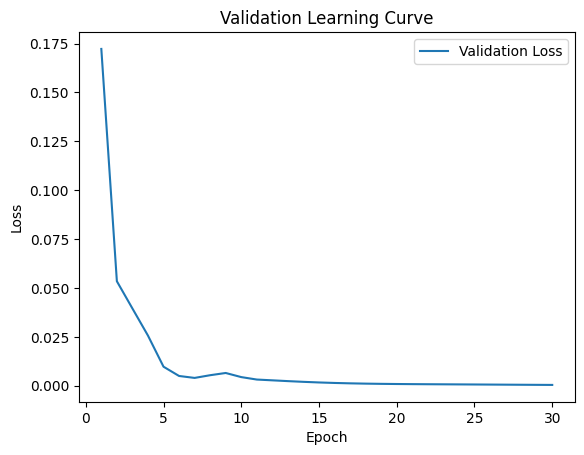


 Epoch: (31/50) Loss = 0.0003484135086182505

 Epoch: (31/50) Loss_rmse = 0.01866583712399006

 Epoch: (31/50) R^2 = 0.9698250889778137

 Epoch: (31/50) MAE = 0.016112208366394043
Spearman correlation coefficient: SignificanceResult(statistic=0.7879307897888269, pvalue=1.6593688372214477e-21)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

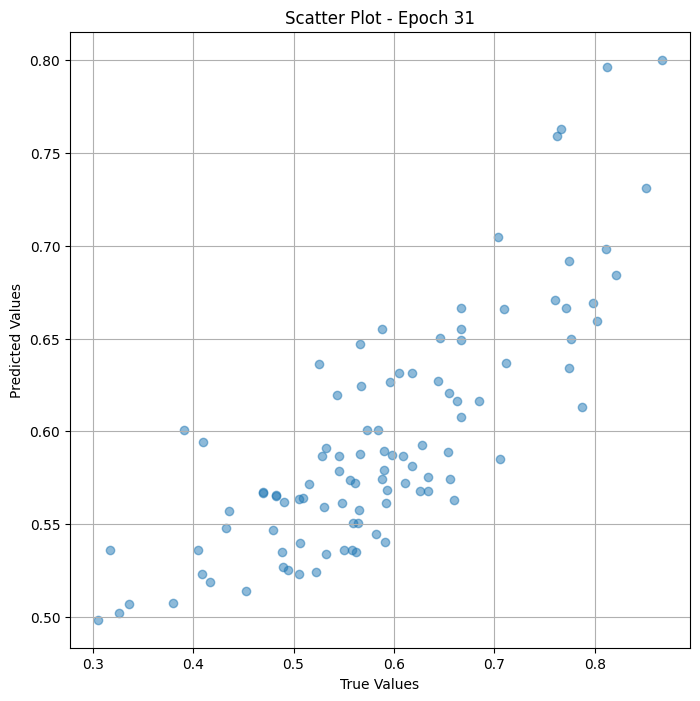

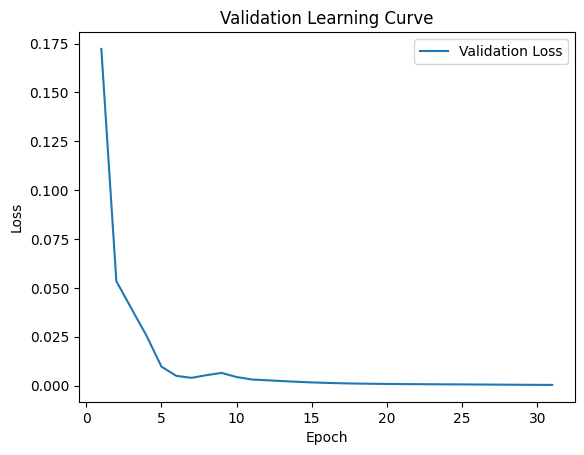


 Epoch: (32/50) Loss = 0.00032173216459341347

 Epoch: (32/50) Loss_rmse = 0.017936894670128822

 Epoch: (32/50) R^2 = 0.9721359014511108

 Epoch: (32/50) MAE = 0.014903217554092407
Spearman correlation coefficient: SignificanceResult(statistic=0.7937978616178948, pvalue=5.140761419669954e-22)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

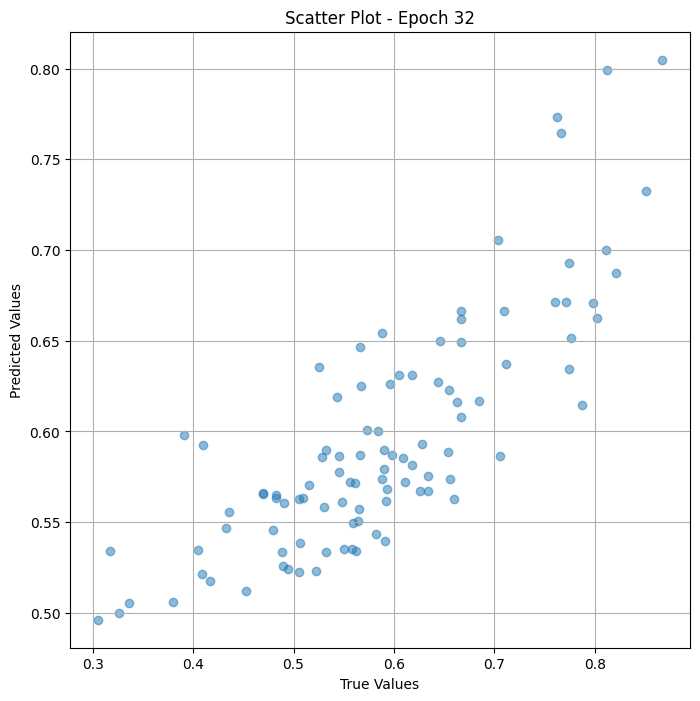

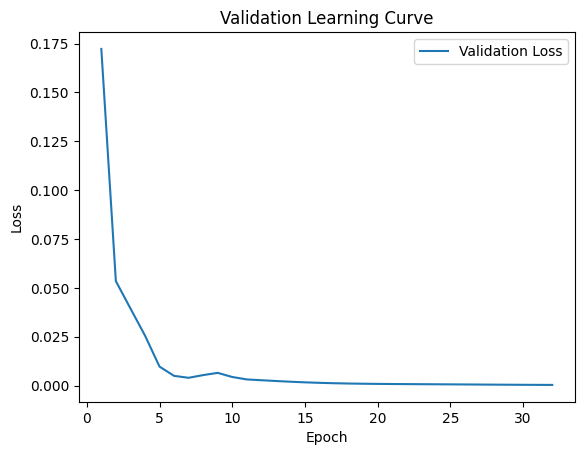


 Epoch: (33/50) Loss = 0.000302487809676677

 Epoch: (33/50) Loss_rmse = 0.017392177134752274

 Epoch: (33/50) R^2 = 0.9738025665283203

 Epoch: (33/50) MAE = 0.013745337724685669
Spearman correlation coefficient: SignificanceResult(statistic=0.7990748348930566, pvalue=1.733947260194059e-22)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

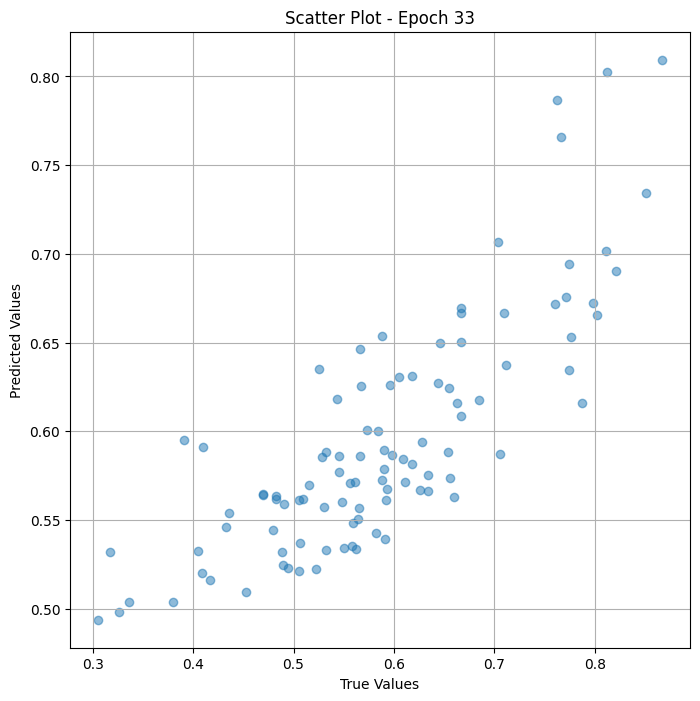

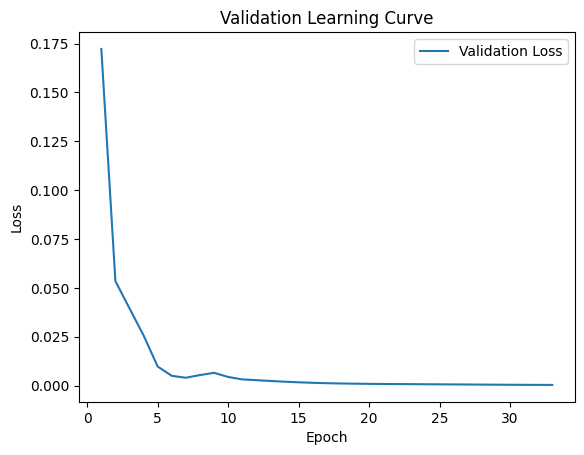


 Epoch: (34/50) Loss = 0.00029039240325801075

 Epoch: (34/50) Loss_rmse = 0.017040904611349106

 Epoch: (34/50) R^2 = 0.9748501181602478

 Epoch: (34/50) MAE = 0.013036161661148071
Spearman correlation coefficient: SignificanceResult(statistic=0.8052335646280782, pvalue=4.6785610093111696e-23)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574

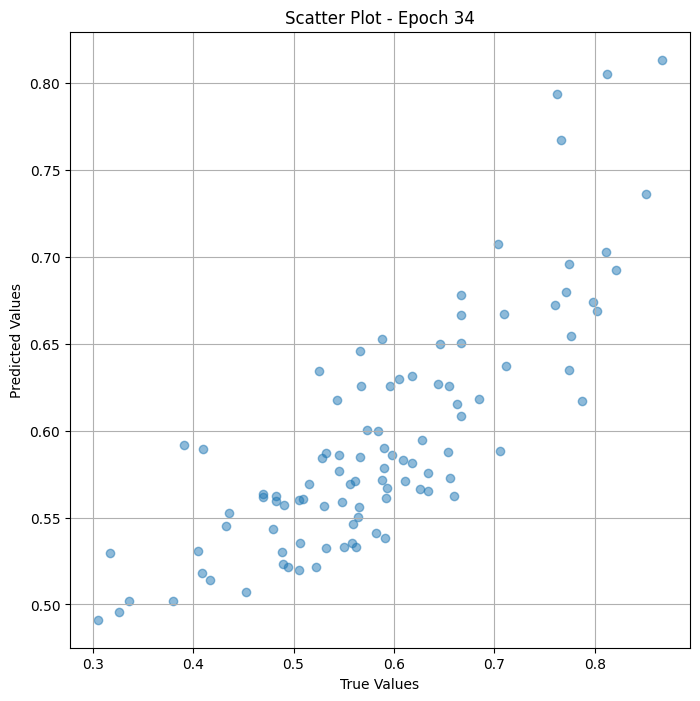

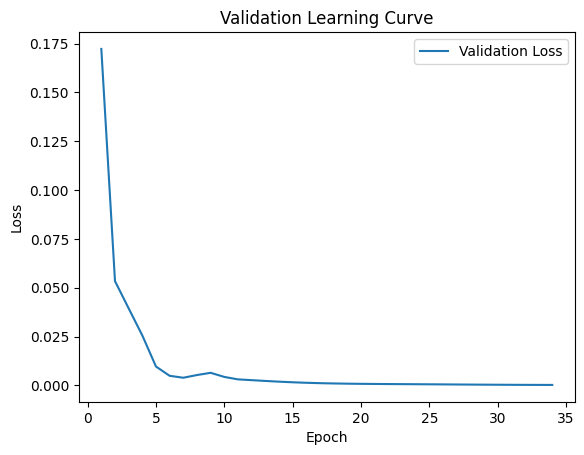


 Epoch: (35/50) Loss = 0.00028464998467825353

 Epoch: (35/50) Loss_rmse = 0.01687157340347767

 Epoch: (35/50) R^2 = 0.9753474593162537

 Epoch: (35/50) MAE = 0.012709081172943115
Spearman correlation coefficient: SignificanceResult(statistic=0.8095880849913865, pvalue=1.800862773860659e-23)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

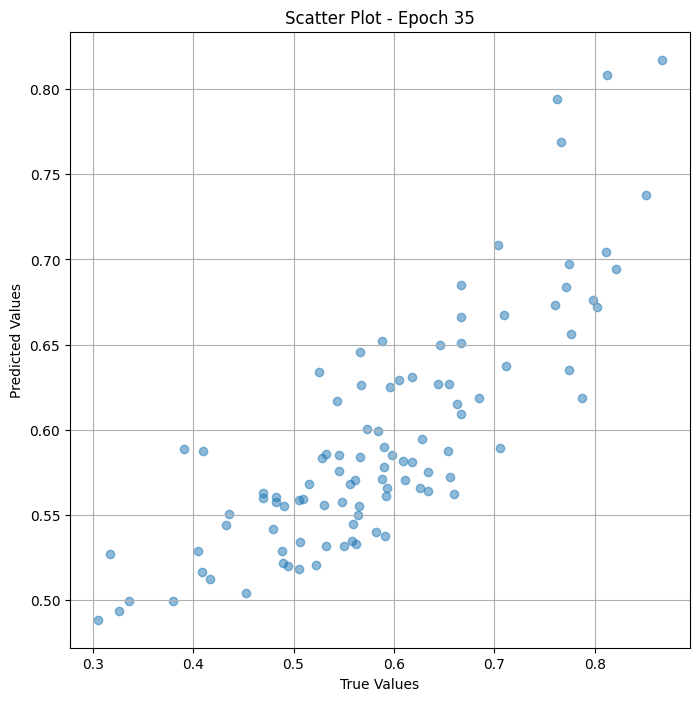

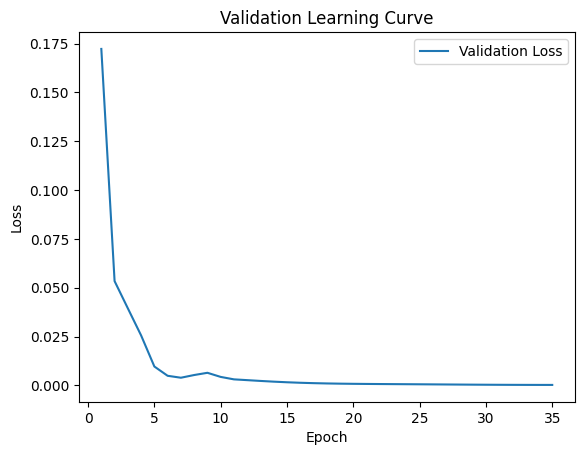


 Epoch: (36/50) Loss = 0.0002836194762494415

 Epoch: (36/50) Loss_rmse = 0.01684100553393364

 Epoch: (36/50) R^2 = 0.9754366874694824

 Epoch: (36/50) MAE = 0.01239188015460968
Spearman correlation coefficient: SignificanceResult(statistic=0.8139629535806914, pvalue=6.730544870471692e-24)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714,

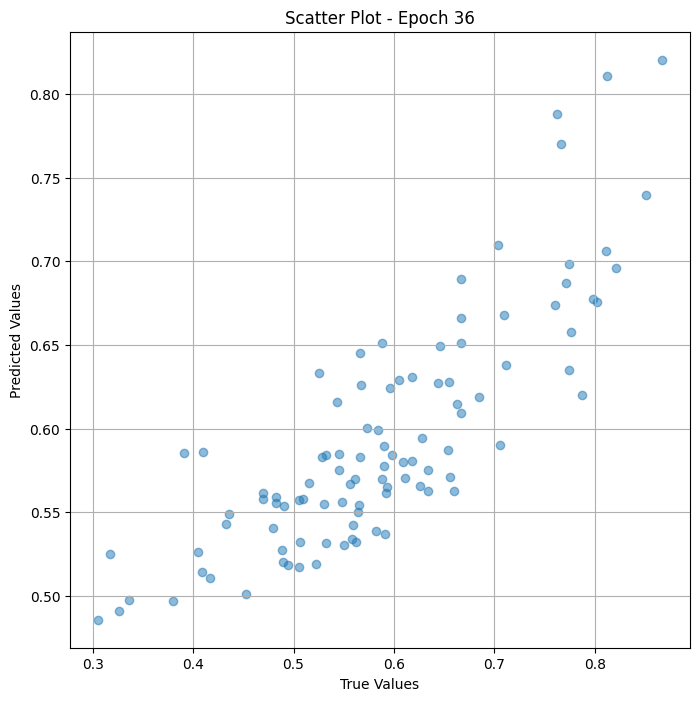

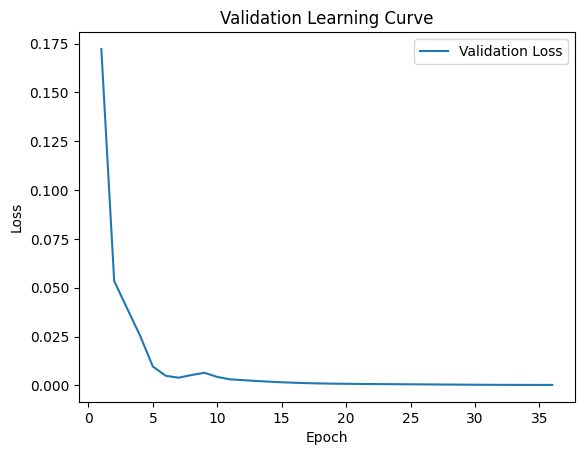


 Epoch: (37/50) Loss = 0.0002849759184755385

 Epoch: (37/50) Loss_rmse = 0.016881229355931282

 Epoch: (37/50) R^2 = 0.9753192067146301

 Epoch: (37/50) MAE = 0.012532293796539307
Spearman correlation coefficient: SignificanceResult(statistic=0.8174628484521353, pvalue=3.005556938191649e-24)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

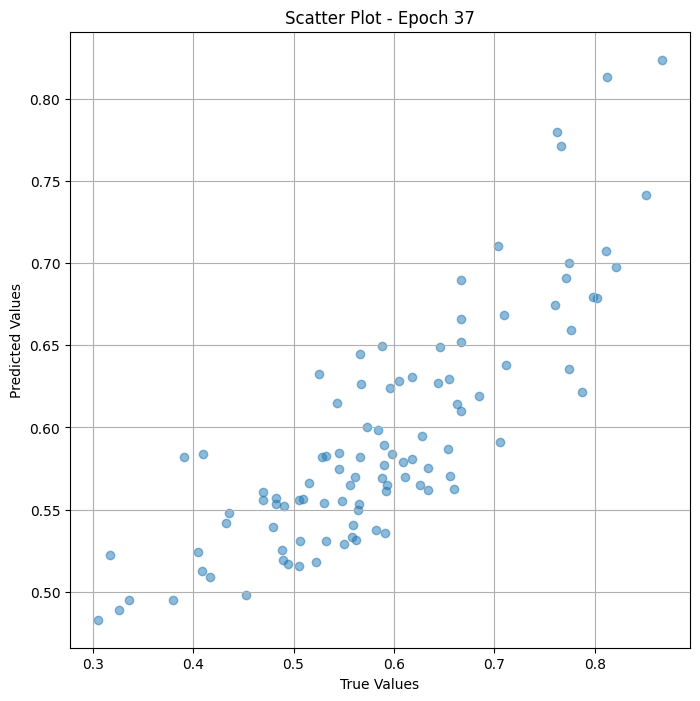

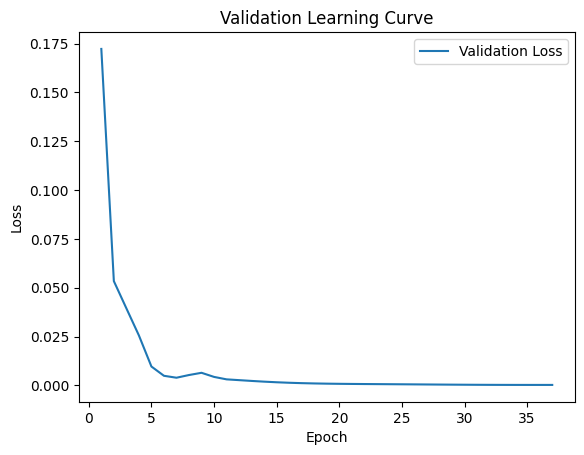


 Epoch: (38/50) Loss = 0.0002865529095288366

 Epoch: (38/50) Loss_rmse = 0.016927873715758324

 Epoch: (38/50) R^2 = 0.9751826524734497

 Epoch: (38/50) MAE = 0.013343960046768188
Spearman correlation coefficient: SignificanceResult(statistic=0.8205422133196462, pvalue=1.4575225185579776e-24)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

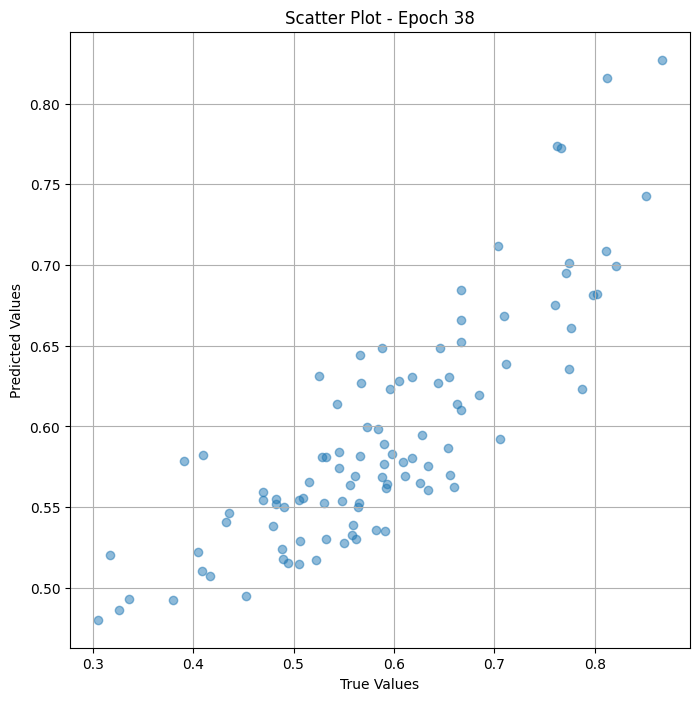

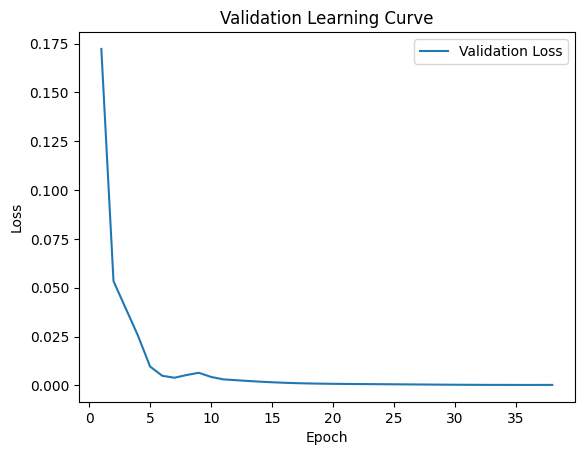

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (39/50) Loss = 0.0002870876051019877

 Epoch: (39/50) Loss_rmse = 0.016943659633398056

 Epoch: (39/50) R^2 = 0.9751363396644592

 Epoch: (39/50) MAE = 0.014023631811141968
Spearman correlation coefficient: SignificanceResult(statistic=0.8265652882146893, pvalue=3.3971753721911227e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.71

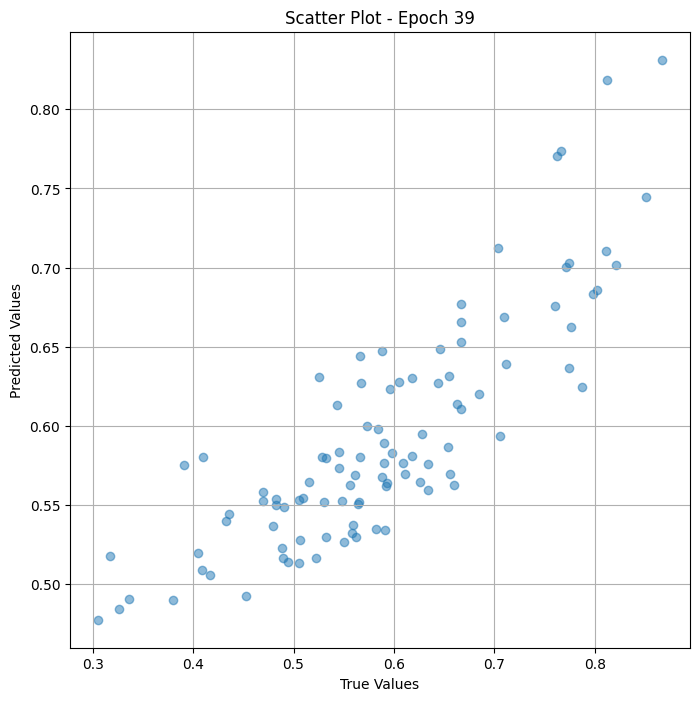

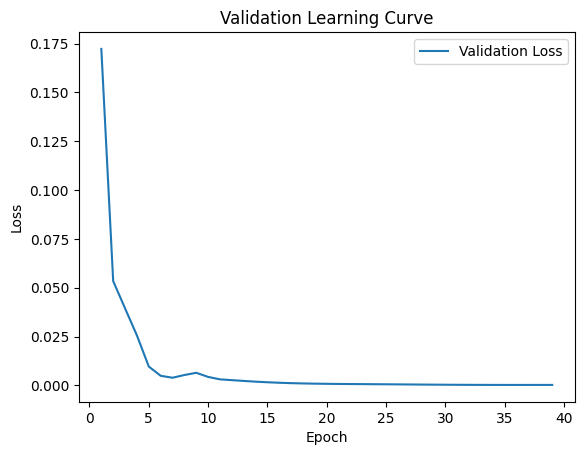


 Epoch: (40/50) Loss = 0.00028445152565836906

 Epoch: (40/50) Loss_rmse = 0.016865691170096397

 Epoch: (40/50) R^2 = 0.975364625453949

 Epoch: (40/50) MAE = 0.014149278402328491
Spearman correlation coefficient: SignificanceResult(statistic=0.8295361292102174, pvalue=1.6222038036902042e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

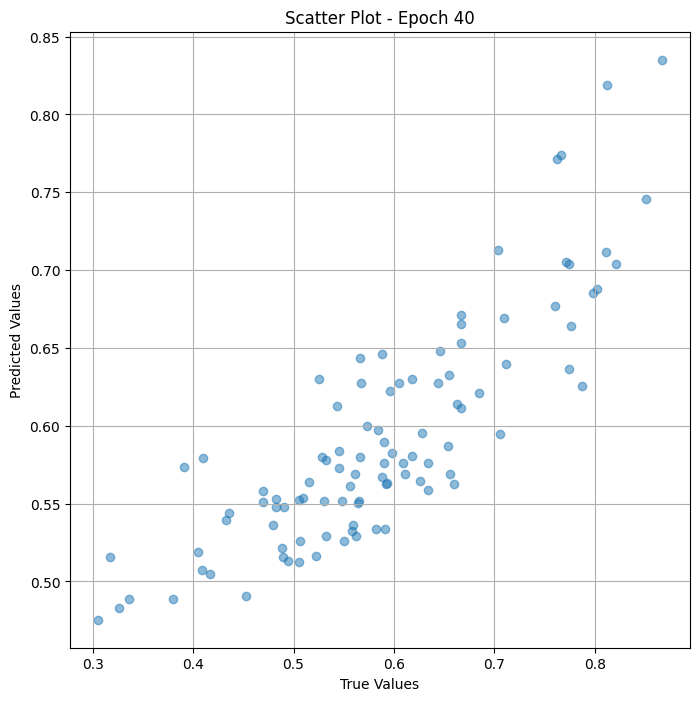

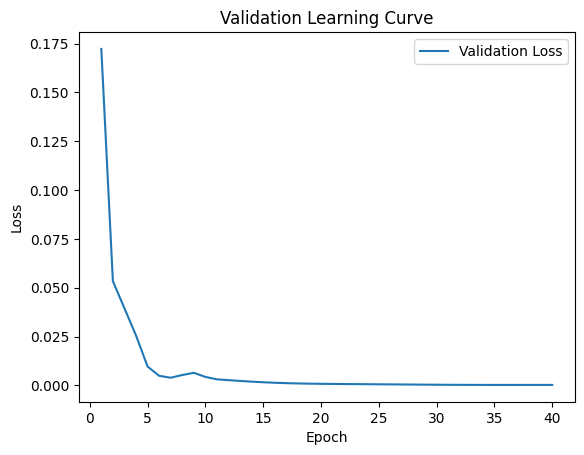


 Epoch: (41/50) Loss = 0.00028407666832208633

 Epoch: (41/50) Loss_rmse = 0.016854574903845787

 Epoch: (41/50) R^2 = 0.9753971099853516

 Epoch: (41/50) MAE = 0.01419462263584137
Spearman correlation coefficient: SignificanceResult(statistic=0.8300177038921409, pvalue=1.4370973964191564e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

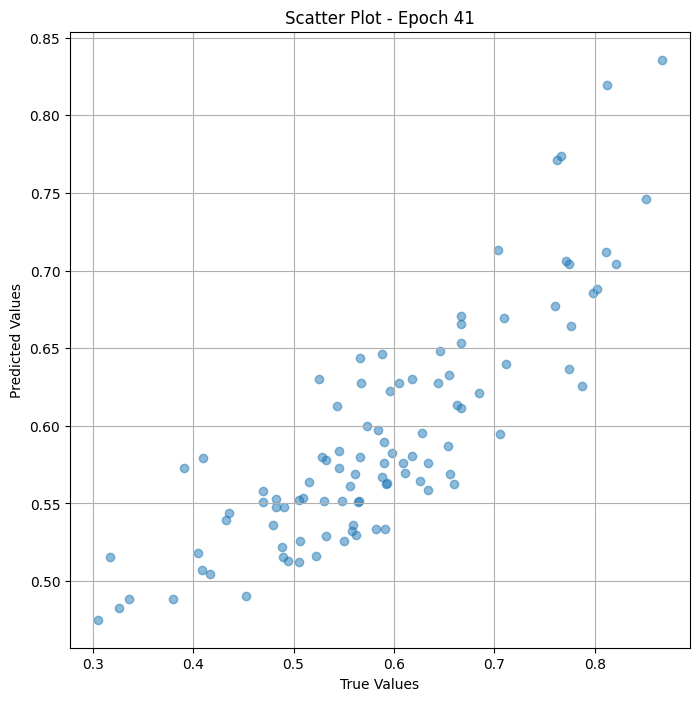

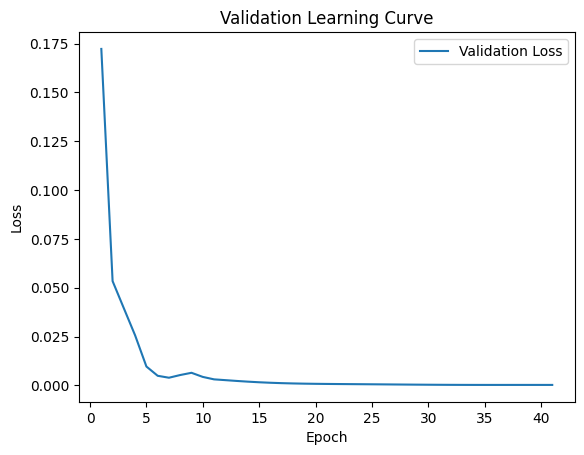


 Epoch: (42/50) Loss = 0.0002835397608578205

 Epoch: (42/50) Loss_rmse = 0.016838638111948967

 Epoch: (42/50) R^2 = 0.9754436016082764

 Epoch: (42/50) MAE = 0.014233514666557312
Spearman correlation coefficient: SignificanceResult(statistic=0.830261882604102, pvalue=1.3512727294115066e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

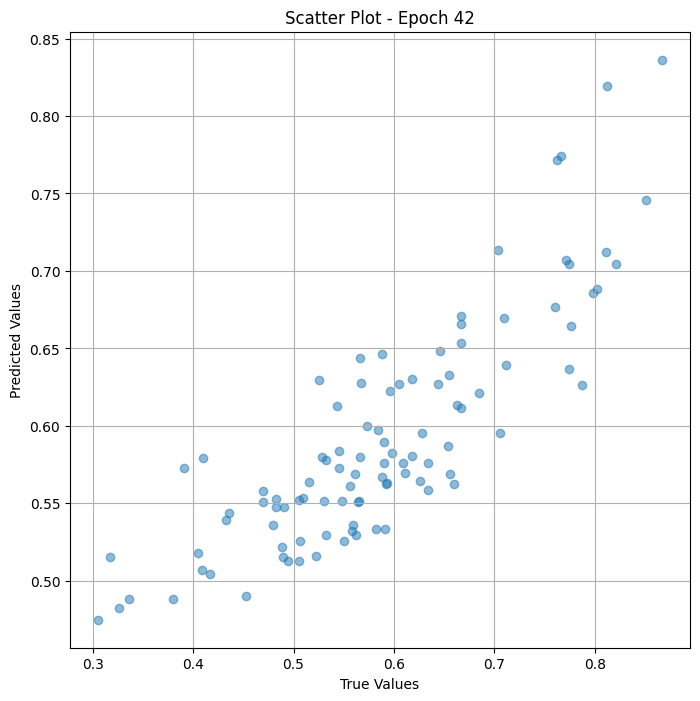

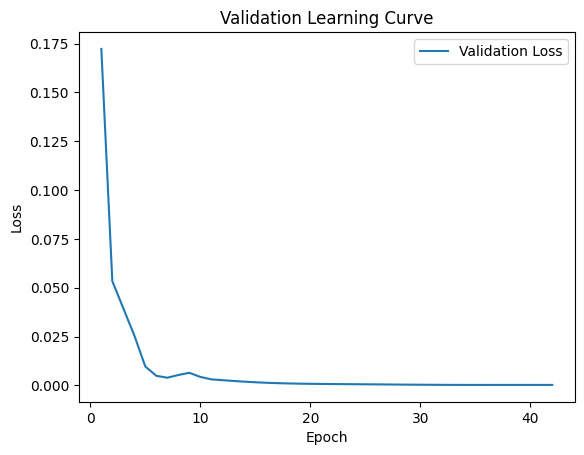


 Epoch: (43/50) Loss = 0.00028291033231653273

 Epoch: (43/50) Loss_rmse = 0.016819939017295837

 Epoch: (43/50) R^2 = 0.9754981398582458

 Epoch: (43/50) MAE = 0.014267981052398682
Spearman correlation coefficient: SignificanceResult(statistic=0.8304653648640696, pvalue=1.283584624597736e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

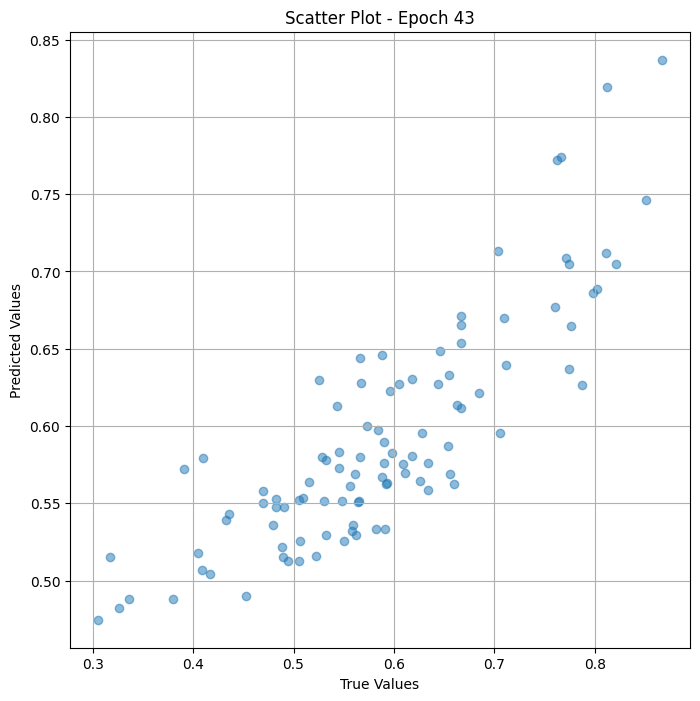

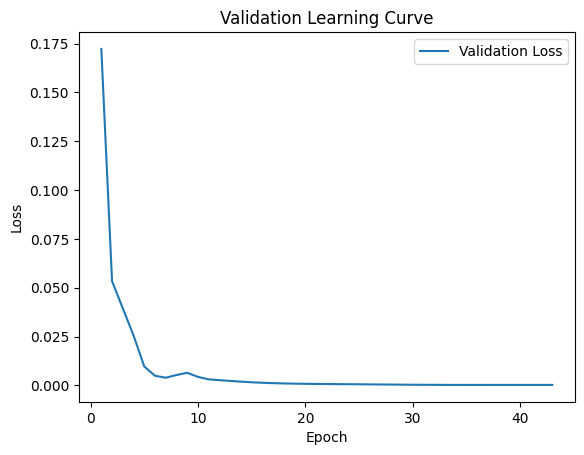


 Epoch: (44/50) Loss = 0.0002822396927513182

 Epoch: (44/50) Loss_rmse = 0.016799990087747574

 Epoch: (44/50) R^2 = 0.9755561947822571

 Epoch: (44/50) MAE = 0.014299586415290833
Spearman correlation coefficient: SignificanceResult(statistic=0.8308723293840051, pvalue=1.1579732424450628e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

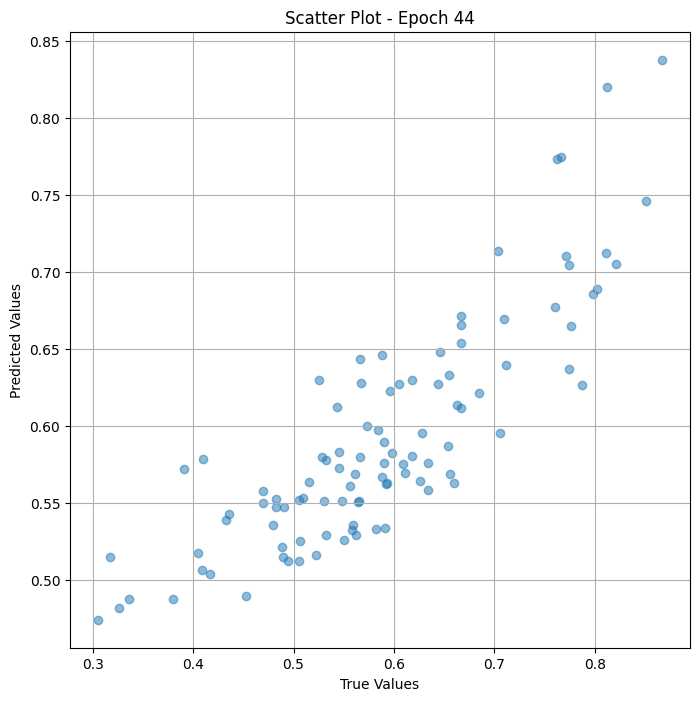

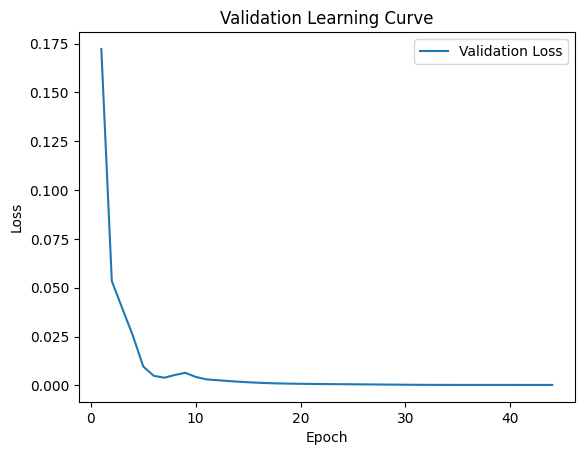


 Epoch: (45/50) Loss = 0.0002815613115672022

 Epoch: (45/50) Loss_rmse = 0.016779789701104164

 Epoch: (45/50) R^2 = 0.9756149649620056

 Epoch: (45/50) MAE = 0.014329344034194946
Spearman correlation coefficient: SignificanceResult(statistic=0.8308723293840051, pvalue=1.1579732424450628e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

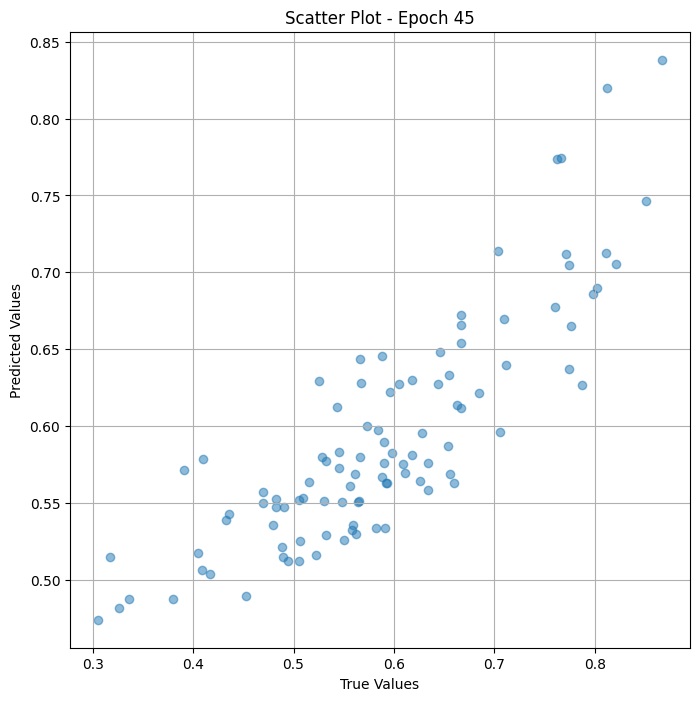

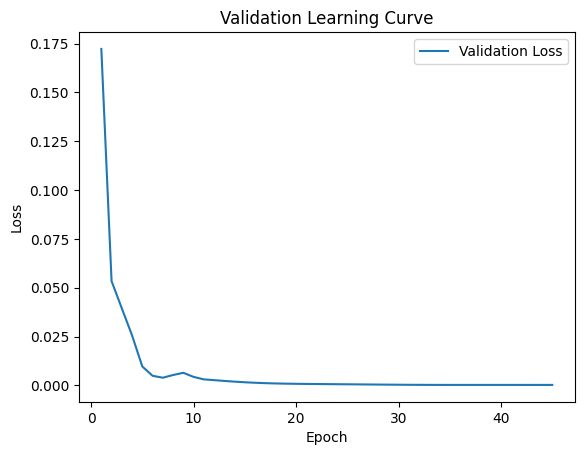


 Epoch: (46/50) Loss = 0.000280896172625944

 Epoch: (46/50) Loss_rmse = 0.016759958118200302

 Epoch: (46/50) R^2 = 0.9756725430488586

 Epoch: (46/50) MAE = 0.014357998967170715
Spearman correlation coefficient: SignificanceResult(statistic=0.831048680675977, pvalue=1.107338275335667e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714,

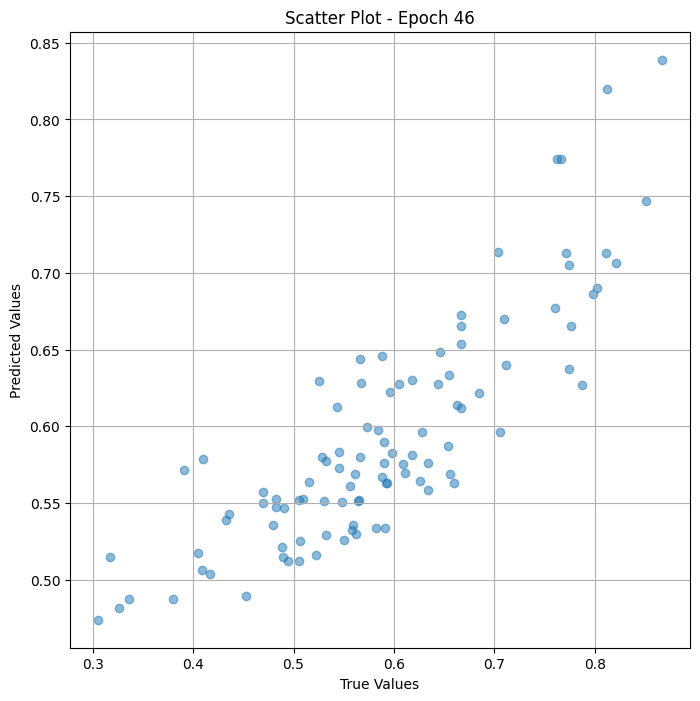

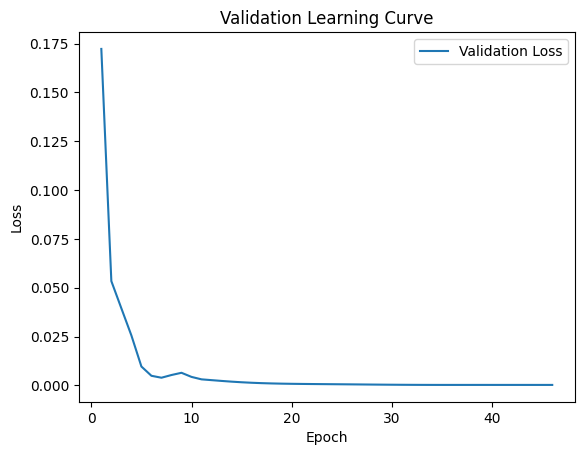


 Epoch: (47/50) Loss = 0.0002802596427500248

 Epoch: (47/50) Loss_rmse = 0.016740957275032997

 Epoch: (47/50) R^2 = 0.9757276773452759

 Epoch: (47/50) MAE = 0.014385849237442017
Spearman correlation coefficient: SignificanceResult(statistic=0.8311300735799642, pvalue=1.0847021574030296e-25)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

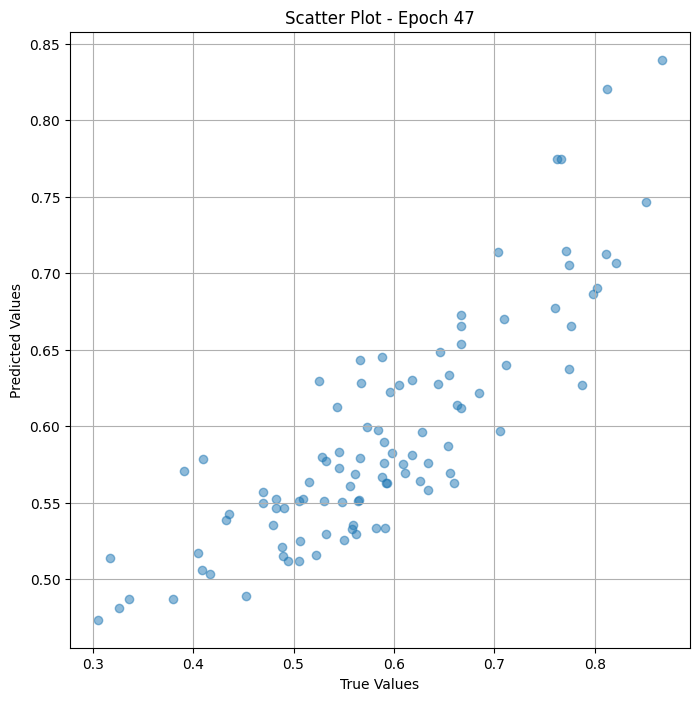

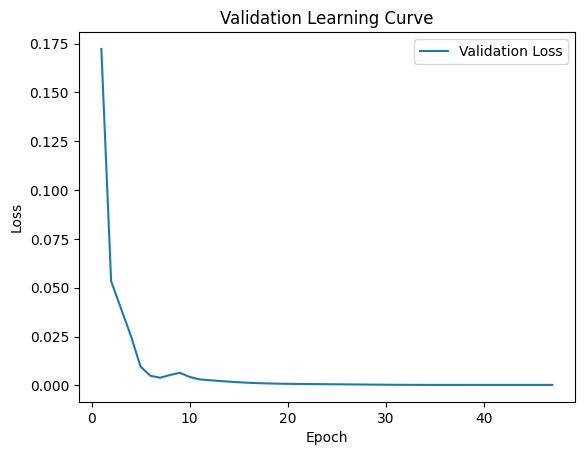


 Epoch: (48/50) Loss = 0.00027966423658654094

 Epoch: (48/50) Loss_rmse = 0.016723165288567543

 Epoch: (48/50) R^2 = 0.9757792353630066

 Epoch: (48/50) MAE = 0.014413148164749146
Spearman correlation coefficient: SignificanceResult(statistic=0.8318897406838435, pvalue=8.940488726782347e-26)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

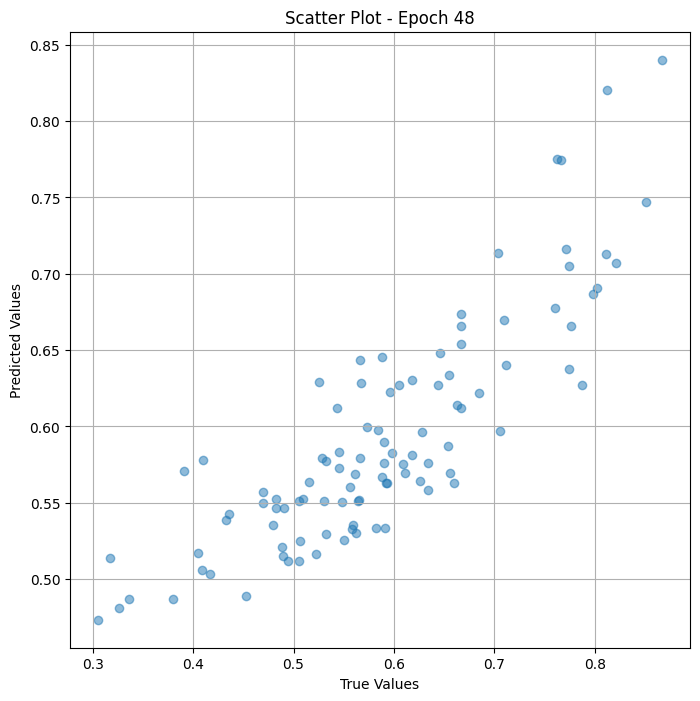

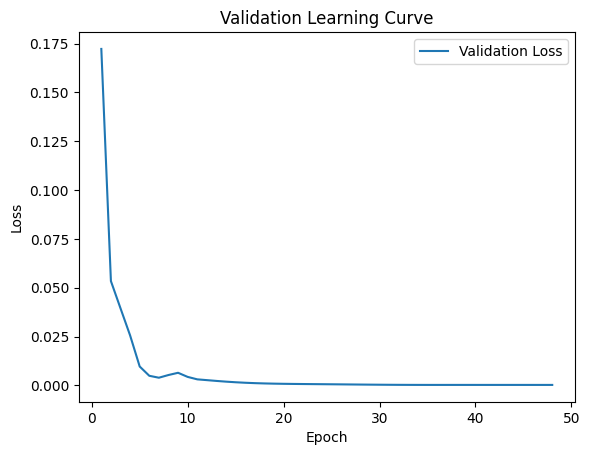


 Epoch: (49/50) Loss = 0.0002791094302665442

 Epoch: (49/50) Loss_rmse = 0.016706569120287895

 Epoch: (49/50) R^2 = 0.9758272767066956

 Epoch: (49/50) MAE = 0.01443985104560852
Spearman correlation coefficient: SignificanceResult(statistic=0.8323102706877767, pvalue=8.029878939959796e-26)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

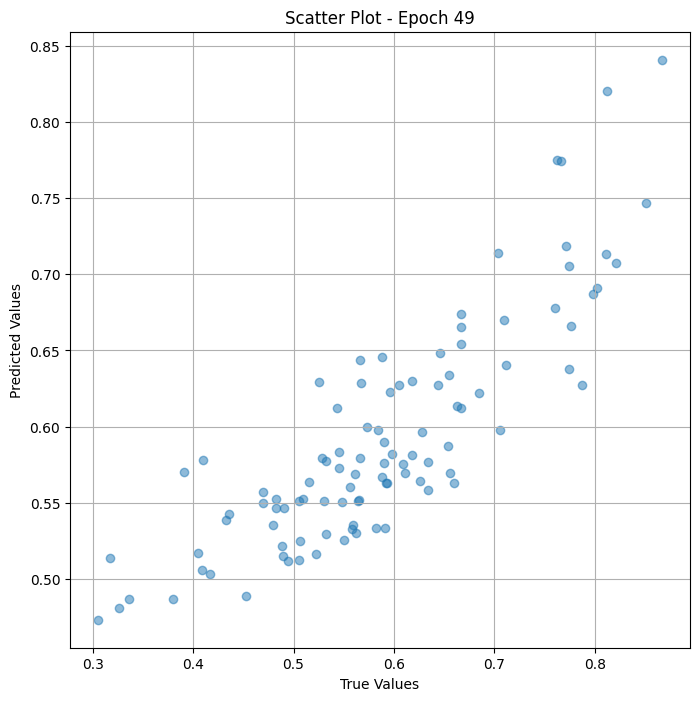

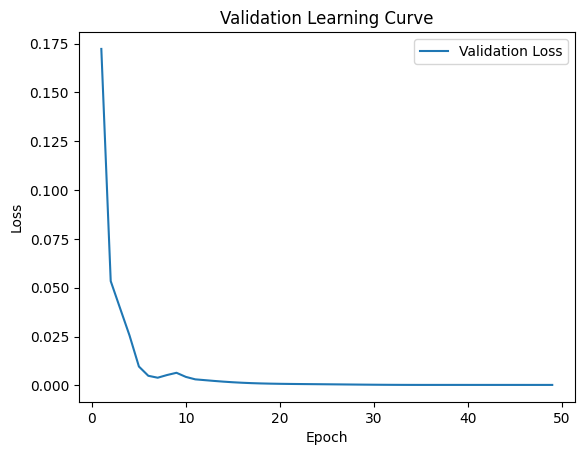


 Epoch: (50/50) Loss = 0.0002785981632769108

 Epoch: (50/50) Loss_rmse = 0.016691260039806366

 Epoch: (50/50) R^2 = 0.9758715629577637

 Epoch: (50/50) MAE = 0.014466121792793274
Spearman correlation coefficient: SignificanceResult(statistic=0.8326087113357292, pvalue=7.439136214145584e-26)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

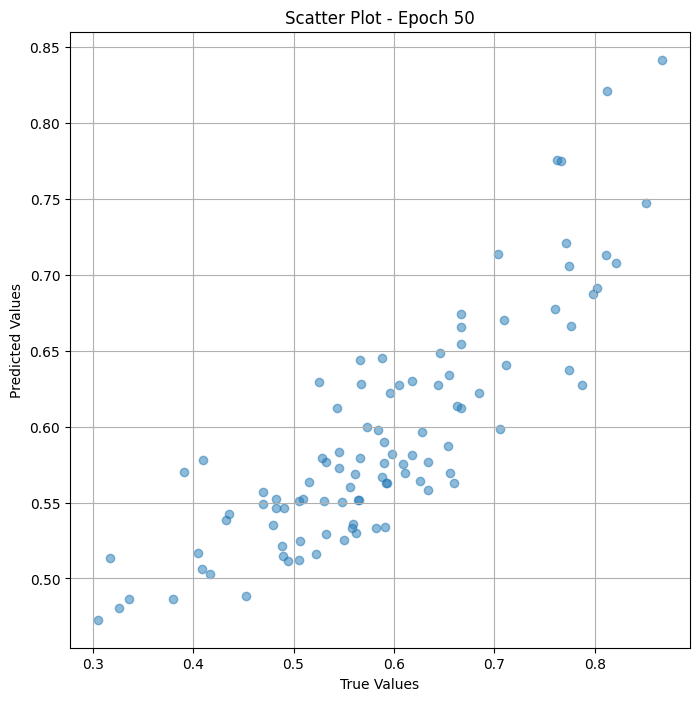

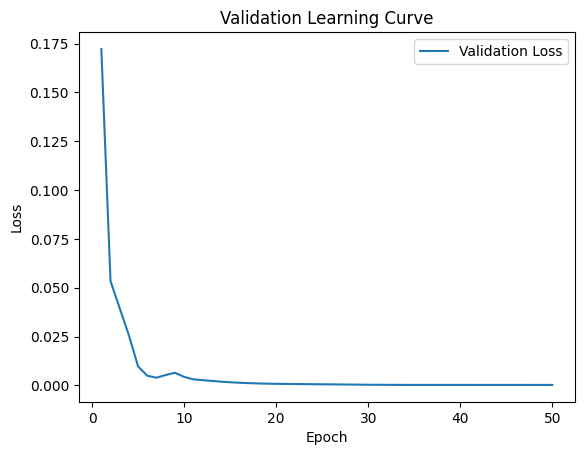

In [ ]:
# val the model and save weights
fit(50, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

In [ ]:
true_values_list_val = []
predicted_values_list_val = []

for x_trans, yb in val_dl:
    preds = model_vit(x_trans)
    true_values_list_val.extend(yb.cpu().detach().numpy())
    predicted_values_list_val.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_landscape' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_val_landscape['preprocessed_image_path'],
    'True Value': true_values_list_val,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_val # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                           Image Path  True Value  \
0   /content/landscape/781ab453ae76a695_preprocess...    0.762500   
1   /content/landscape/sun_atygdjduwnxhysqb_prepro...    0.545455   
2   /content/landscape/98a873a3a095d8a4_preprocess...    0.336538   
3   /content/landscape/f3de0d72febbe17f_preprocess...    0.821429   
4   /content/landscape/n02793495_5293_preprocessed...    0.567010   
..                                                ...         ...   
95  /content/landscape/n09472597_49039_preprocesse...    0.565657   
96  /content/landscape/1531af1a07329fe2_preprocess...    0.766667   
97  /content/landscape/n09393605_23116_preprocesse...    0.564356   
98  /content/landscape/sun_aumsgcclasofxhyw_prepro...    0.812500   
99  /content/landscape/sun_bcyqhmsuncrhyodx_prepro...    0.591667   

    Predicted Value  
0          0.710783  
1          0.608739  
2          0.600650  
3          0.752859  
4          0.615811  
..              ...  
95         0.6582

## Test

In [ ]:
df_test_landscape.head()


,preprocessed_image_path,memoscore
0,/content/landscape/n09415671_14500_preprocesse...,0.564356
1,/content/landscape/n09472597_32918_preprocesse...,0.804124
2,/content/landscape/4d8d416b795f90cc_preprocess...,0.695238
3,/content/landscape/sun_avqahgdnxxemgnje_prepro...,0.311828
4,/content/landscape/sun_bzbsfohnoxeimmzi_prepro...,0.545455


In [ ]:
class Dataset_test(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_test_landscape["memoscore"]
        self.images = df_test_landscape["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
test_ds = Dataset_test(df_test_landscape, trans_transform=trans_transform)
test_dl = DataLoader(test_ds, batch_size=32, shuffle=False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/160 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/vit/feature_extraction_vit.py:28: FutureWarning: The class ViTFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use ViTImageProcessor instead.
  warnings.warn(


In [ ]:
print(test_ds)

In [ ]:
class ViTMem_model_test_(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))

    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_test =  ViTMem_model_test_( arch="vit_base_patch16_224_miil")

model.safetensors:   0%|          | 0.00/378M [00:00<?, ?B/s]

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ViTMem_model_test_().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 768, 14, 14]         590,592
          Identity-2             [-1, 196, 768]               0
        PatchEmbed-3             [-1, 196, 768]               0
           Dropout-4             [-1, 197, 768]               0
          Identity-5             [-1, 197, 768]               0
          Identity-6             [-1, 197, 768]               0
         LayerNorm-7             [-1, 197, 768]           1,536
            Linear-8            [-1, 197, 2304]       1,769,472
          Identity-9          [-1, 12, 197, 64]               0
         Identity-10          [-1, 12, 197, 64]               0
           Linear-11             [-1, 197, 768]         590,592
          Dropout-12             [-1, 197, 768]               0
        Attention-13             [-1, 197, 768]               0
         Identity-14             [-1, 1

In [ ]:
device = get_default_device()
test_dl = DeviceDataLoader(test_dl, device)
model_vit_test  = to_device(model_vit_test  , device)

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad ]
optimizer = torch.optim.Adam(params, lr=1e-4)   #,weight_decay=1e-7

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.0005746855749748647

 Epoch: (1/50) Loss_rmse = 0.02397260069847107

 Epoch: (1/50) R^2 = 0.9072366952896118

 Epoch: (1/50) MAE = 0.021730944514274597
Spearman correlation coefficient: SignificanceResult(statistic=0.9881476005761037, pvalue=2.601780099951236e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519607

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


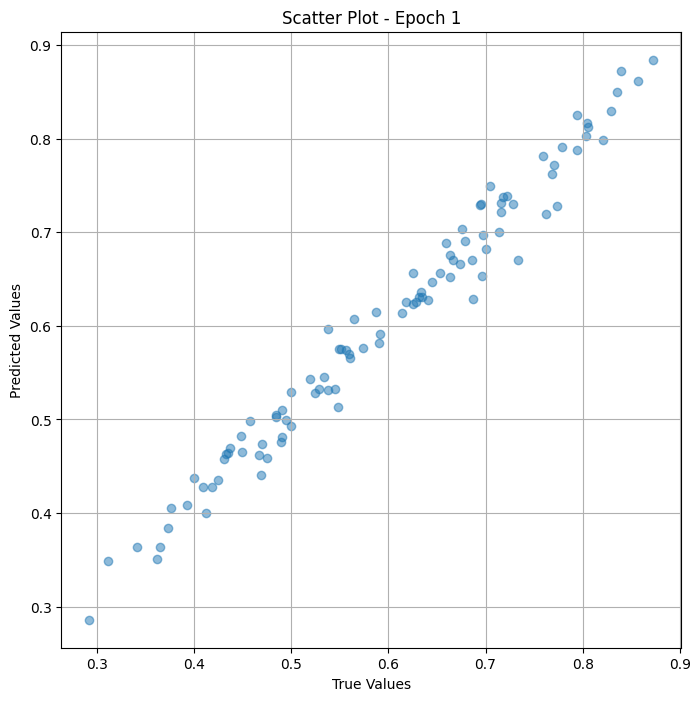

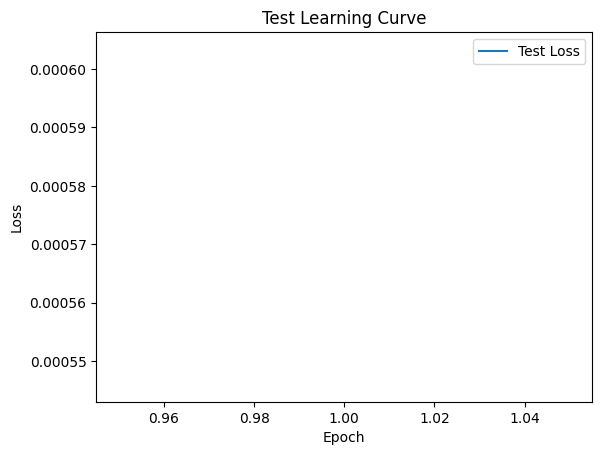


 Epoch: (2/50) Loss = 0.0005733975558541715

 Epoch: (2/50) Loss_rmse = 0.023945720866322517

 Epoch: (2/50) R^2 = 0.9074445962905884

 Epoch: (2/50) MAE = 0.021710380911827087
Spearman correlation coefficient: SignificanceResult(statistic=0.9881476005761037, pvalue=2.601780099951236e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51960

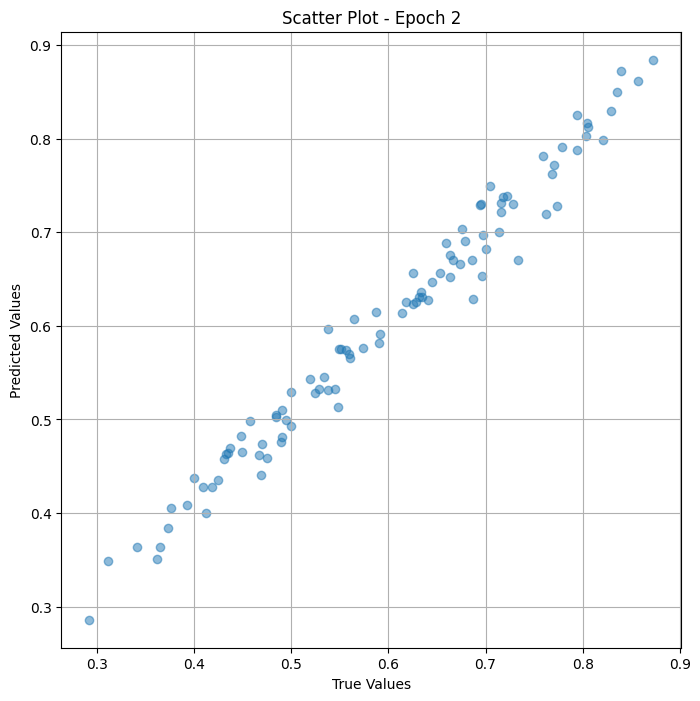

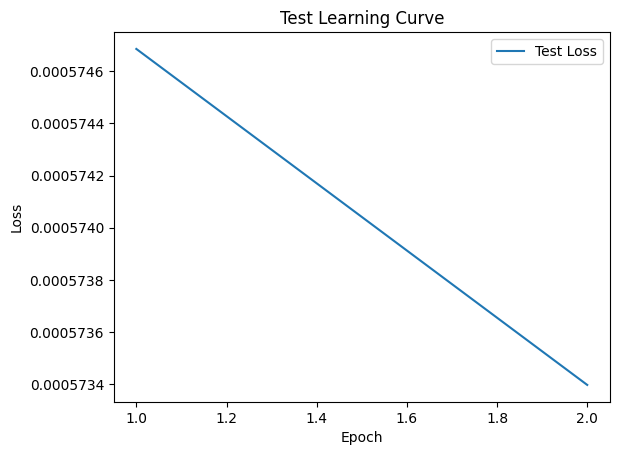


 Epoch: (3/50) Loss = 0.0005714613944292068

 Epoch: (3/50) Loss_rmse = 0.023905258625745773

 Epoch: (3/50) R^2 = 0.9077571630477905

 Epoch: (3/50) MAE = 0.021678559482097626
Spearman correlation coefficient: SignificanceResult(statistic=0.9881476005761037, pvalue=2.601780099951236e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51960

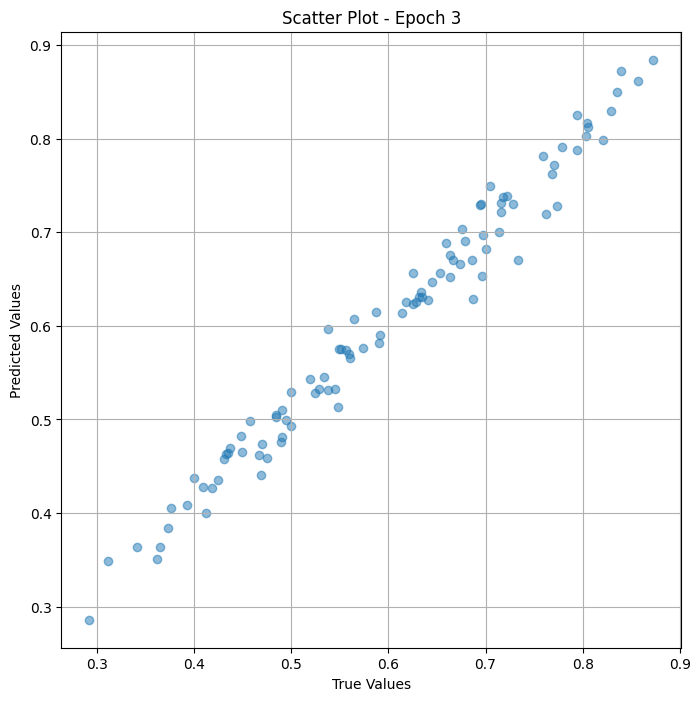

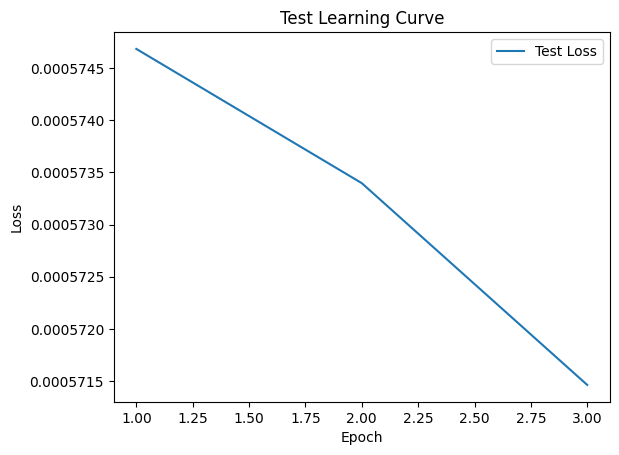


 Epoch: (4/50) Loss = 0.0005690738325938582

 Epoch: (4/50) Loss_rmse = 0.023855268955230713

 Epoch: (4/50) R^2 = 0.9081425666809082

 Epoch: (4/50) MAE = 0.02163887768983841
Spearman correlation coefficient: SignificanceResult(statistic=0.9881476005761037, pvalue=2.601780099951236e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519607

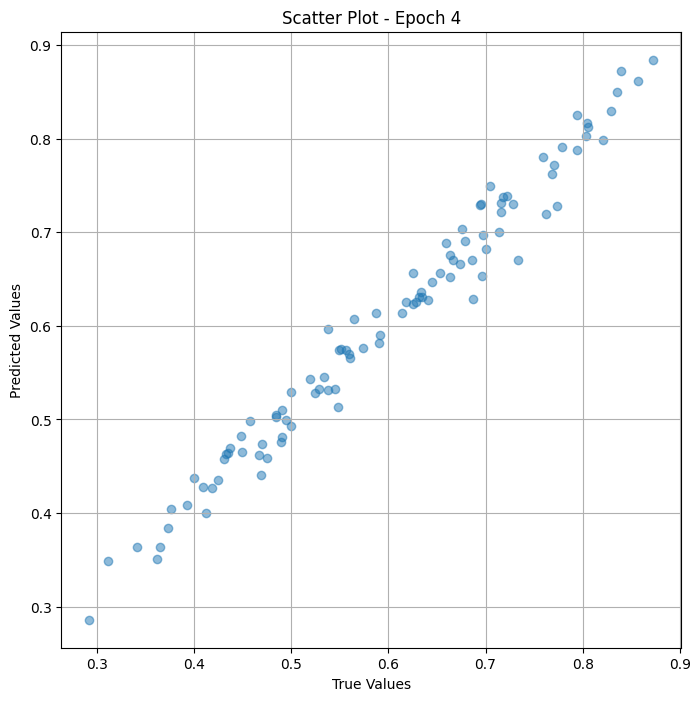

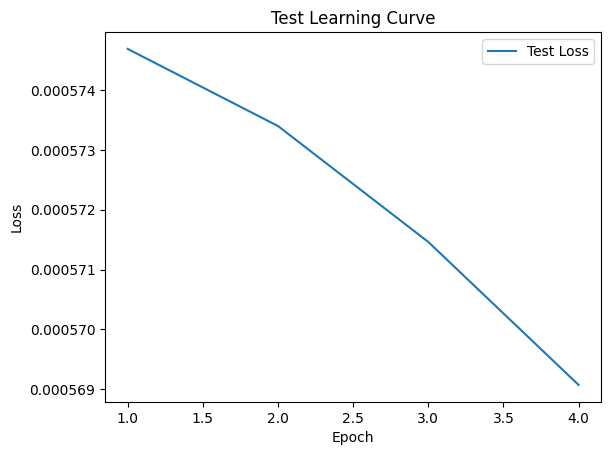


 Epoch: (5/50) Loss = 0.0005663827760145068

 Epoch: (5/50) Loss_rmse = 0.02379879727959633

 Epoch: (5/50) R^2 = 0.9085769057273865

 Epoch: (5/50) MAE = 0.021593838930130005
Spearman correlation coefficient: SignificanceResult(statistic=0.9881476005761037, pvalue=2.601780099951236e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519607

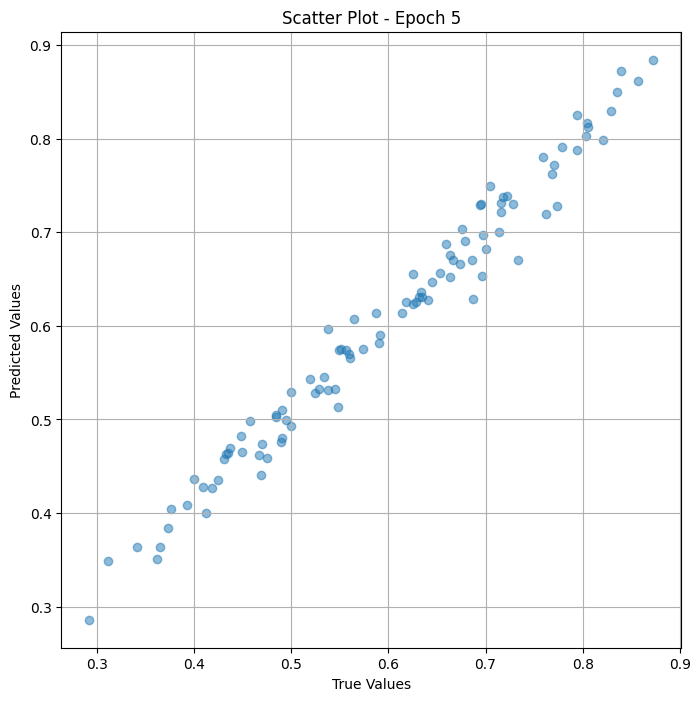

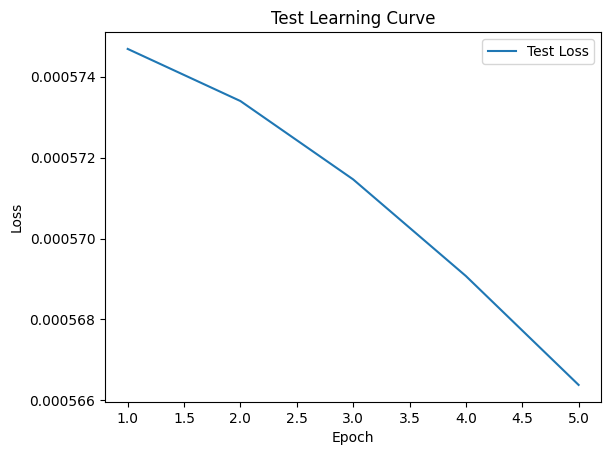


 Epoch: (6/50) Loss = 0.0005634952103719115

 Epoch: (6/50) Loss_rmse = 0.023738054558634758

 Epoch: (6/50) R^2 = 0.90904301404953

 Epoch: (6/50) MAE = 0.02154526859521866
Spearman correlation coefficient: SignificanceResult(statistic=0.9881476005761037, pvalue=2.601780099951236e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51960784

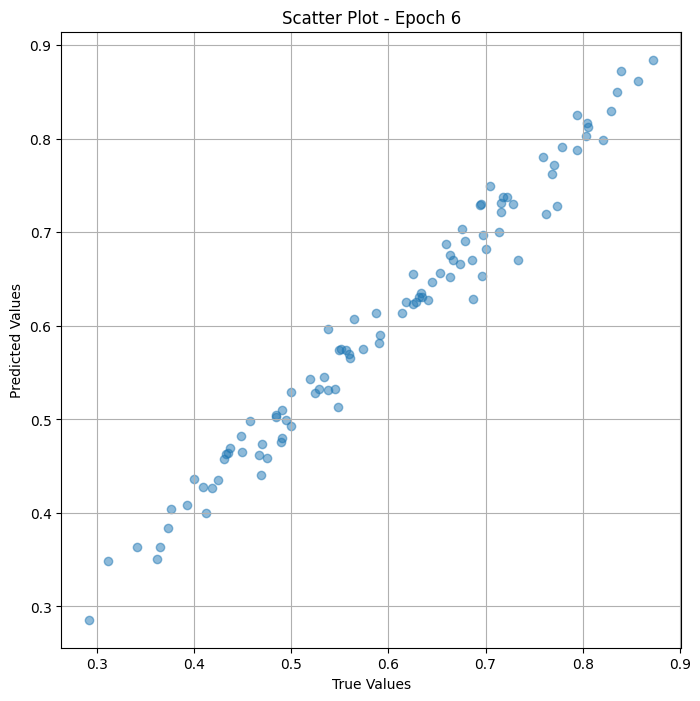

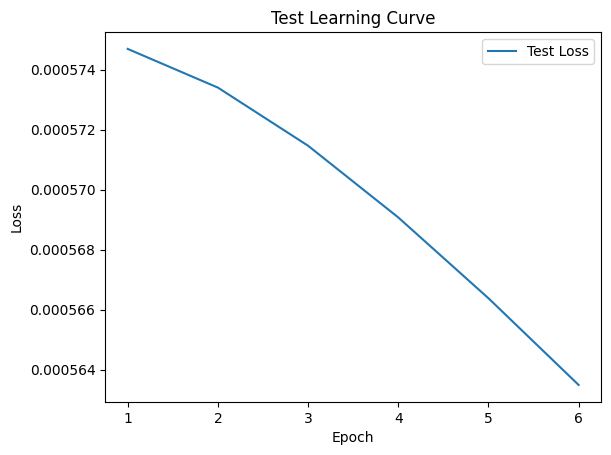


 Epoch: (7/50) Loss = 0.0005604855832643807

 Epoch: (7/50) Loss_rmse = 0.023674577474594116

 Epoch: (7/50) R^2 = 0.9095287919044495

 Epoch: (7/50) MAE = 0.021494410932064056
Spearman correlation coefficient: SignificanceResult(statistic=0.9882018604878663, pvalue=2.0996407931847697e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5196

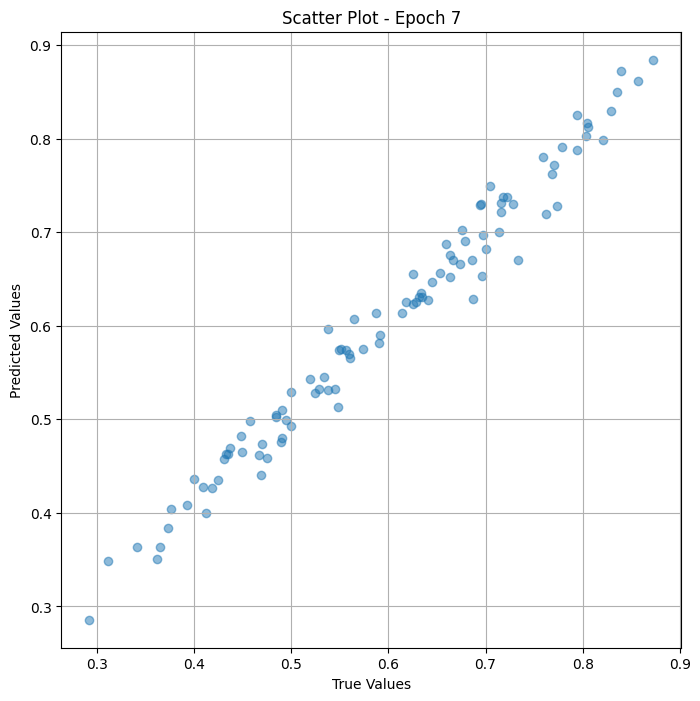

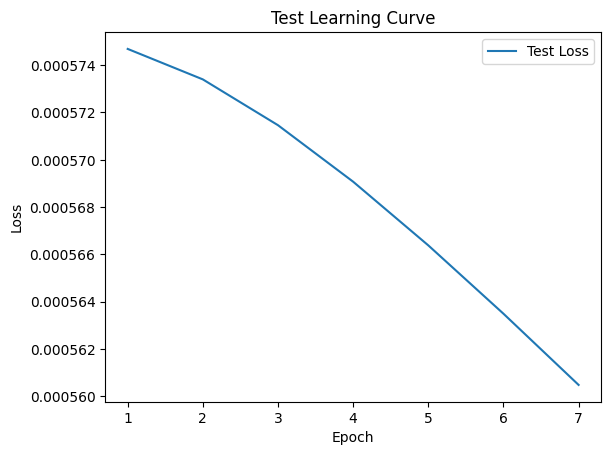


 Epoch: (8/50) Loss = 0.0005574081442318857

 Epoch: (8/50) Loss_rmse = 0.023609492927789688

 Epoch: (8/50) R^2 = 0.9100255370140076

 Epoch: (8/50) MAE = 0.021442167460918427
Spearman correlation coefficient: SignificanceResult(statistic=0.9882289904437477, pvalue=1.8854740156503428e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5196

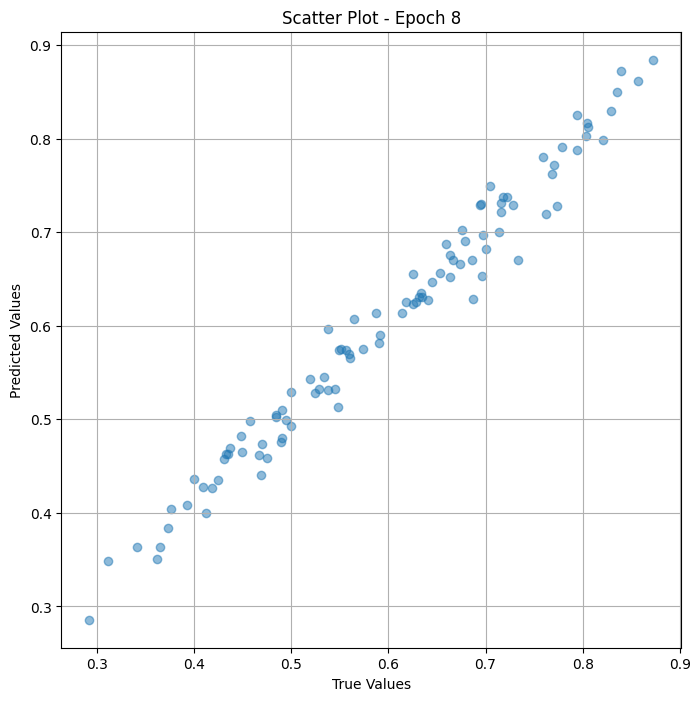

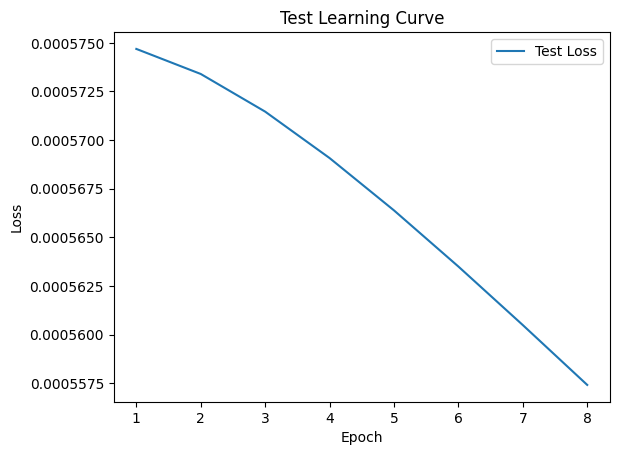


 Epoch: (9/50) Loss = 0.0005542868166230619

 Epoch: (9/50) Loss_rmse = 0.02354329638183117

 Epoch: (9/50) R^2 = 0.910529375076294

 Epoch: (9/50) MAE = 0.021389052271842957
Spearman correlation coefficient: SignificanceResult(statistic=0.9882289904437477, pvalue=1.8854740156503428e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519607

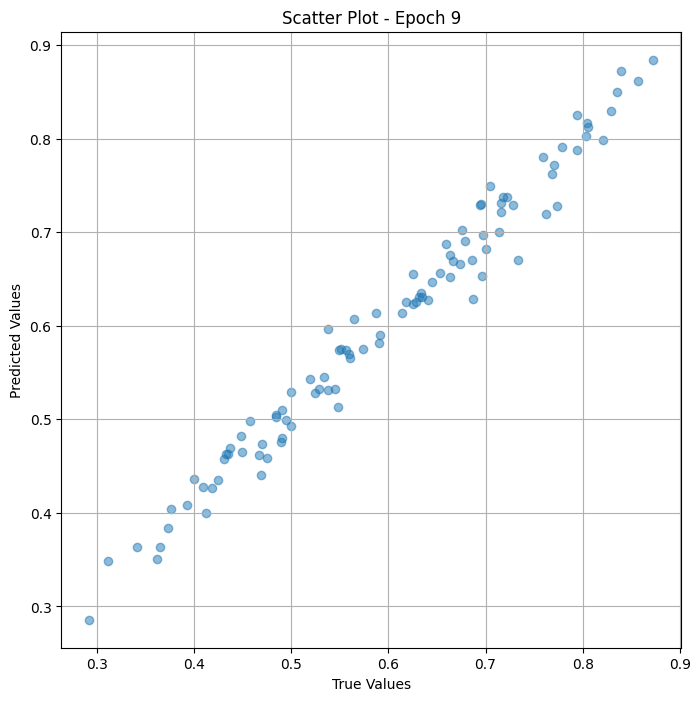

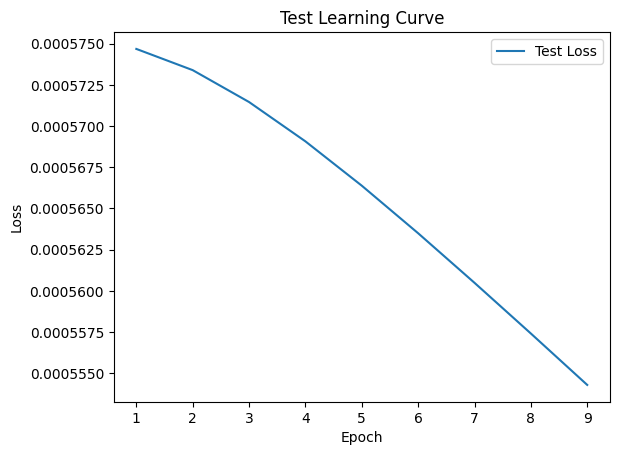


 Epoch: (10/50) Loss = 0.0005511511117219925

 Epoch: (10/50) Loss_rmse = 0.023476608097553253

 Epoch: (10/50) R^2 = 0.9110355377197266

 Epoch: (10/50) MAE = 0.02133546769618988
Spearman correlation coefficient: SignificanceResult(statistic=0.9882289904437477, pvalue=1.8854740156503428e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

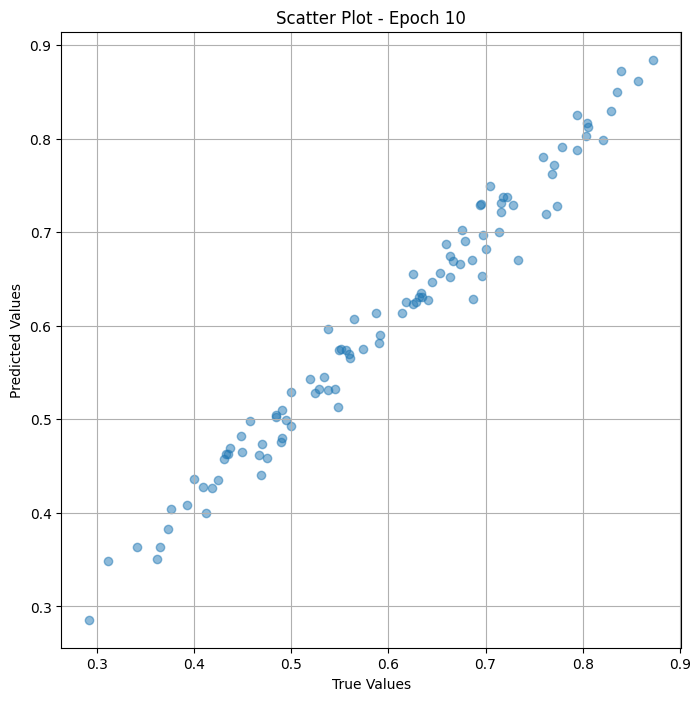

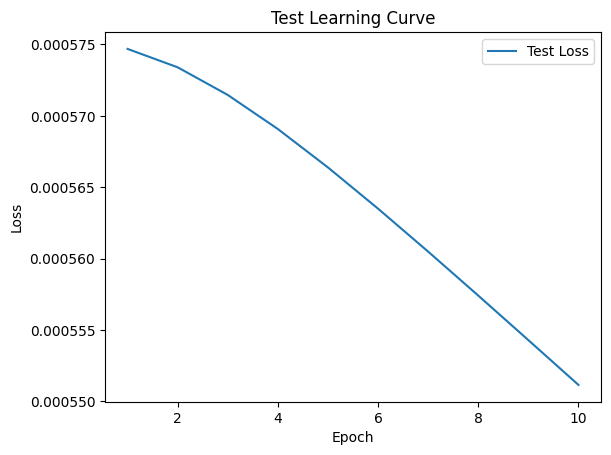


 Epoch: (11/50) Loss = 0.0005480058025568724

 Epoch: (11/50) Loss_rmse = 0.02340952306985855

 Epoch: (11/50) R^2 = 0.9115432500839233

 Epoch: (11/50) MAE = 0.021281547844409943
Spearman correlation coefficient: SignificanceResult(statistic=0.9882696853775697, pvalue=1.6037268657584646e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

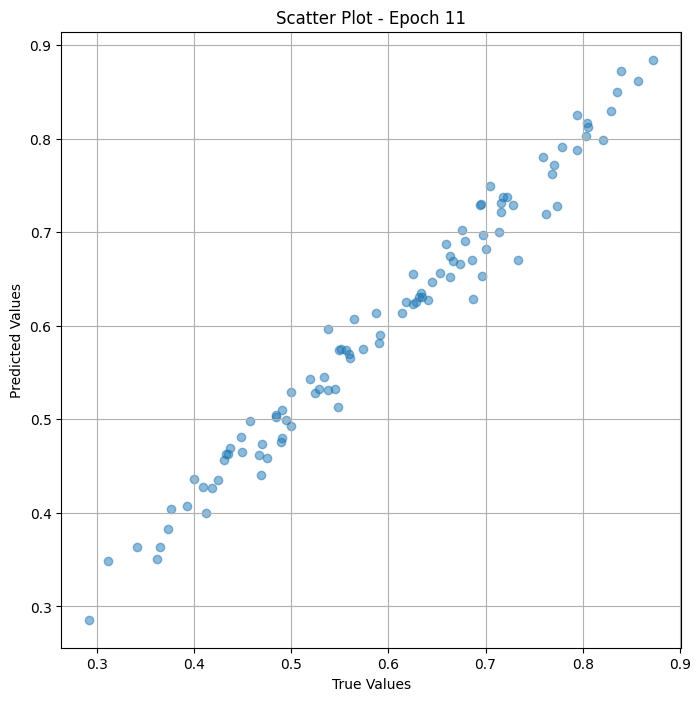

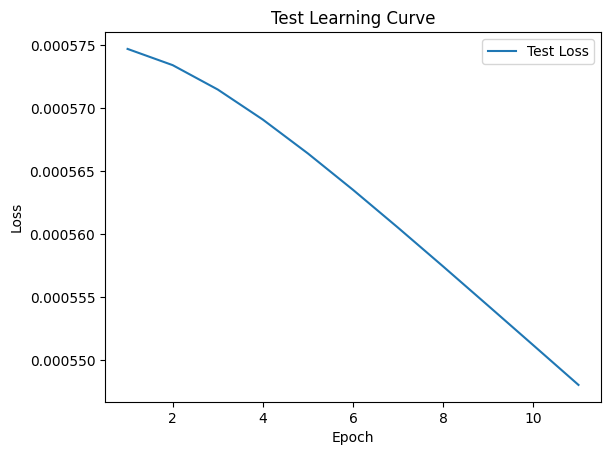


 Epoch: (12/50) Loss = 0.0005448649171739817

 Epoch: (12/50) Loss_rmse = 0.02334234118461609

 Epoch: (12/50) R^2 = 0.9120502471923828

 Epoch: (12/50) MAE = 0.02122749388217926
Spearman correlation coefficient: SignificanceResult(statistic=0.9882696853775697, pvalue=1.6037268657584646e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

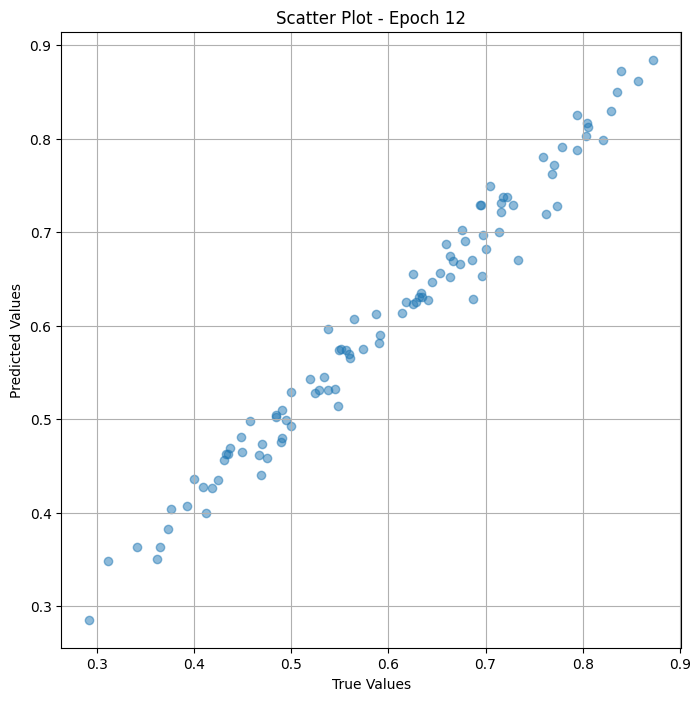

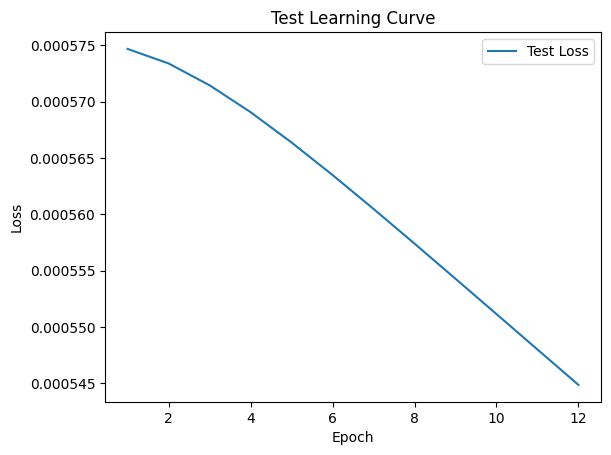


 Epoch: (13/50) Loss = 0.0005417317152023315

 Epoch: (13/50) Loss_rmse = 0.023275131359696388

 Epoch: (13/50) R^2 = 0.912555992603302

 Epoch: (13/50) MAE = 0.021173417568206787
Spearman correlation coefficient: SignificanceResult(statistic=0.9882696853775697, pvalue=1.6037268657584646e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

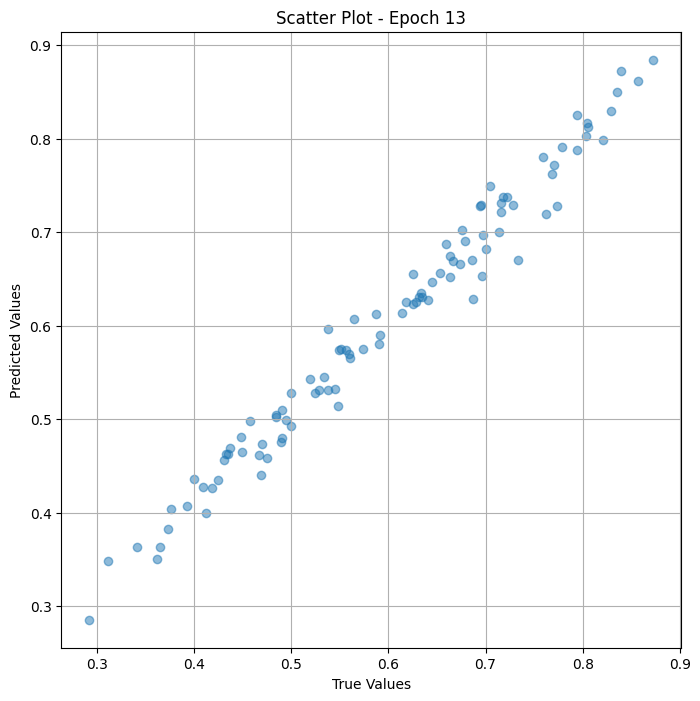

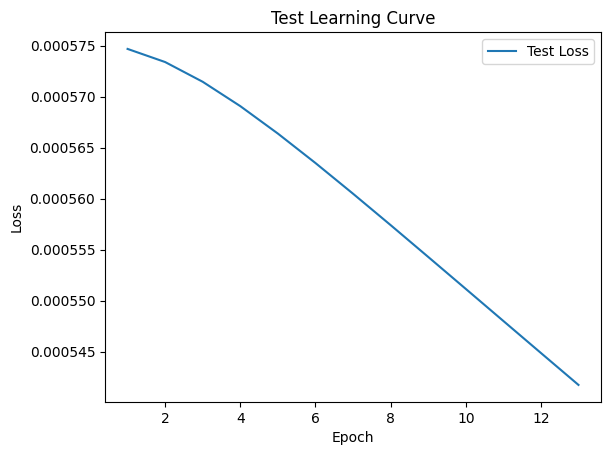


 Epoch: (14/50) Loss = 0.0005386112025007606

 Epoch: (14/50) Loss_rmse = 0.023207997903227806

 Epoch: (14/50) R^2 = 0.9130597114562988

 Epoch: (14/50) MAE = 0.021119341254234314
Spearman correlation coefficient: SignificanceResult(statistic=0.9884053351569762, pvalue=9.312063742014486e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

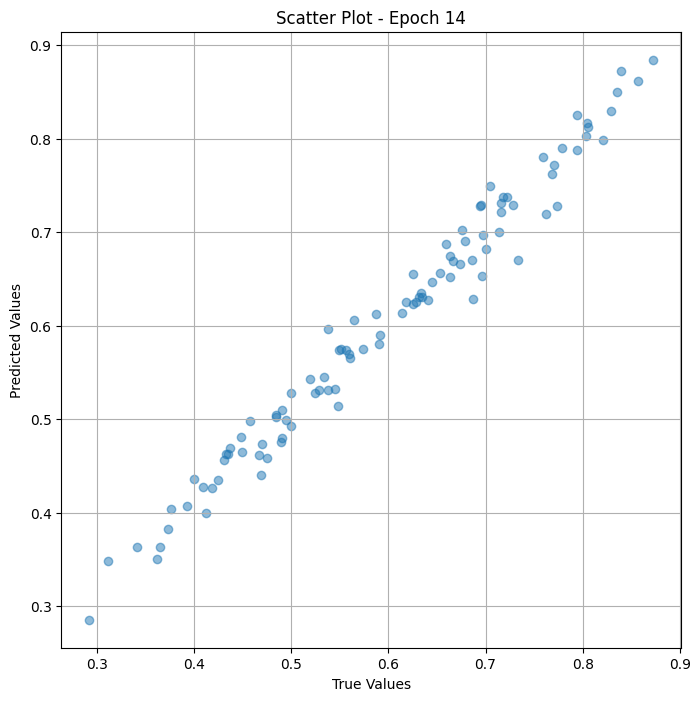

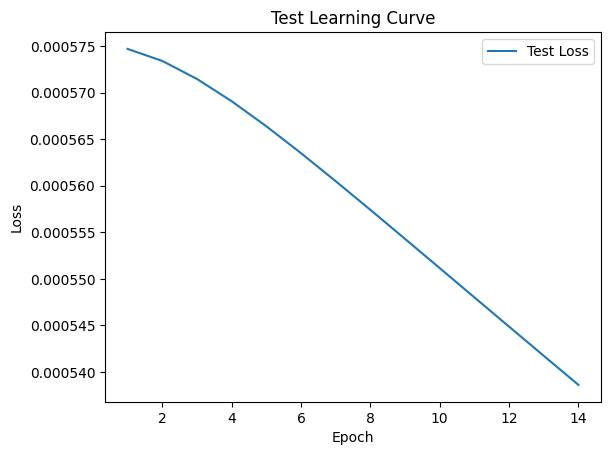


 Epoch: (15/50) Loss = 0.0005355015164241195

 Epoch: (15/50) Loss_rmse = 0.023140905424952507

 Epoch: (15/50) R^2 = 0.9135616421699524

 Epoch: (15/50) MAE = 0.021065309643745422
Spearman correlation coefficient: SignificanceResult(statistic=0.9884053351569762, pvalue=9.312063742014486e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

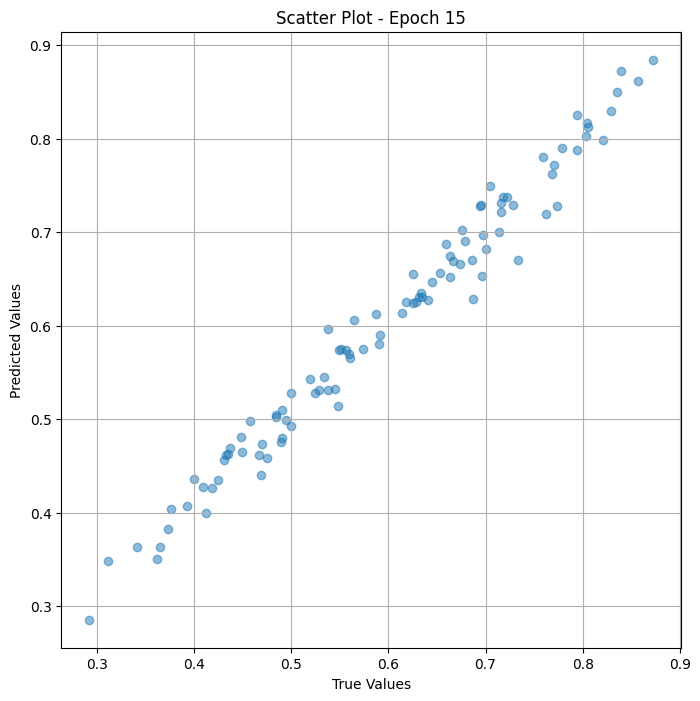

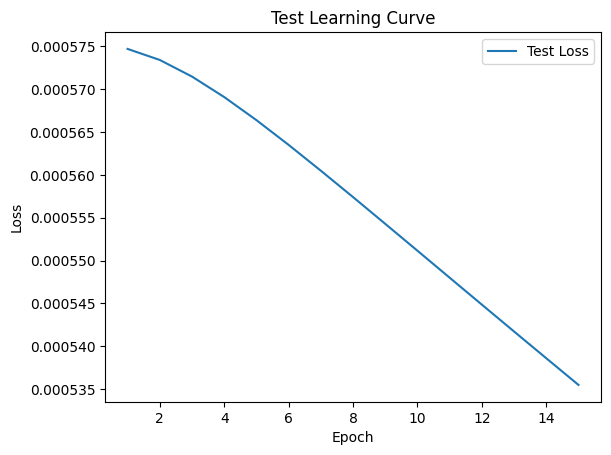


 Epoch: (16/50) Loss = 0.000532408244907856

 Epoch: (16/50) Loss_rmse = 0.023073973134160042

 Epoch: (16/50) R^2 = 0.9140609502792358

 Epoch: (16/50) MAE = 0.02101133018732071
Spearman correlation coefficient: SignificanceResult(statistic=0.9884053351569762, pvalue=9.312063742014486e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

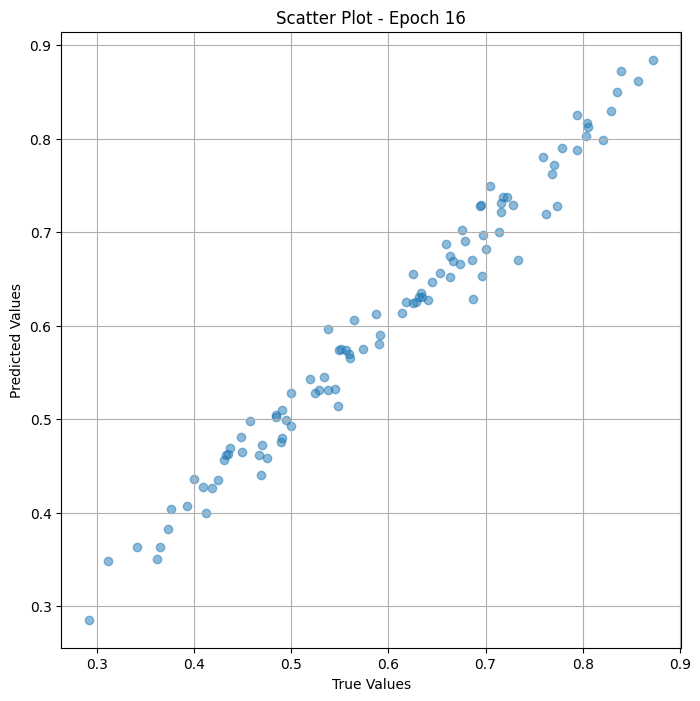

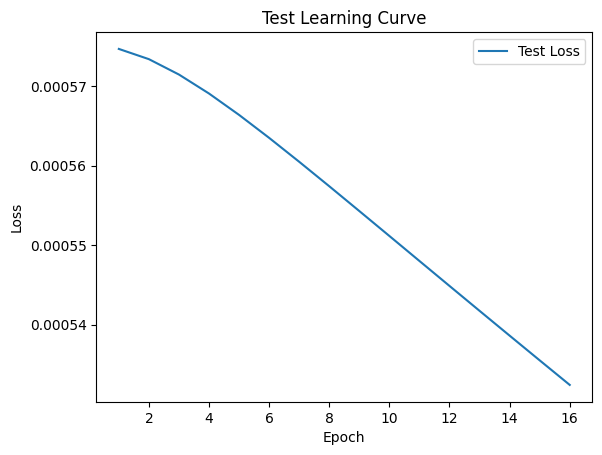


 Epoch: (17/50) Loss = 0.0005293331341817975

 Epoch: (17/50) Loss_rmse = 0.023007240146398544

 Epoch: (17/50) R^2 = 0.9145573377609253

 Epoch: (17/50) MAE = 0.02095751464366913
Spearman correlation coefficient: SignificanceResult(statistic=0.9884189001349168, pvalue=8.816270282071856e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

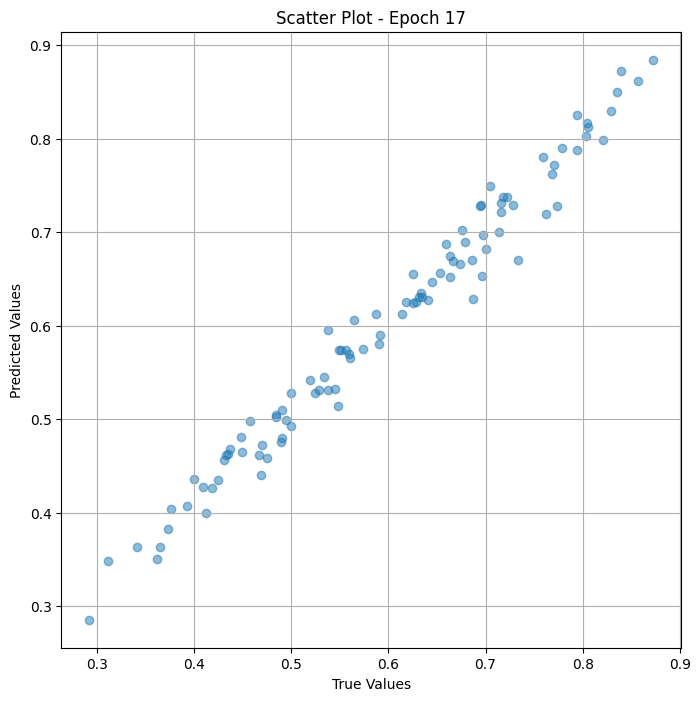

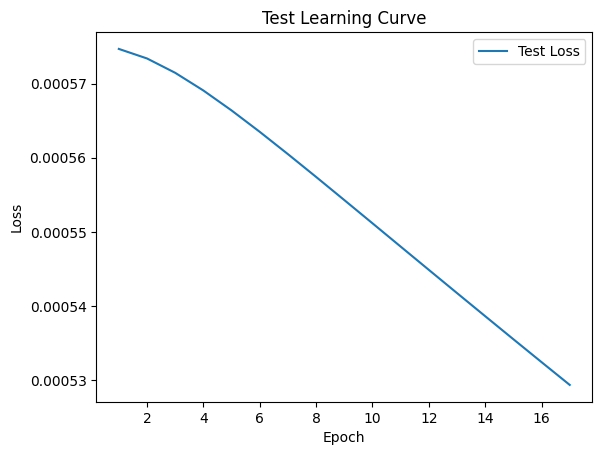


 Epoch: (18/50) Loss = 0.0005262724007479846

 Epoch: (18/50) Loss_rmse = 0.022940628230571747

 Epoch: (18/50) R^2 = 0.9150513410568237

 Epoch: (18/50) MAE = 0.020903825759887695
Spearman correlation coefficient: SignificanceResult(statistic=0.9884189001349168, pvalue=8.816270282071856e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

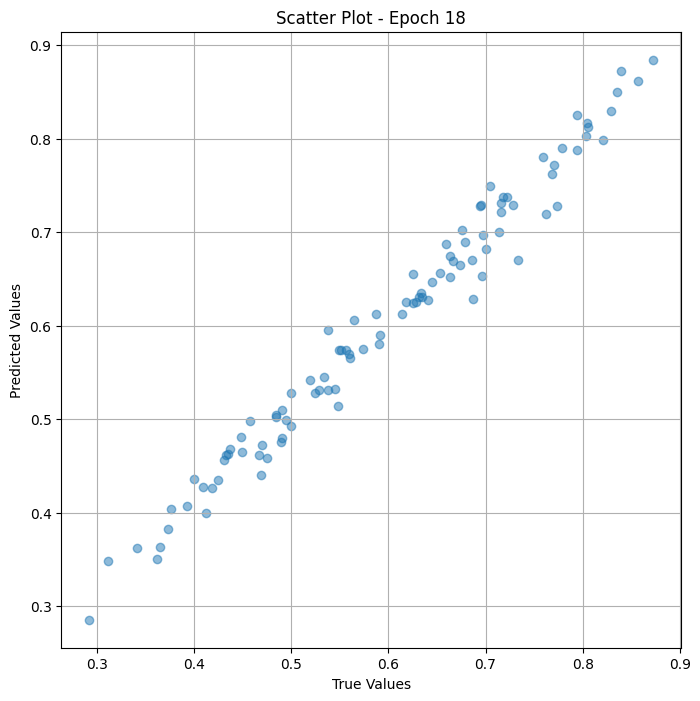

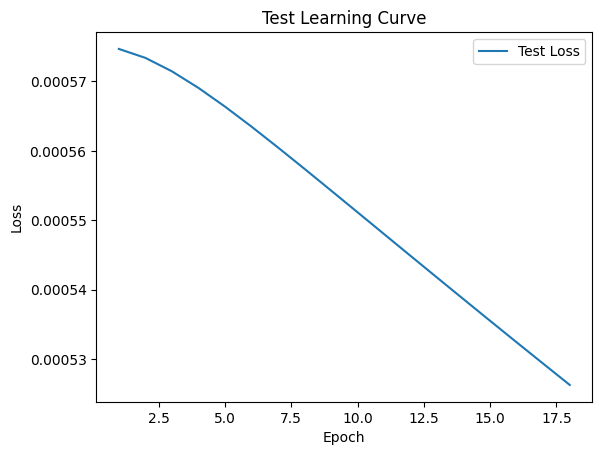


 Epoch: (19/50) Loss = 0.0005232291878201067

 Epoch: (19/50) Loss_rmse = 0.02287420444190502

 Epoch: (19/50) R^2 = 0.9155426025390625

 Epoch: (19/50) MAE = 0.02085018903017044
Spearman correlation coefficient: SignificanceResult(statistic=0.9884189001349168, pvalue=8.816270282071856e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

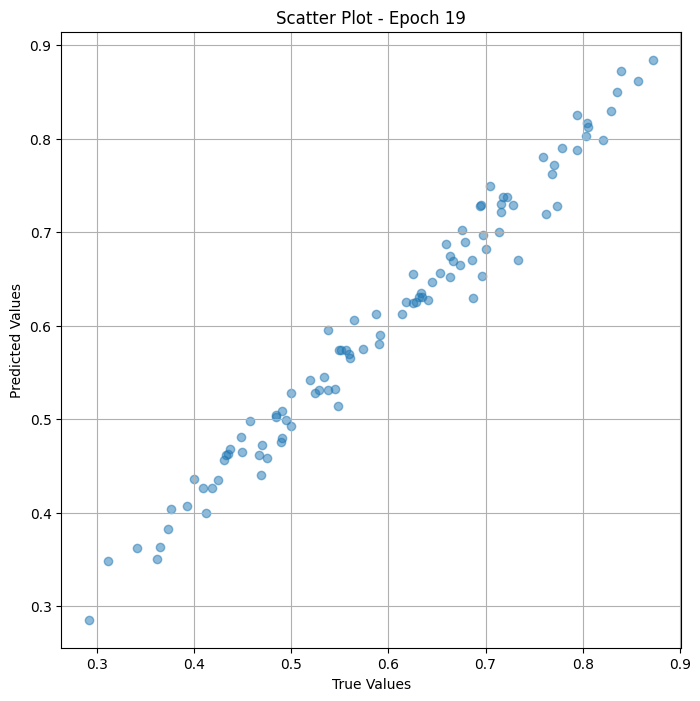

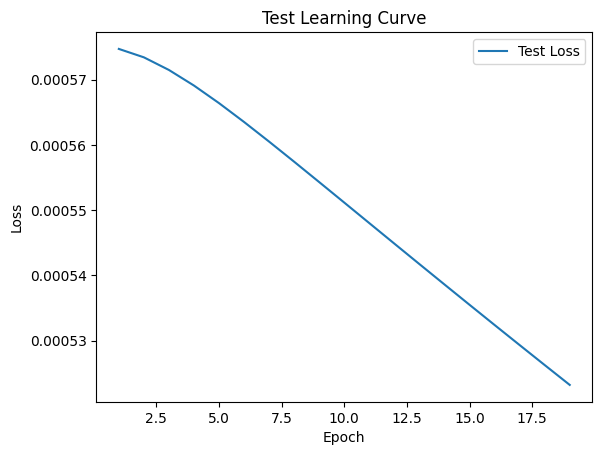


 Epoch: (20/50) Loss = 0.00052020070143044

 Epoch: (20/50) Loss_rmse = 0.022807909175753593

 Epoch: (20/50) R^2 = 0.9160314202308655

 Epoch: (20/50) MAE = 0.020796649158000946
Spearman correlation coefficient: SignificanceResult(statistic=0.988649504759908, pvalue=3.443563106991944e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5196

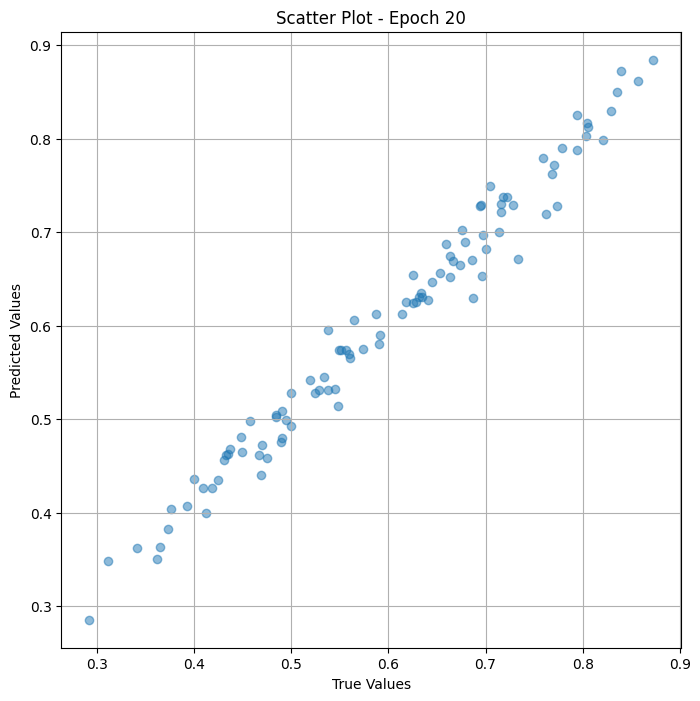

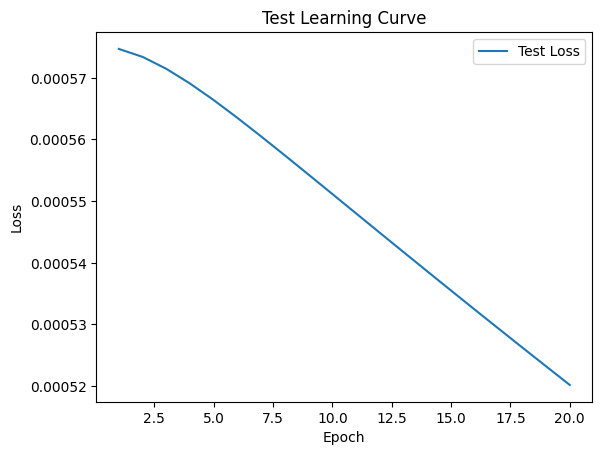


 Epoch: (21/50) Loss = 0.0005171863595023751

 Epoch: (21/50) Loss_rmse = 0.022741731256246567

 Epoch: (21/50) R^2 = 0.916517972946167

 Epoch: (21/50) MAE = 0.020743191242218018
Spearman correlation coefficient: SignificanceResult(statistic=0.988649504759908, pvalue=3.443563106991944e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

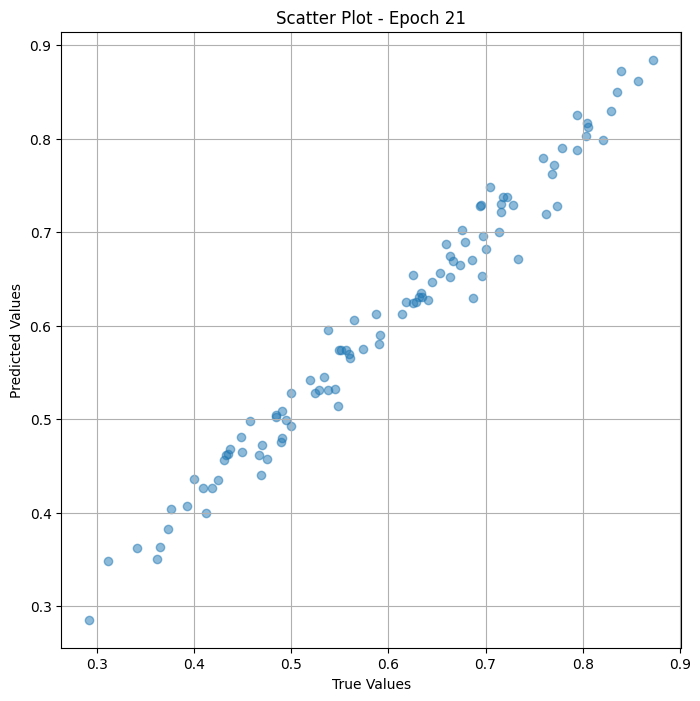

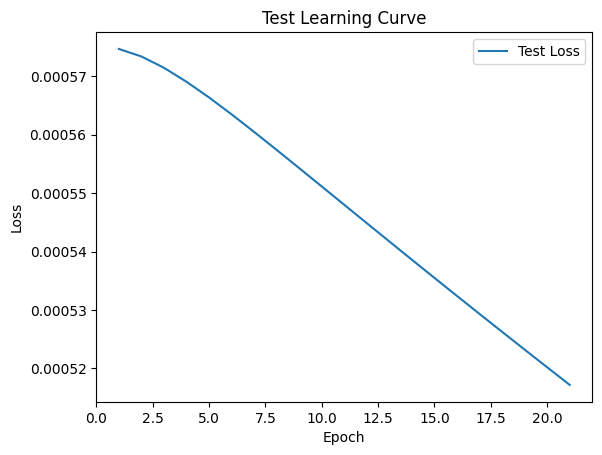


 Epoch: (22/50) Loss = 0.0005141922156326473

 Epoch: (22/50) Loss_rmse = 0.022675806656479836

 Epoch: (22/50) R^2 = 0.9170013070106506

 Epoch: (22/50) MAE = 0.020689882338047028
Spearman correlation coefficient: SignificanceResult(statistic=0.988649504759908, pvalue=3.443563106991944e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

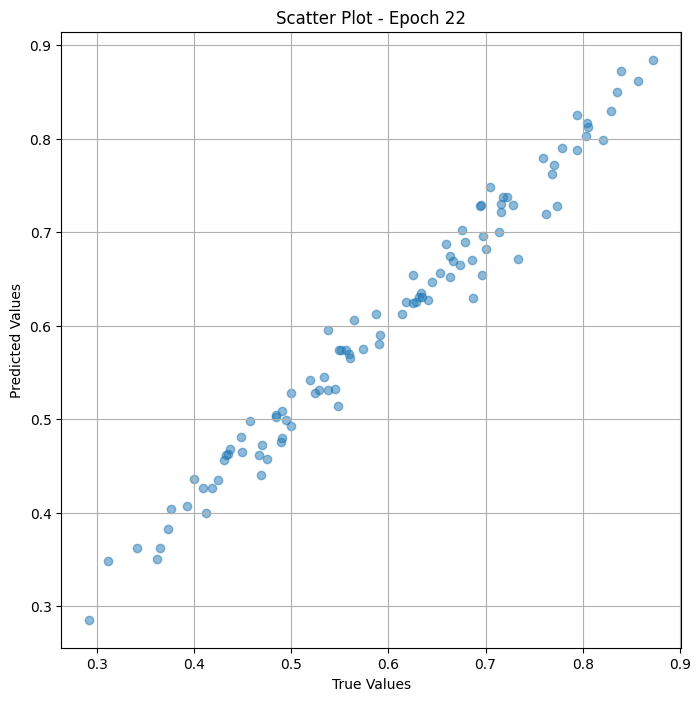

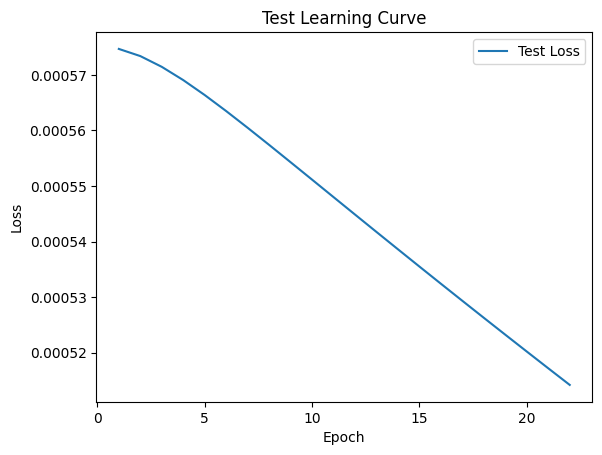


 Epoch: (23/50) Loss = 0.0005112106446176767

 Epoch: (23/50) Loss_rmse = 0.02260996773838997

 Epoch: (23/50) R^2 = 0.9174825549125671

 Epoch: (23/50) MAE = 0.02063664048910141
Spearman correlation coefficient: SignificanceResult(statistic=0.988649504759908, pvalue=3.443563106991944e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5196

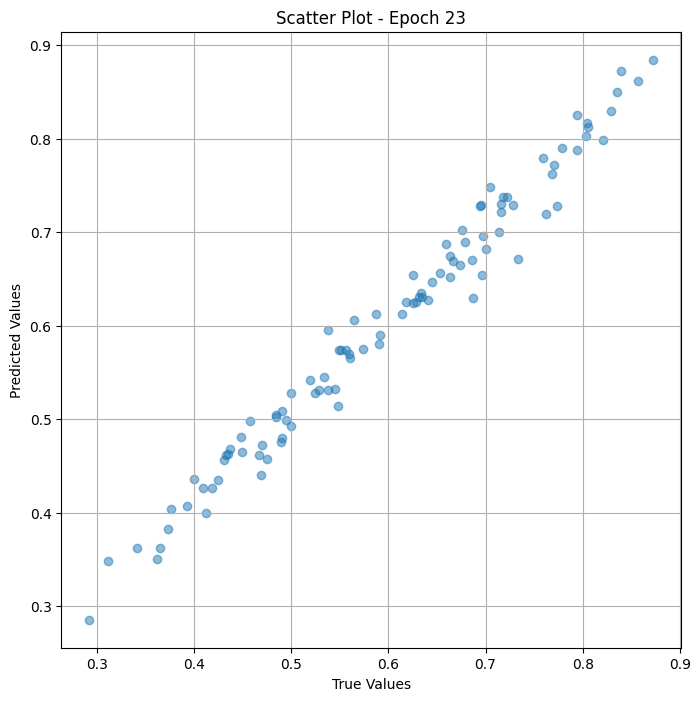

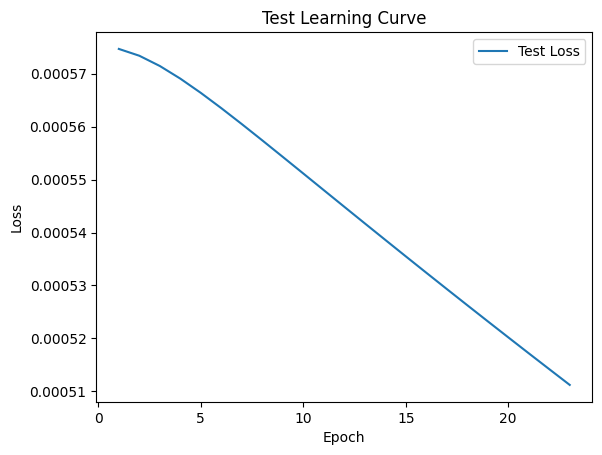


 Epoch: (24/50) Loss = 0.0005082470597699285

 Epoch: (24/50) Loss_rmse = 0.022544335573911667

 Epoch: (24/50) R^2 = 0.9179609417915344

 Epoch: (24/50) MAE = 0.02058350294828415
Spearman correlation coefficient: SignificanceResult(statistic=0.988649504759908, pvalue=3.443563106991944e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

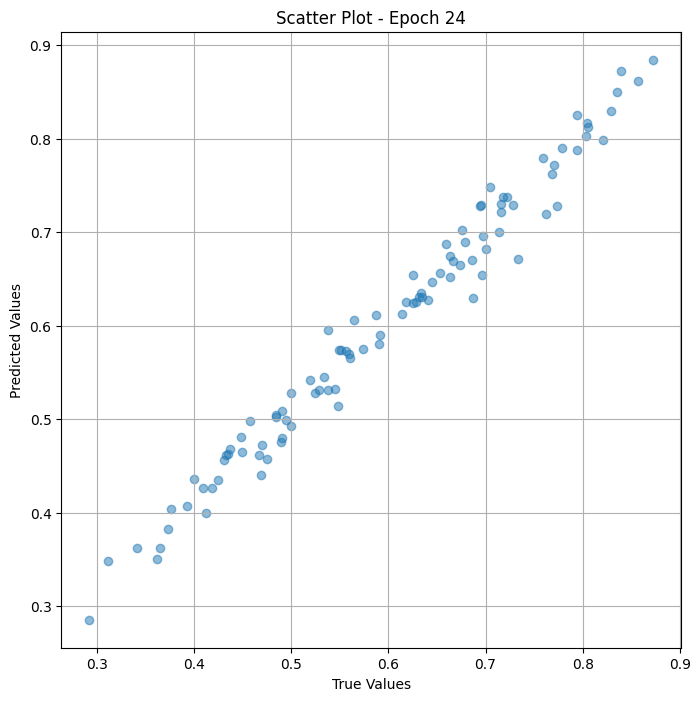

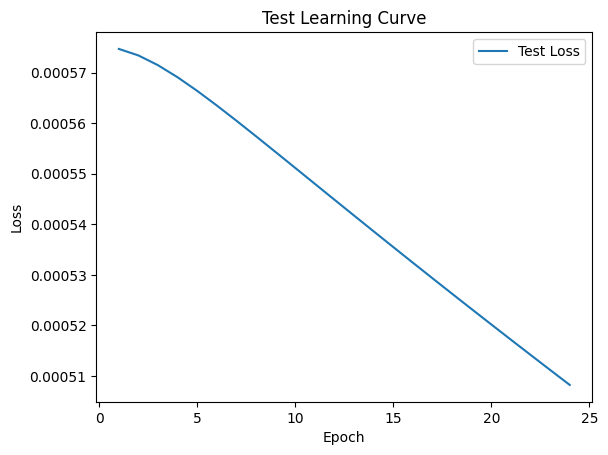


 Epoch: (25/50) Loss = 0.0005052959895692766

 Epoch: (25/50) Loss_rmse = 0.02247878909111023

 Epoch: (25/50) R^2 = 0.9184373021125793

 Epoch: (25/50) MAE = 0.020530439913272858
Spearman correlation coefficient: SignificanceResult(statistic=0.988649504759908, pvalue=3.443563106991944e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

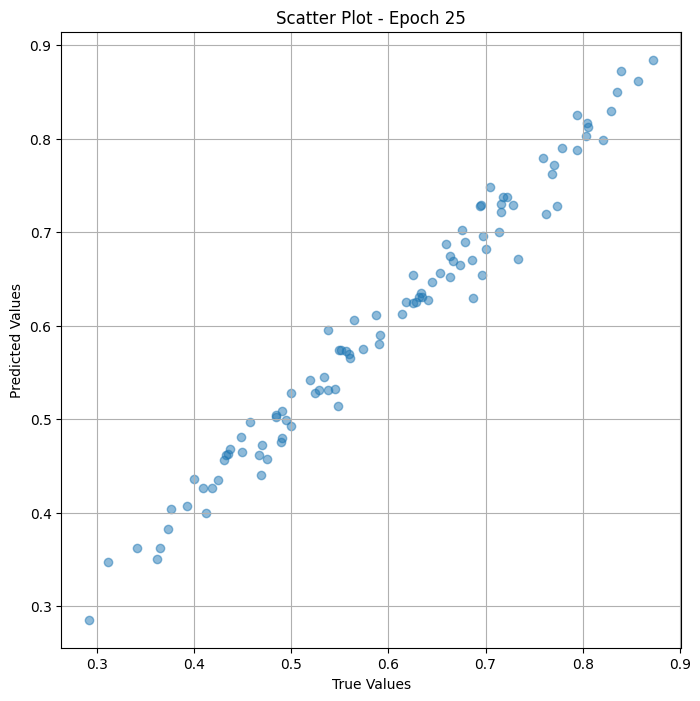

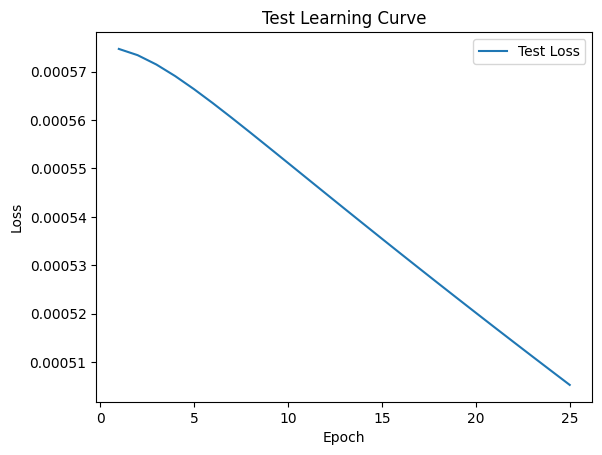


 Epoch: (26/50) Loss = 0.0005023645353503525

 Epoch: (26/50) Loss_rmse = 0.02241349034011364

 Epoch: (26/50) R^2 = 0.9189104437828064

 Epoch: (26/50) MAE = 0.020477555692195892
Spearman correlation coefficient: SignificanceResult(statistic=0.988649504759908, pvalue=3.443563106991944e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

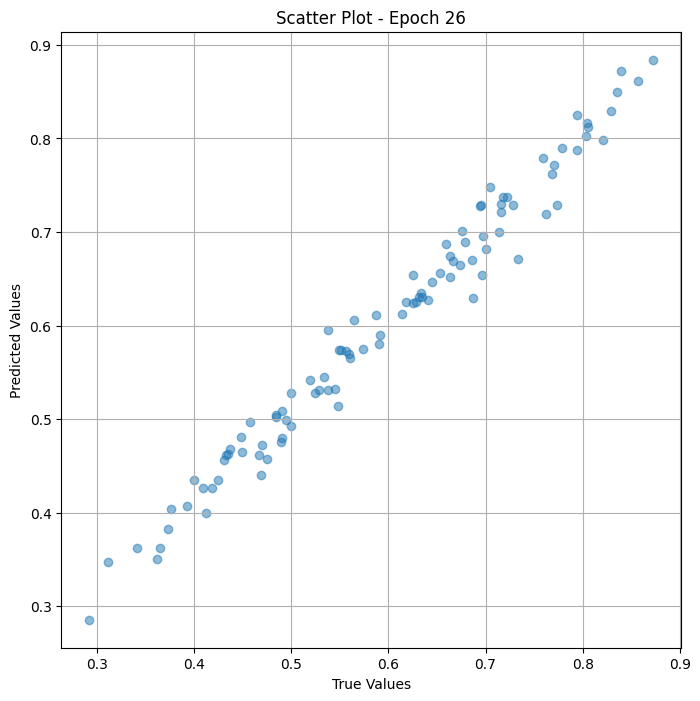

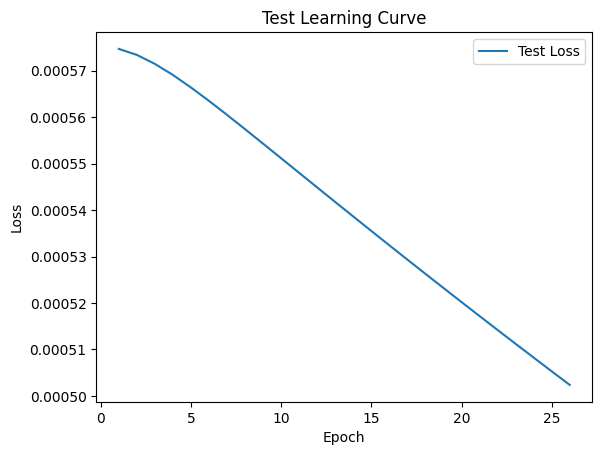


 Epoch: (27/50) Loss = 0.000499445479363203

 Epoch: (27/50) Loss_rmse = 0.022348277270793915

 Epoch: (27/50) R^2 = 0.9193816184997559

 Epoch: (27/50) MAE = 0.020424678921699524
Spearman correlation coefficient: SignificanceResult(statistic=0.988649504759908, pvalue=3.443563106991944e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

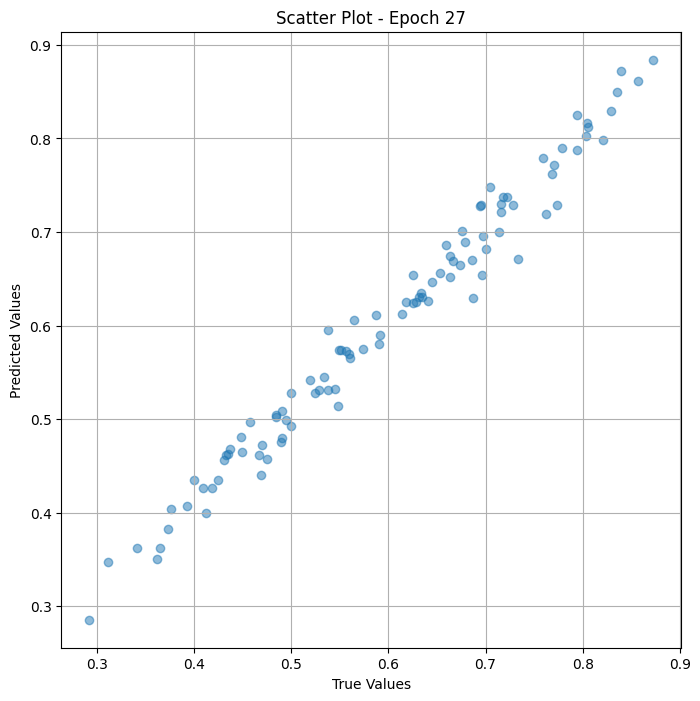

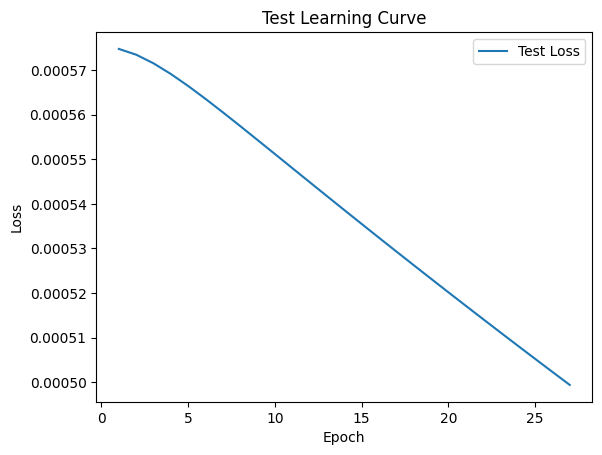


 Epoch: (28/50) Loss = 0.0004965410917066038

 Epoch: (28/50) Loss_rmse = 0.022283202037215233

 Epoch: (28/50) R^2 = 0.9198504686355591

 Epoch: (28/50) MAE = 0.020371899008750916
Spearman correlation coefficient: SignificanceResult(statistic=0.9886223748040267, pvalue=3.8500947107755464e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

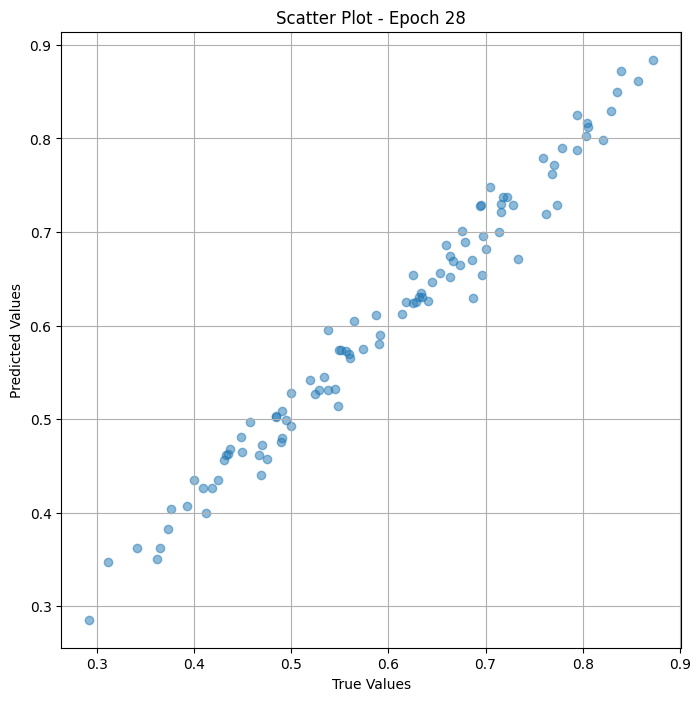

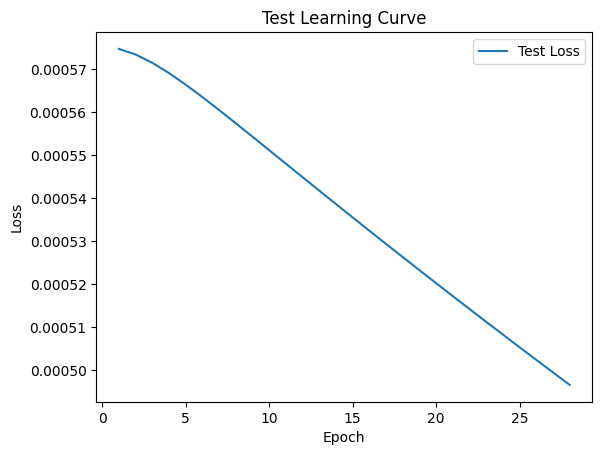


 Epoch: (29/50) Loss = 0.0004936514887958765

 Epoch: (29/50) Loss_rmse = 0.022218268364667892

 Epoch: (29/50) R^2 = 0.9203168749809265

 Epoch: (29/50) MAE = 0.02031920850276947
Spearman correlation coefficient: SignificanceResult(statistic=0.9886223748040267, pvalue=3.8500947107755464e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

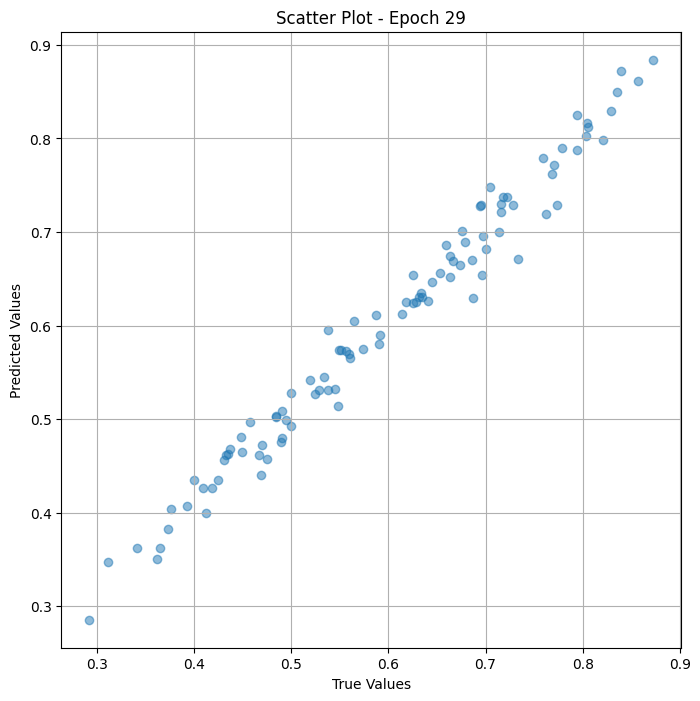

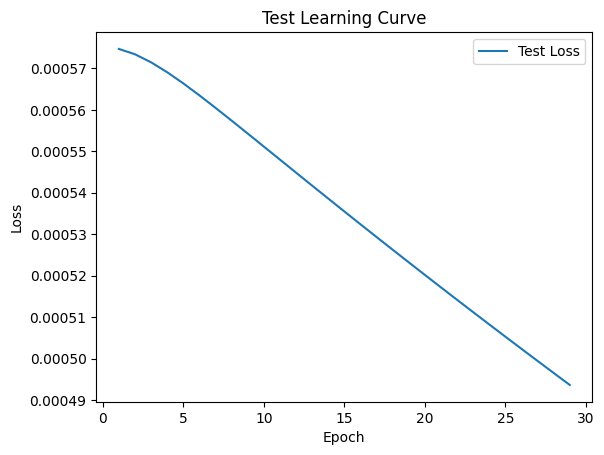


 Epoch: (30/50) Loss = 0.0004907799302600324

 Epoch: (30/50) Loss_rmse = 0.022153552621603012

 Epoch: (30/50) R^2 = 0.9207804203033447

 Epoch: (30/50) MAE = 0.02026667445898056
Spearman correlation coefficient: SignificanceResult(statistic=0.9886223748040267, pvalue=3.8500947107755464e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

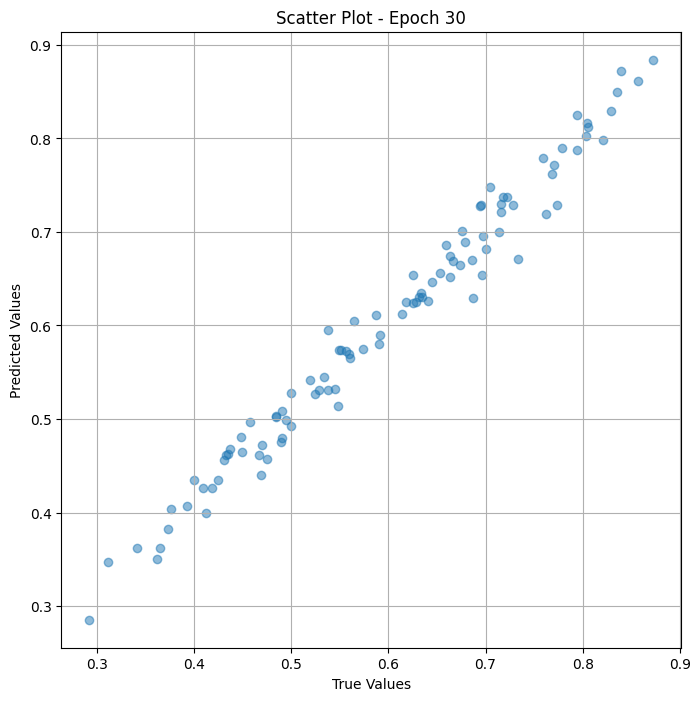

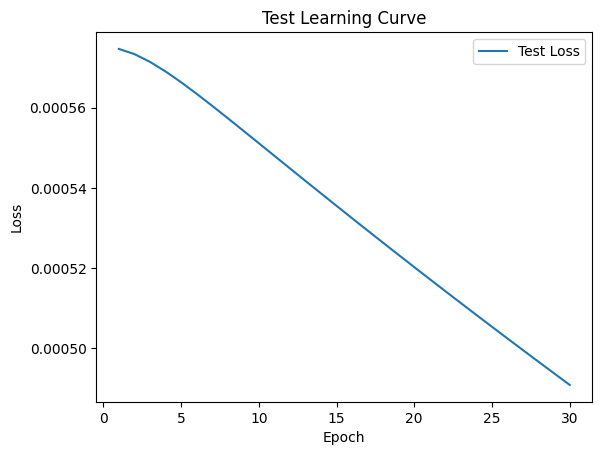


 Epoch: (31/50) Loss = 0.0004879182088188827

 Epoch: (31/50) Loss_rmse = 0.022088870406150818

 Epoch: (31/50) R^2 = 0.921242356300354

 Epoch: (31/50) MAE = 0.02021409571170807
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

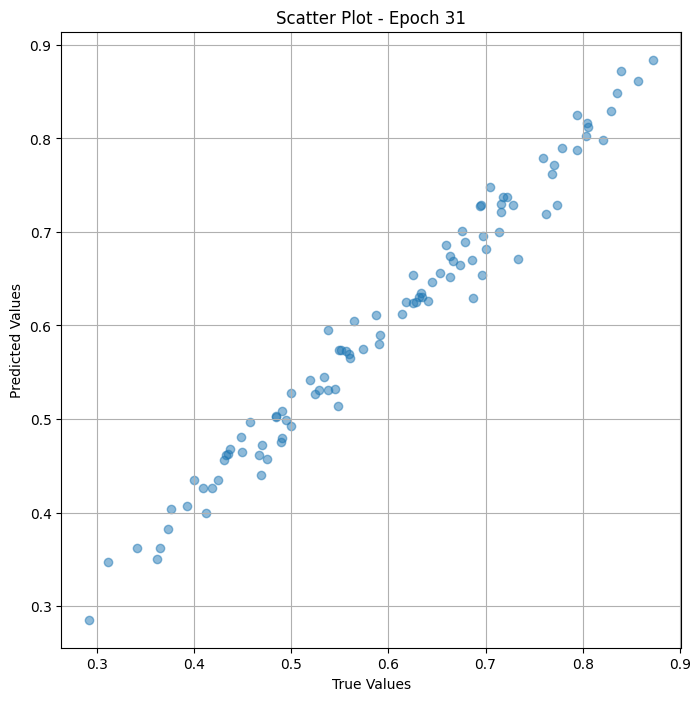

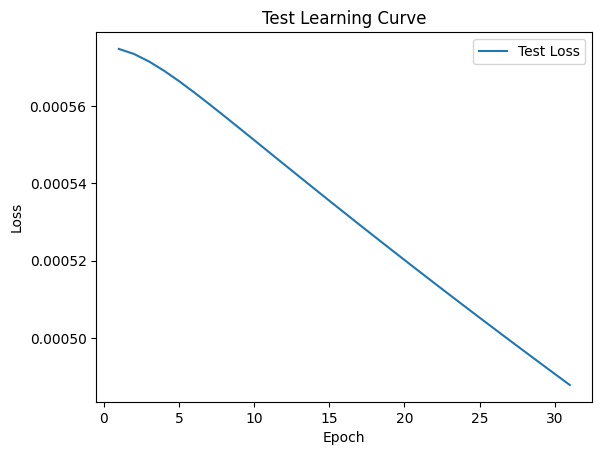


 Epoch: (32/50) Loss = 0.00048507540486752987

 Epoch: (32/50) Loss_rmse = 0.022024426609277725

 Epoch: (32/50) R^2 = 0.921701192855835

 Epoch: (32/50) MAE = 0.0201617032289505
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

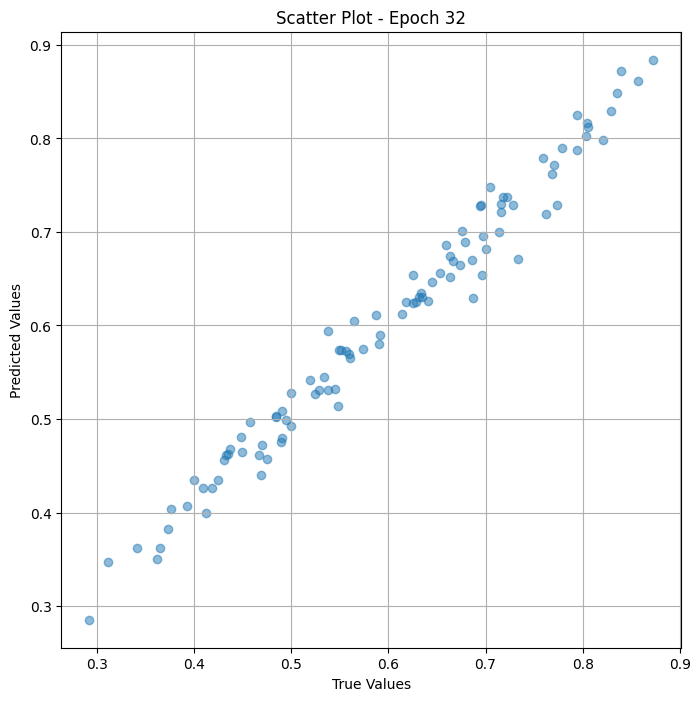

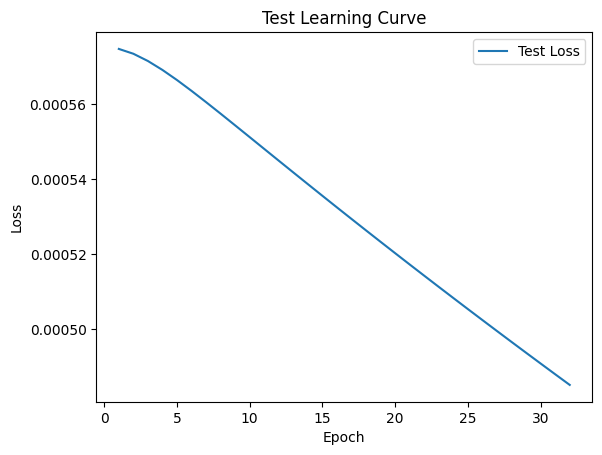


 Epoch: (33/50) Loss = 0.0004822431947104633

 Epoch: (33/50) Loss_rmse = 0.02196003682911396

 Epoch: (33/50) R^2 = 0.9221583604812622

 Epoch: (33/50) MAE = 0.020109347999095917
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

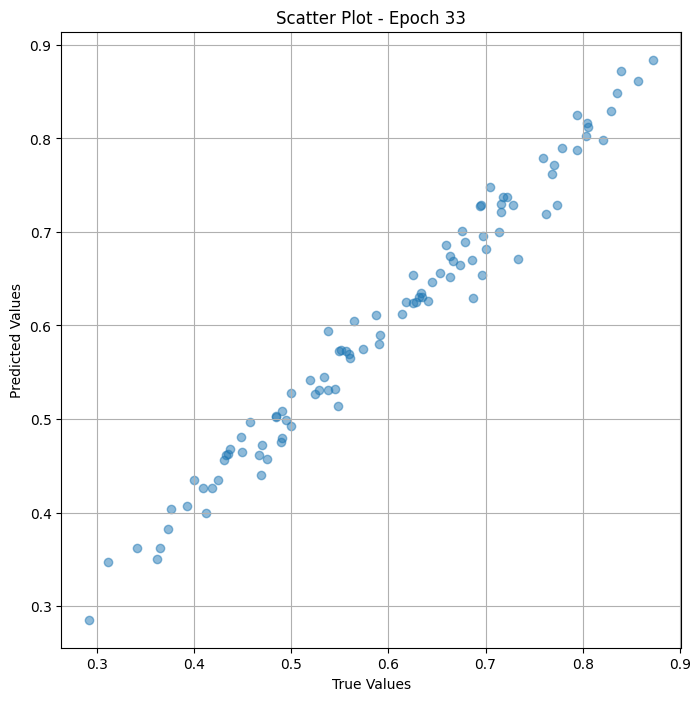

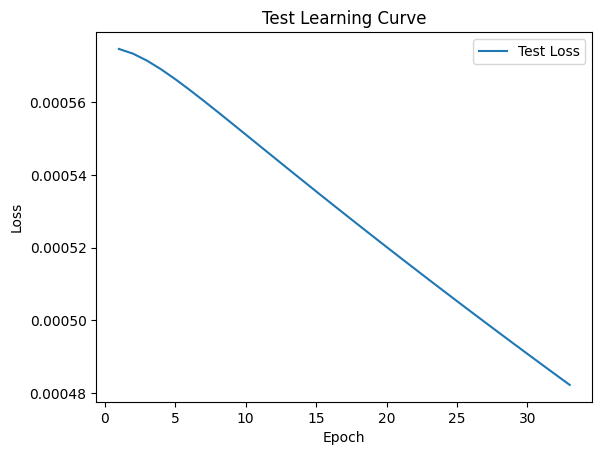


 Epoch: (34/50) Loss = 0.00047942475066520274

 Epoch: (34/50) Loss_rmse = 0.021895769983530045

 Epoch: (34/50) R^2 = 0.9226133227348328

 Epoch: (34/50) MAE = 0.020057007670402527
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0

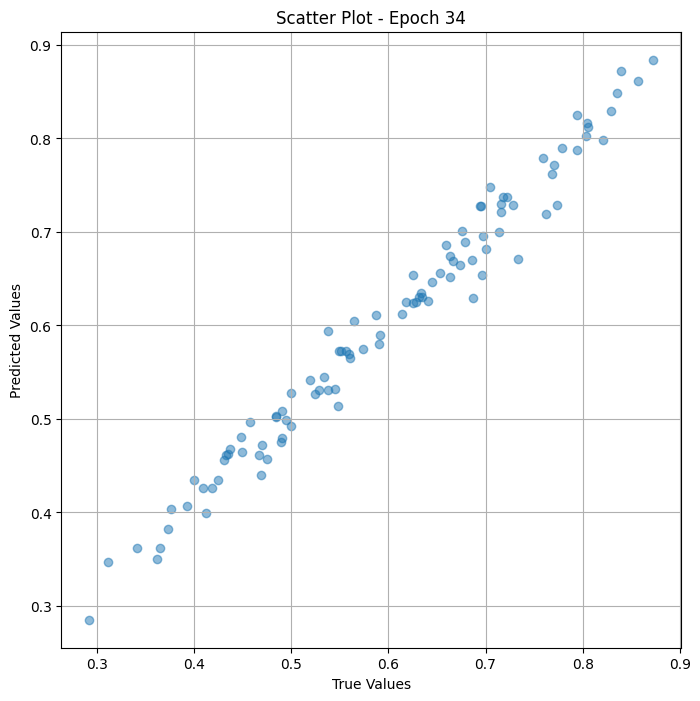

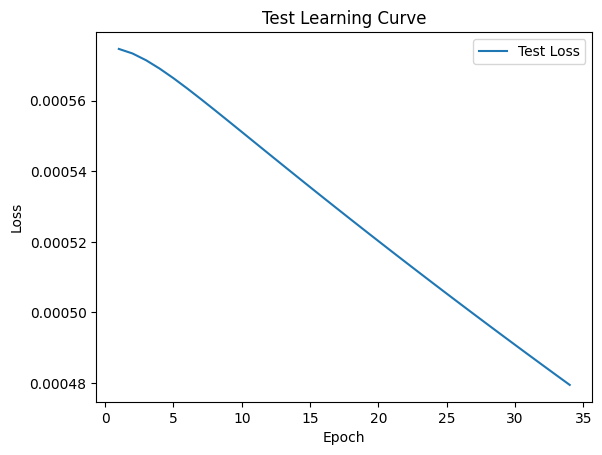


 Epoch: (35/50) Loss = 0.00047662376891821623

 Epoch: (35/50) Loss_rmse = 0.02183171547949314

 Epoch: (35/50) R^2 = 0.9230654239654541

 Epoch: (35/50) MAE = 0.02000483125448227
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

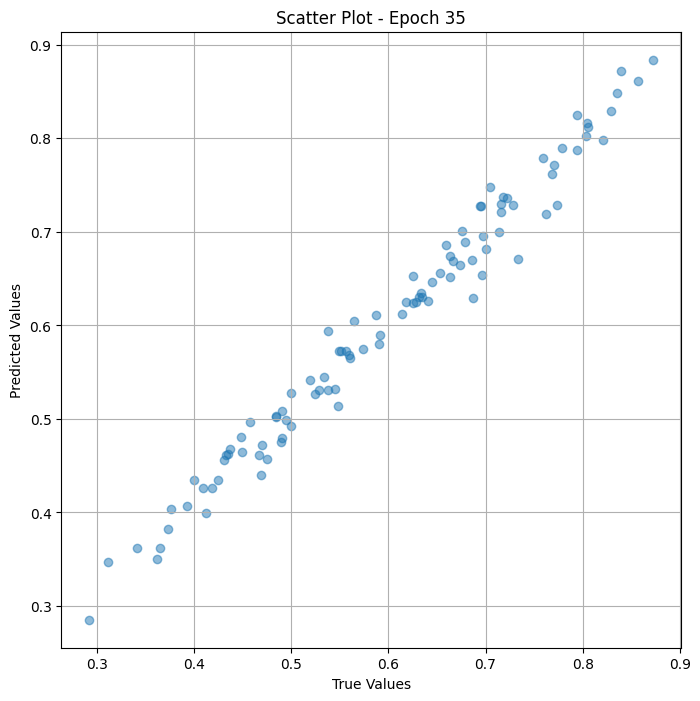

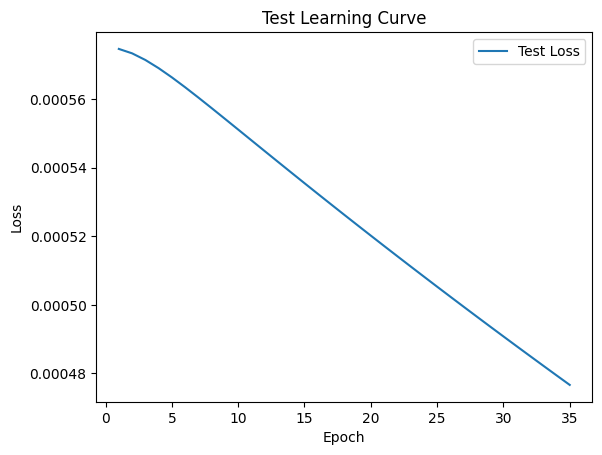


 Epoch: (36/50) Loss = 0.00047383480705320835

 Epoch: (36/50) Loss_rmse = 0.021767746657133102

 Epoch: (36/50) R^2 = 0.9235156178474426

 Epoch: (36/50) MAE = 0.019952714443206787
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0

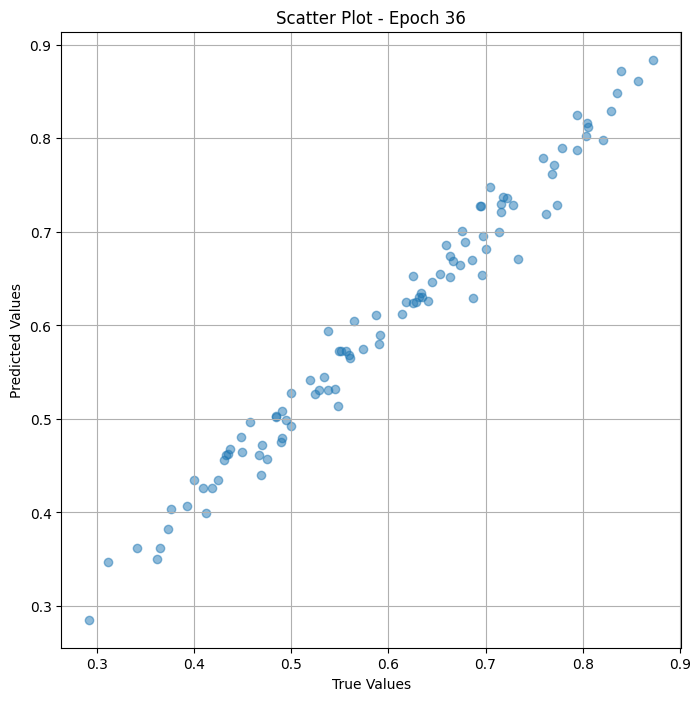

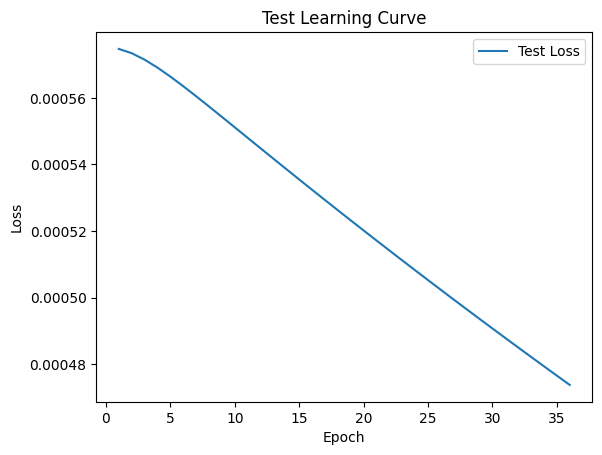


 Epoch: (37/50) Loss = 0.0004710607463493943

 Epoch: (37/50) Loss_rmse = 0.0217039342969656

 Epoch: (37/50) R^2 = 0.9239633679389954

 Epoch: (37/50) MAE = 0.01990067958831787
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

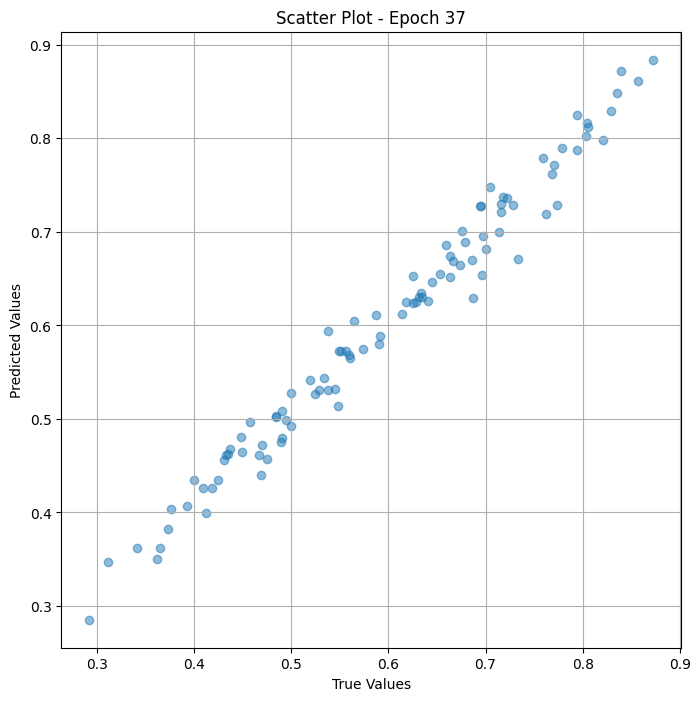

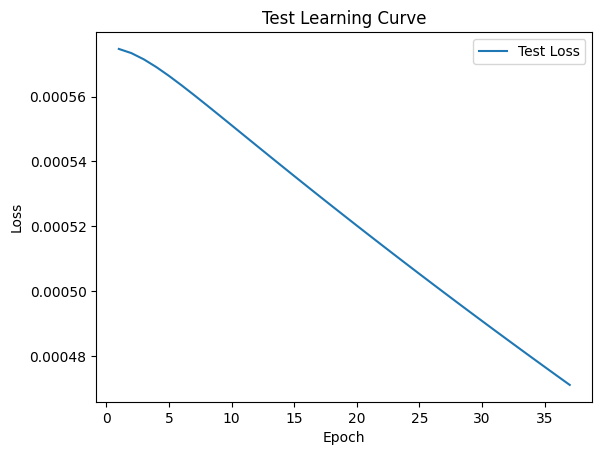


 Epoch: (38/50) Loss = 0.0004682953585870564

 Epoch: (38/50) Loss_rmse = 0.02164013311266899

 Epoch: (38/50) R^2 = 0.9244097471237183

 Epoch: (38/50) MAE = 0.01984860748052597
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

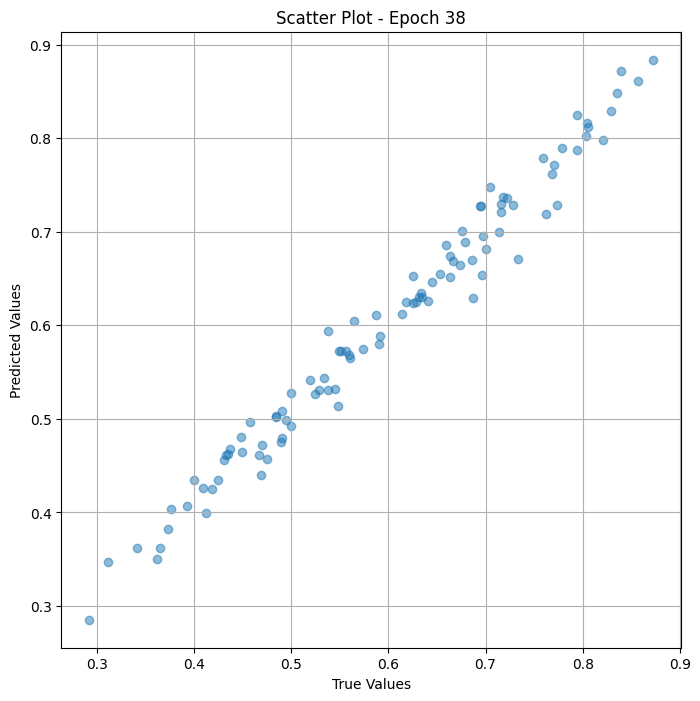

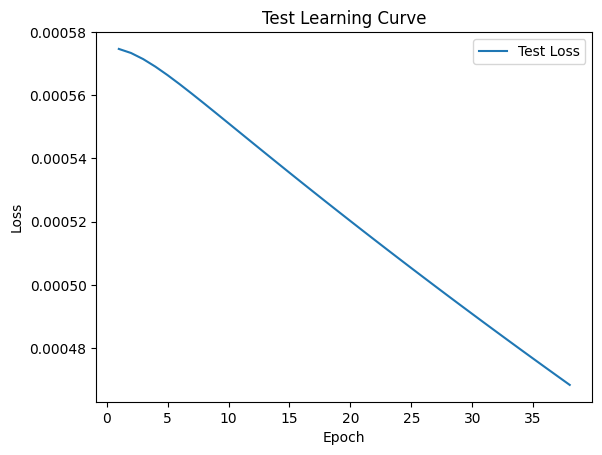


 Epoch: (39/50) Loss = 0.00046555284643545747

 Epoch: (39/50) Loss_rmse = 0.021576672792434692

 Epoch: (39/50) R^2 = 0.9248524308204651

 Epoch: (39/50) MAE = 0.01979680359363556
Spearman correlation coefficient: SignificanceResult(statistic=0.9888394144510771, pvalue=1.5648314441049892e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

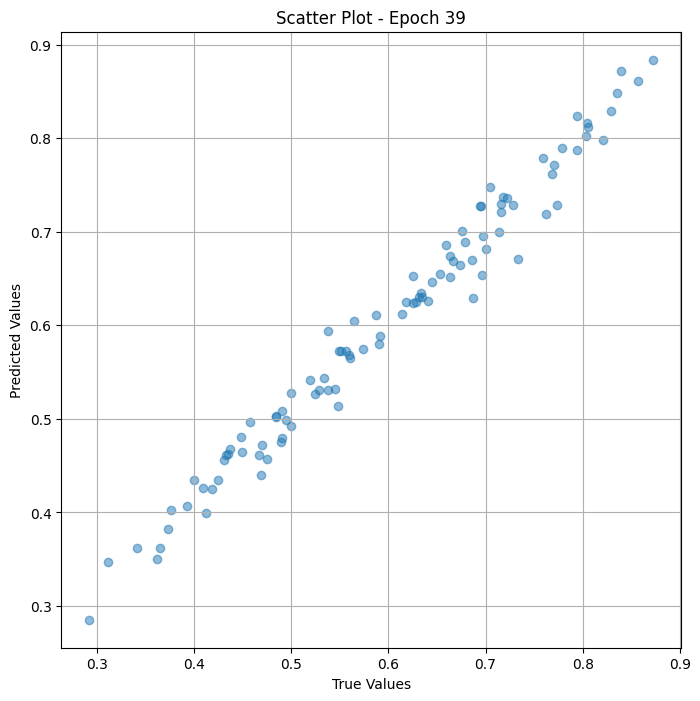

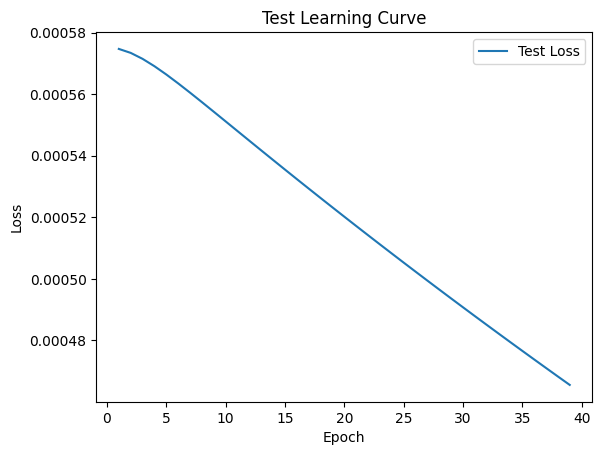


 Epoch: (40/50) Loss = 0.0004628158931154758

 Epoch: (40/50) Loss_rmse = 0.021513156592845917

 Epoch: (40/50) R^2 = 0.9252942204475403

 Epoch: (40/50) MAE = 0.019744873046875
Spearman correlation coefficient: SignificanceResult(statistic=0.9888733268959289, pvalue=1.357323581332113e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5196

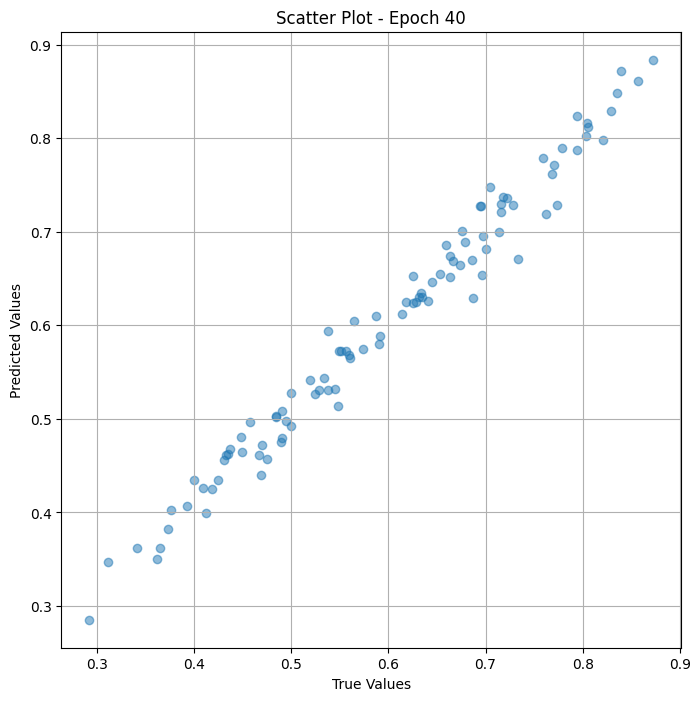

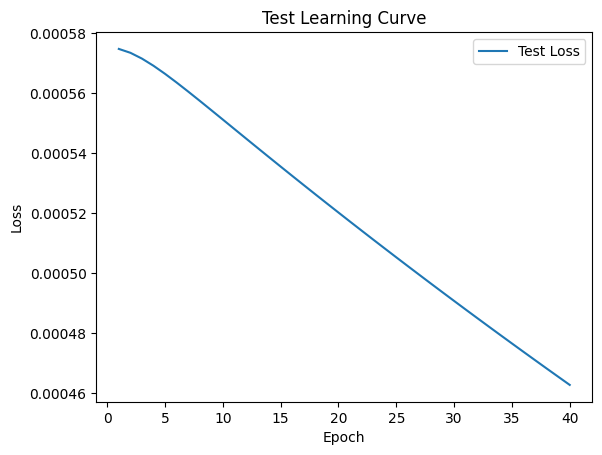


 Epoch: (41/50) Loss = 0.00046009739162400365

 Epoch: (41/50) Loss_rmse = 0.021449880674481392

 Epoch: (41/50) R^2 = 0.9257330298423767

 Epoch: (41/50) MAE = 0.01969316601753235
Spearman correlation coefficient: SignificanceResult(statistic=0.9888733268959289, pvalue=1.357323581332113e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

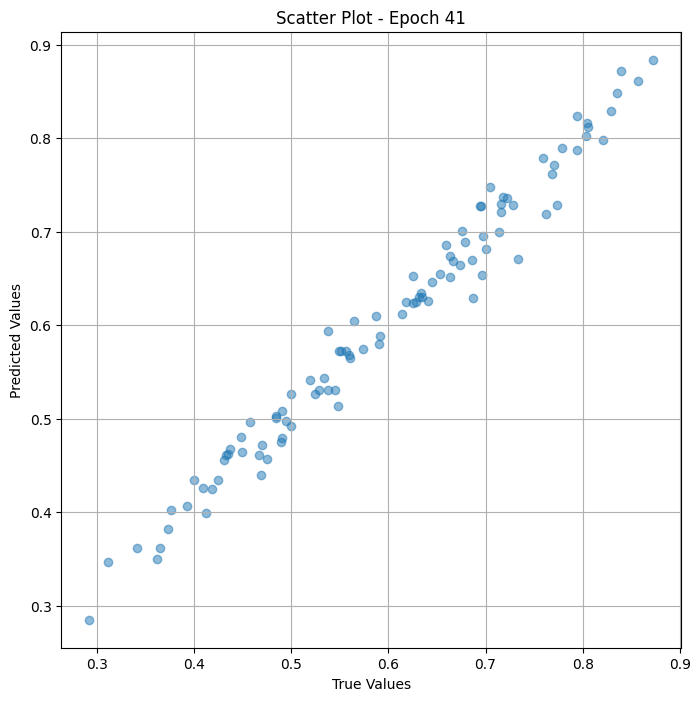

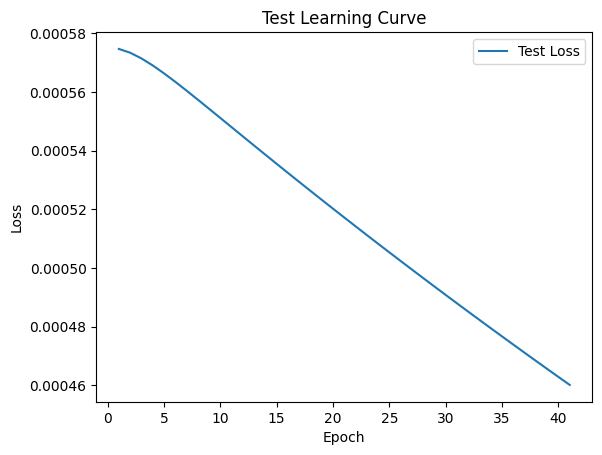


 Epoch: (42/50) Loss = 0.0004573881742544472

 Epoch: (42/50) Loss_rmse = 0.021386634558439255

 Epoch: (42/50) R^2 = 0.9261703491210938

 Epoch: (42/50) MAE = 0.01964142918586731
Spearman correlation coefficient: SignificanceResult(statistic=0.9888733268959289, pvalue=1.357323581332113e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

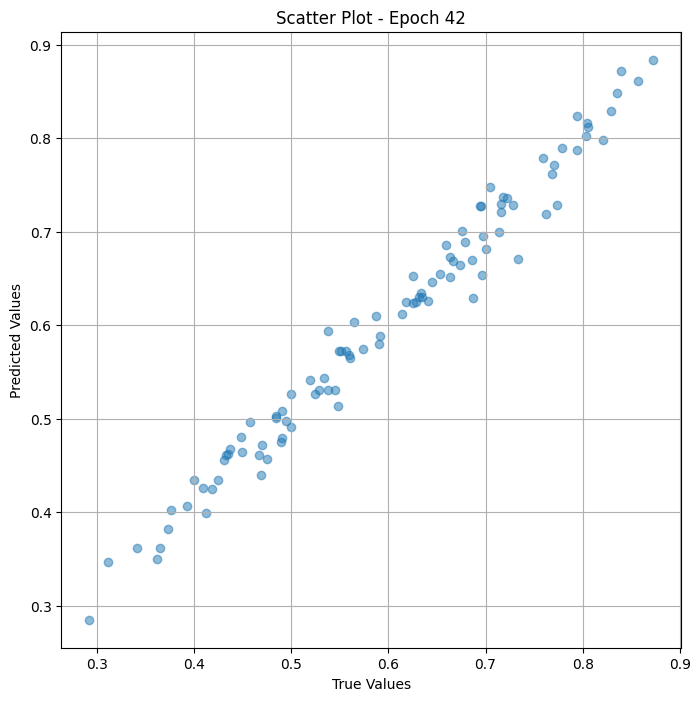

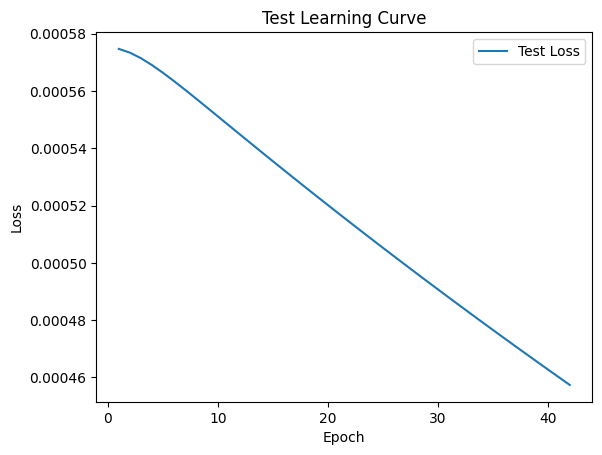


 Epoch: (43/50) Loss = 0.0004546958371065557

 Epoch: (43/50) Loss_rmse = 0.02132359892129898

 Epoch: (43/50) R^2 = 0.9266049265861511

 Epoch: (43/50) MAE = 0.01958981156349182
Spearman correlation coefficient: SignificanceResult(statistic=0.9889072393407805, pvalue=1.1768188176983363e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

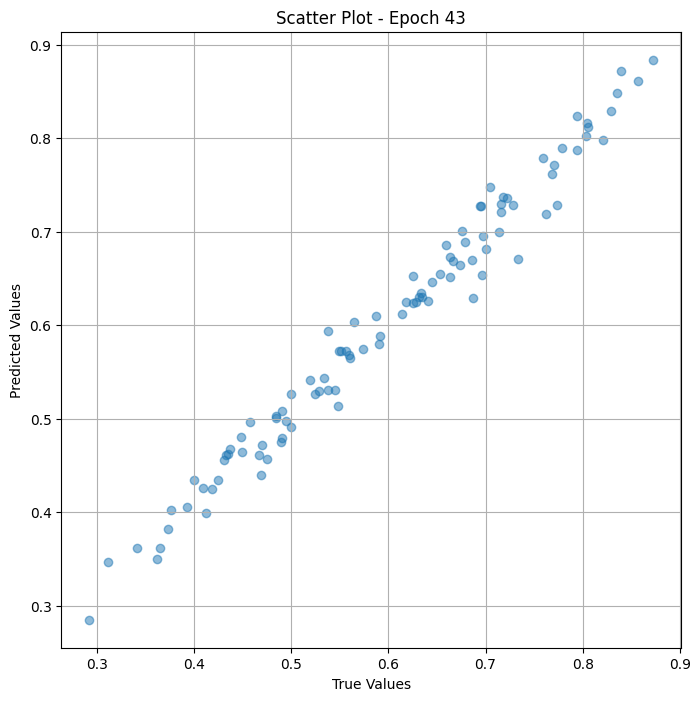

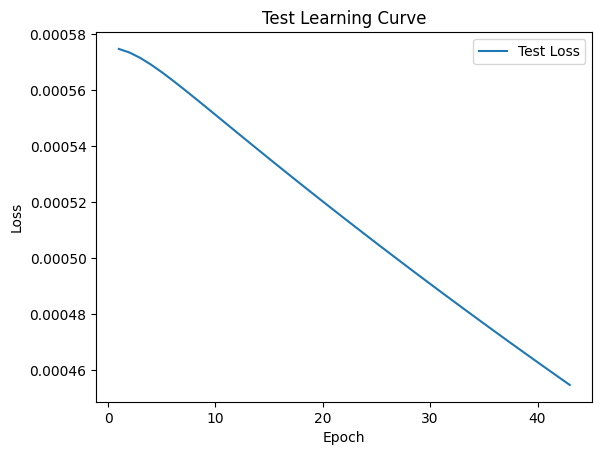


 Epoch: (44/50) Loss = 0.00045201461762189865

 Epoch: (44/50) Loss_rmse = 0.021260635927319527

 Epoch: (44/50) R^2 = 0.9270377159118652

 Epoch: (44/50) MAE = 0.019538231194019318
Spearman correlation coefficient: SignificanceResult(statistic=0.9889072393407805, pvalue=1.1768188176983363e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0

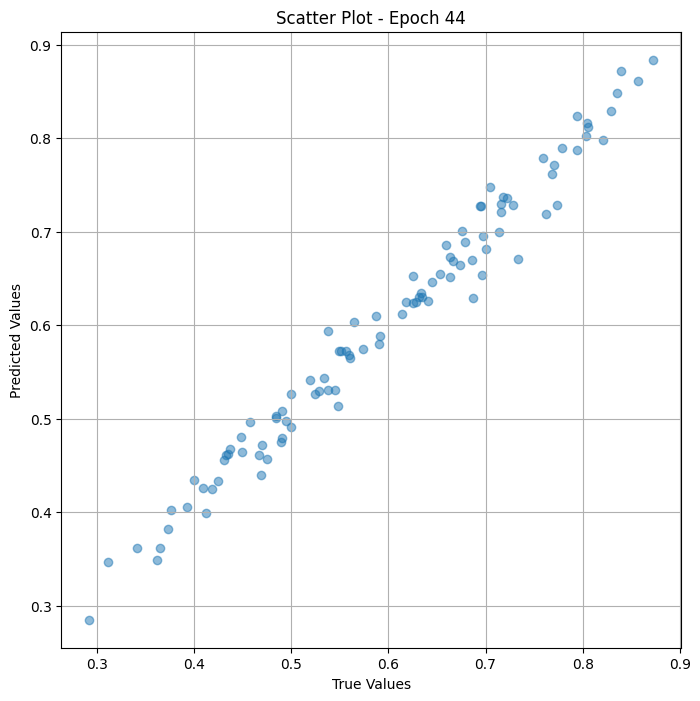

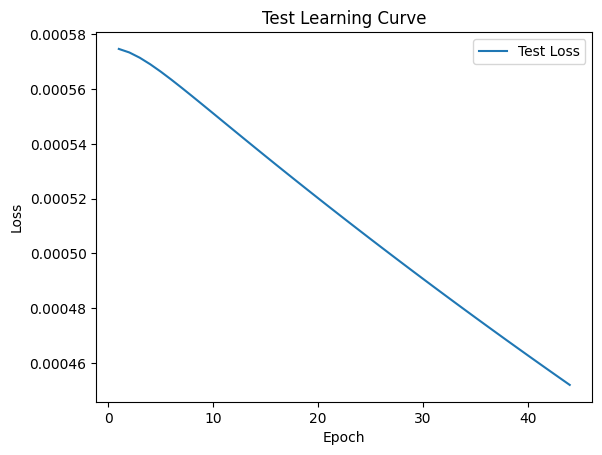


 Epoch: (45/50) Loss = 0.00044934666948392987

 Epoch: (45/50) Loss_rmse = 0.02119779959321022

 Epoch: (45/50) R^2 = 0.9274683594703674

 Epoch: (45/50) MAE = 0.01948673278093338
Spearman correlation coefficient: SignificanceResult(statistic=0.9889072393407805, pvalue=1.1768188176983363e-79)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

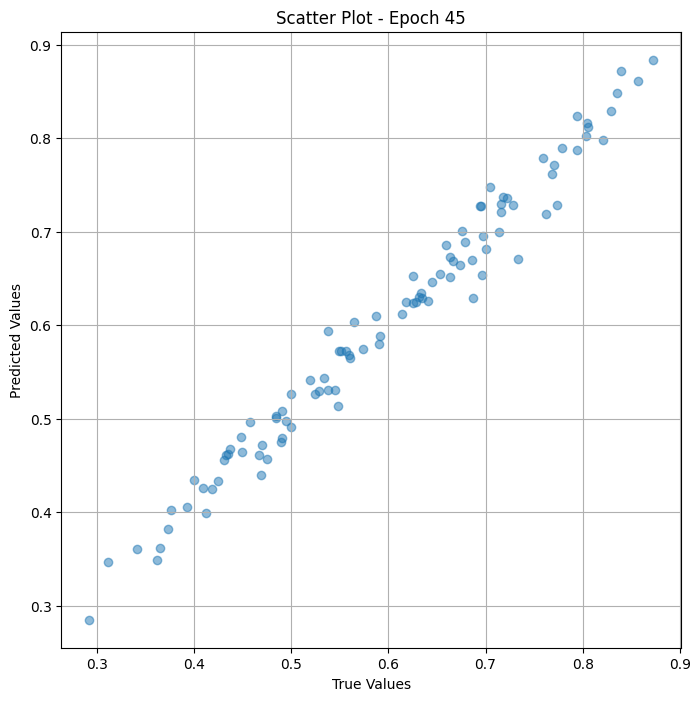

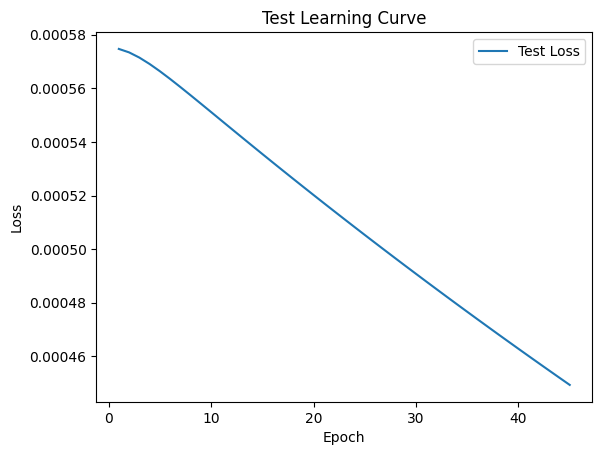


 Epoch: (46/50) Loss = 0.0004466918180696666

 Epoch: (46/50) Loss_rmse = 0.021135084331035614

 Epoch: (46/50) R^2 = 0.9278969168663025

 Epoch: (46/50) MAE = 0.019435271620750427
Spearman correlation coefficient: SignificanceResult(statistic=0.9889886292084243, pvalue=8.340496177985283e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

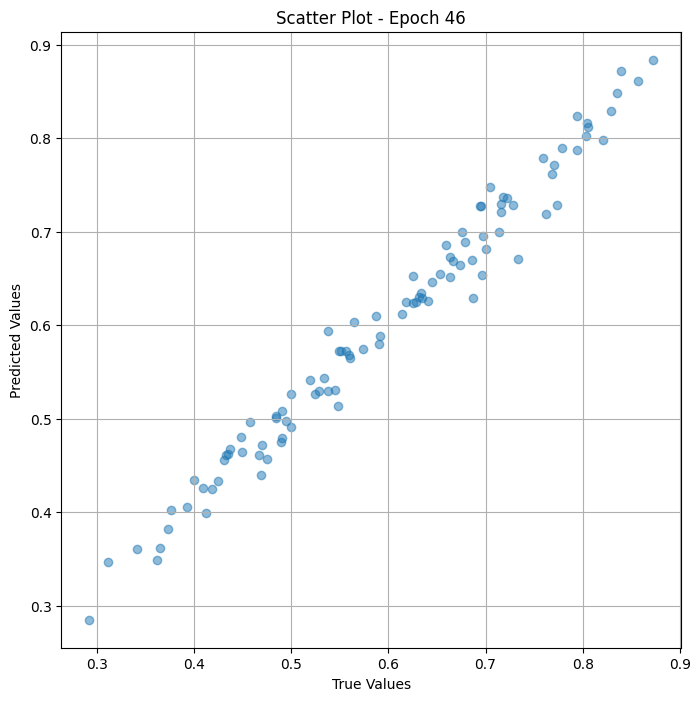

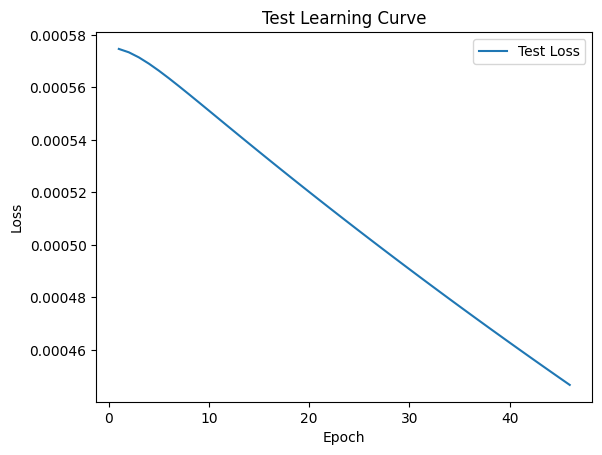


 Epoch: (47/50) Loss = 0.0004440510820131749

 Epoch: (47/50) Loss_rmse = 0.021072519943118095

 Epoch: (47/50) R^2 = 0.9283231496810913

 Epoch: (47/50) MAE = 0.019383922219276428
Spearman correlation coefficient: SignificanceResult(statistic=0.9889886292084243, pvalue=8.340496177985283e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

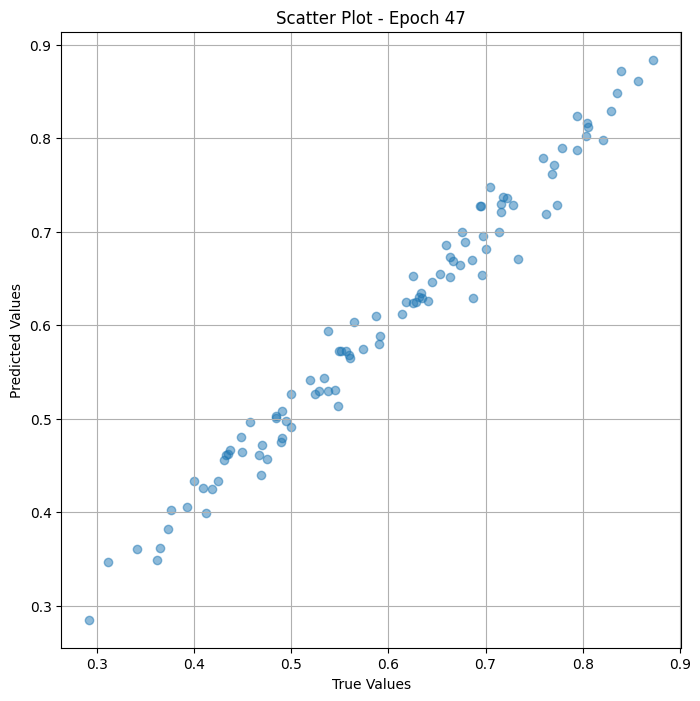

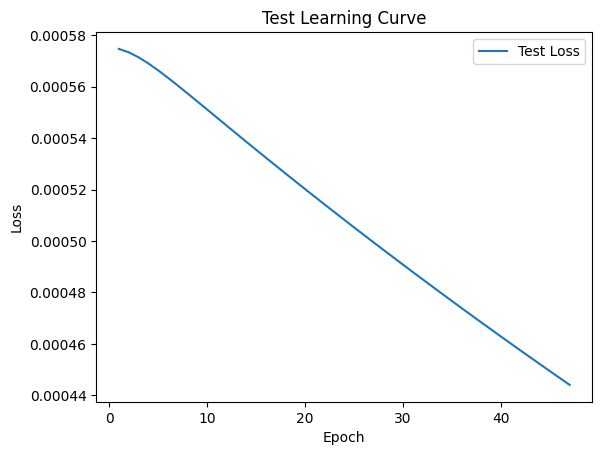


 Epoch: (48/50) Loss = 0.00044142059050500393

 Epoch: (48/50) Loss_rmse = 0.021010011434555054

 Epoch: (48/50) R^2 = 0.9287477731704712

 Epoch: (48/50) MAE = 0.019332565367221832
Spearman correlation coefficient: SignificanceResult(statistic=0.9889886292084243, pvalue=8.340496177985283e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

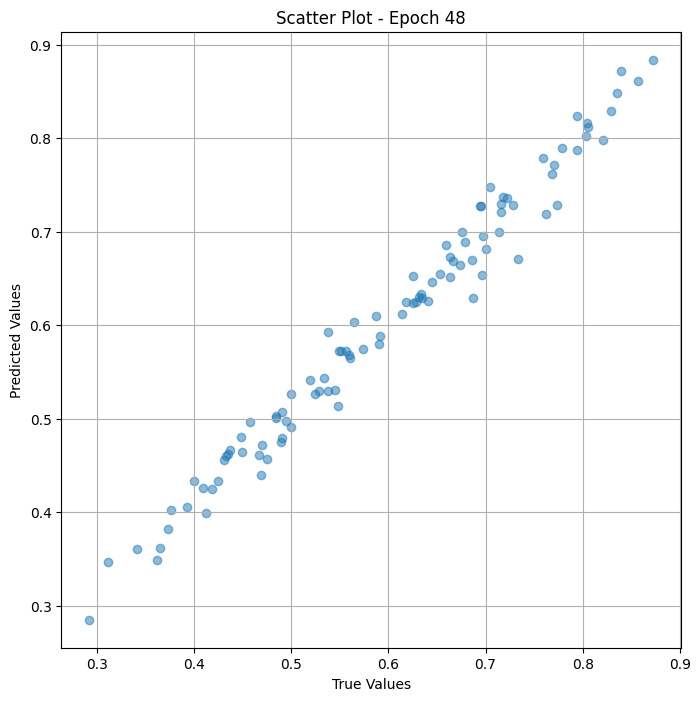

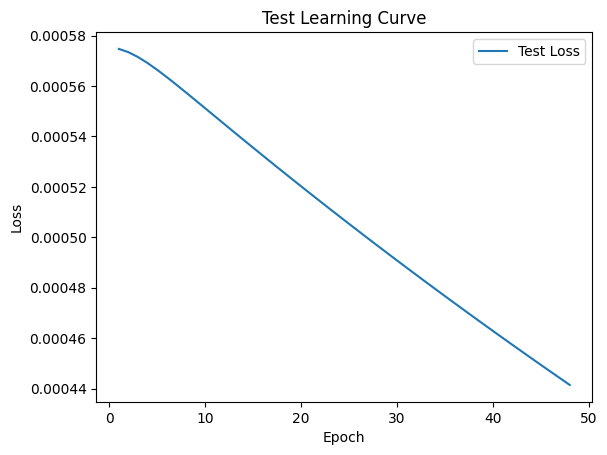


 Epoch: (49/50) Loss = 0.00043880866724066436

 Epoch: (49/50) Loss_rmse = 0.020947759971022606

 Epoch: (49/50) R^2 = 0.9291693568229675

 Epoch: (49/50) MAE = 0.01928141713142395
Spearman correlation coefficient: SignificanceResult(statistic=0.9890428891201871, pvalue=6.6205620388518765e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

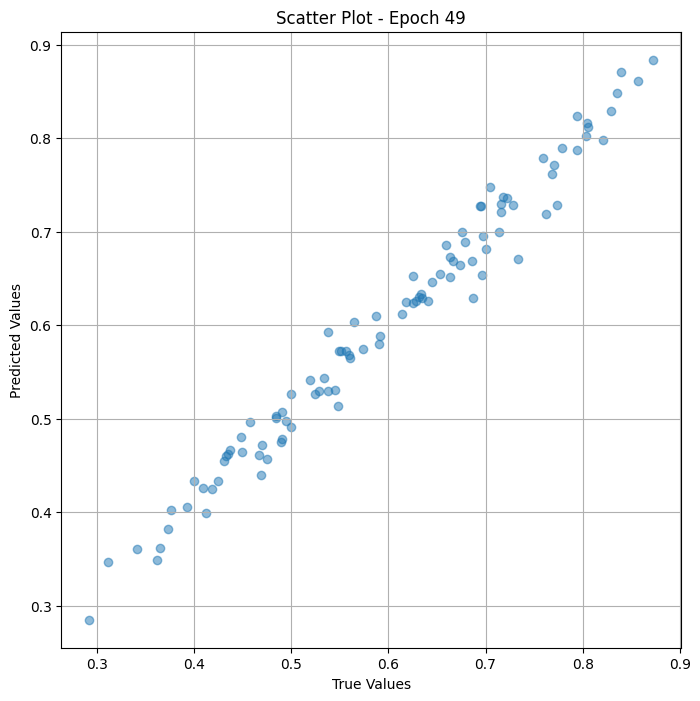

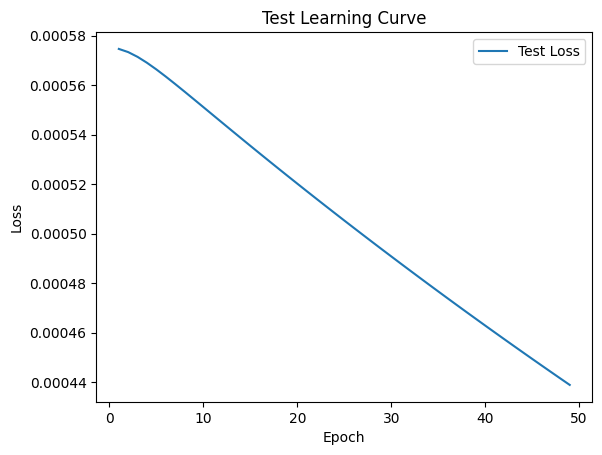


 Epoch: (50/50) Loss = 0.0004362036706879735

 Epoch: (50/50) Loss_rmse = 0.020885489881038666

 Epoch: (50/50) R^2 = 0.9295898675918579

 Epoch: (50/50) MAE = 0.0192301943898201
Spearman correlation coefficient: SignificanceResult(statistic=0.9890428891201871, pvalue=6.6205620388518765e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

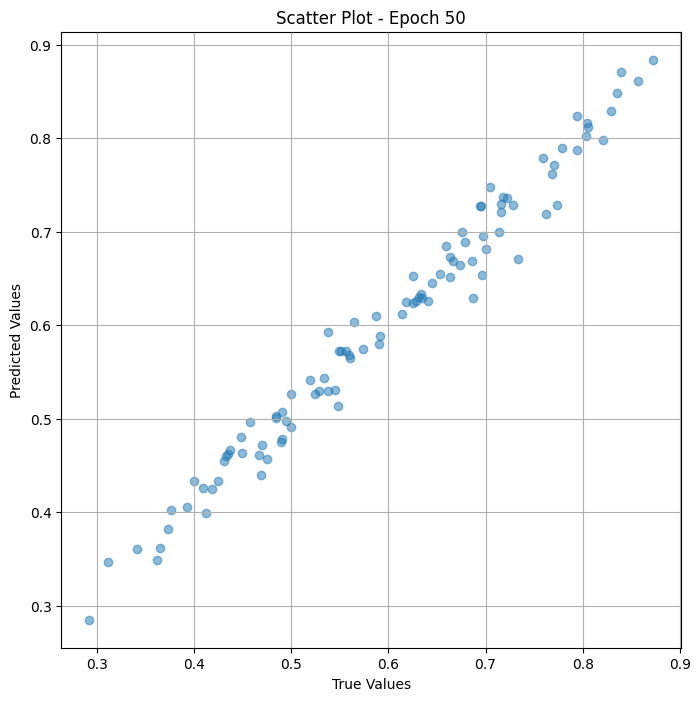

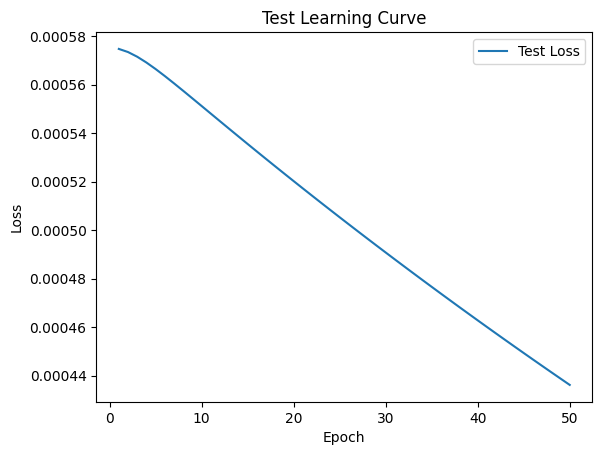

In [ ]:
# val the model and save weights
fit(50, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_landscape' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_test_landscape['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

#Finetuning

##Train

In [ ]:
class Dataset_train_fine(Dataset):
    def __init__(self, df, trans_transform=None):
        self.labels = df_train_landscape["memoscore"]
        self.images = df_train_landscape["preprocessed_image_path"]
        self.trans_transform = trans_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.trans_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')

# สร้าง Dataset และ DataLoader
train_ds_fine = Dataset_train_fine(df_train_landscape, trans_transform=trans_transform)
train_dl_fine = DataLoader(train_ds_fine, batch_size=32, shuffle=False)

# เรียกดูข้อมูลจาก DataLoader
'''for image_trans, label in train_dl:
    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch
    print(image_trans)
    break'''


'for image_trans, label in train_dl:\n    # คำสั่งนี้จะแสดงขนาดของรูปภาพที่ transform แล้วในแต่ละ batch\n    print(image_trans)\n    break'

In [ ]:
class ViTMem_model_fine_ve(torch.nn.Module):
    def __init__(self, arch="vit_base_patch16_224_miil"):
        super().__init__()
        self.arch = arch
        self.vit = timm.create_model(self.arch, pretrained=True, num_classes=1)
        self.trans_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        vitfeat = self.vit(x)
        adap = self.trans_AdaptiveAvgPool(x)
        out = torch.sigmoid(vitfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_vit_fine =  ViTMem_model_fine_ve( arch="vit_base_patch16_224_miil")

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_fine = DeviceDataLoader(train_dl_fine, device)
model_vit_fine  = to_device(model_vit_fine  , device)

In [ ]:
params = [param for param in list(model_vit_fine.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_fine, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_fine.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_fine(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/30) Loss = 0.006241347640752792

 Epoch: (1/30) Loss_rmse = 0.07900220155715942

 Epoch: (1/30) R^2 = 0.7326227426528931

 Epoch: (1/30) MAE = 0.06497973203659058
Spearman correlation coefficient: SignificanceResult(statistic=0.3952841989096139, pvalue=4.3527928009374675e-68)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0

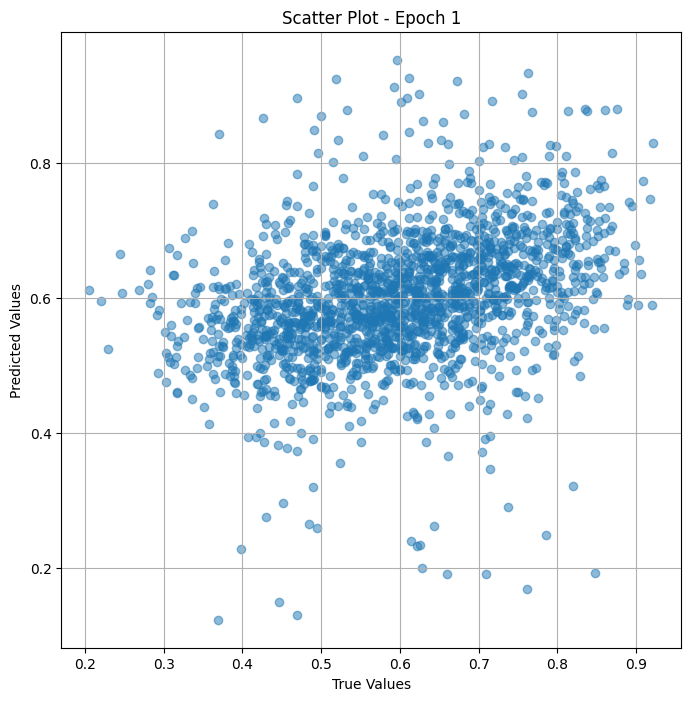

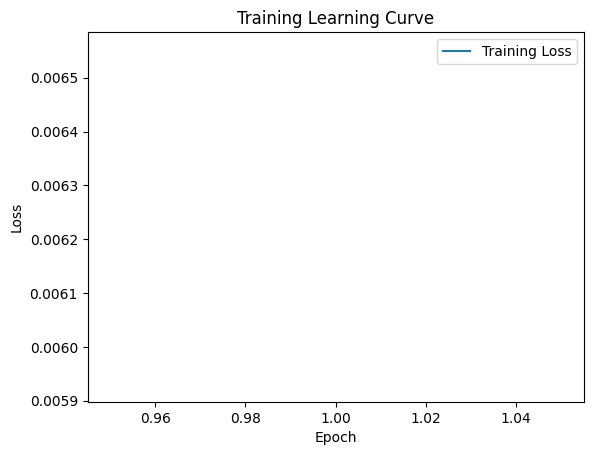


 Epoch: (2/30) Loss = 0.0013516762992367148

 Epoch: (2/30) Loss_rmse = 0.03676515072584152

 Epoch: (2/30) R^2 = 0.942094624042511

 Epoch: (2/30) MAE = 0.026470642536878586
Spearman correlation coefficient: SignificanceResult(statistic=0.6782586487871309, pvalue=8.149716383786852e-242)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 

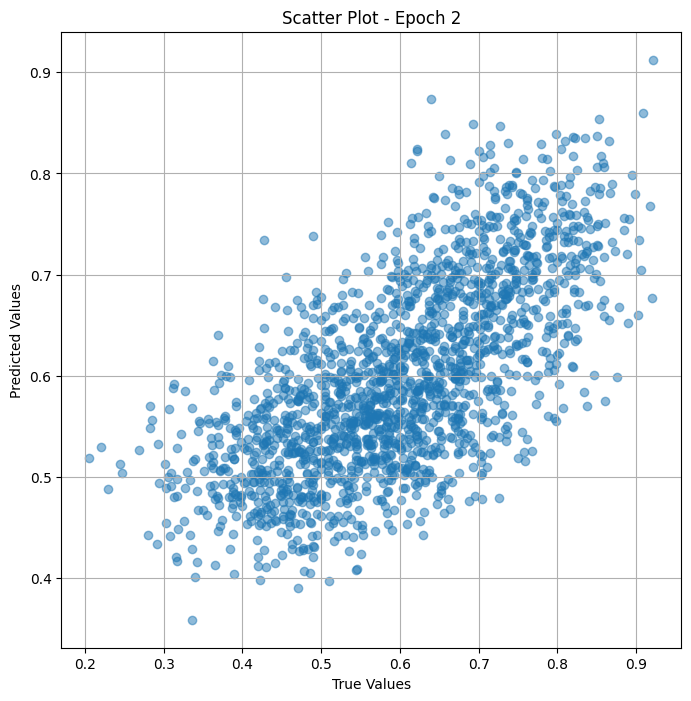

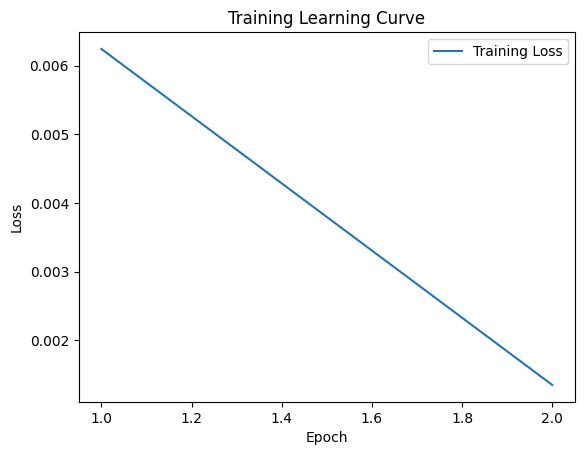


 Epoch: (3/30) Loss = 0.0012981470208615065

 Epoch: (3/30) Loss_rmse = 0.03602980822324753

 Epoch: (3/30) R^2 = 0.9443877935409546

 Epoch: (3/30) MAE = 0.024229463189840317
Spearman correlation coefficient: SignificanceResult(statistic=0.8099644566309729, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.51546

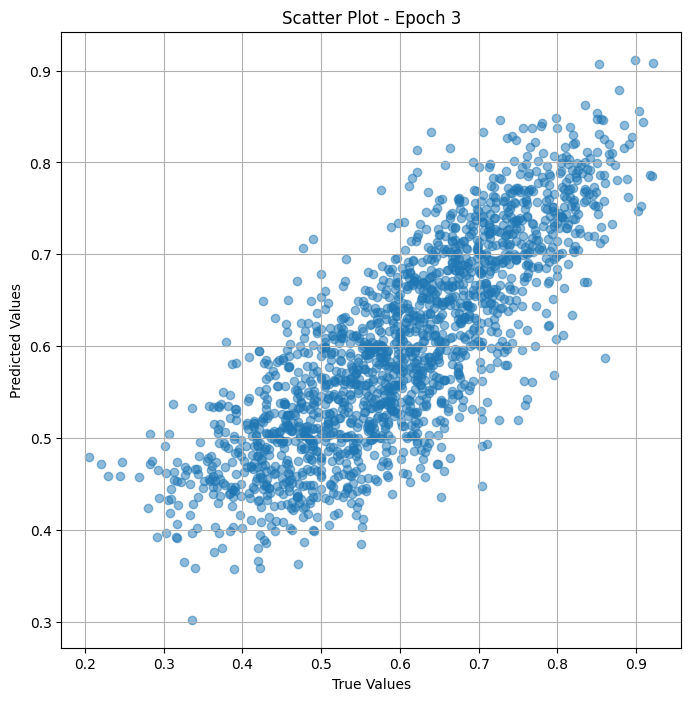

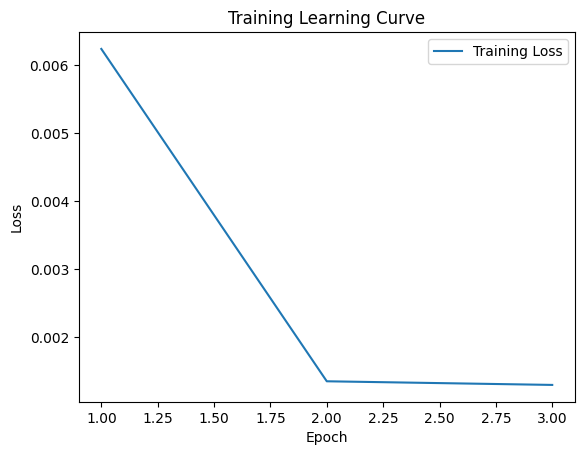


 Epoch: (4/30) Loss = 0.00529300794005394

 Epoch: (4/30) Loss_rmse = 0.07275306433439255

 Epoch: (4/30) R^2 = 0.7732492685317993

 Epoch: (4/30) MAE = 0.046730801463127136
Spearman correlation coefficient: SignificanceResult(statistic=0.8722804444847877, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5154639

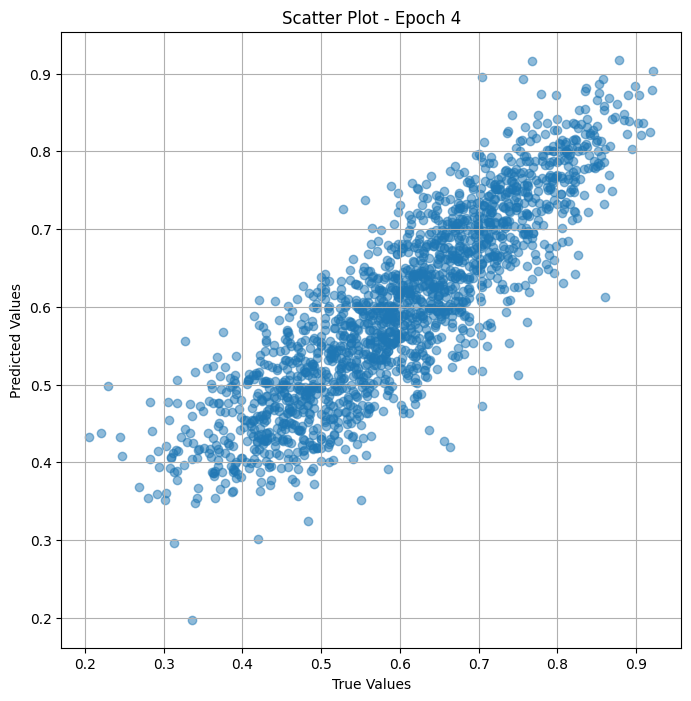

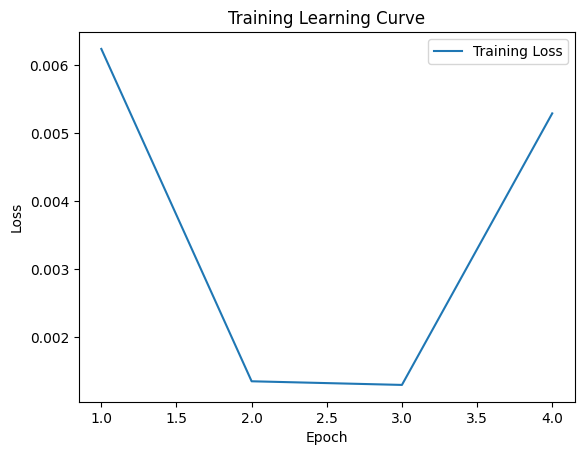


 Epoch: (5/30) Loss = 0.005883194040507078

 Epoch: (5/30) Loss_rmse = 0.07670198380947113

 Epoch: (5/30) R^2 = 0.7479658722877502

 Epoch: (5/30) MAE = 0.06696242094039917
Spearman correlation coefficient: SignificanceResult(statistic=0.8200846548104614, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5154639

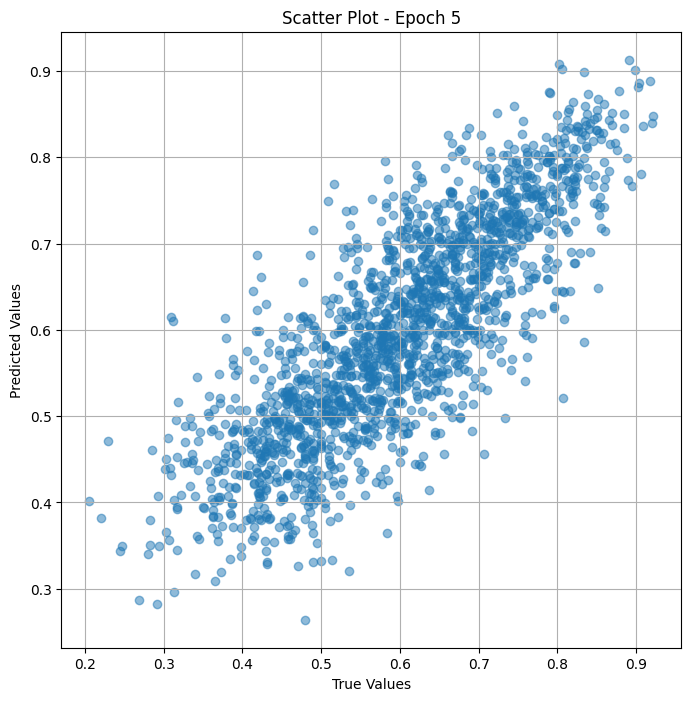

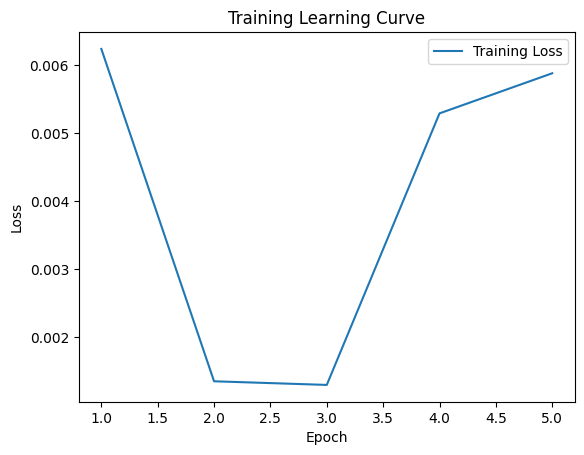

Epoch 0.05: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (6/30) Loss = 0.0029047371353954077

 Epoch: (6/30) Loss_rmse = 0.05389561504125595

 Epoch: (6/30) R^2 = 0.8755620121955872

 Epoch: (6/30) MAE = 0.04719235748052597
Spearman correlation coefficient: SignificanceResult(statistic=0.7729722785954658, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.609523

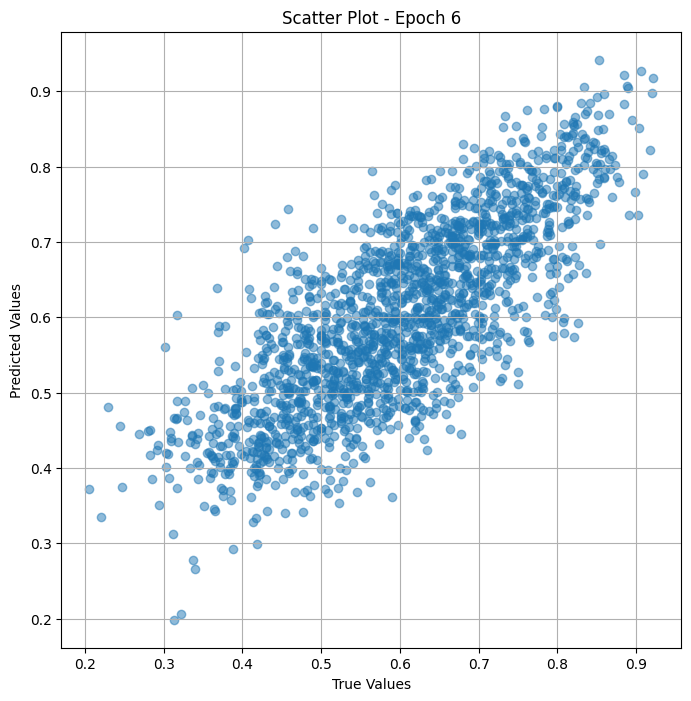

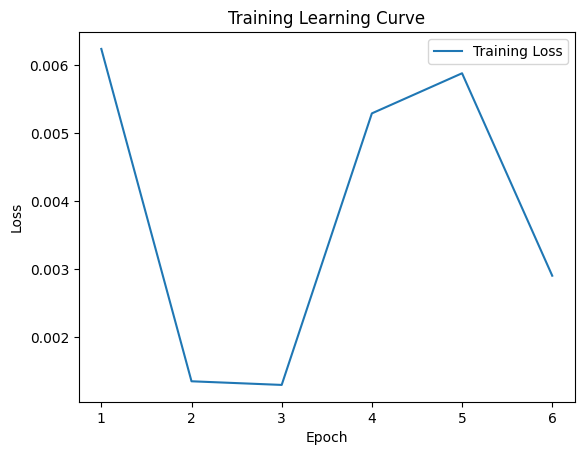


 Epoch: (7/30) Loss = 0.0012090003583580256

 Epoch: (7/30) Loss_rmse = 0.03477068245410919

 Epoch: (7/30) R^2 = 0.9482068419456482

 Epoch: (7/30) MAE = 0.02950402721762657
Spearman correlation coefficient: SignificanceResult(statistic=0.9083270106058344, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.515463

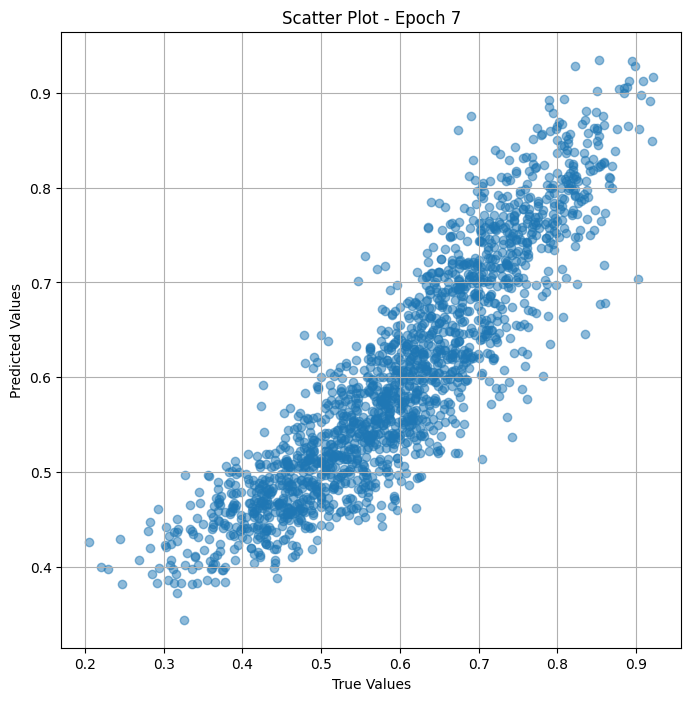

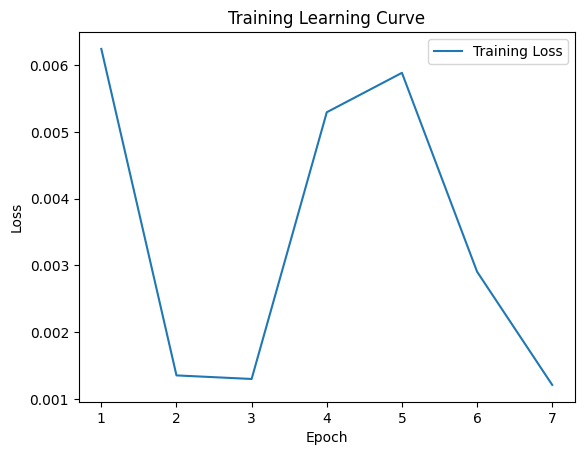


 Epoch: (8/30) Loss = 0.001032134867273271

 Epoch: (8/30) Loss_rmse = 0.03212685510516167

 Epoch: (8/30) R^2 = 0.9557836651802063

 Epoch: (8/30) MAE = 0.0260416679084301
Spearman correlation coefficient: SignificanceResult(statistic=0.9351762124710402, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5154639,

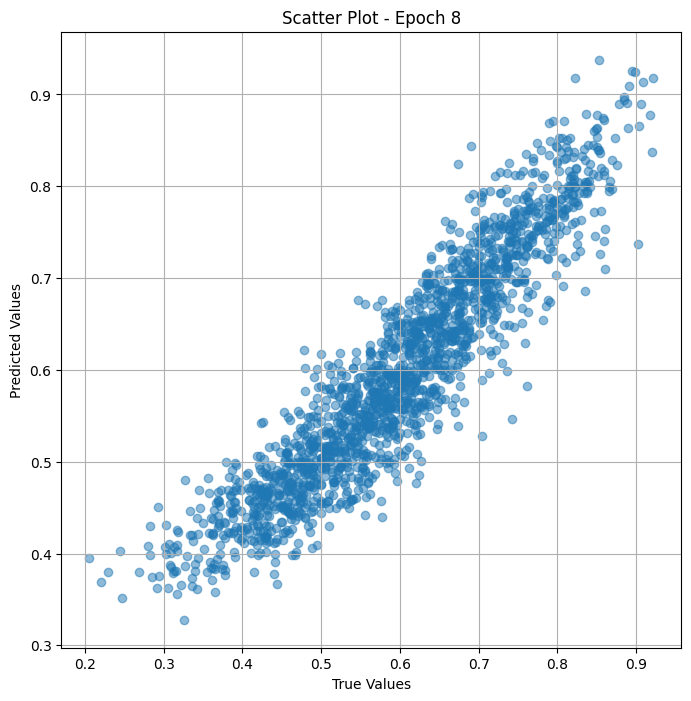

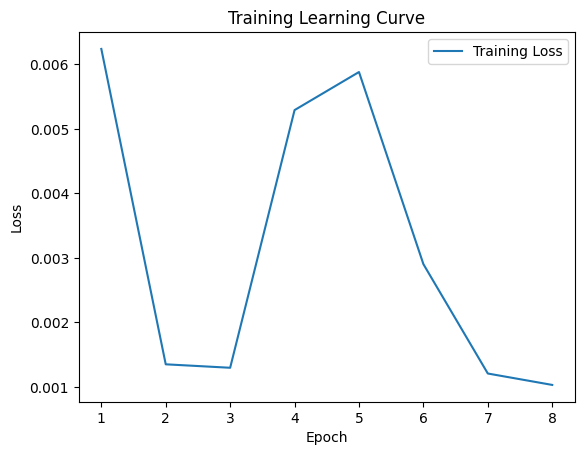


 Epoch: (9/30) Loss = 0.0008695403230376542

 Epoch: (9/30) Loss_rmse = 0.02948796935379505

 Epoch: (9/30) R^2 = 0.962749183177948

 Epoch: (9/30) MAE = 0.0236608125269413
Spearman correlation coefficient: SignificanceResult(statistic=0.9486287879196725, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5154639,

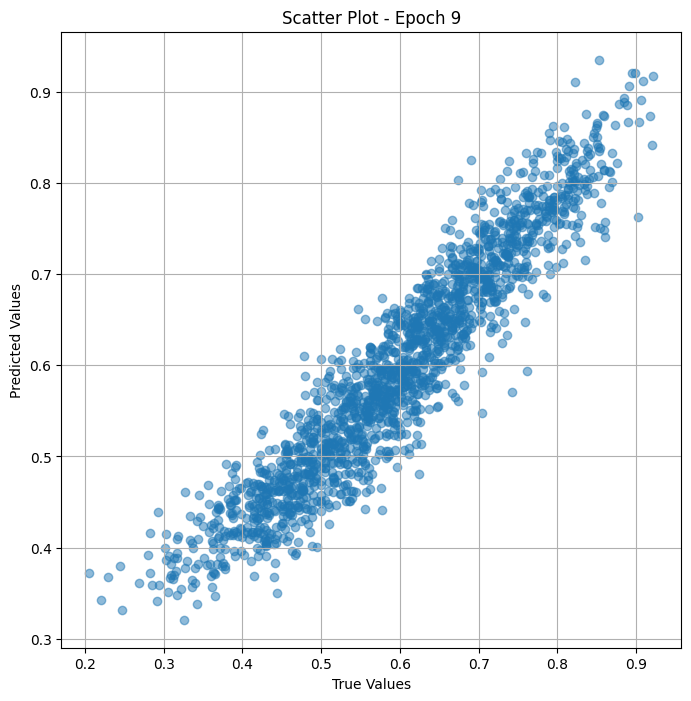

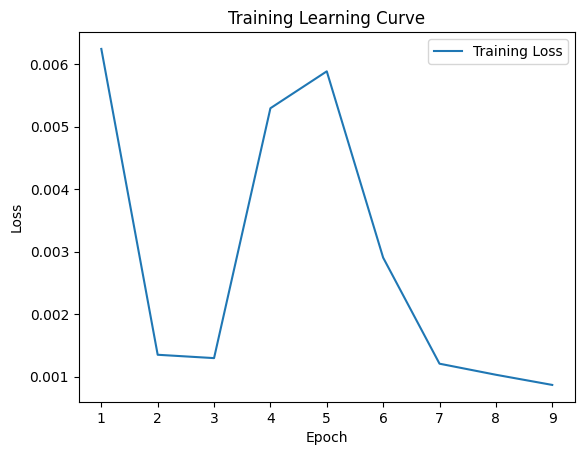


 Epoch: (10/30) Loss = 0.0007025180384516716

 Epoch: (10/30) Loss_rmse = 0.026505056768655777

 Epoch: (10/30) R^2 = 0.969904363155365

 Epoch: (10/30) MAE = 0.02073601260781288
Spearman correlation coefficient: SignificanceResult(statistic=0.9583472975582987, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.51

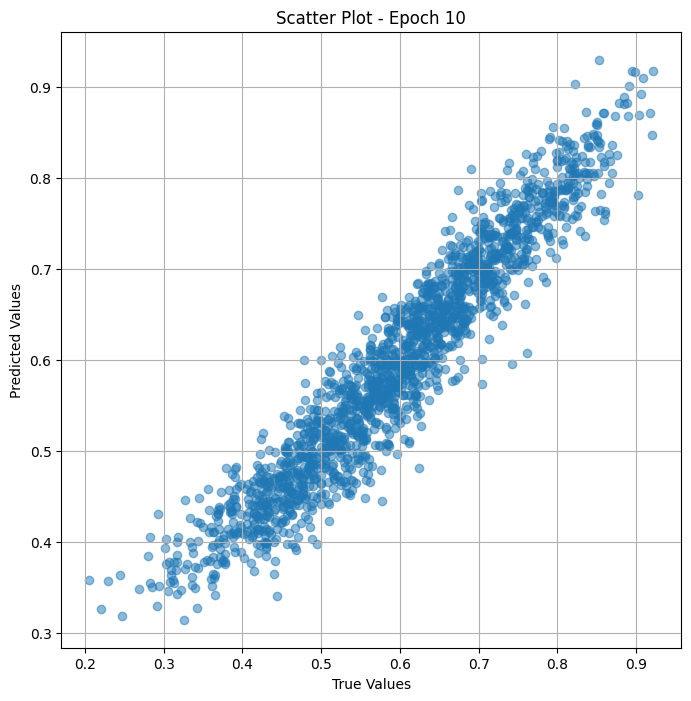

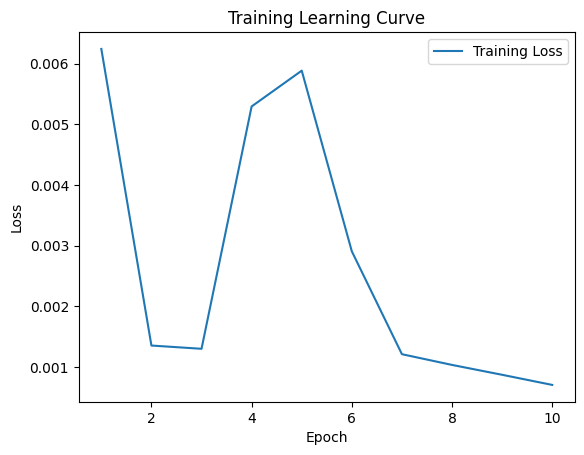


 Epoch: (11/30) Loss = 0.0005371951265260577

 Epoch: (11/30) Loss_rmse = 0.02317747101187706

 Epoch: (11/30) R^2 = 0.9769867658615112

 Epoch: (11/30) MAE = 0.01769152656197548
Spearman correlation coefficient: SignificanceResult(statistic=0.9657345456273436, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.51

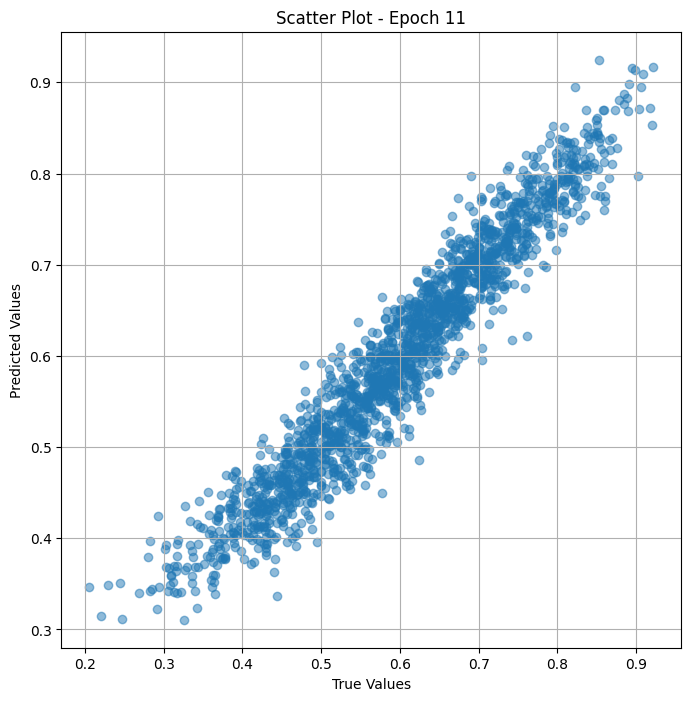

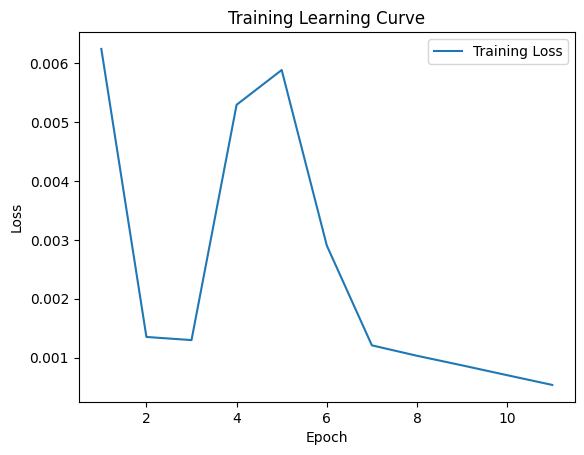


 Epoch: (12/30) Loss = 0.0003946896467823535

 Epoch: (12/30) Loss_rmse = 0.01986679807305336

 Epoch: (12/30) R^2 = 0.9830916523933411

 Epoch: (12/30) MAE = 0.014900259673595428
Spearman correlation coefficient: SignificanceResult(statistic=0.9718152812774846, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

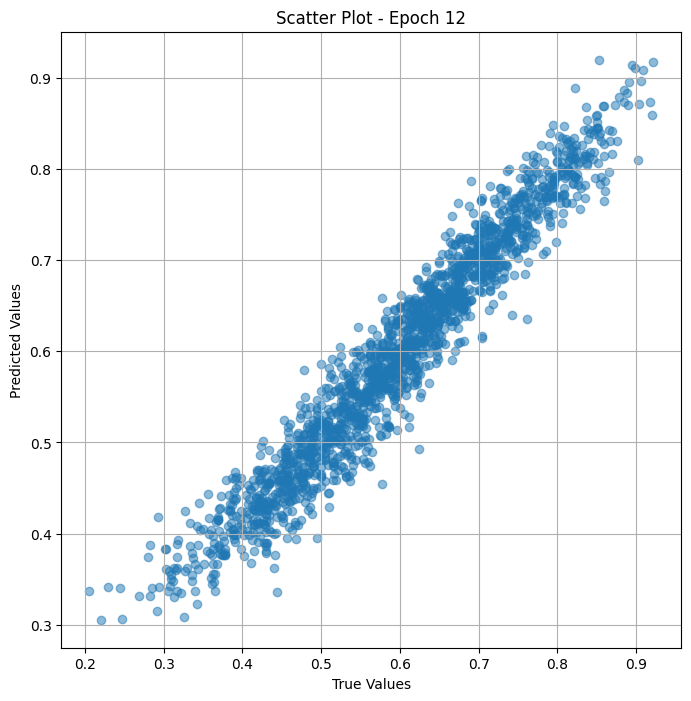

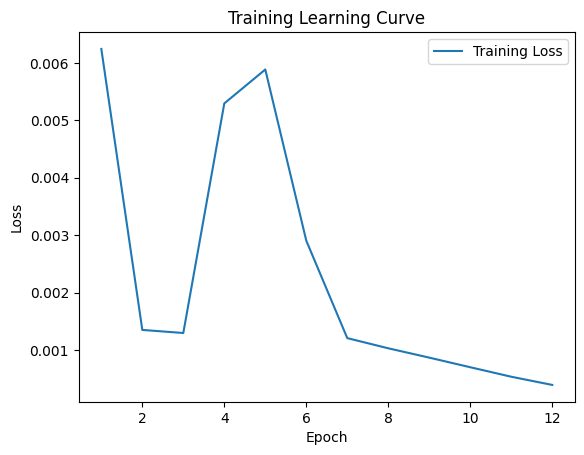


 Epoch: (13/30) Loss = 0.00027628408861346543

 Epoch: (13/30) Loss_rmse = 0.016621796414256096

 Epoch: (13/30) R^2 = 0.9881640672683716

 Epoch: (13/30) MAE = 0.012568697333335876
Spearman correlation coefficient: SignificanceResult(statistic=0.976875600056022, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

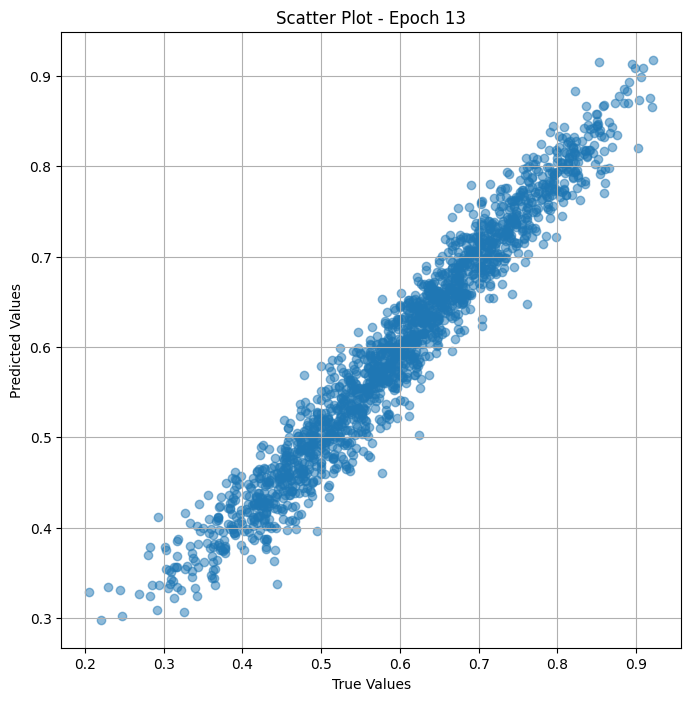

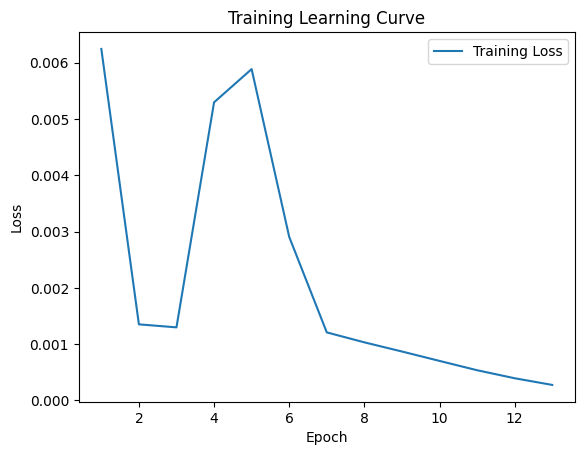


 Epoch: (14/30) Loss = 0.00019045601948164403

 Epoch: (14/30) Loss_rmse = 0.01380058005452156

 Epoch: (14/30) R^2 = 0.9918408989906311

 Epoch: (14/30) MAE = 0.010312199592590332
Spearman correlation coefficient: SignificanceResult(statistic=0.9809585456874964, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

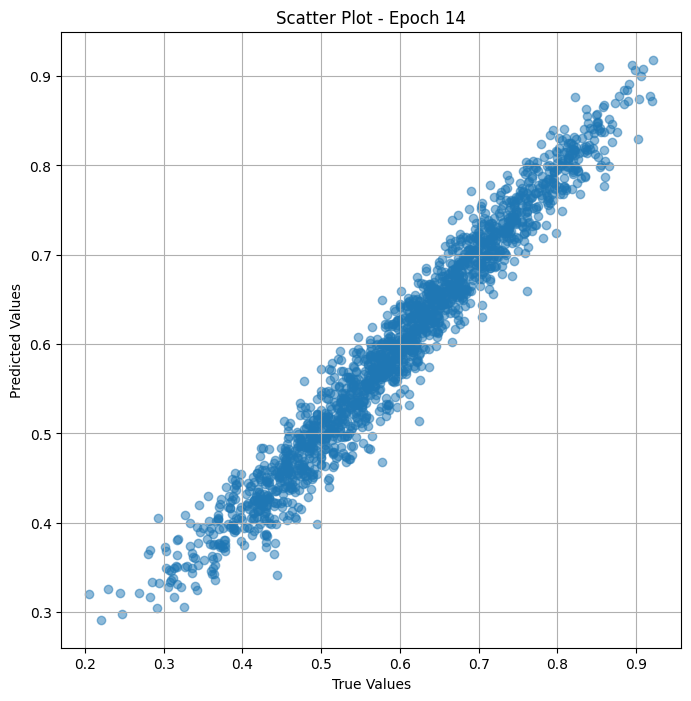

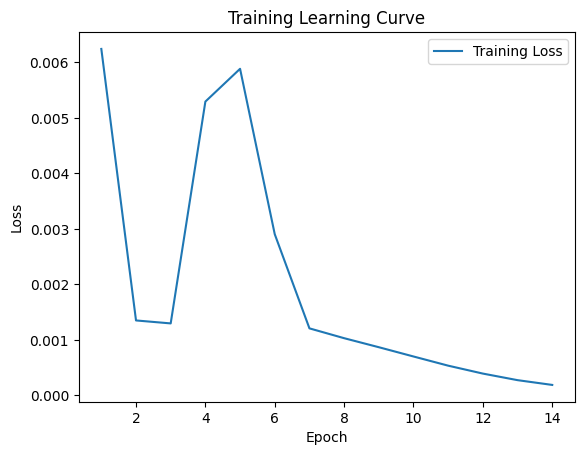


 Epoch: (15/30) Loss = 0.00012102266191504896

 Epoch: (15/30) Loss_rmse = 0.01100102998316288

 Epoch: (15/30) R^2 = 0.9948154091835022

 Epoch: (15/30) MAE = 0.00834808498620987
Spearman correlation coefficient: SignificanceResult(statistic=0.9844416625064405, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.5

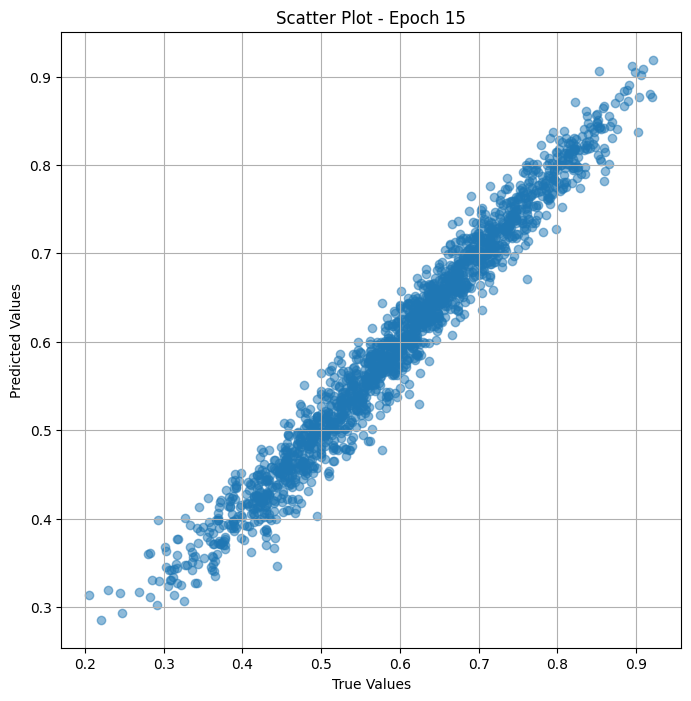

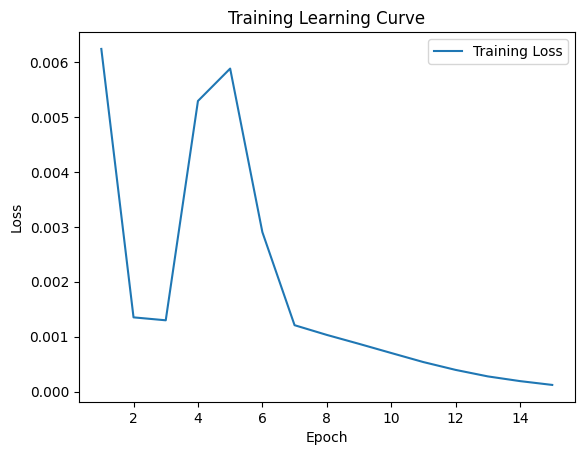


 Epoch: (16/30) Loss = 7.616836956003681e-05

 Epoch: (16/30) Loss_rmse = 0.008727448992431164

 Epoch: (16/30) R^2 = 0.9967369437217712

 Epoch: (16/30) MAE = 0.006537243723869324
Spearman correlation coefficient: SignificanceResult(statistic=0.9874317120479408, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

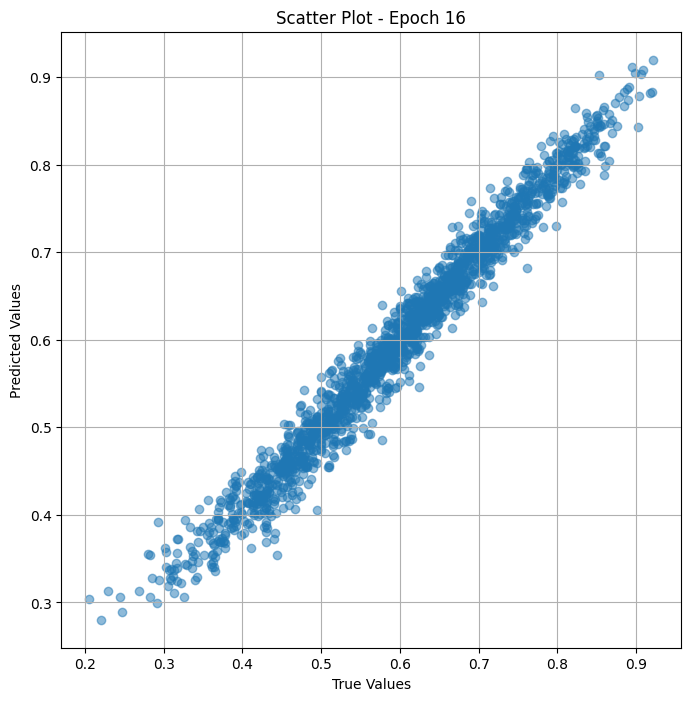

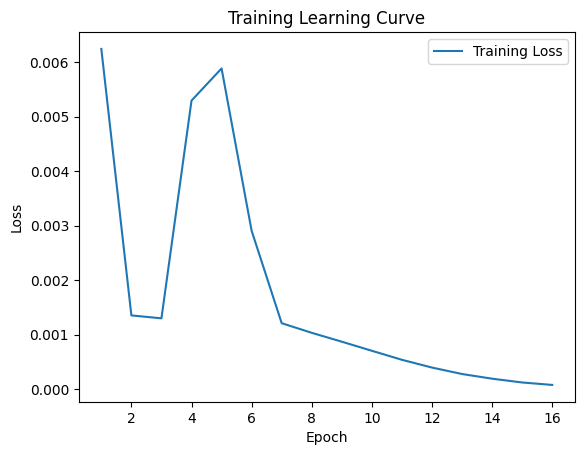


 Epoch: (17/30) Loss = 4.430790067999624e-05

 Epoch: (17/30) Loss_rmse = 0.006656418088823557

 Epoch: (17/30) R^2 = 0.9981018900871277

 Epoch: (17/30) MAE = 0.0049549490213394165
Spearman correlation coefficient: SignificanceResult(statistic=0.9898815525296437, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0

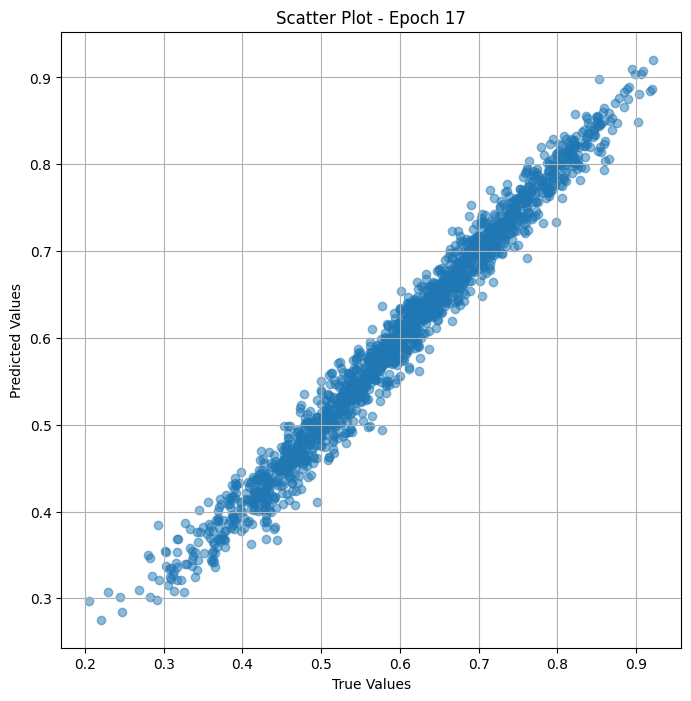

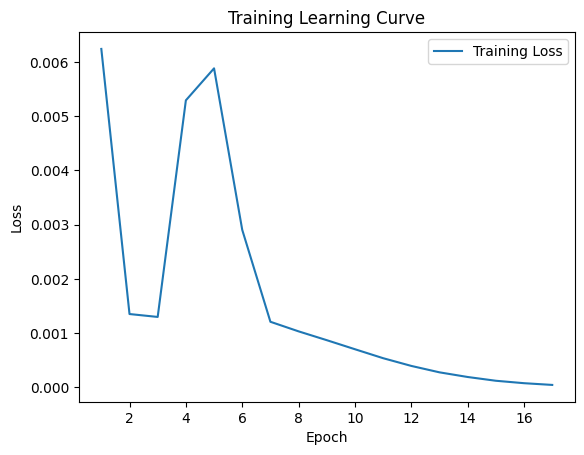


 Epoch: (18/30) Loss = 2.5179810108966194e-05

 Epoch: (18/30) Loss_rmse = 0.005017948802560568

 Epoch: (18/30) R^2 = 0.9989213347434998

 Epoch: (18/30) MAE = 0.0035617463290691376
Spearman correlation coefficient: SignificanceResult(statistic=0.9919769584629154, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 

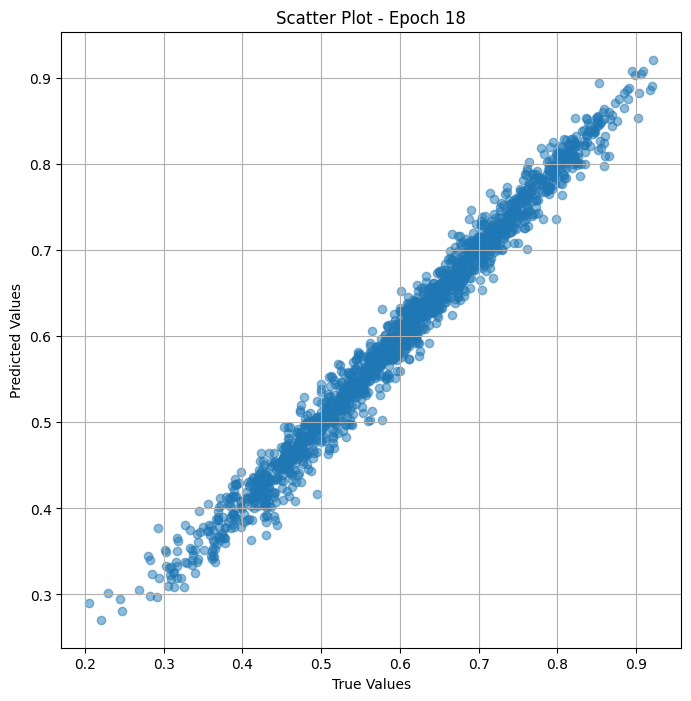

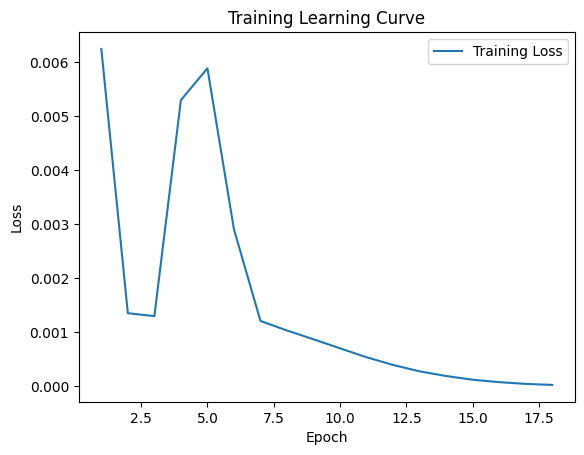


 Epoch: (19/30) Loss = 1.358127519779373e-05

 Epoch: (19/30) Loss_rmse = 0.003685278119519353

 Epoch: (19/30) R^2 = 0.9994181990623474

 Epoch: (19/30) MAE = 0.0026727691292762756
Spearman correlation coefficient: SignificanceResult(statistic=0.9936561033672128, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0

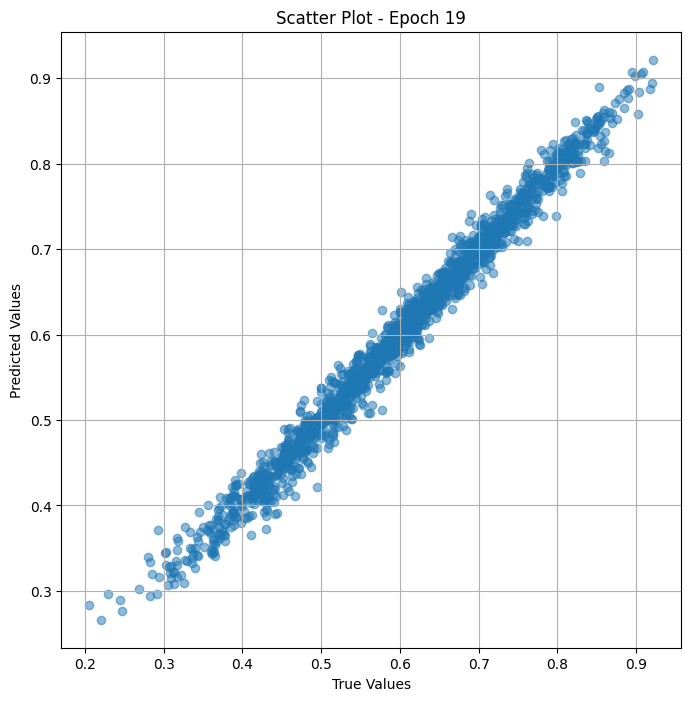

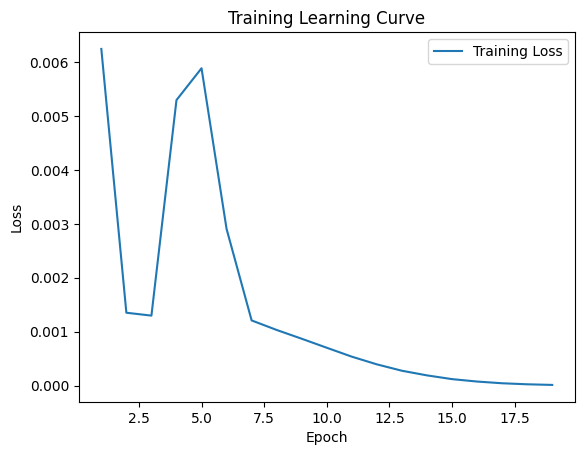


 Epoch: (20/30) Loss = 7.496603757317644e-06

 Epoch: (20/30) Loss_rmse = 0.002737992675974965

 Epoch: (20/30) R^2 = 0.9996788501739502

 Epoch: (20/30) MAE = 0.002144940197467804
Spearman correlation coefficient: SignificanceResult(statistic=0.9950131655783065, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.

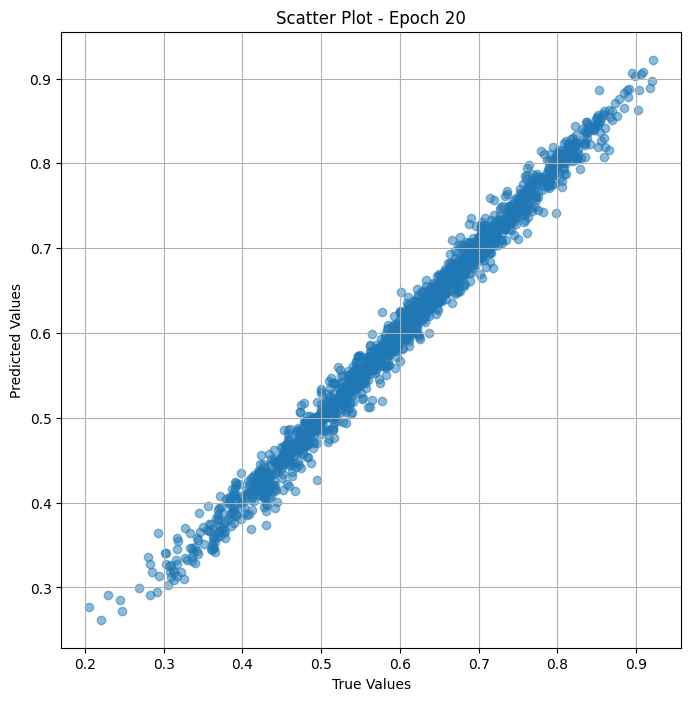

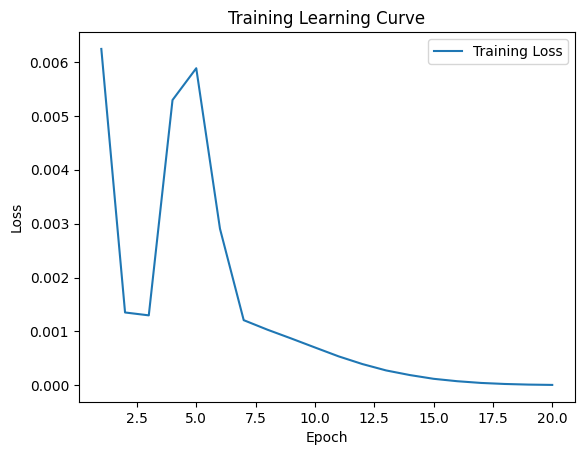


 Epoch: (21/30) Loss = 4.57739542980562e-06

 Epoch: (21/30) Loss_rmse = 0.00213948474265635

 Epoch: (21/30) R^2 = 0.999803900718689

 Epoch: (21/30) MAE = 0.001753140240907669
Spearman correlation coefficient: SignificanceResult(statistic=0.9960994319699453, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0.515

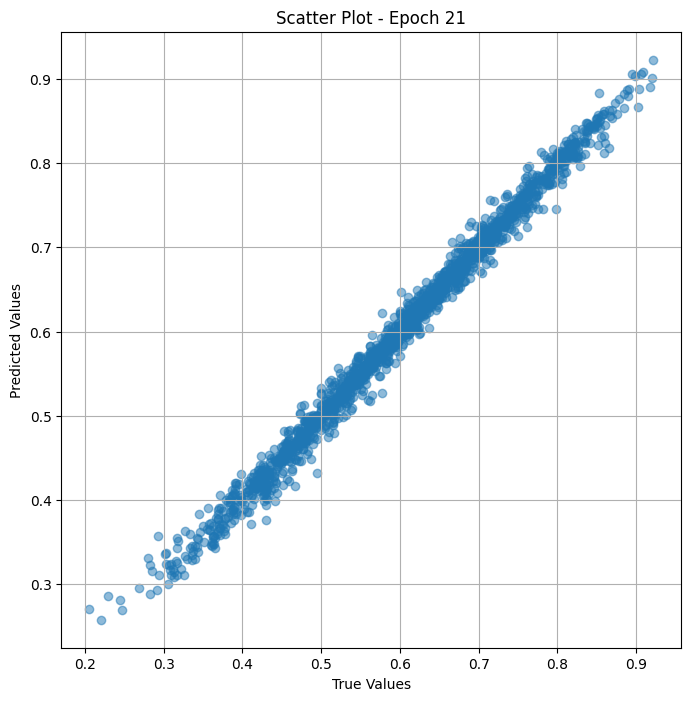

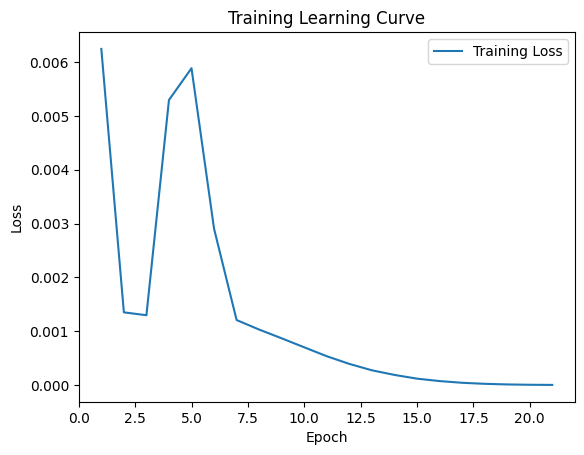


 Epoch: (22/30) Loss = 2.5323658974230057e-06

 Epoch: (22/30) Loss_rmse = 0.001591340871527791

 Epoch: (22/30) R^2 = 0.9998915195465088

 Epoch: (22/30) MAE = 0.0014111287891864777
Spearman correlation coefficient: SignificanceResult(statistic=0.9969382829088158, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 

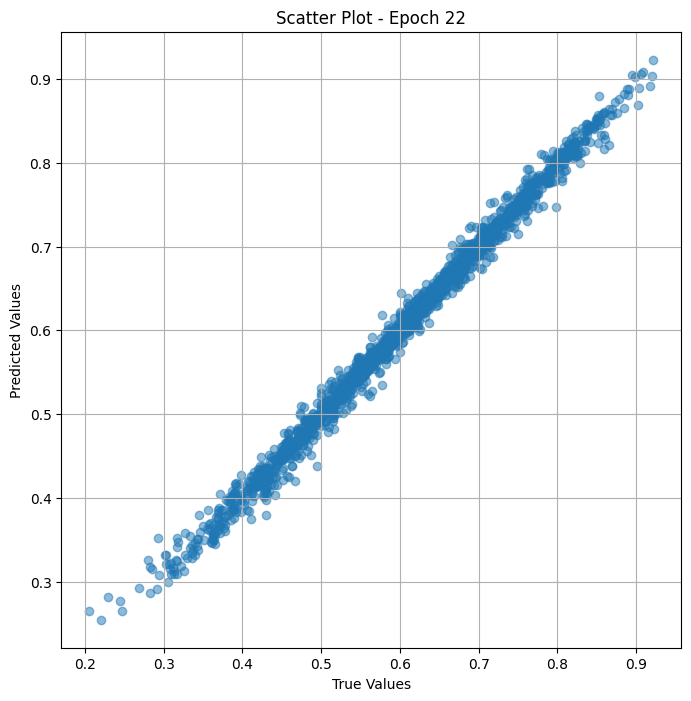

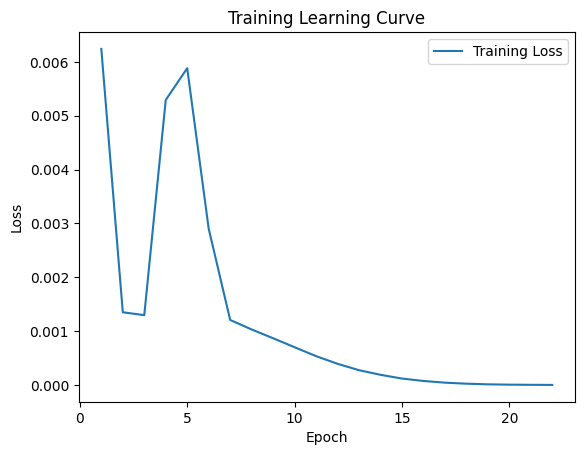


 Epoch: (23/30) Loss = 1.538783180876635e-06

 Epoch: (23/30) Loss_rmse = 0.0012404769659042358

 Epoch: (23/30) R^2 = 0.9999340772628784

 Epoch: (23/30) MAE = 0.0010490156710147858
Spearman correlation coefficient: SignificanceResult(statistic=0.9976065751987695, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 

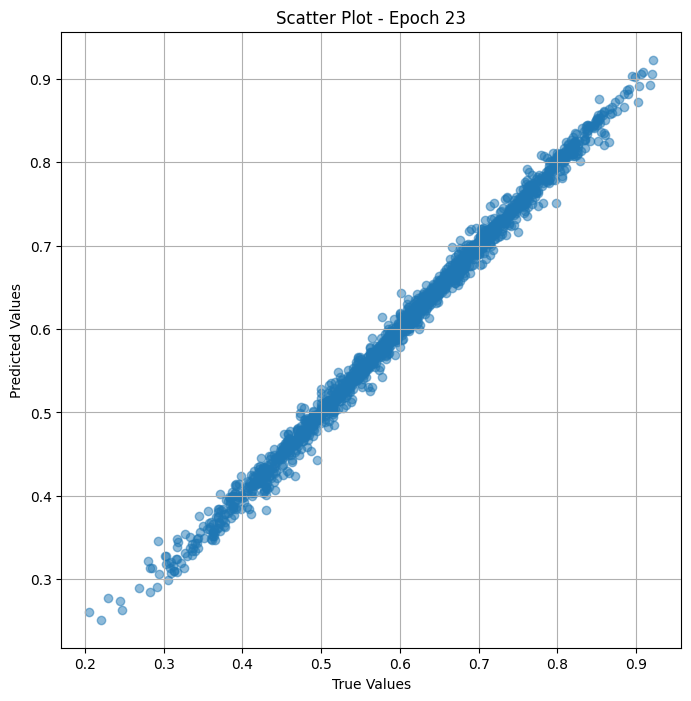

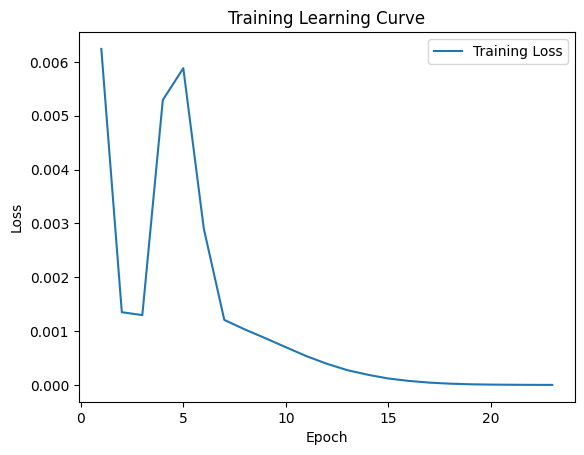


 Epoch: (24/30) Loss = 1.123184006246447e-06

 Epoch: (24/30) Loss_rmse = 0.001059803762473166

 Epoch: (24/30) R^2 = 0.9999518990516663

 Epoch: (24/30) MAE = 0.0008540377020835876
Spearman correlation coefficient: SignificanceResult(statistic=0.9981351545750923, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0

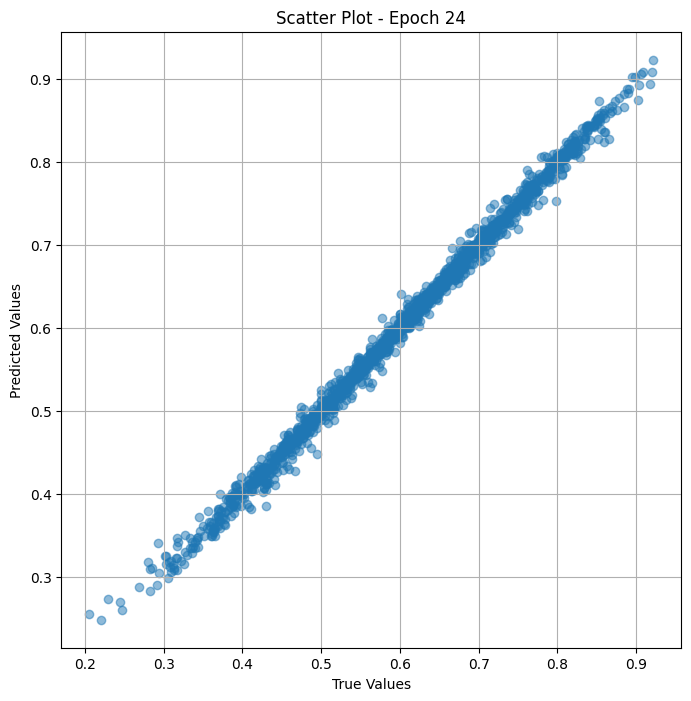

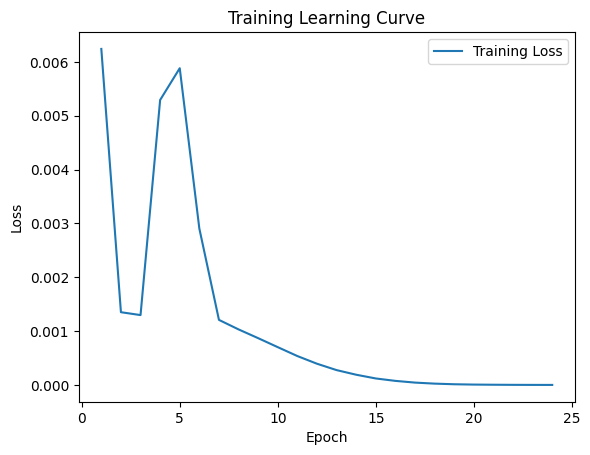


 Epoch: (25/30) Loss = 8.619047093816334e-07

 Epoch: (25/30) Loss_rmse = 0.0009283882100135088

 Epoch: (25/30) R^2 = 0.999963104724884

 Epoch: (25/30) MAE = 0.0006711520254611969
Spearman correlation coefficient: SignificanceResult(statistic=0.9985410641823551, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 0

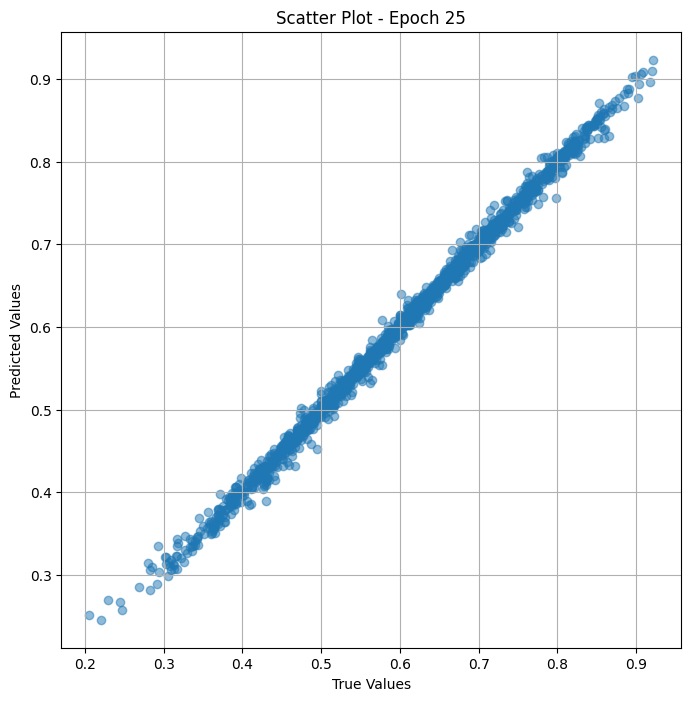

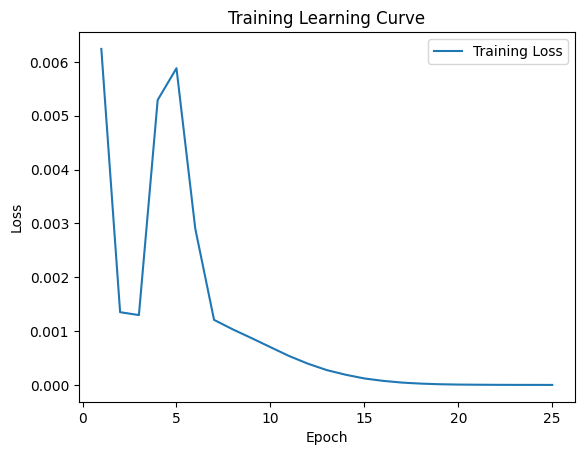


 Epoch: (26/30) Loss = 6.978313535910274e-07

 Epoch: (26/30) Loss_rmse = 0.0008353629964403808

 Epoch: (26/30) R^2 = 0.9999700784683228

 Epoch: (26/30) MAE = 0.0006238482892513275
Spearman correlation coefficient: SignificanceResult(statistic=0.9988504880710661, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 

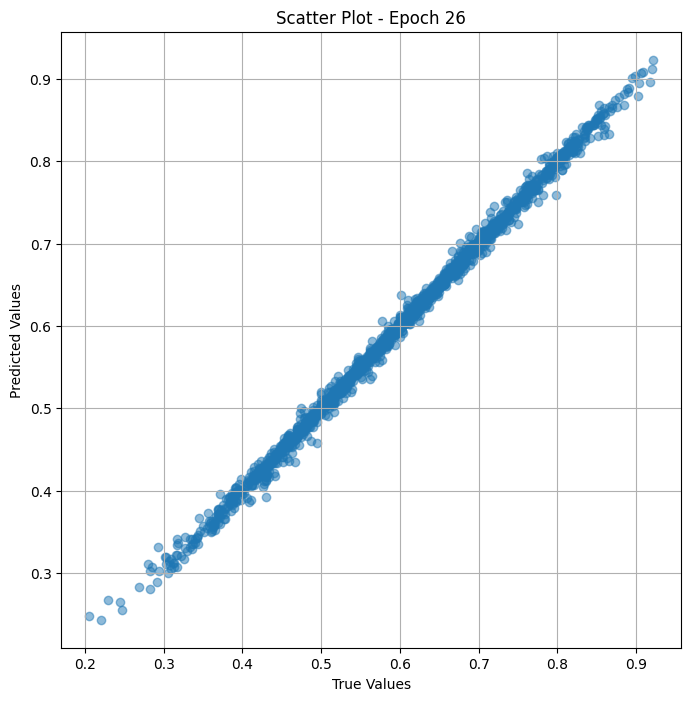

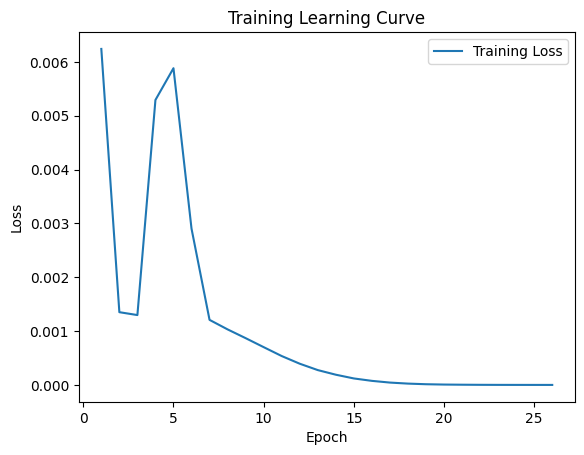


 Epoch: (27/30) Loss = 6.421601028705481e-07

 Epoch: (27/30) Loss_rmse = 0.0008013489423319697

 Epoch: (27/30) R^2 = 0.9999724626541138

 Epoch: (27/30) MAE = 0.0006596557796001434
Spearman correlation coefficient: SignificanceResult(statistic=0.9990854720168775, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 

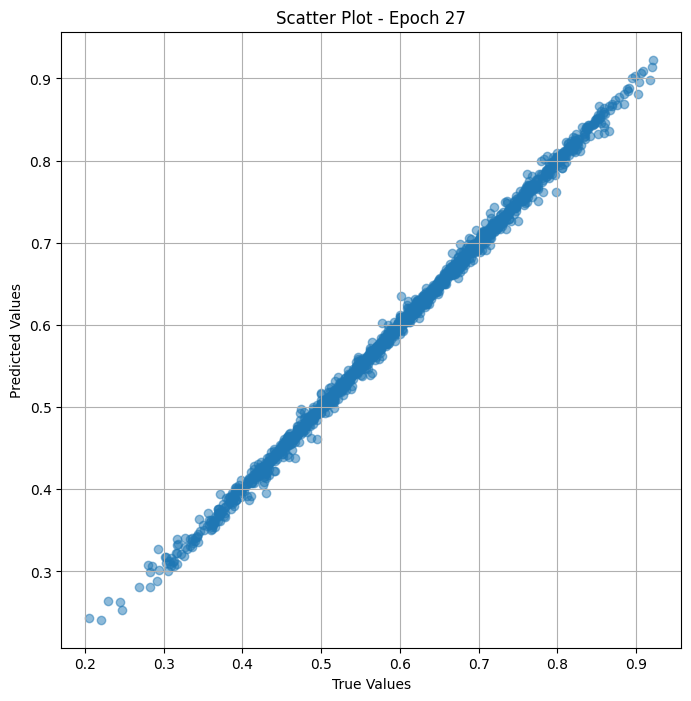

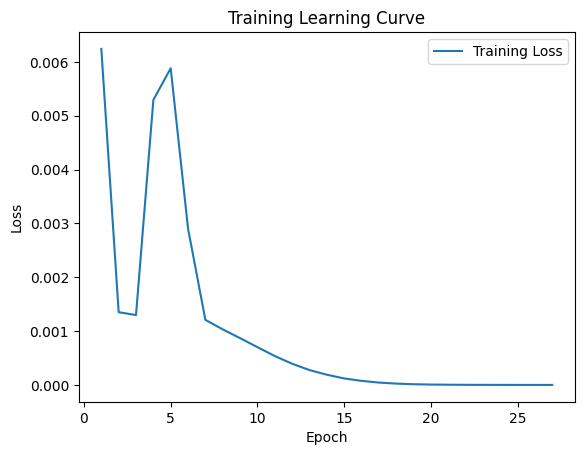


 Epoch: (28/30) Loss = 5.979666184430243e-07

 Epoch: (28/30) Loss_rmse = 0.0007732830126769841

 Epoch: (28/30) R^2 = 0.9999743700027466

 Epoch: (28/30) MAE = 0.0006843768060207367
Spearman correlation coefficient: SignificanceResult(statistic=0.9992603550531542, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 

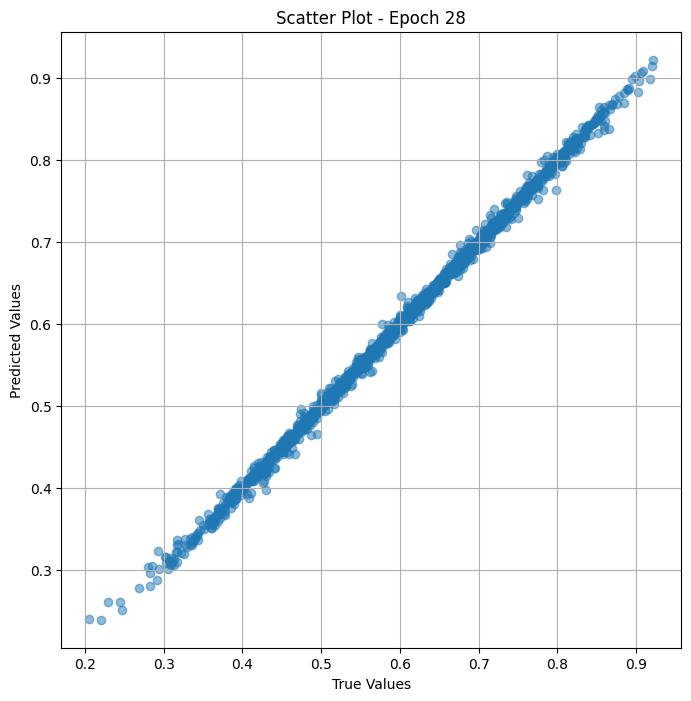

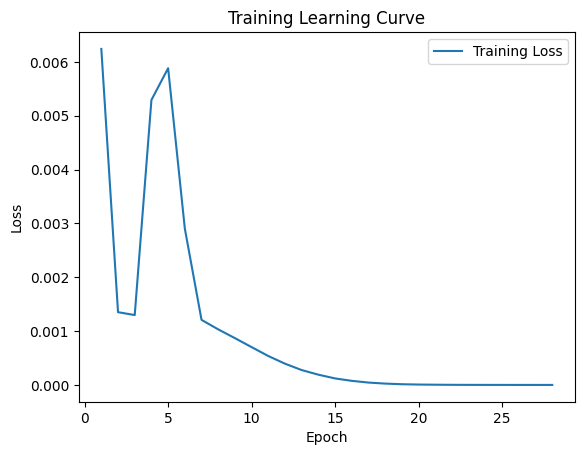


 Epoch: (29/30) Loss = 6.402701160368451e-07

 Epoch: (29/30) Loss_rmse = 0.0008001687820069492

 Epoch: (29/30) R^2 = 0.9999725818634033

 Epoch: (29/30) MAE = 0.0007191598415374756
Spearman correlation coefficient: SignificanceResult(statistic=0.9993880029514249, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 

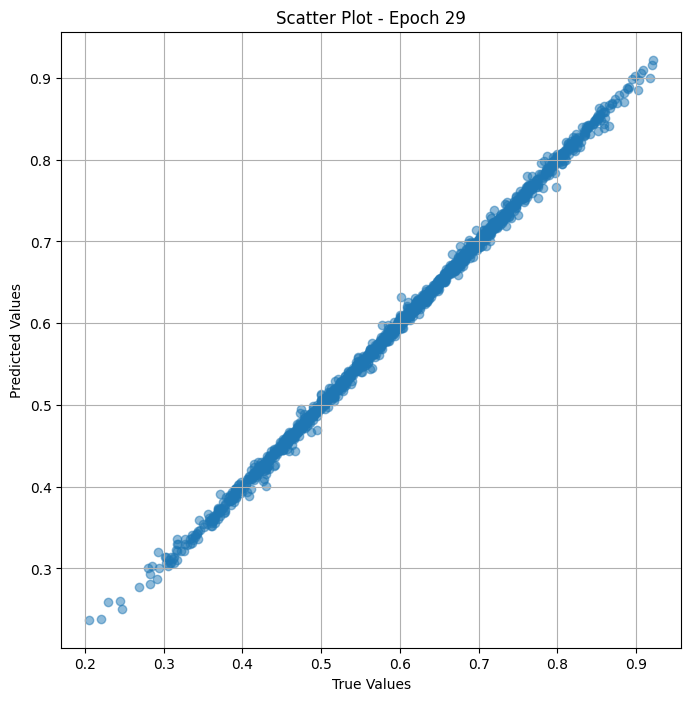

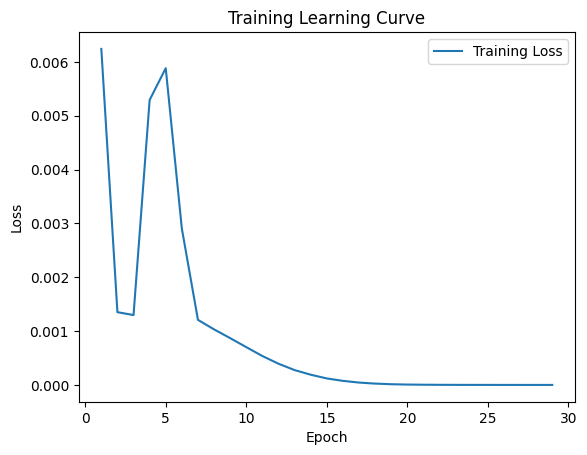


 Epoch: (30/30) Loss = 5.750343916588463e-07

 Epoch: (30/30) Loss_rmse = 0.0007583101978525519

 Epoch: (30/30) R^2 = 0.9999753832817078

 Epoch: (30/30) MAE = 0.0007038675248622894
Spearman correlation coefficient: SignificanceResult(statistic=0.9994835794798342, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.43396226, 0.42990655, 0.71428573, 0.5677966, 0.5483871, 0.6395349, 0.7368421, 0.45544556, 0.4945055, 0.7717391, 0.49382716, 0.6168224, 0.4059406, 0.67469877, 0.7798165, 0.6486486, 0.76106197, 0.30851063, 0.5416667, 0.4742268, 0.7160494, 0.46153846, 0.5049505, 0.44859812, 0.7425743, 0.44067797, 0.71910113, 0.7676768, 0.52747256, 0.5660377, 0.71428573, 0.82, 0.75510204, 0.37037036, 0.86021507, 0.8245614, 0.6810345, 0.62886596, 0.6117647, 0.6018519, 0.6236559, 0.65486723, 0.86868685, 0.42574257, 0.59615386, 0.5531915, 0.76744187, 0.5185185, 0.6117647, 0.67256635, 0.60952383, 0.5652174, 0.5, 0.4909091, 0.8372093, 0.5326087, 

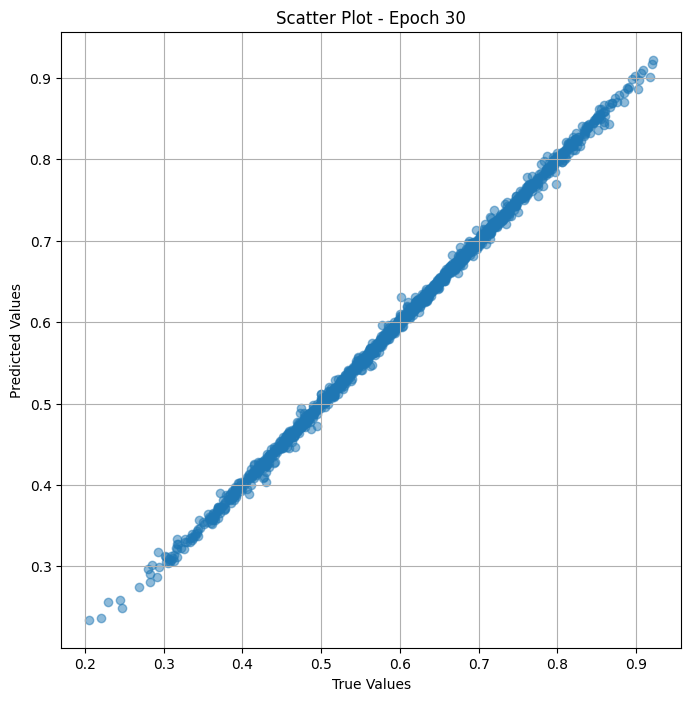

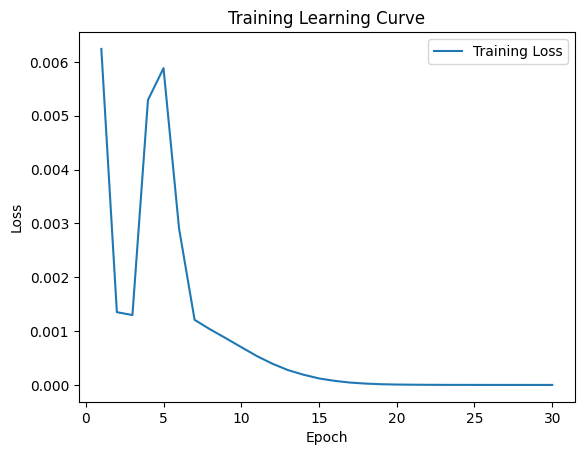

In [ ]:
# Training the model and save weights
fit(30,model_vit_fine , train_dl)
torch.save(model_vit_fine.state_dict(), "model_weights_fine")

## valid

In [ ]:
params = [param for param in list(model_vit_sval.parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-4,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_sval, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_sval.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_sval(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/30) Loss = 0.061438482254743576

 Epoch: (1/30) Loss_rmse = 0.2478678673505783

 Epoch: (1/30) R^2 = -4.320973873138428

 Epoch: (1/30) MAE = 0.22322916984558105
Spearman correlation coefficient: SignificanceResult(statistic=-0.13342331786080397, pvalue=0.19499123765455081)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.416

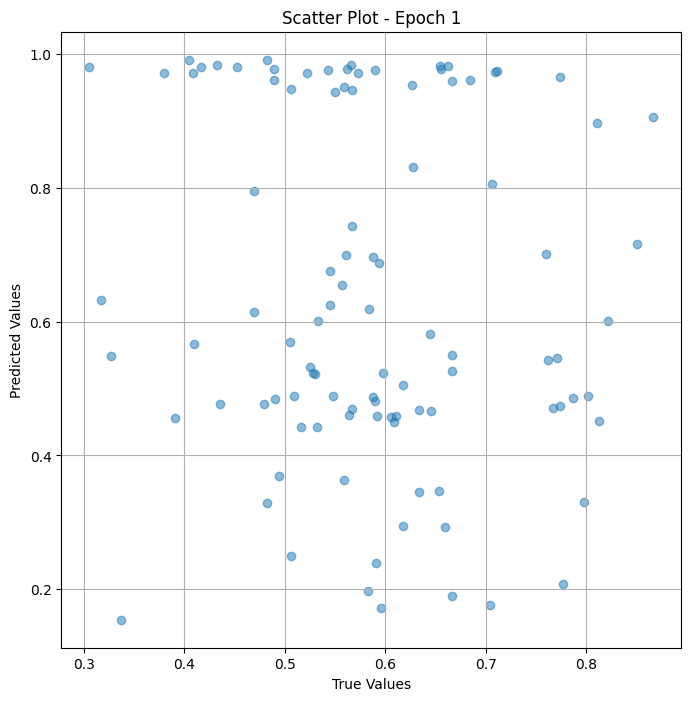

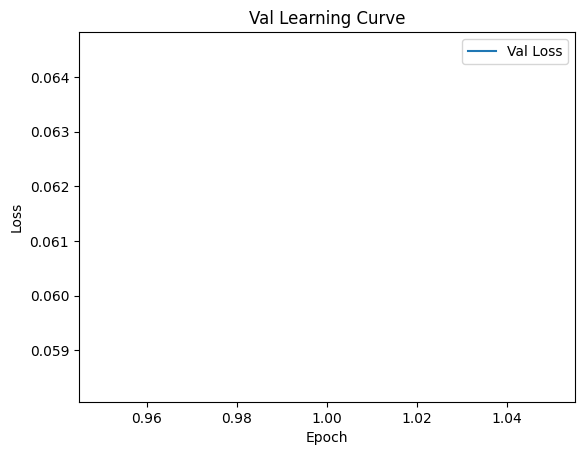


 Epoch: (2/30) Loss = 0.026189450174570084

 Epoch: (2/30) Loss_rmse = 0.1618315428495407

 Epoch: (2/30) R^2 = -1.2681775093078613

 Epoch: (2/30) MAE = 0.1254138946533203
Spearman correlation coefficient: SignificanceResult(statistic=-0.03203489046091084, pvalue=0.7566792470876291)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.4166

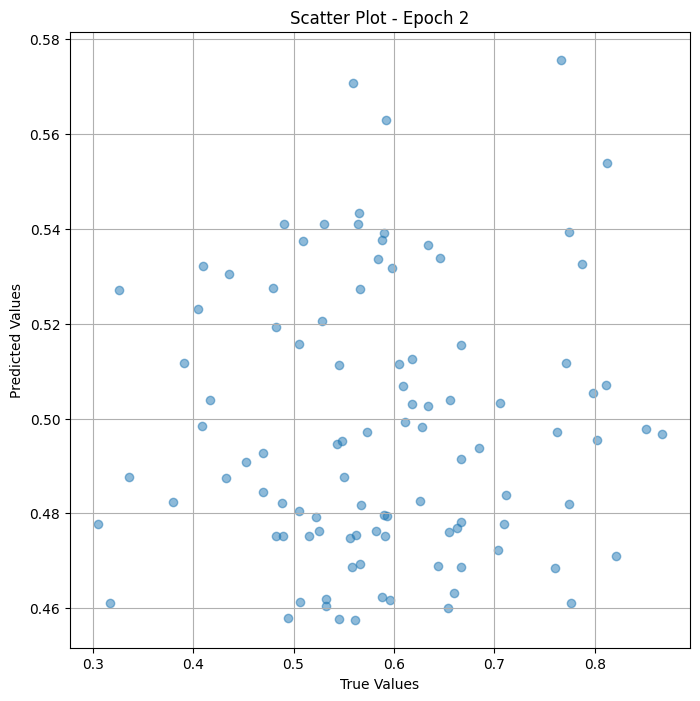

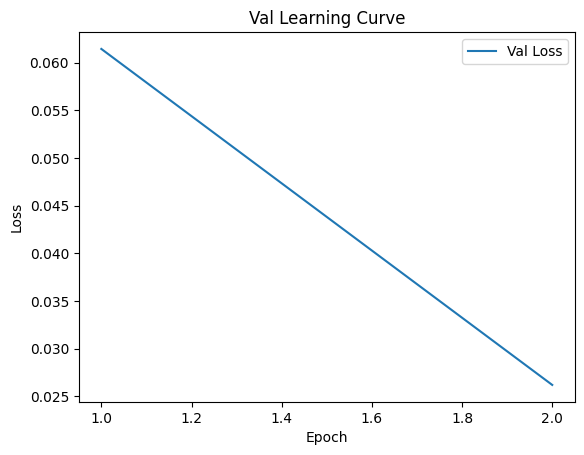


 Epoch: (3/30) Loss = 0.008869174867868423

 Epoch: (3/30) Loss_rmse = 0.09417629987001419

 Epoch: (3/30) R^2 = 0.23187148571014404

 Epoch: (3/30) MAE = 0.08839200437068939
Spearman correlation coefficient: SignificanceResult(statistic=-0.048048944320366806, pvalue=0.6420150731738918)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.4

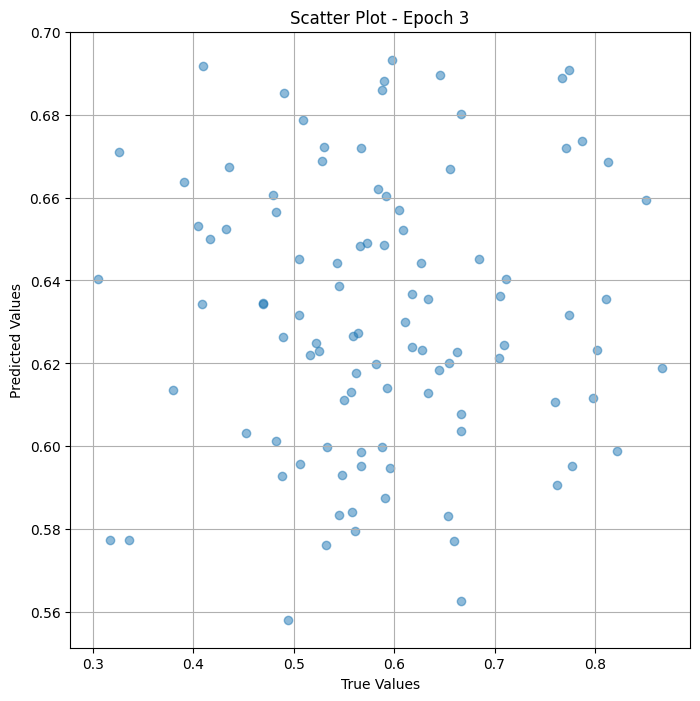

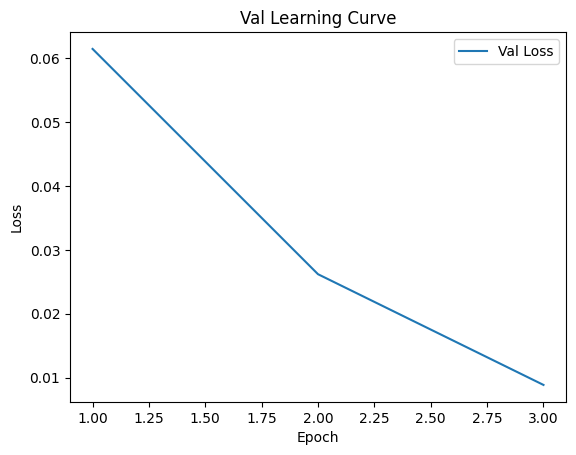


 Epoch: (4/30) Loss = 0.01600562408566475

 Epoch: (4/30) Loss_rmse = 0.12651333212852478

 Epoch: (4/30) R^2 = -0.38619160652160645

 Epoch: (4/30) MAE = 0.09688985347747803
Spearman correlation coefficient: SignificanceResult(statistic=0.21245582763224863, pvalue=0.03769527146640775)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.41

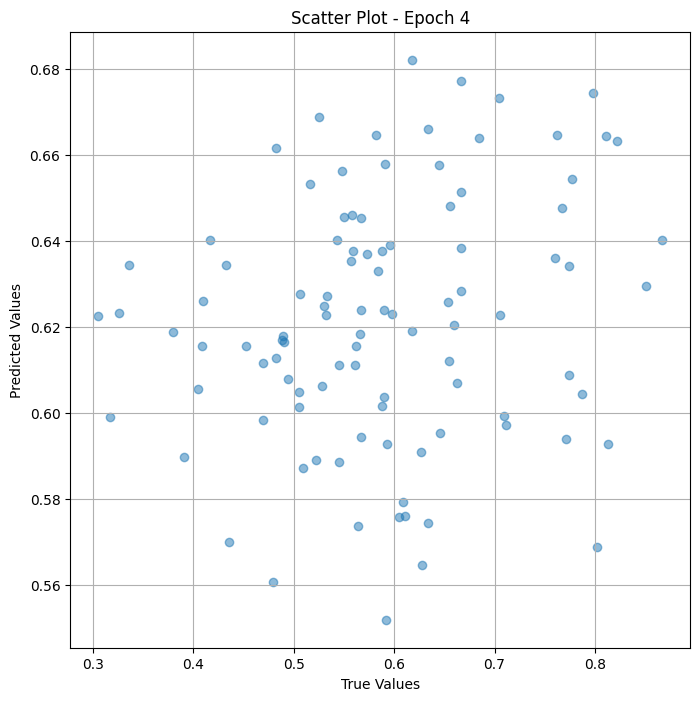

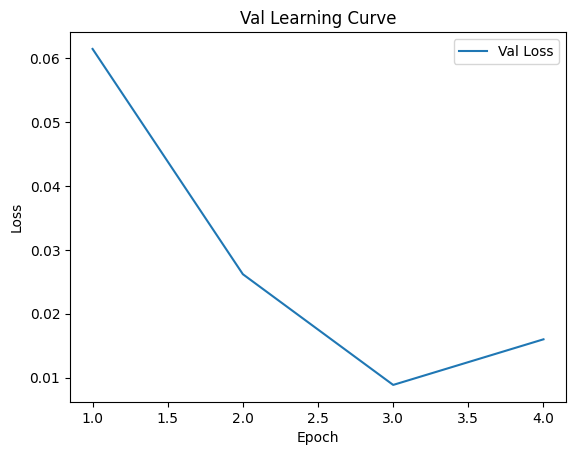


 Epoch: (5/30) Loss = 0.005960232112556696

 Epoch: (5/30) Loss_rmse = 0.07720253616571426

 Epoch: (5/30) R^2 = 0.48380494117736816

 Epoch: (5/30) MAE = 0.05695880949497223
Spearman correlation coefficient: SignificanceResult(statistic=0.27195404044679655, pvalue=0.007353249352949864)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.4

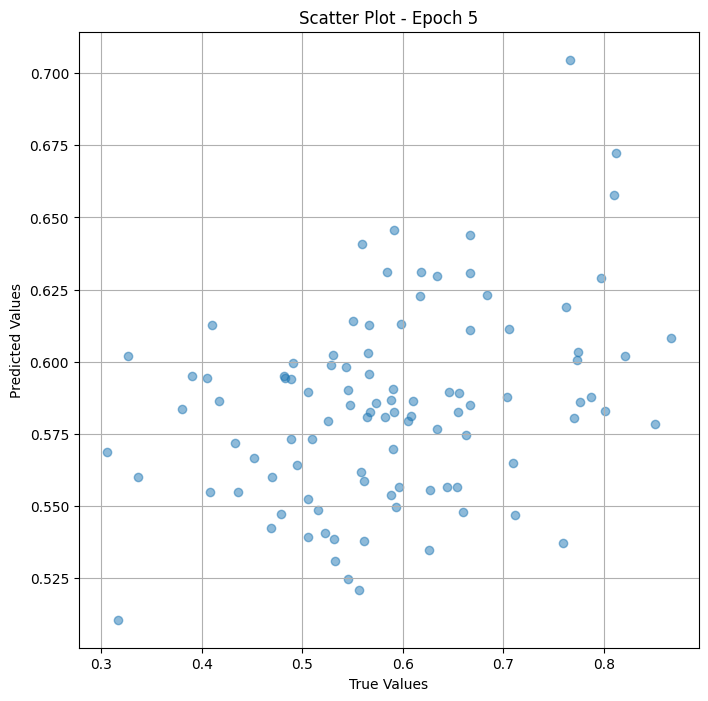

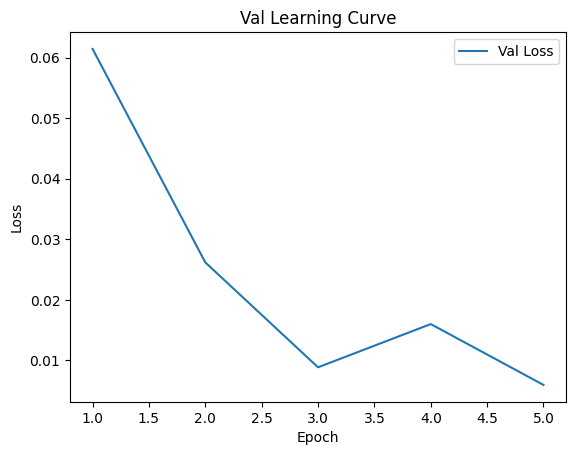


 Epoch: (6/30) Loss = 0.0020188947673887014

 Epoch: (6/30) Loss_rmse = 0.04493211209774017

 Epoch: (6/30) R^2 = 0.8251504898071289

 Epoch: (6/30) MAE = 0.0312812477350235
Spearman correlation coefficient: SignificanceResult(statistic=0.5169331159638785, pvalue=6.96483563759804e-08)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.416

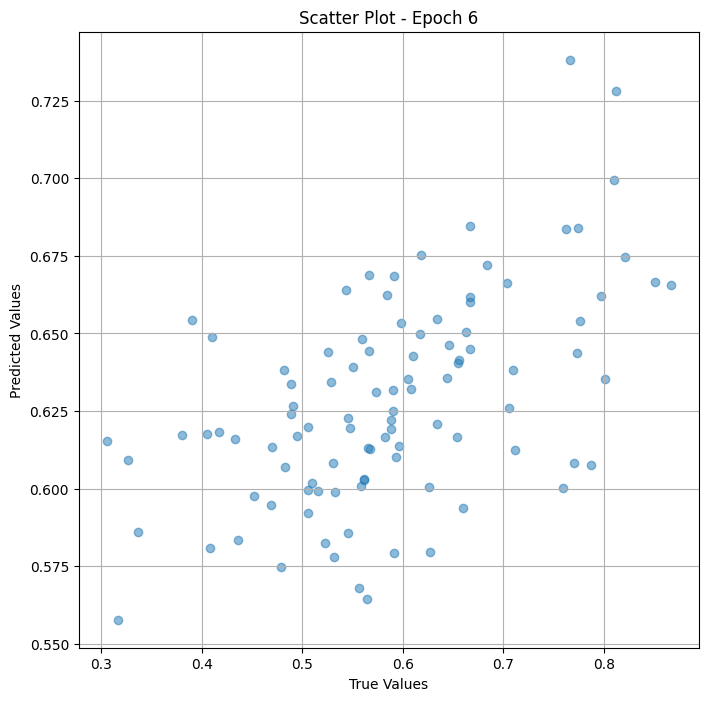

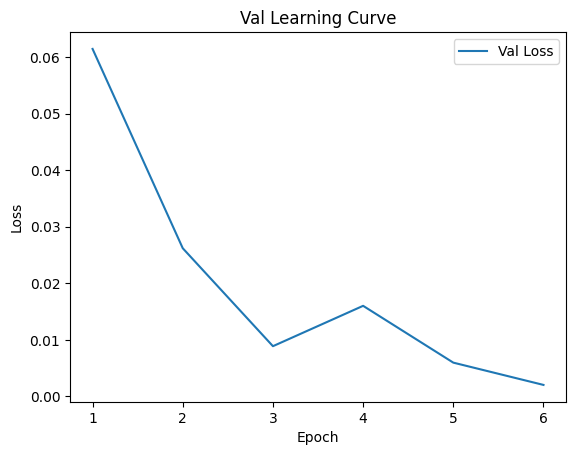


 Epoch: (7/30) Loss = 0.002112063579261303

 Epoch: (7/30) Loss_rmse = 0.04595719277858734

 Epoch: (7/30) R^2 = 0.8170815110206604

 Epoch: (7/30) MAE = 0.0419212281703949
Spearman correlation coefficient: SignificanceResult(statistic=0.5884571303425159, pvalue=2.8820342585734117e-10)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.41

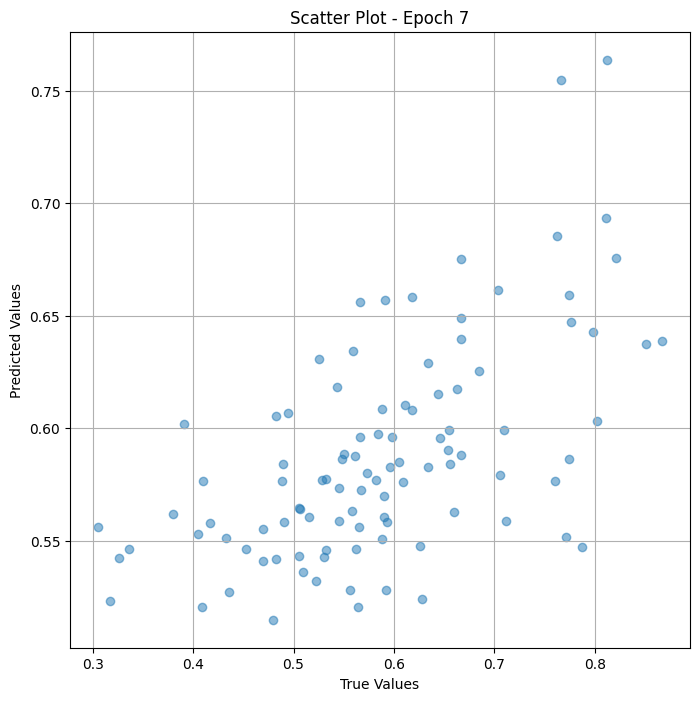

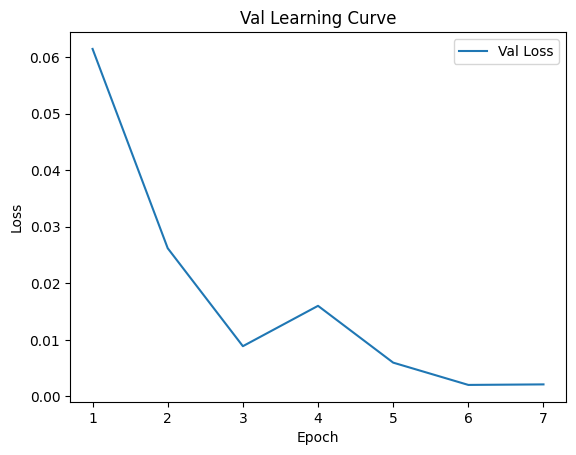


 Epoch: (8/30) Loss = 0.0024334003683179617

 Epoch: (8/30) Loss_rmse = 0.04932950809597969

 Epoch: (8/30) R^2 = 0.7892516255378723

 Epoch: (8/30) MAE = 0.048620954155921936
Spearman correlation coefficient: SignificanceResult(statistic=0.64155921745208, pvalue=1.8854441676010654e-12)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714, 0.4

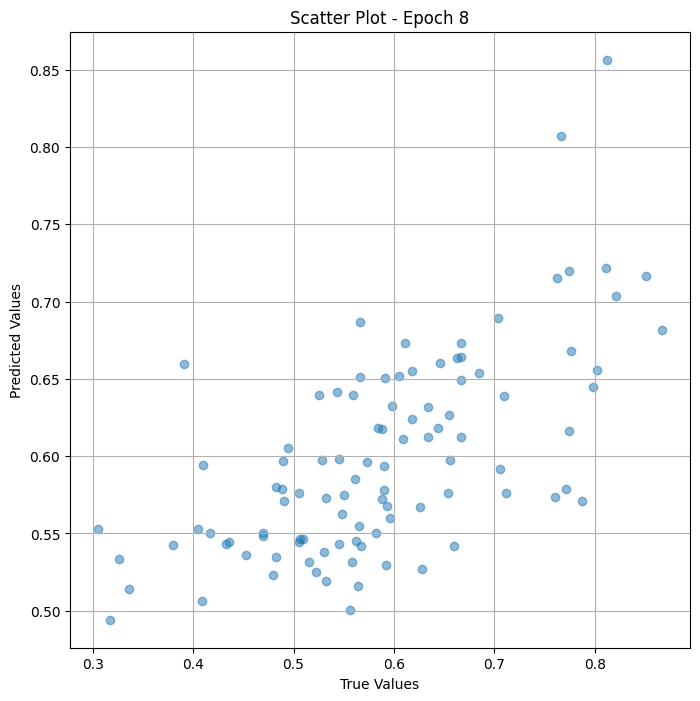

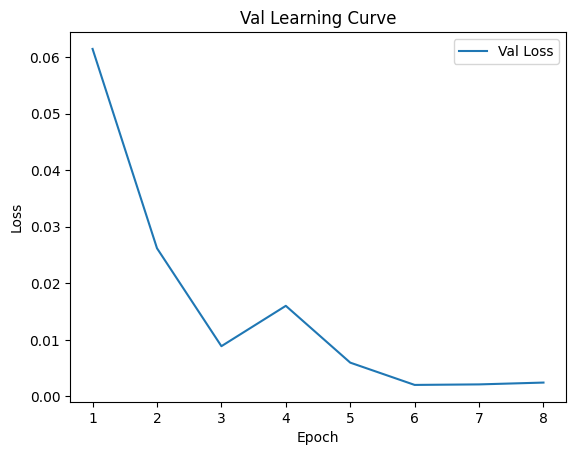

Epoch 0.05: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (9/30) Loss = 0.0030235399026423693

 Epoch: (9/30) Loss_rmse = 0.054986726492643356

 Epoch: (9/30) R^2 = 0.738141655921936

 Epoch: (9/30) MAE = 0.05413307249546051
Spearman correlation coefficient: SignificanceResult(statistic=0.7407500364443222, pvalue=6.3138461905948584e-18)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117,

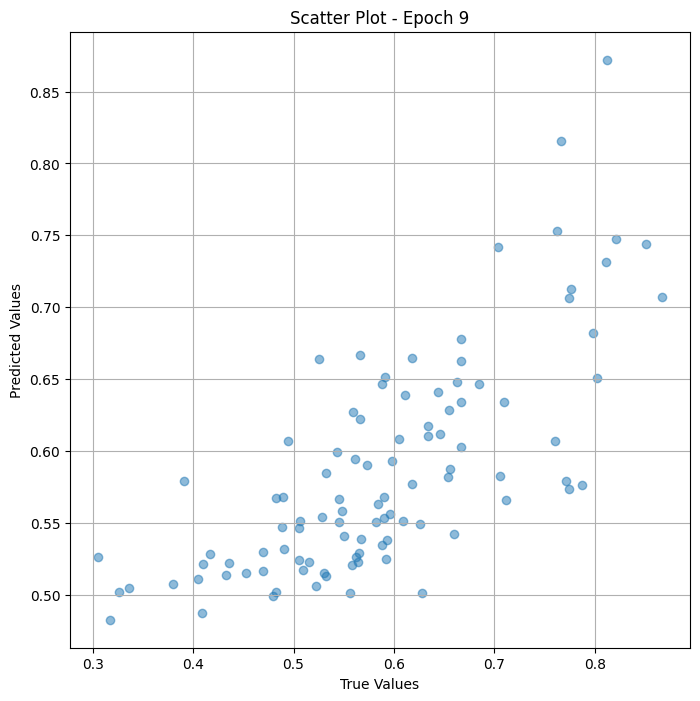

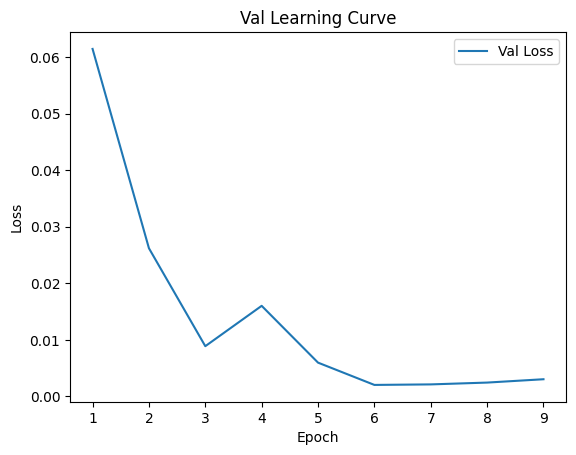


 Epoch: (10/30) Loss = 0.0017665047198534012

 Epoch: (10/30) Loss_rmse = 0.04202980920672417

 Epoch: (10/30) R^2 = 0.8470091819763184

 Epoch: (10/30) MAE = 0.04077211022377014
Spearman correlation coefficient: SignificanceResult(statistic=0.8092218169234444, pvalue=1.9532813885949636e-23)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

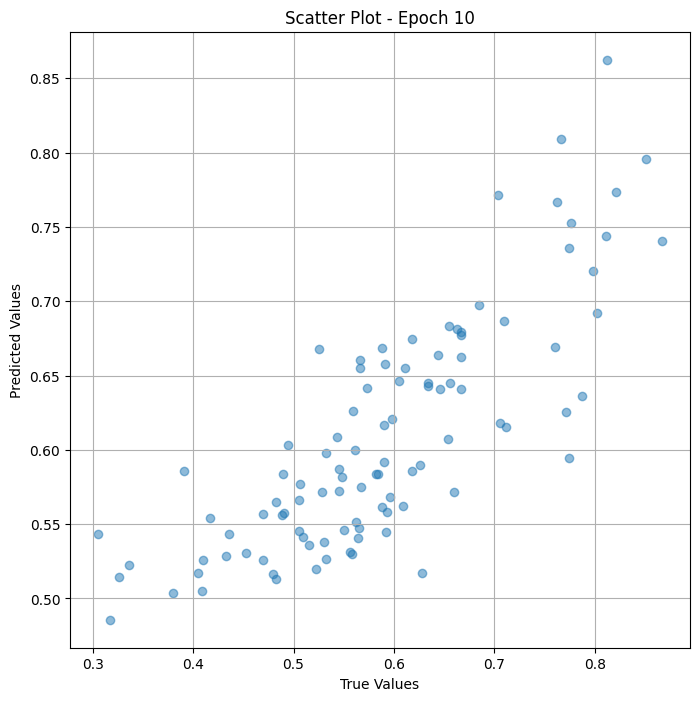

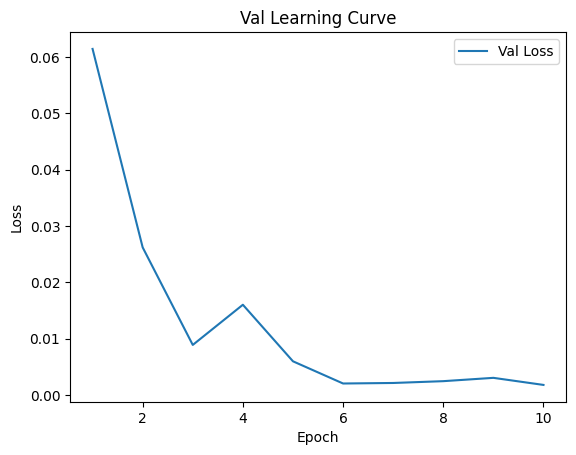


 Epoch: (11/30) Loss = 0.001689658034592867

 Epoch: (11/30) Loss_rmse = 0.041105449199676514

 Epoch: (11/30) R^2 = 0.8536645770072937

 Epoch: (11/30) MAE = 0.03970542550086975
Spearman correlation coefficient: SignificanceResult(statistic=0.8153601984324694, pvalue=4.8883416219173055e-24)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

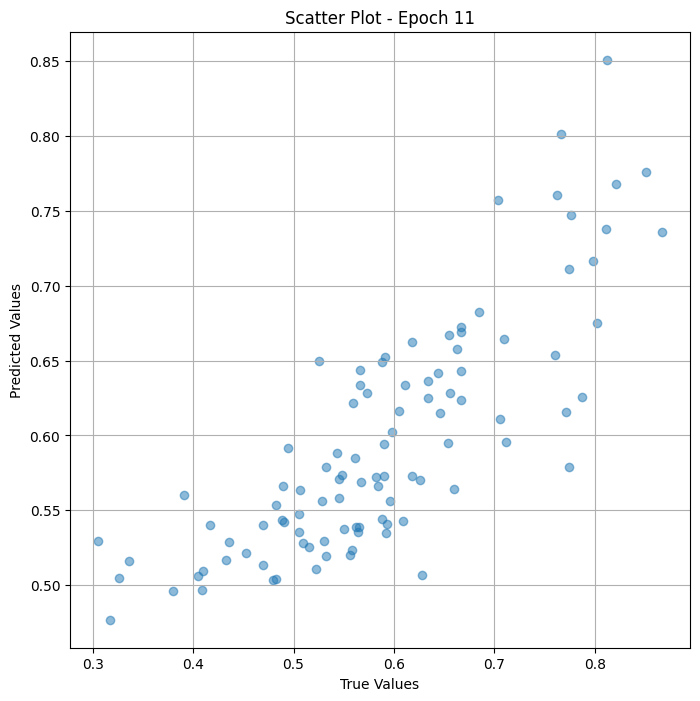

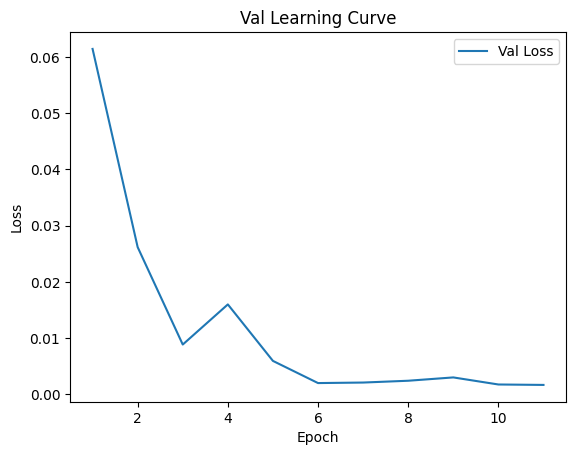


 Epoch: (12/30) Loss = 0.0014831788139417768

 Epoch: (12/30) Loss_rmse = 0.03851206228137016

 Epoch: (12/30) R^2 = 0.8715470433235168

 Epoch: (12/30) MAE = 0.03670130670070648
Spearman correlation coefficient: SignificanceResult(statistic=0.8207524783216128, pvalue=1.3865475786558365e-24)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

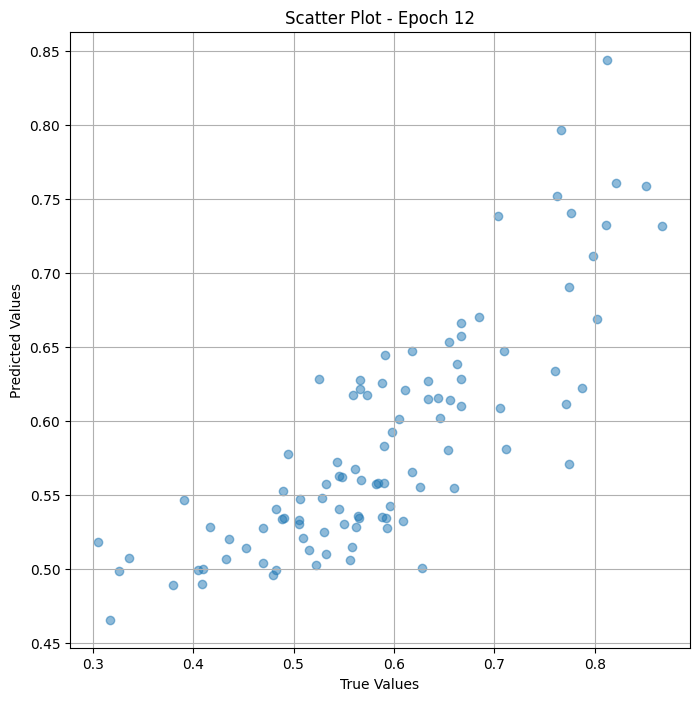

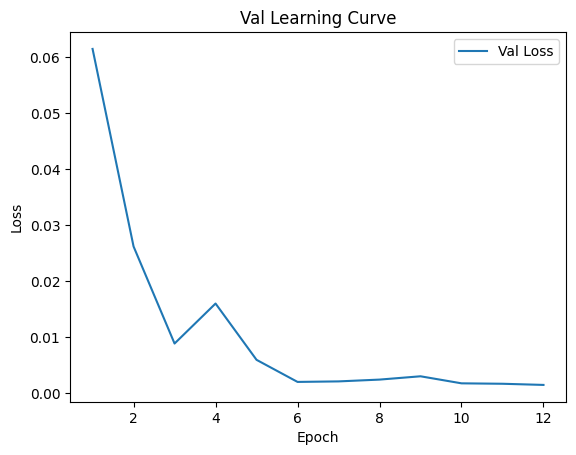


 Epoch: (13/30) Loss = 0.001064157928340137

 Epoch: (13/30) Loss_rmse = 0.03262143209576607

 Epoch: (13/30) R^2 = 0.9078369736671448

 Epoch: (13/30) MAE = 0.031590551137924194
Spearman correlation coefficient: SignificanceResult(statistic=0.8349351918413596, pvalue=4.0790540683386864e-26)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

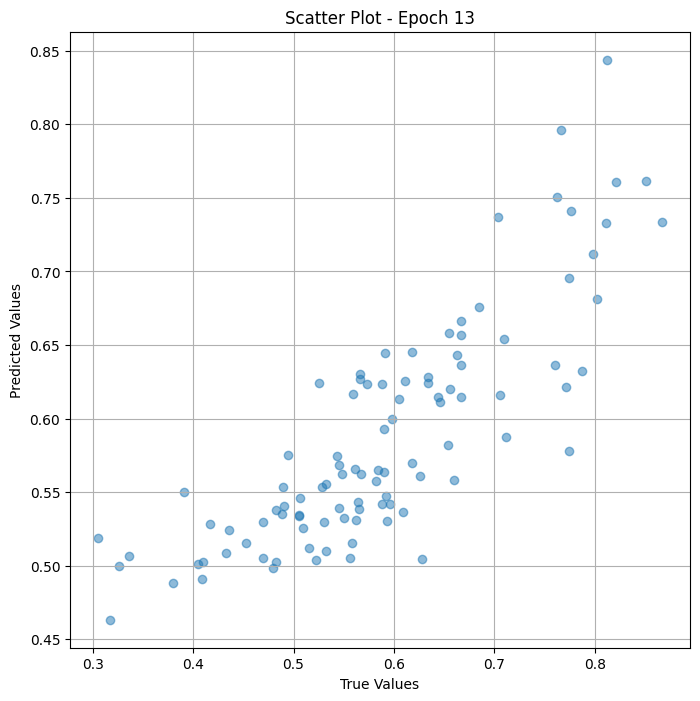

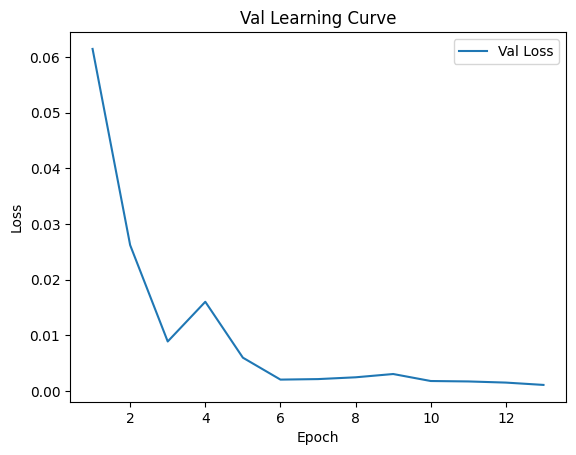


 Epoch: (14/30) Loss = 0.00074564921669662

 Epoch: (14/30) Loss_rmse = 0.027306579053401947

 Epoch: (14/30) R^2 = 0.935421884059906

 Epoch: (14/30) MAE = 0.026507988572120667
Spearman correlation coefficient: SignificanceResult(statistic=0.8442207656378846, pvalue=3.3660150146948894e-27)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714,

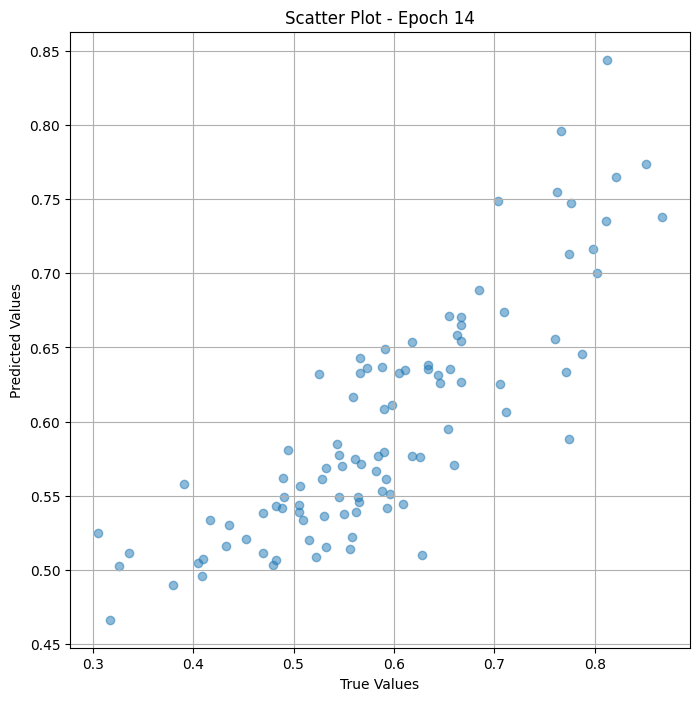

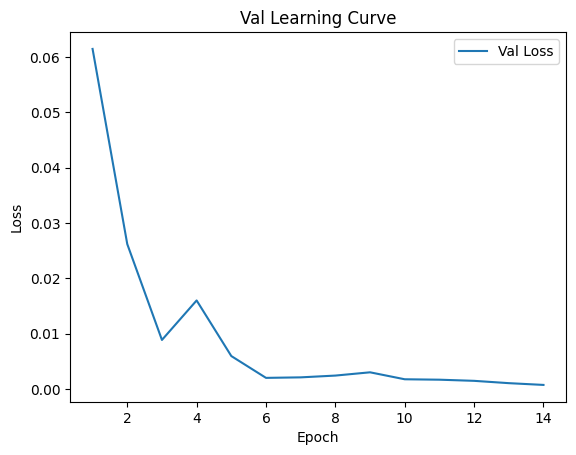


 Epoch: (15/30) Loss = 0.0006046767812222242

 Epoch: (15/30) Loss_rmse = 0.024590175598859787

 Epoch: (15/30) R^2 = 0.9476310610771179

 Epoch: (15/30) MAE = 0.024093225598335266
Spearman correlation coefficient: SignificanceResult(statistic=0.8530315474944848, pvalue=2.701497855165077e-28)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

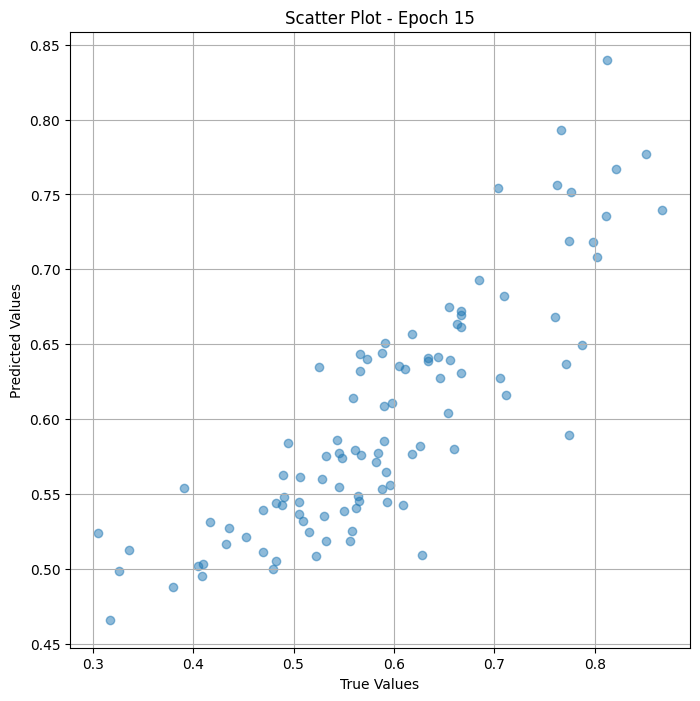

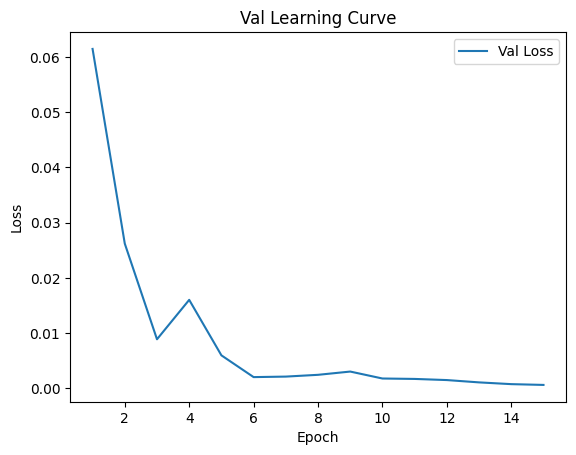


 Epoch: (16/30) Loss = 0.0005459827953018248

 Epoch: (16/30) Loss_rmse = 0.023366274312138557

 Epoch: (16/30) R^2 = 0.9527143239974976

 Epoch: (16/30) MAE = 0.023127540946006775
Spearman correlation coefficient: SignificanceResult(statistic=0.8603772570793178, pvalue=2.898321019259807e-29)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

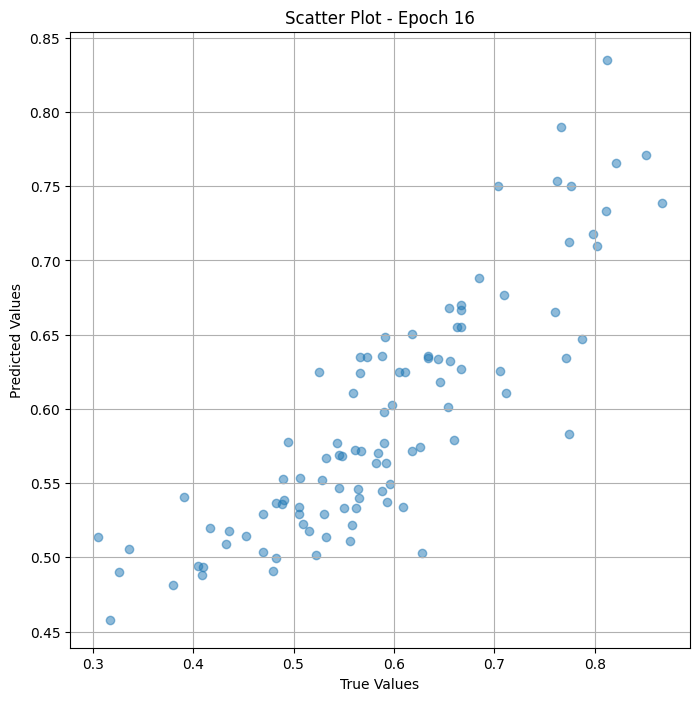

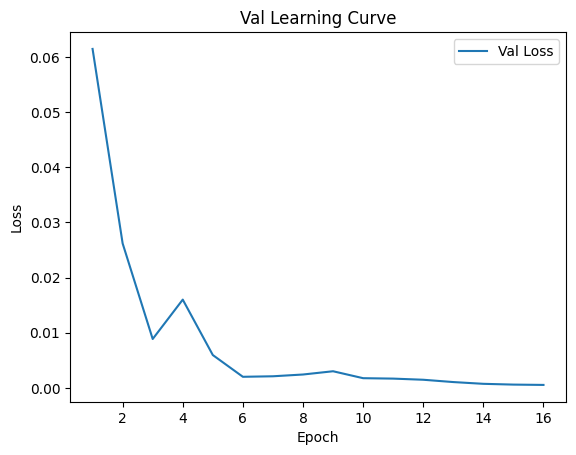


 Epoch: (17/30) Loss = 0.000440466043073684

 Epoch: (17/30) Loss_rmse = 0.020987283438444138

 Epoch: (17/30) R^2 = 0.9618527889251709

 Epoch: (17/30) MAE = 0.020891040563583374
Spearman correlation coefficient: SignificanceResult(statistic=0.871914701219485, pvalue=6.6411399484996595e-31)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

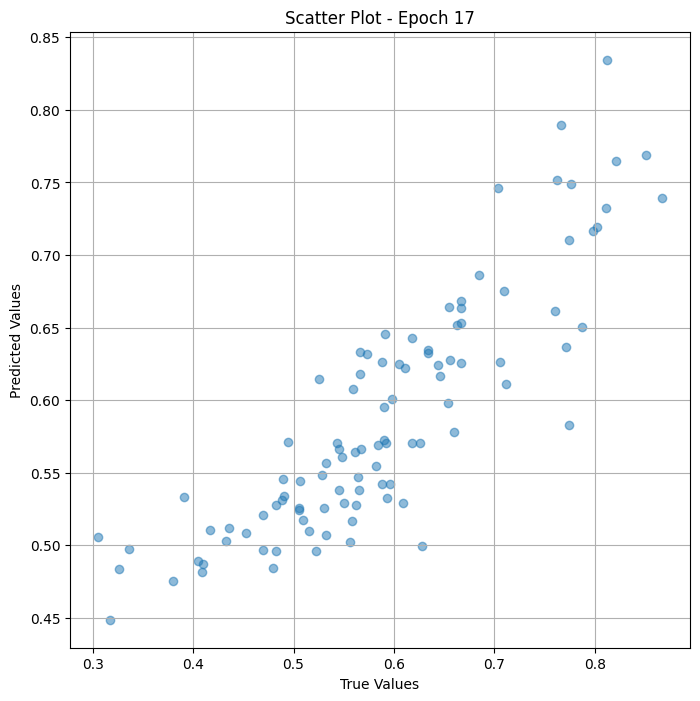

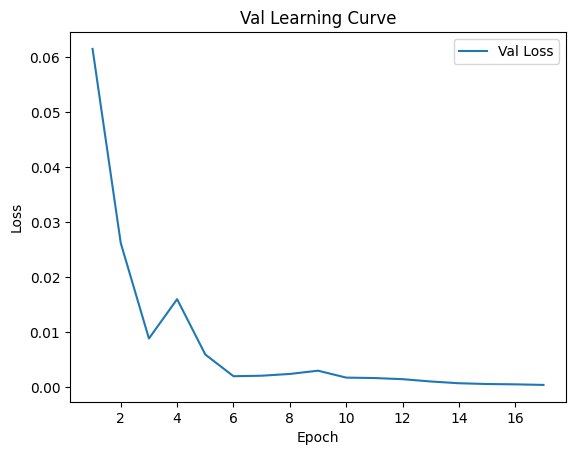


 Epoch: (18/30) Loss = 0.00035665600444190204

 Epoch: (18/30) Loss_rmse = 0.018885338678956032

 Epoch: (18/30) R^2 = 0.9691112637519836

 Epoch: (18/30) MAE = 0.017779305577278137
Spearman correlation coefficient: SignificanceResult(statistic=0.880752614044081, pvalue=2.8494049539283024e-32)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

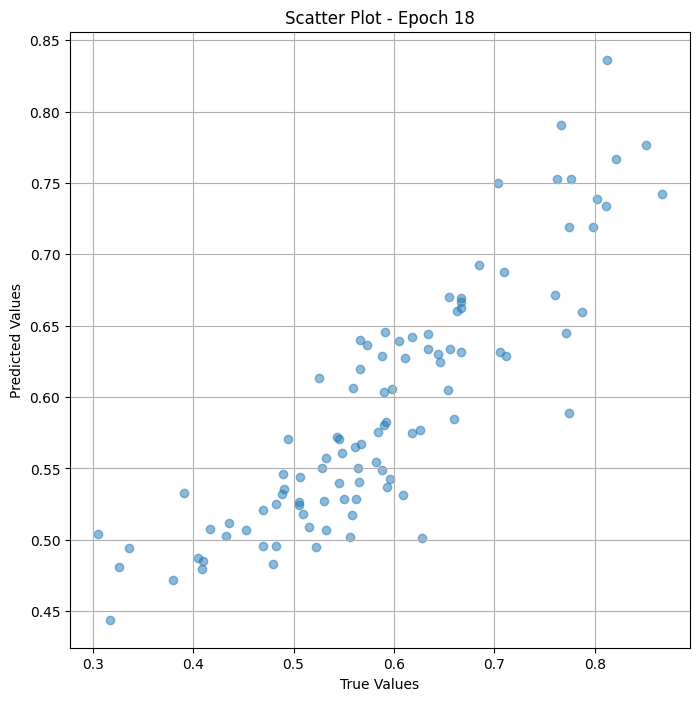

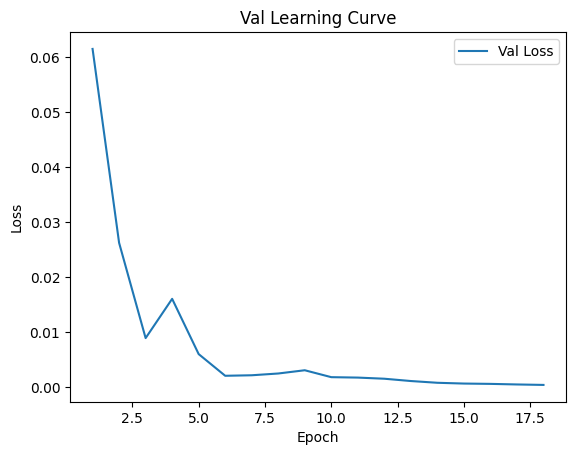


 Epoch: (19/30) Loss = 0.00033926009200513363

 Epoch: (19/30) Loss_rmse = 0.018419014289975166

 Epoch: (19/30) R^2 = 0.9706178307533264

 Epoch: (19/30) MAE = 0.016597315669059753
Spearman correlation coefficient: SignificanceResult(statistic=0.8890072110567696, pvalue=1.1911255467825662e-33)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574

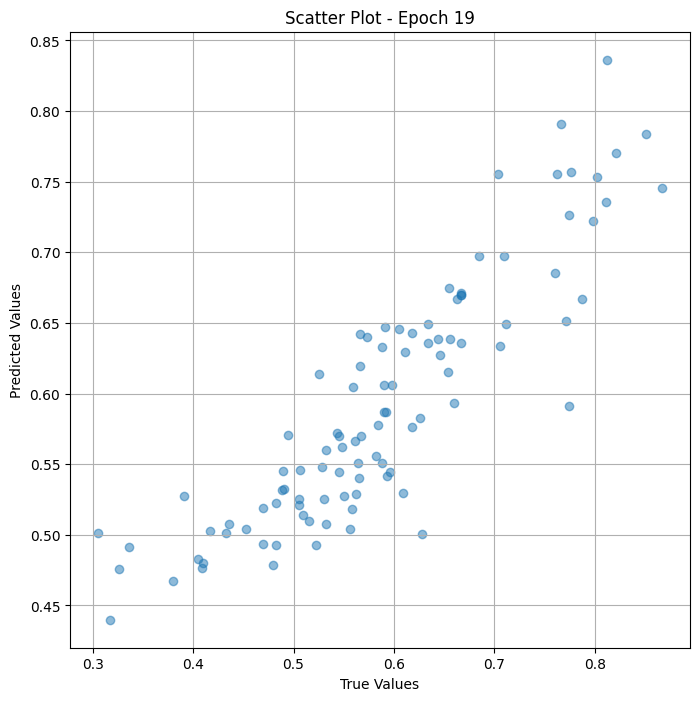

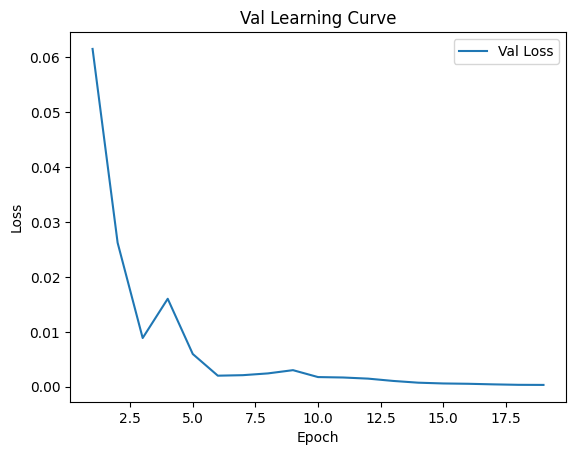


 Epoch: (20/30) Loss = 0.0003315072972327471

 Epoch: (20/30) Loss_rmse = 0.01820734143257141

 Epoch: (20/30) R^2 = 0.9712892770767212

 Epoch: (20/30) MAE = 0.016587182879447937
Spearman correlation coefficient: SignificanceResult(statistic=0.8974313766194314, pvalue=3.561408087743483e-35)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

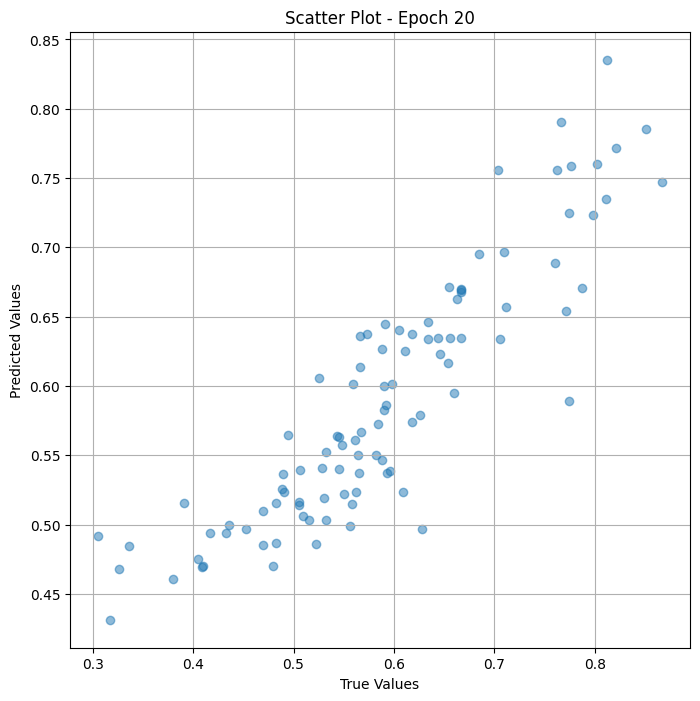

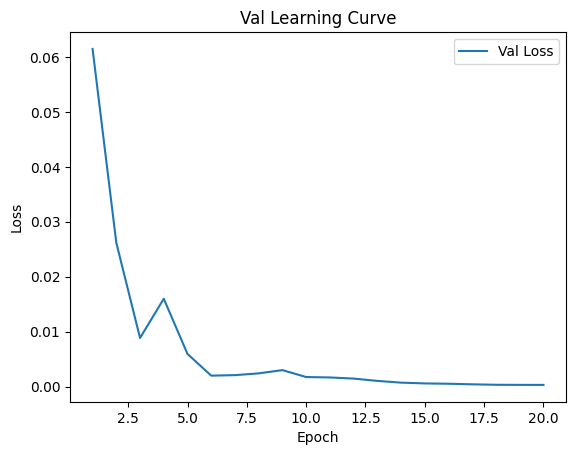


 Epoch: (21/30) Loss = 0.0003323036362417042

 Epoch: (21/30) Loss_rmse = 0.018229197710752487

 Epoch: (21/30) R^2 = 0.9712203145027161

 Epoch: (21/30) MAE = 0.01511615514755249
Spearman correlation coefficient: SignificanceResult(statistic=0.9068593879979335, pvalue=4.788770615513304e-37)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

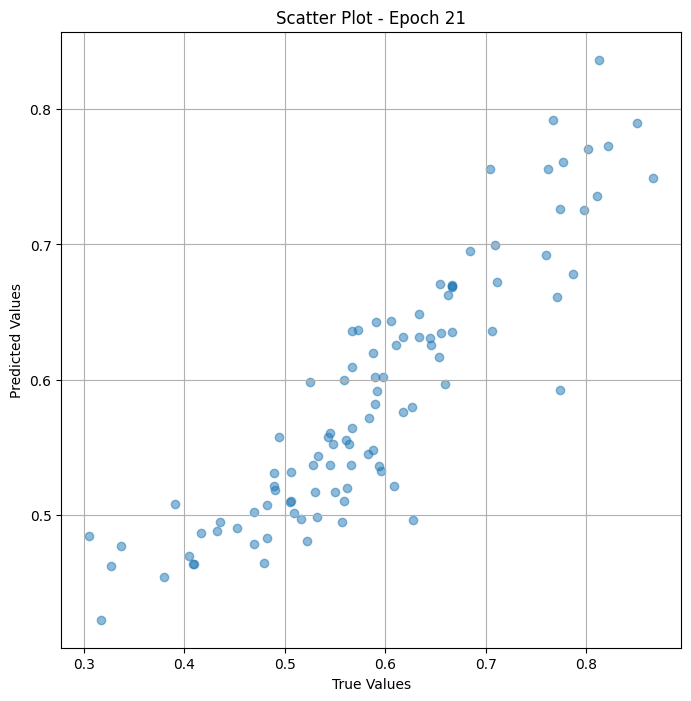

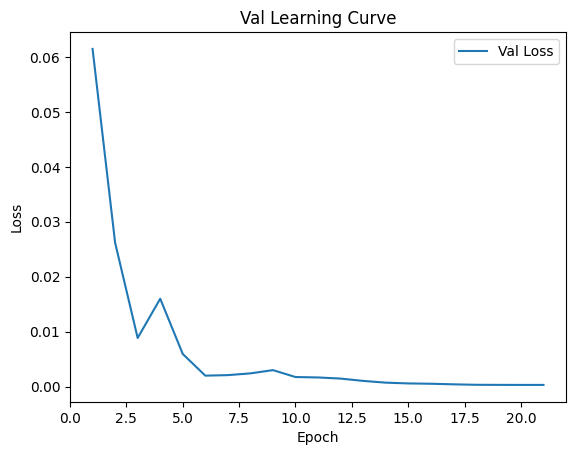


 Epoch: (22/30) Loss = 0.0003381456481292844

 Epoch: (22/30) Loss_rmse = 0.018388736993074417

 Epoch: (22/30) R^2 = 0.9707143902778625

 Epoch: (22/30) MAE = 0.015686631202697754
Spearman correlation coefficient: SignificanceResult(statistic=0.9147544996846794, pvalue=8.972488303308674e-39)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

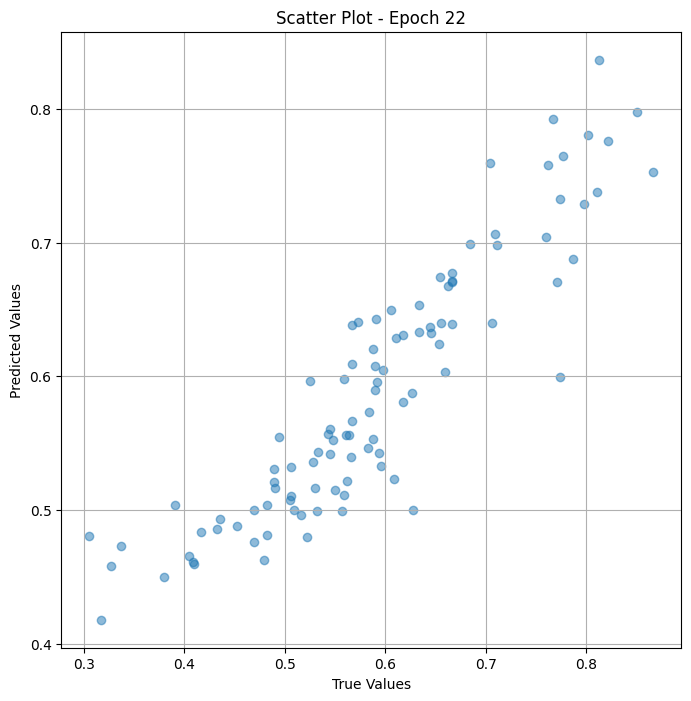

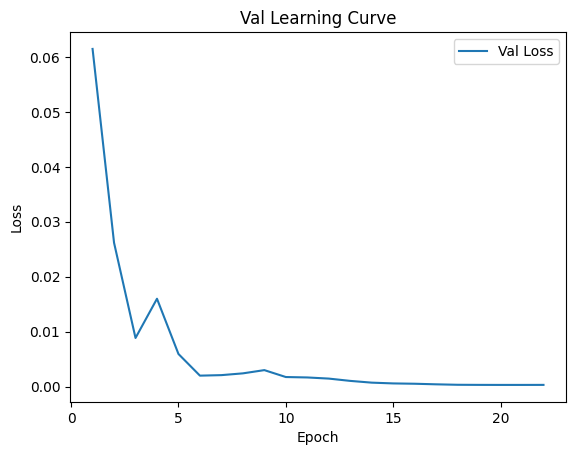


 Epoch: (23/30) Loss = 0.00031174859032034874

 Epoch: (23/30) Loss_rmse = 0.01765640452504158

 Epoch: (23/30) R^2 = 0.9730005264282227

 Epoch: (23/30) MAE = 0.014578700065612793
Spearman correlation coefficient: SignificanceResult(statistic=0.925993503176894, pvalue=1.5181810385886935e-41)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.5057471

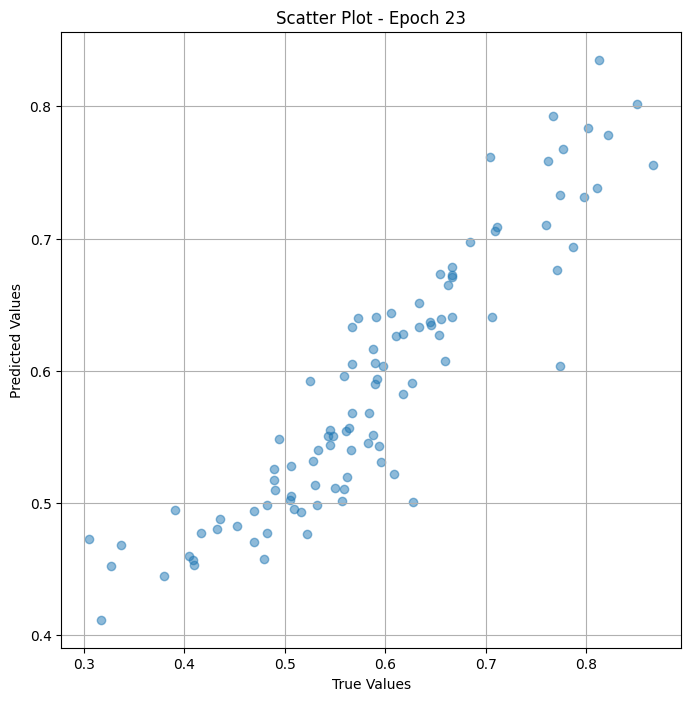

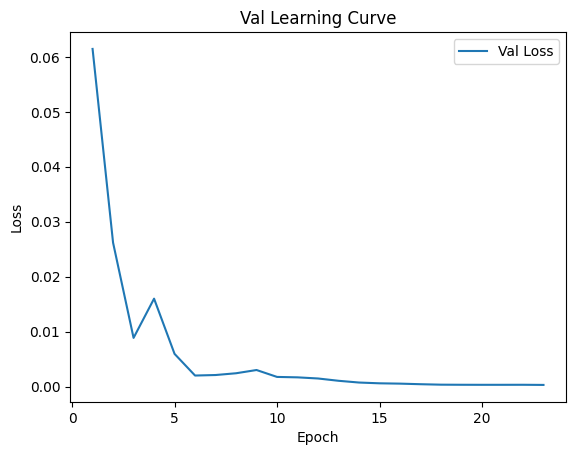


 Epoch: (24/30) Loss = 0.00029957640799693763

 Epoch: (24/30) Loss_rmse = 0.017308276146650314

 Epoch: (24/30) R^2 = 0.974054753780365

 Epoch: (24/30) MAE = 0.014218553900718689
Spearman correlation coefficient: SignificanceResult(statistic=0.938507662164906, pvalue=3.363054329916304e-45)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574714

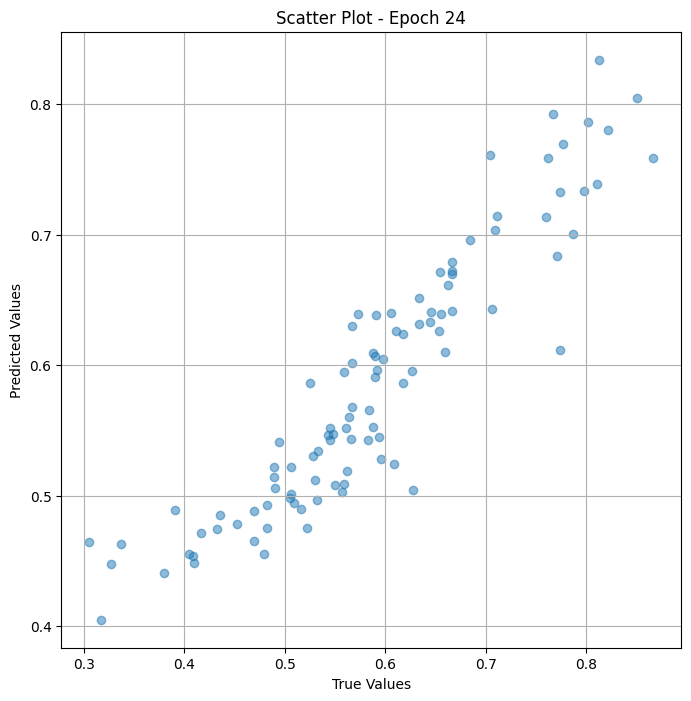

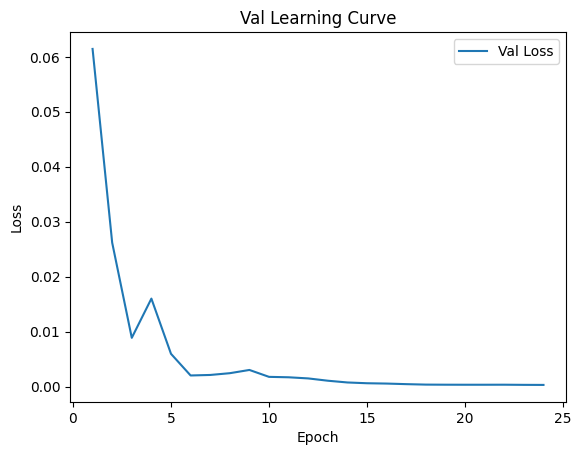


 Epoch: (25/30) Loss = 0.00027893902733922005

 Epoch: (25/30) Loss_rmse = 0.01670146733522415

 Epoch: (25/30) R^2 = 0.9758420586585999

 Epoch: (25/30) MAE = 0.013448774814605713
Spearman correlation coefficient: SignificanceResult(statistic=0.9429842718841948, pvalue=1.0689587848849676e-46)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

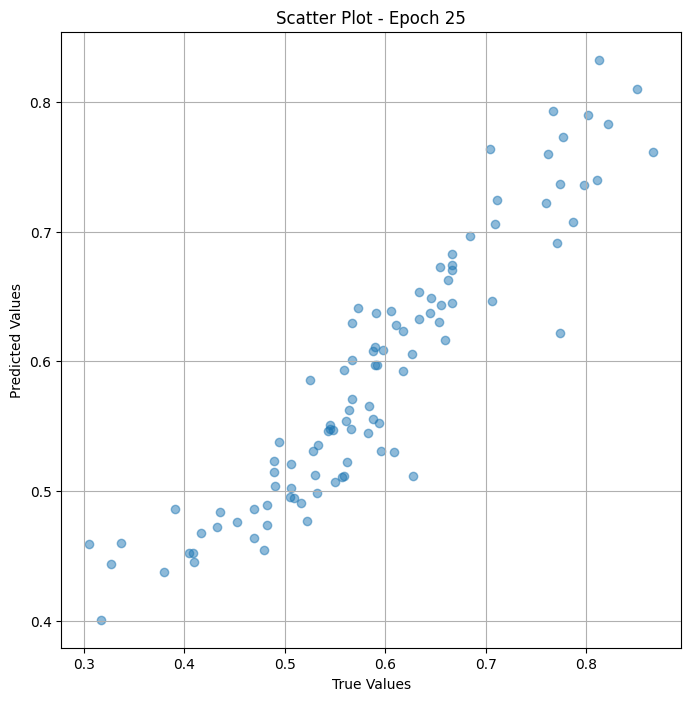

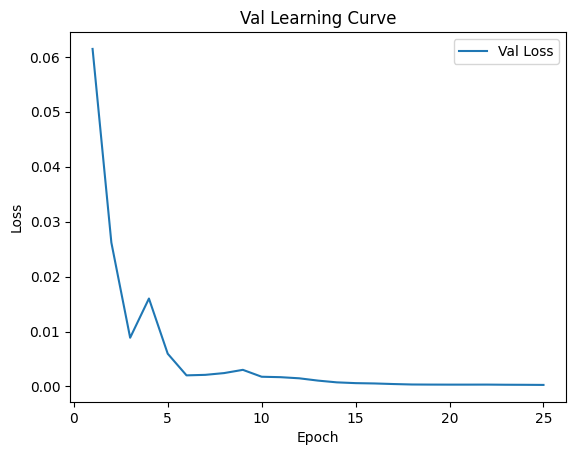


 Epoch: (26/30) Loss = 0.00023802010400686413

 Epoch: (26/30) Loss_rmse = 0.015427900478243828

 Epoch: (26/30) R^2 = 0.9793859124183655

 Epoch: (26/30) MAE = 0.011886313557624817
Spearman correlation coefficient: SignificanceResult(statistic=0.9517407918048035, pvalue=5.168241749044052e-50)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

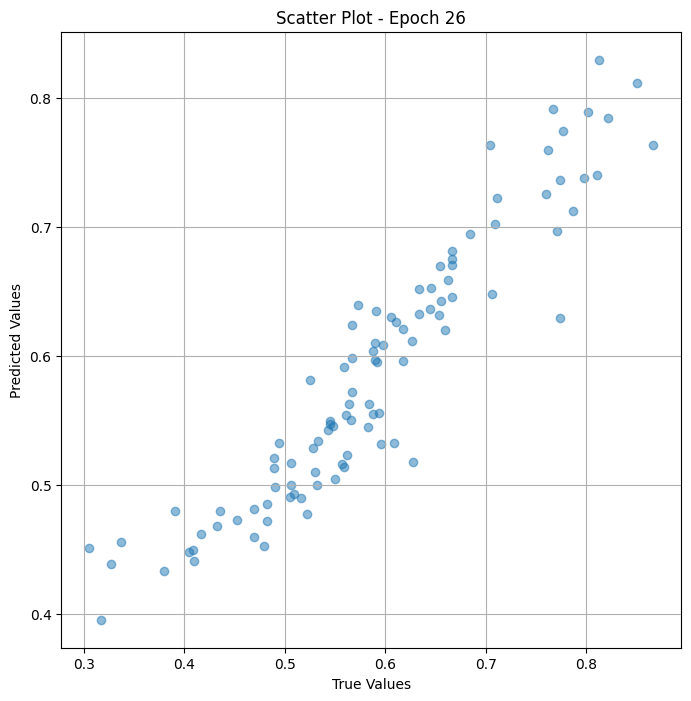

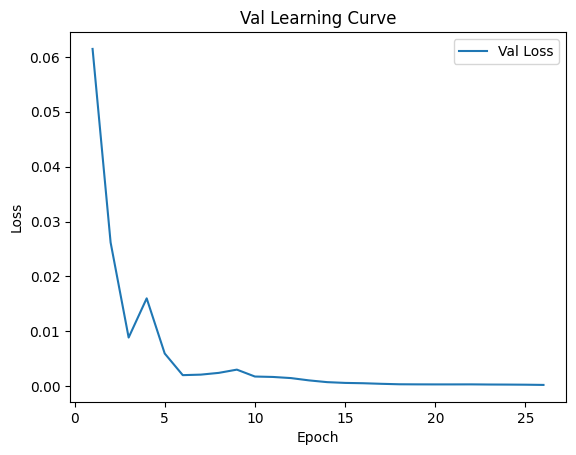


 Epoch: (27/30) Loss = 0.00021596829174086452

 Epoch: (27/30) Loss_rmse = 0.014695859514176846

 Epoch: (27/30) R^2 = 0.9812957048416138

 Epoch: (27/30) MAE = 0.01122903823852539
Spearman correlation coefficient: SignificanceResult(statistic=0.9593103318756011, pvalue=2.0252453005331973e-53)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

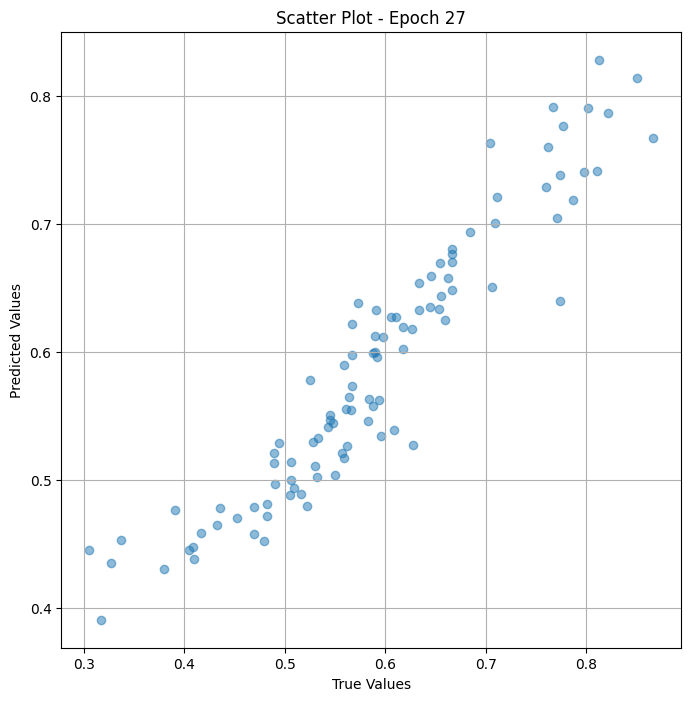

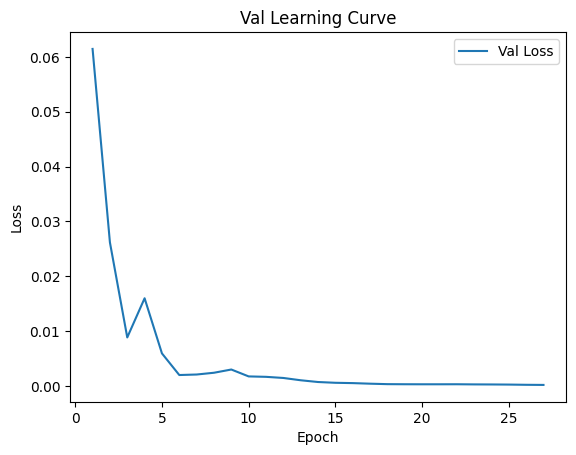


 Epoch: (28/30) Loss = 0.00018717309285420924

 Epoch: (28/30) Loss_rmse = 0.013681122101843357

 Epoch: (28/30) R^2 = 0.9837895631790161

 Epoch: (28/30) MAE = 0.010306566953659058
Spearman correlation coefficient: SignificanceResult(statistic=0.9647229599907412, pvalue=2.797530085623823e-56)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.505747

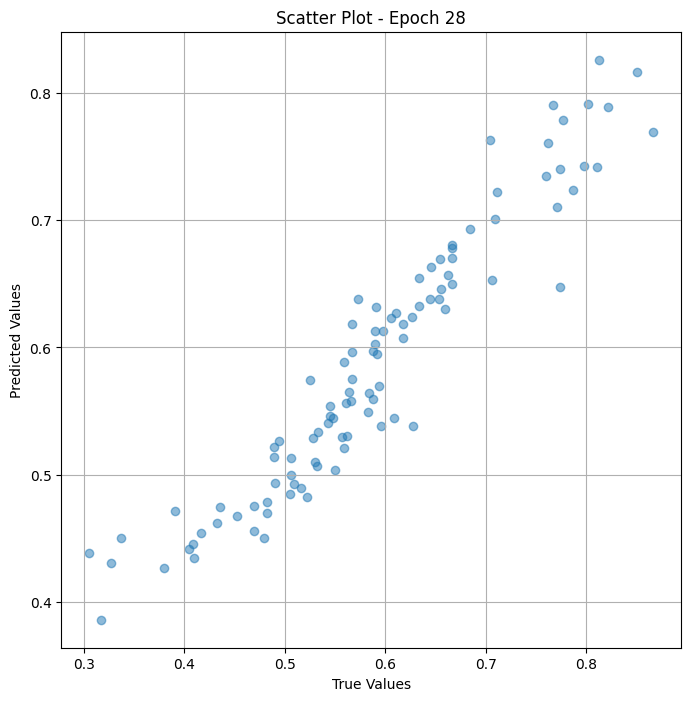

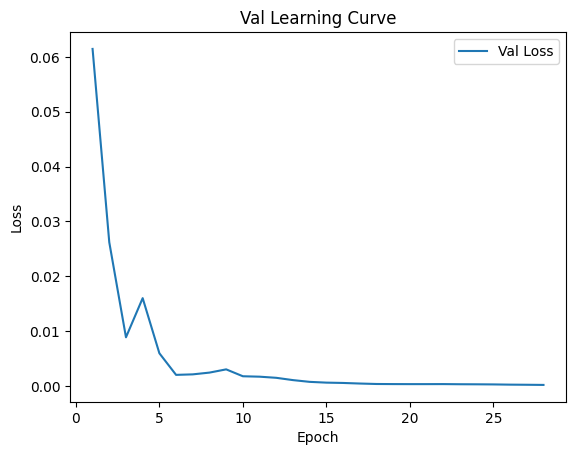


 Epoch: (29/30) Loss = 0.00016513066657353193

 Epoch: (29/30) Loss_rmse = 0.012850318104028702

 Epoch: (29/30) R^2 = 0.9856985807418823

 Epoch: (29/30) MAE = 0.009553775191307068
Spearman correlation coefficient: SignificanceResult(statistic=0.9697150581019481, pvalue=2.4093921941773153e-59)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574

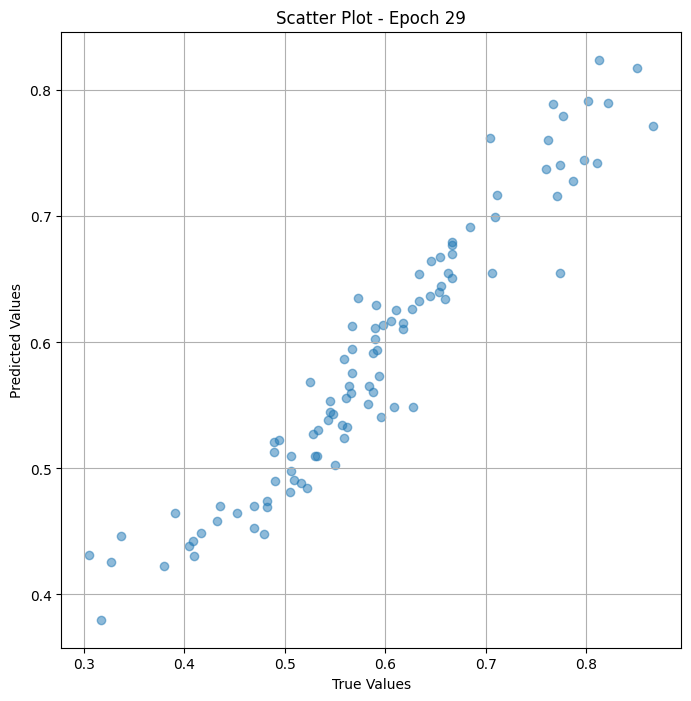

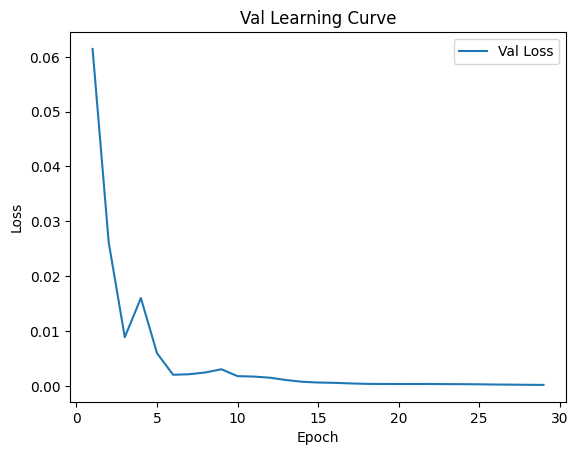


 Epoch: (30/30) Loss = 0.00015026053006295115

 Epoch: (30/30) Loss_rmse = 0.012258079834282398

 Epoch: (30/30) R^2 = 0.9869864583015442

 Epoch: (30/30) MAE = 0.009201154112815857
Spearman correlation coefficient: SignificanceResult(statistic=0.9740424474972608, pvalue=1.8947414647116887e-62)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7625, 0.54545456, 0.33653846, 0.8214286, 0.5670103, 0.50617284, 0.6666667, 0.7977528, 0.51578945, 0.31683168, 0.776699, 0.5478261, 0.76, 0.59090906, 0.6339286, 0.48214287, 0.5252525, 0.5882353, 0.53271025, 0.556701, 0.5585586, 0.6666667, 0.49425286, 0.6442308, 0.6179775, 0.5319149, 0.65384614, 0.65957445, 0.5824176, 0.704, 0.5959596, 0.5609756, 0.30555555, 0.43269232, 0.65486723, 0.6666667, 0.4888889, 0.6627907, 0.5934066, 0.7741935, 0.48913044, 0.38, 0.59, 0.6666667, 0.62637365, 0.8666667, 0.85106385, 0.5730337, 0.56666666, 0.4691358, 0.55, 0.7117117, 0.8108108, 0.45238096, 0.5619048, 0.68421054, 0.50574

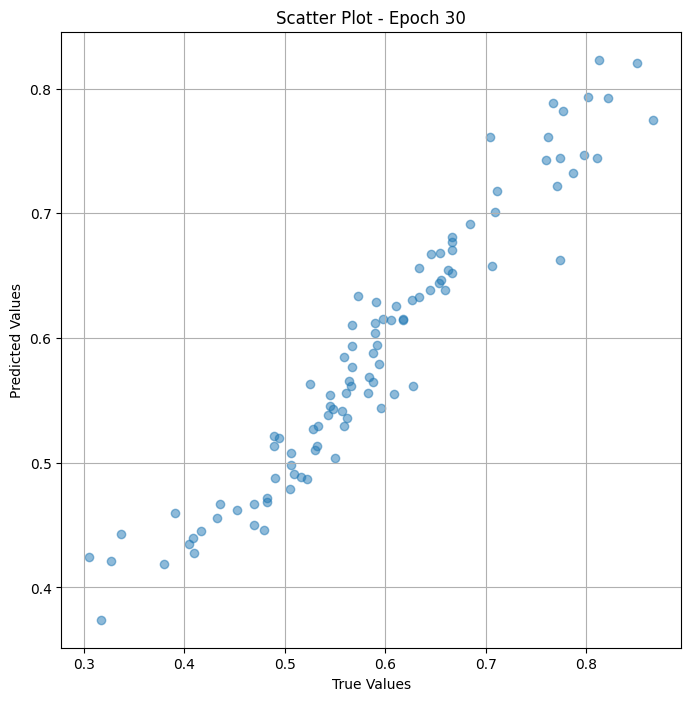

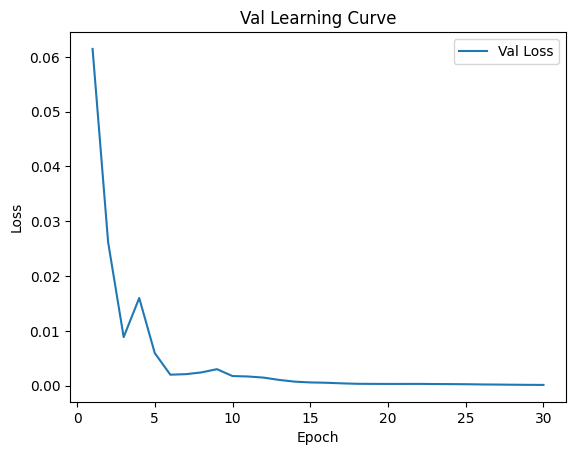

In [ ]:
# val the model and save weights
fit(30, model_vit_sval , val_dl )
torch.save(model_vit_sval.state_dict(), "model_weights_s")

## Test

In [ ]:
params = [param for param in list(model_vit_test.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_vit_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_vit_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_vit_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.007109886966645718

 Epoch: (1/50) Loss_rmse = 0.08432014286518097

 Epoch: (1/50) R^2 = -0.14764750003814697

 Epoch: (1/50) MAE = 0.06957025080919266
Spearman correlation coefficient: SignificanceResult(statistic=-0.12601864506870022, pvalue=0.22116532549549503)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519607

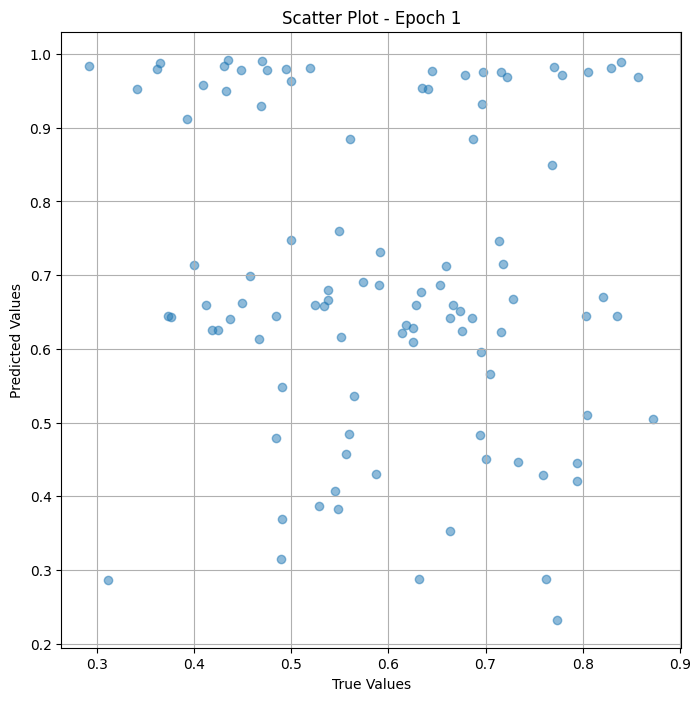

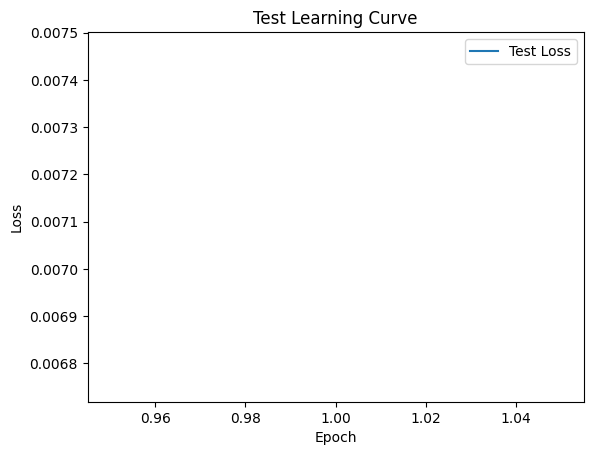


 Epoch: (2/50) Loss = 0.006207967177033424

 Epoch: (2/50) Loss_rmse = 0.07879065722227097

 Epoch: (2/50) R^2 = -0.0020635128021240234

 Epoch: (2/50) MAE = 0.06931238621473312
Spearman correlation coefficient: SignificanceResult(statistic=0.2008905408121546, pvalue=0.04969382053627962)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519607

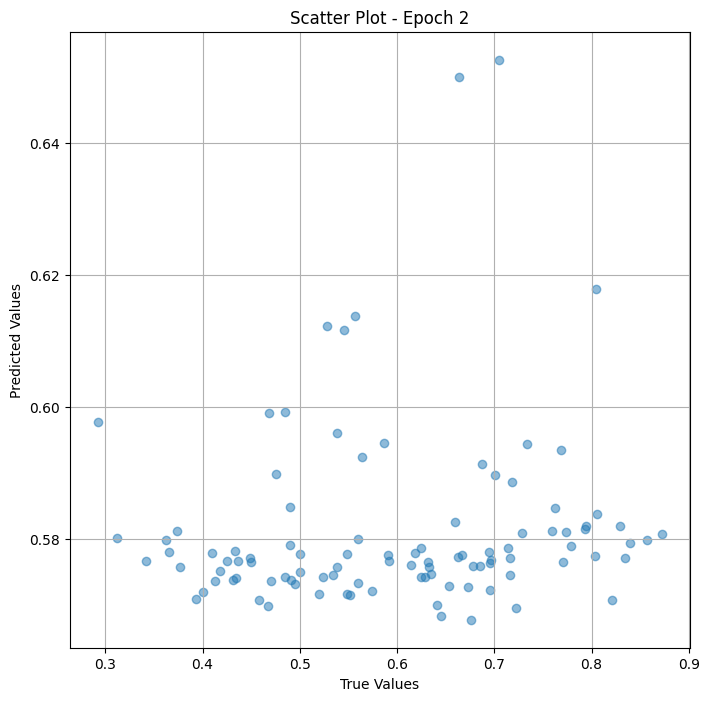

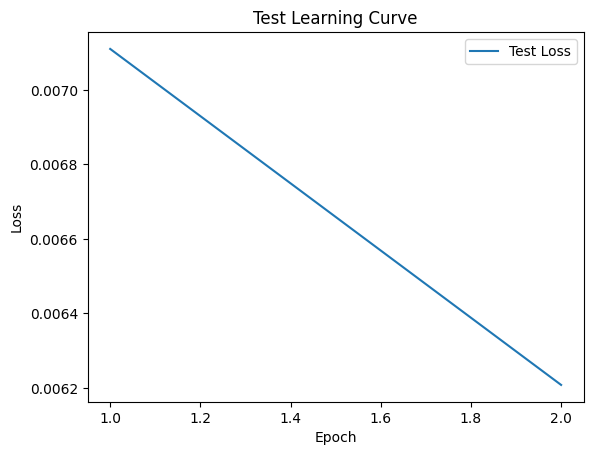


 Epoch: (3/50) Loss = 0.006070862058550119

 Epoch: (3/50) Loss_rmse = 0.0779157355427742

 Epoch: (3/50) R^2 = 0.02006739377975464

 Epoch: (3/50) MAE = 0.06894557923078537
Spearman correlation coefficient: SignificanceResult(statistic=-0.1482787738693178, pvalue=0.14936409376086204)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51960784,

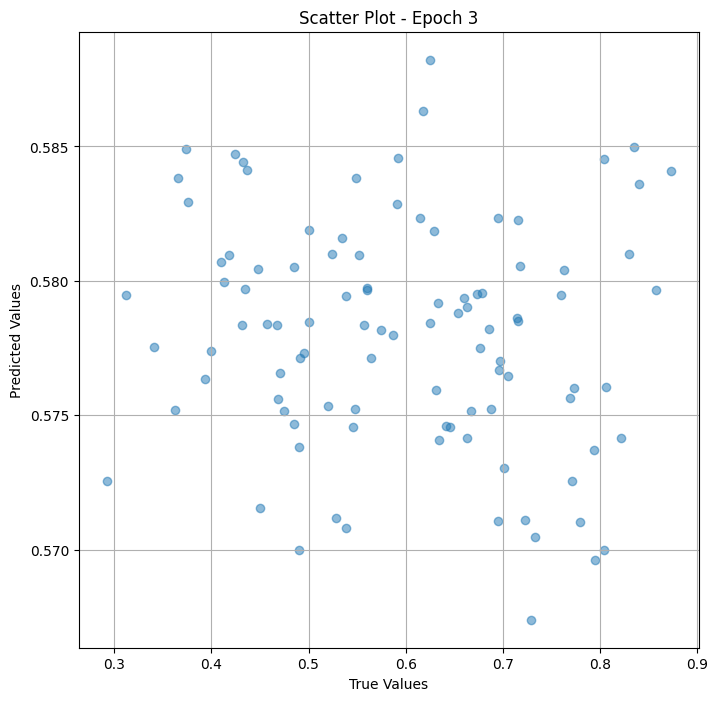

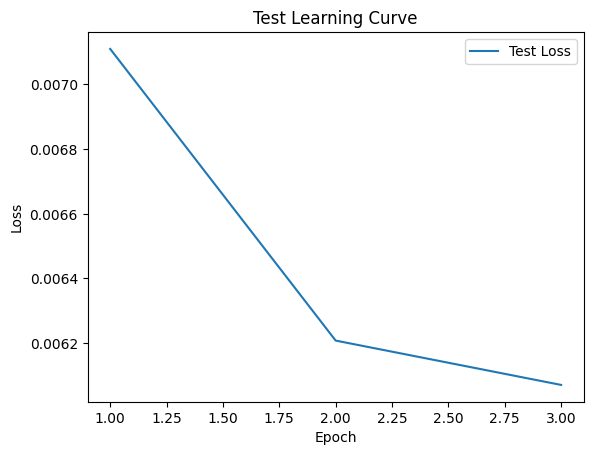


 Epoch: (4/50) Loss = 0.006215228233486414

 Epoch: (4/50) Loss_rmse = 0.07883671671152115

 Epoch: (4/50) R^2 = -0.0032355785369873047

 Epoch: (4/50) MAE = 0.06886530667543411
Spearman correlation coefficient: SignificanceResult(statistic=-0.1397803151894964, pvalue=0.17436853096317942)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51960

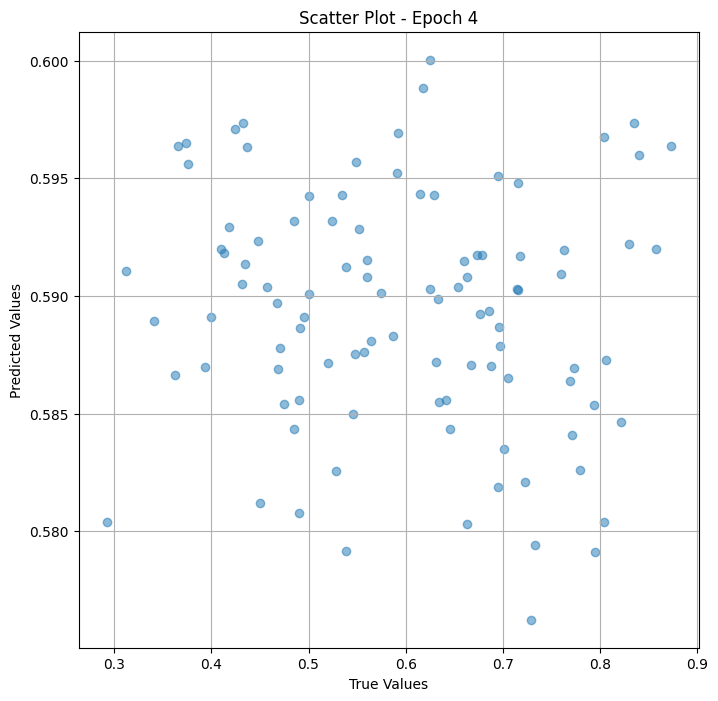

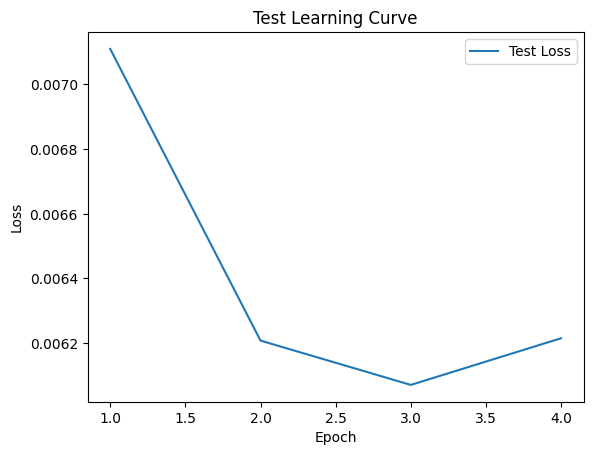


 Epoch: (5/50) Loss = 0.006415849085897207

 Epoch: (5/50) Loss_rmse = 0.08009899407625198

 Epoch: (5/50) R^2 = -0.03561890125274658

 Epoch: (5/50) MAE = 0.06876832991838455
Spearman correlation coefficient: SignificanceResult(statistic=-0.10025875195939328, pvalue=0.3310929951703584)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5196078

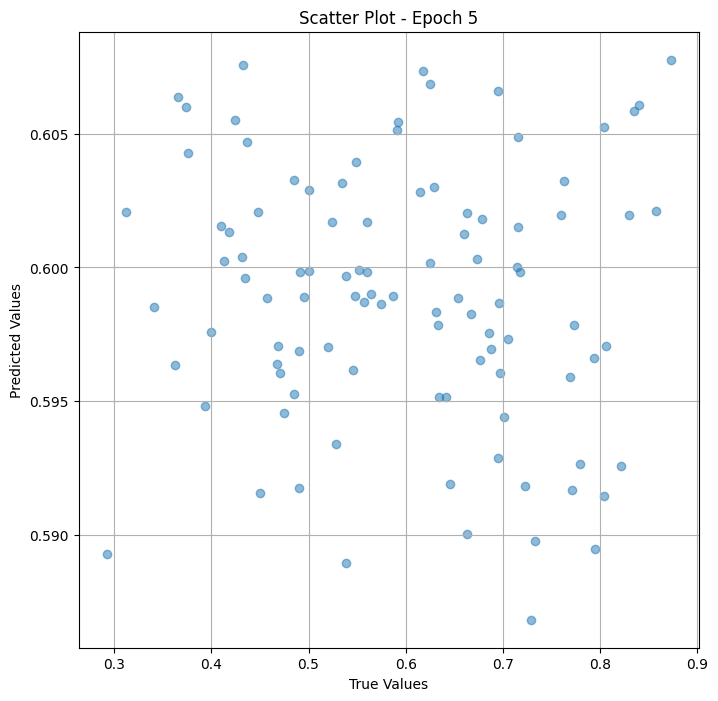

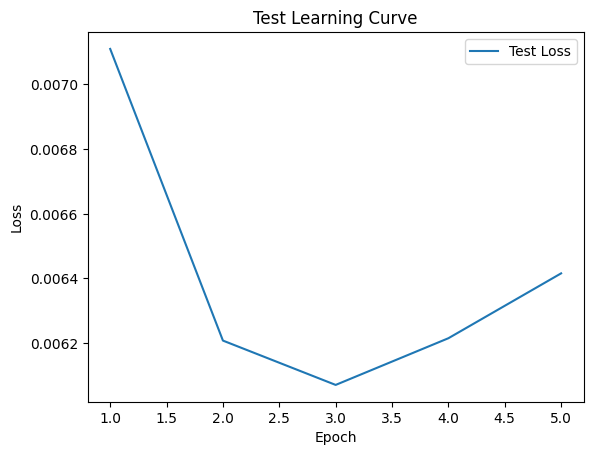

Epoch 0.08: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (6/50) Loss = 0.006396864075213671

 Epoch: (6/50) Loss_rmse = 0.07998039573431015

 Epoch: (6/50) R^2 = -0.03255438804626465

 Epoch: (6/50) MAE = 0.06866157799959183
Spearman correlation coefficient: SignificanceResult(statistic=-0.04197004174839166, pvalue=0.6847330940157885)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6

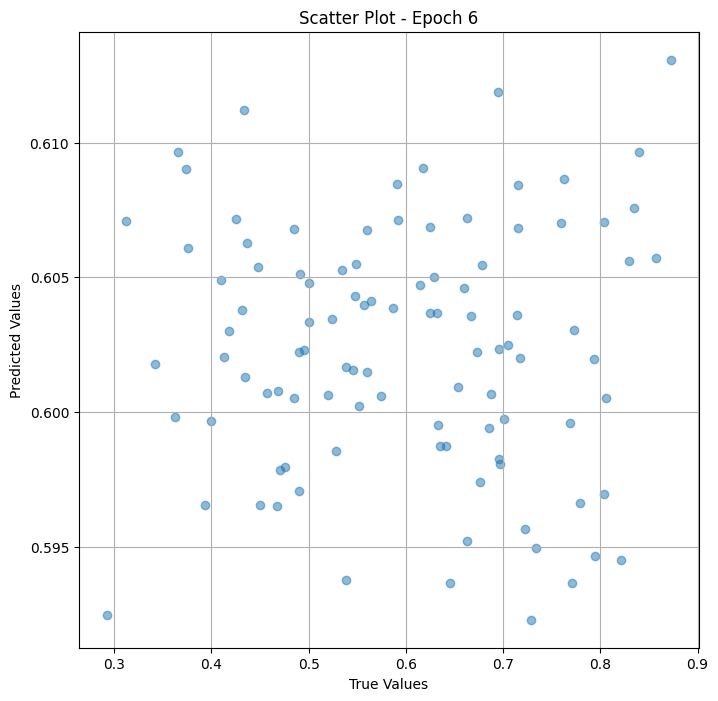

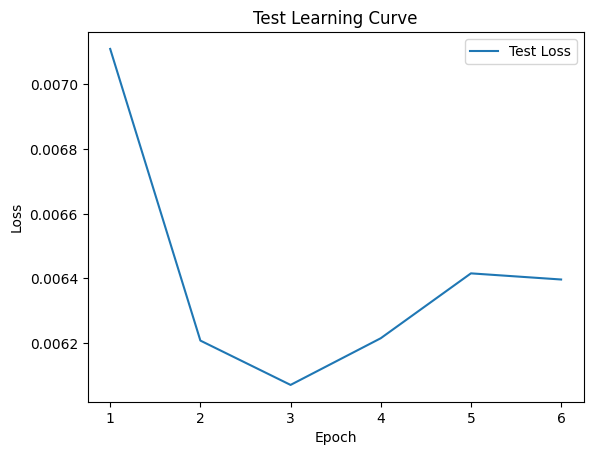


 Epoch: (7/50) Loss = 0.006311696954071522

 Epoch: (7/50) Loss_rmse = 0.07944618910551071

 Epoch: (7/50) R^2 = -0.018807172775268555

 Epoch: (7/50) MAE = 0.06861560791730881
Spearman correlation coefficient: SignificanceResult(statistic=-0.009041057797447655, pvalue=0.9303334746760884)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51960

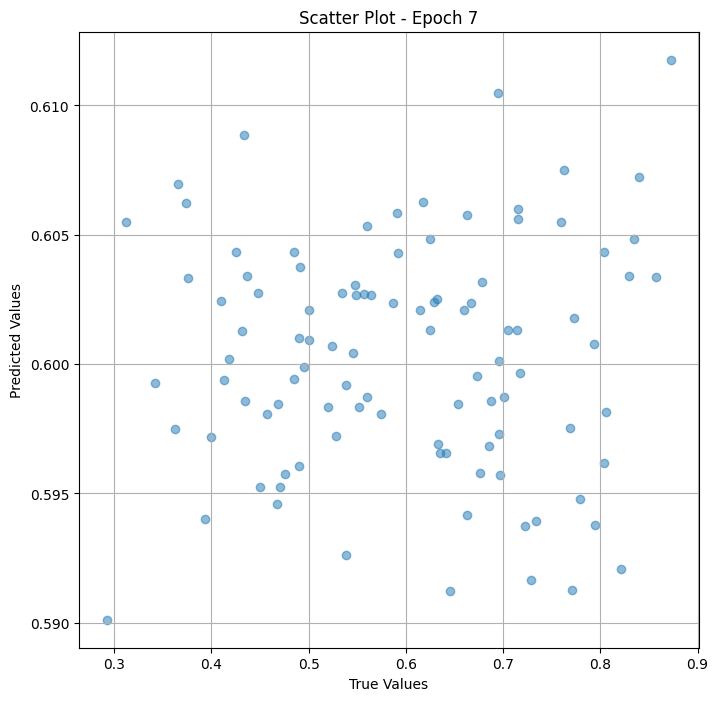

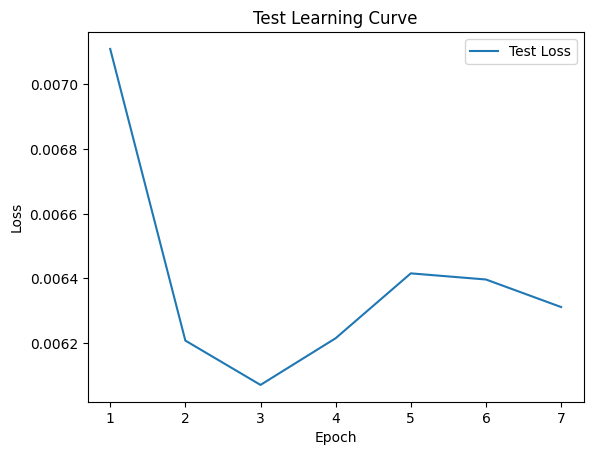


 Epoch: (8/50) Loss = 0.006283462978899479

 Epoch: (8/50) Loss_rmse = 0.07926829904317856

 Epoch: (8/50) R^2 = -0.014249682426452637

 Epoch: (8/50) MAE = 0.06860128790140152
Spearman correlation coefficient: SignificanceResult(statistic=-0.004320445474099142, pvalue=0.9666763003359762)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51960

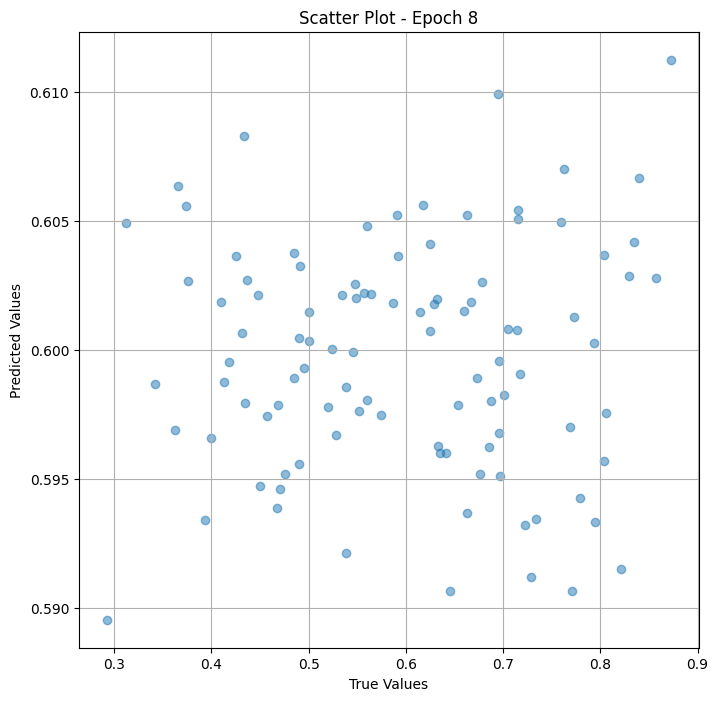

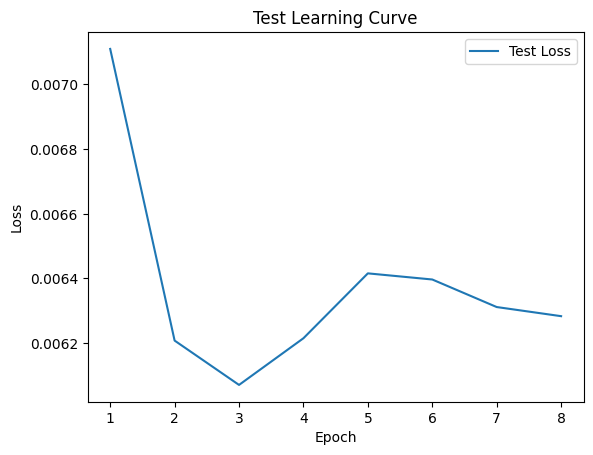

Epoch 0.08: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (9/50) Loss = 0.006251166574656963

 Epoch: (9/50) Loss_rmse = 0.07906431704759598

 Epoch: (9/50) R^2 = -0.009036540985107422

 Epoch: (9/50) MAE = 0.06858507543802261
Spearman correlation coefficient: SignificanceResult(statistic=-0.001363280283035993, pvalue=0.9894822765120015)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0

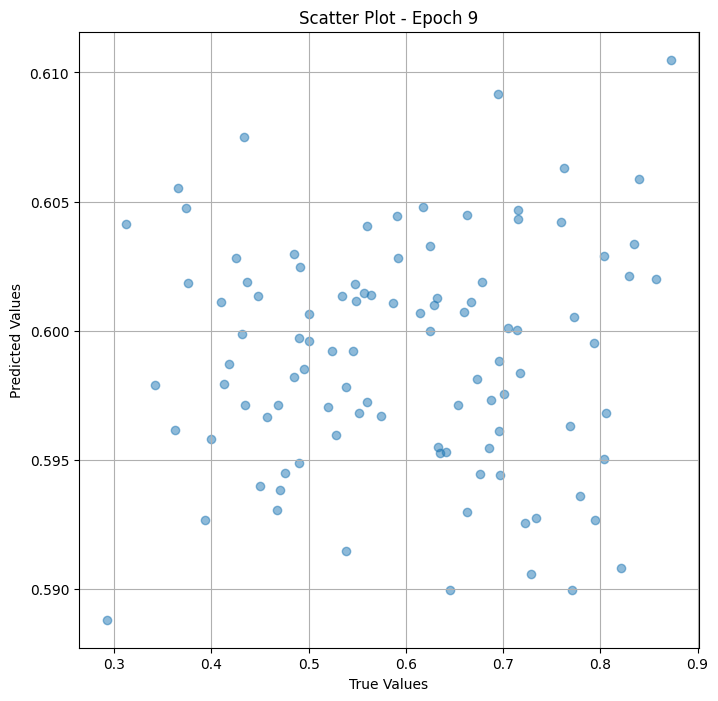

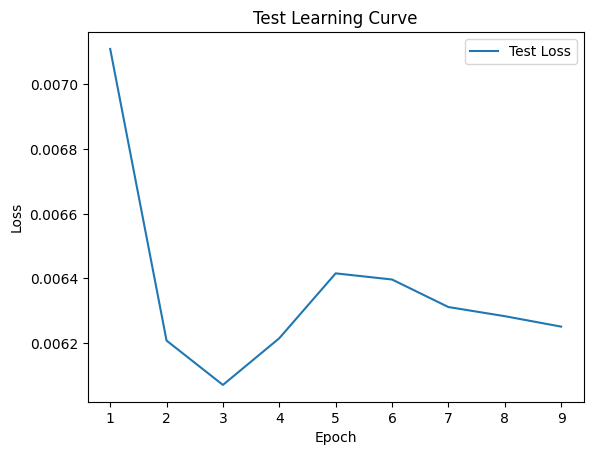


 Epoch: (10/50) Loss = 0.006237517111003399

 Epoch: (10/50) Loss_rmse = 0.07897794991731644

 Epoch: (10/50) R^2 = -0.006833314895629883

 Epoch: (10/50) MAE = 0.06857845932245255
Spearman correlation coefficient: SignificanceResult(statistic=-0.003913496135879443, pvalue=0.96981355975292)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

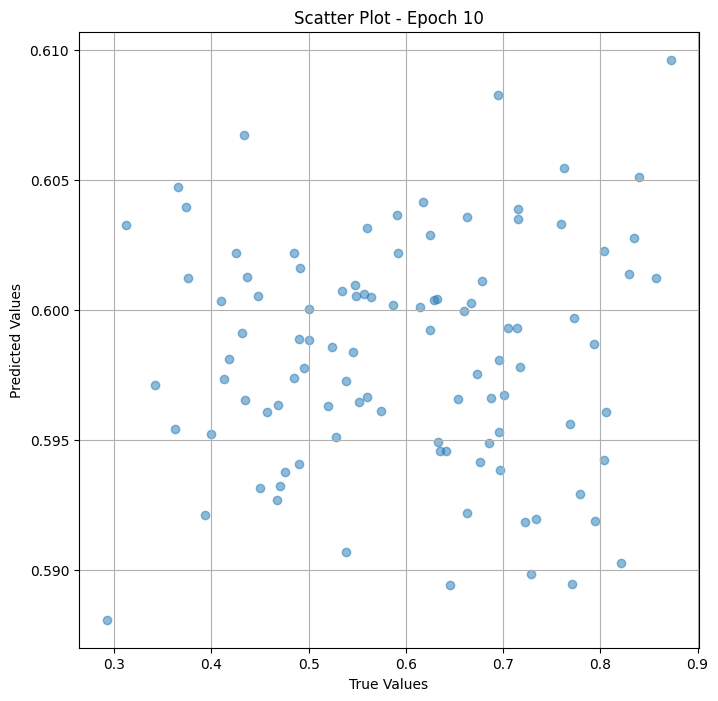

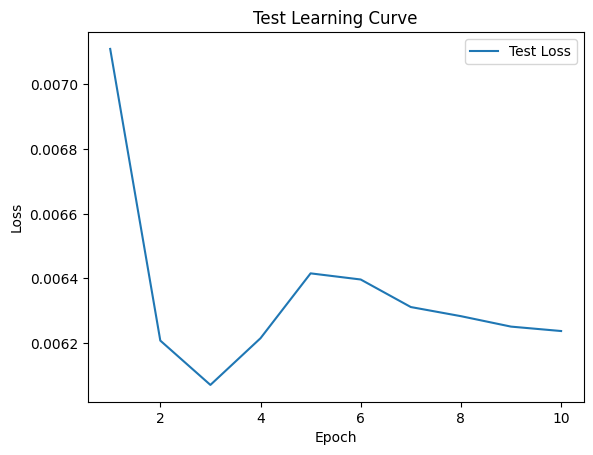


 Epoch: (11/50) Loss = 0.0062340861186385155

 Epoch: (11/50) Loss_rmse = 0.0789562314748764

 Epoch: (11/50) R^2 = -0.006279468536376953

 Epoch: (11/50) MAE = 0.06857652217149734
Spearman correlation coefficient: SignificanceResult(statistic=-0.003913496135879443, pvalue=0.96981355975292)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

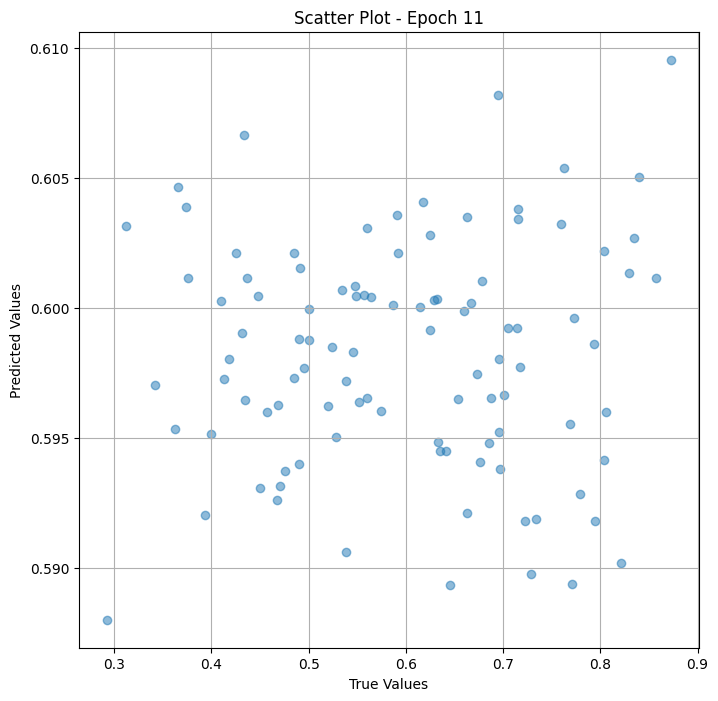

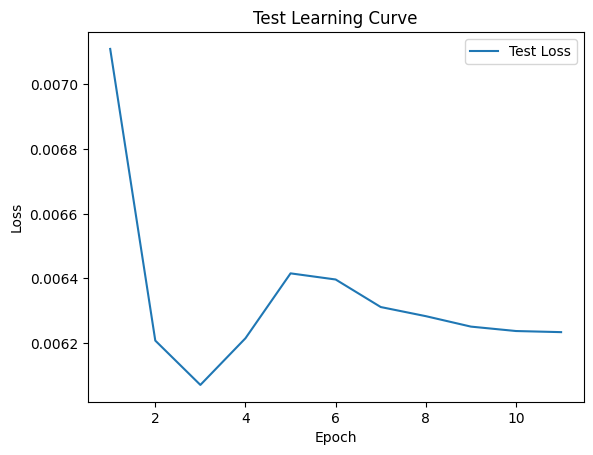

Epoch 0.08: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (12/50) Loss = 0.006230569444596767

 Epoch: (12/50) Loss_rmse = 0.0789339542388916

 Epoch: (12/50) R^2 = -0.005711913108825684

 Epoch: (12/50) MAE = 0.06857437640428543
Spearman correlation coefficient: SignificanceResult(statistic=-0.0031402923932620135, pvalue=0.975775579676236)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737

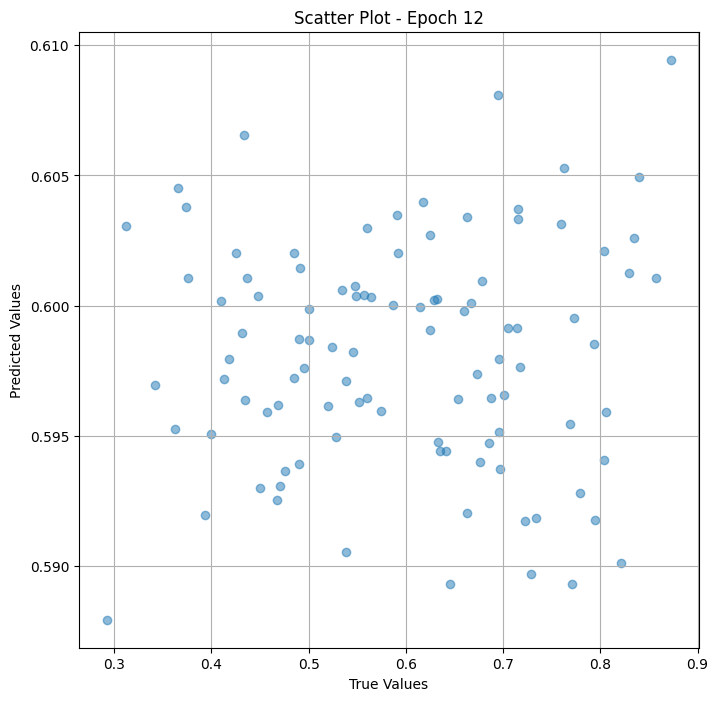

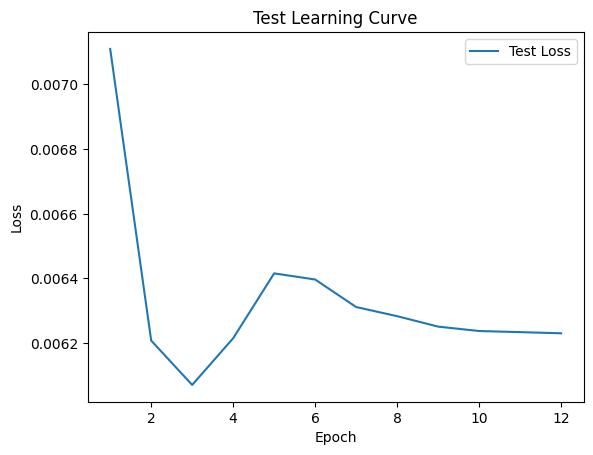


 Epoch: (13/50) Loss = 0.006229136139154434

 Epoch: (13/50) Loss_rmse = 0.07892487943172455

 Epoch: (13/50) R^2 = -0.005480527877807617

 Epoch: (13/50) MAE = 0.06857358664274216
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

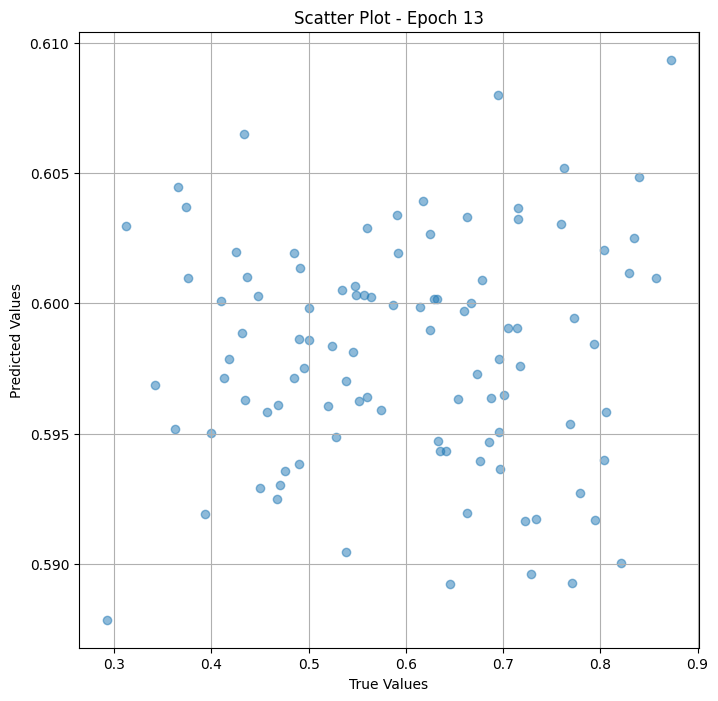

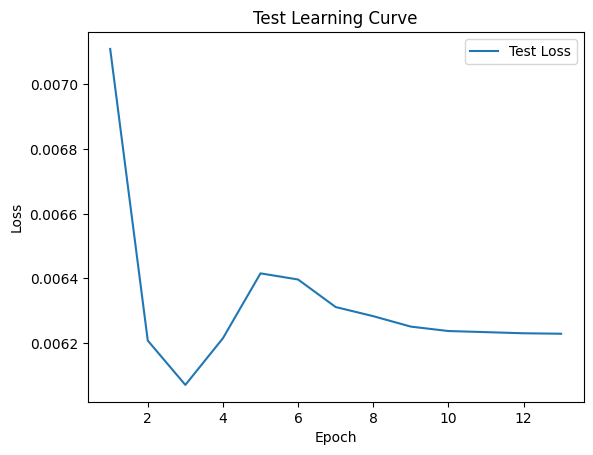


 Epoch: (14/50) Loss = 0.006228805985301733

 Epoch: (14/50) Loss_rmse = 0.07892278581857681

 Epoch: (14/50) R^2 = -0.005427241325378418

 Epoch: (14/50) MAE = 0.06857340782880783
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

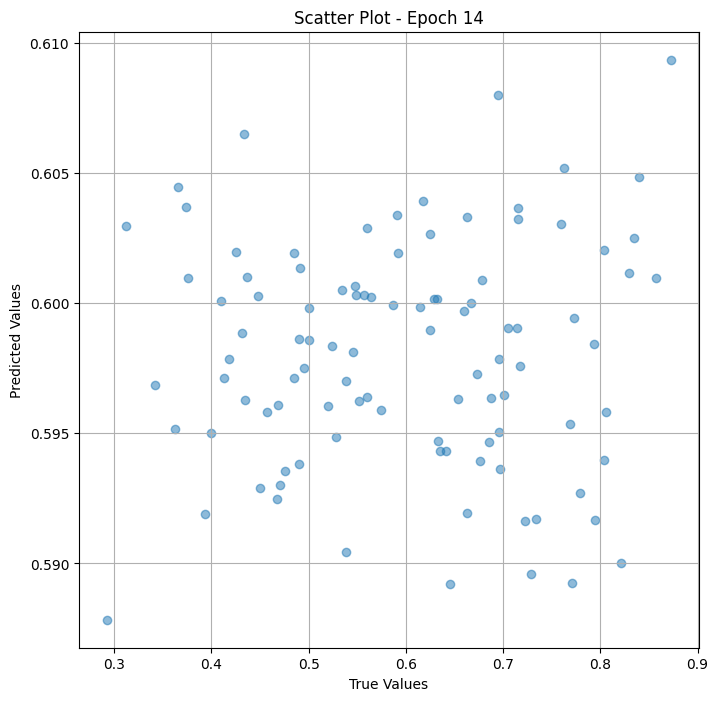

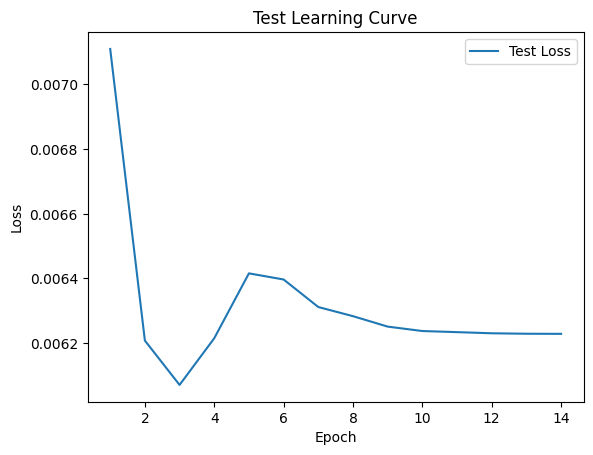

Epoch 0.08: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (15/50) Loss = 0.006228462792932987

 Epoch: (15/50) Loss_rmse = 0.07892061024904251

 Epoch: (15/50) R^2 = -0.005371809005737305

 Epoch: (15/50) MAE = 0.06857315450906754
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.3626373

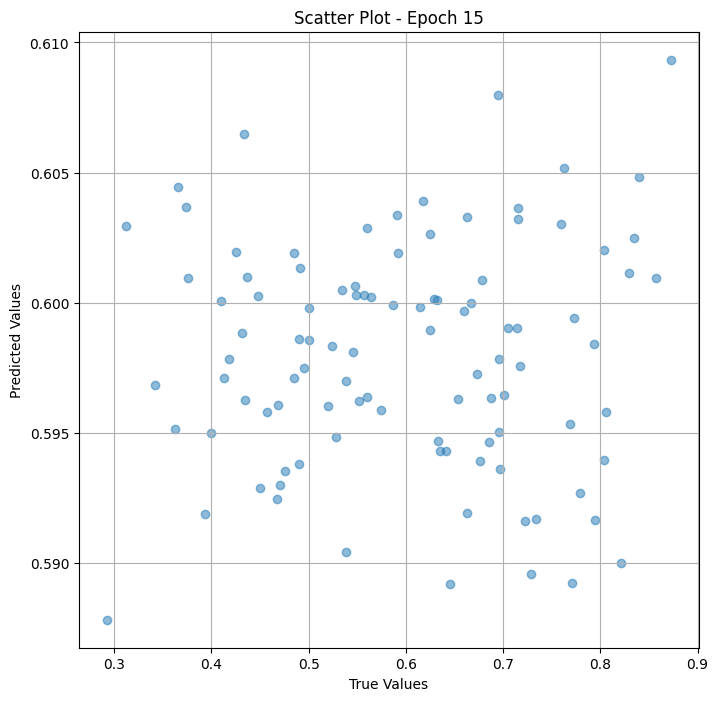

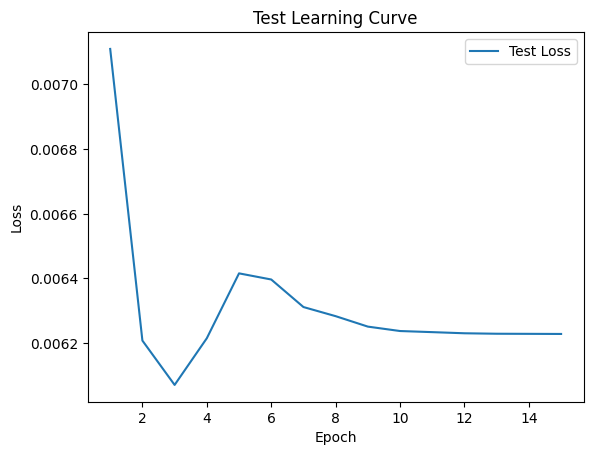


 Epoch: (16/50) Loss = 0.006228331476449966

 Epoch: (16/50) Loss_rmse = 0.07891977578401566

 Epoch: (16/50) R^2 = -0.005350589752197266

 Epoch: (16/50) MAE = 0.06857309490442276
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

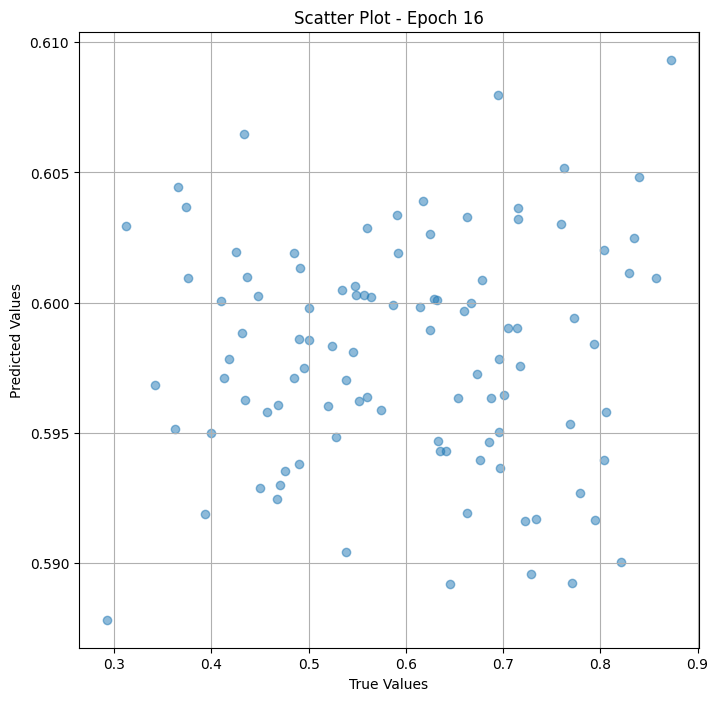

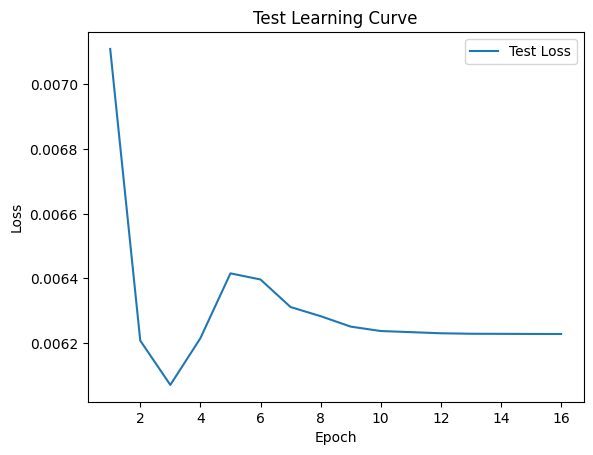


 Epoch: (17/50) Loss = 0.006228312849998474

 Epoch: (17/50) Loss_rmse = 0.0789196640253067

 Epoch: (17/50) R^2 = -0.005347609519958496

 Epoch: (17/50) MAE = 0.06857308000326157
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

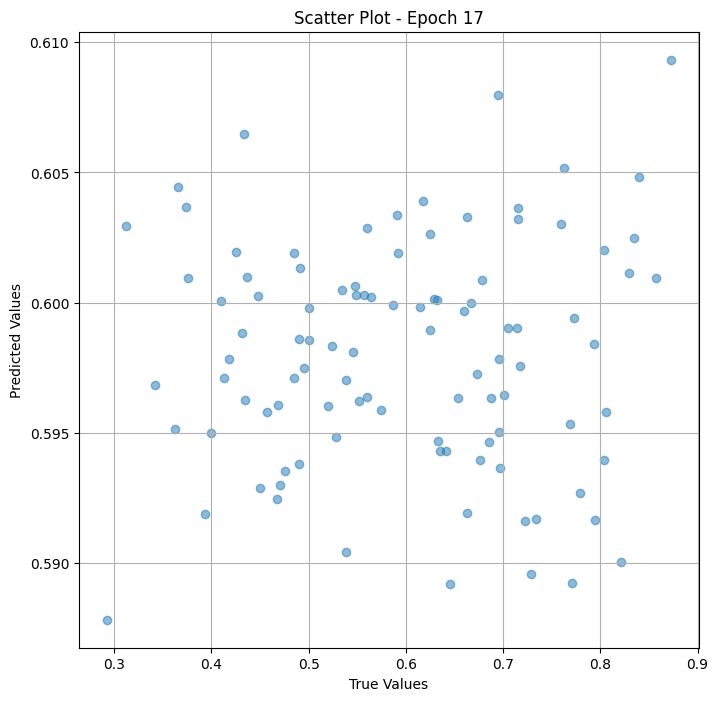

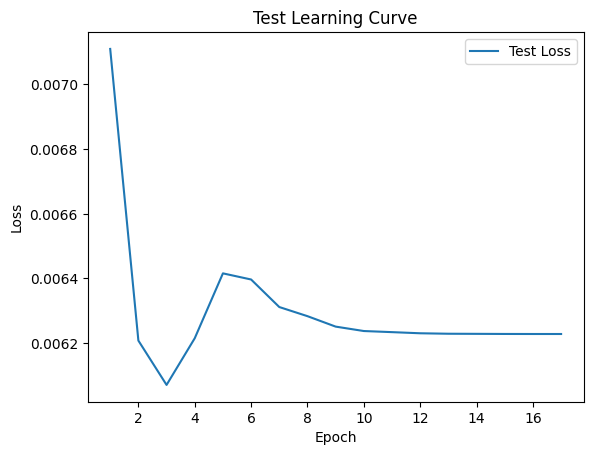


 Epoch: (18/50) Loss = 0.006228296551853418

 Epoch: (18/50) Loss_rmse = 0.07891955971717834

 Epoch: (18/50) R^2 = -0.005344986915588379

 Epoch: (18/50) MAE = 0.06857309490442276
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

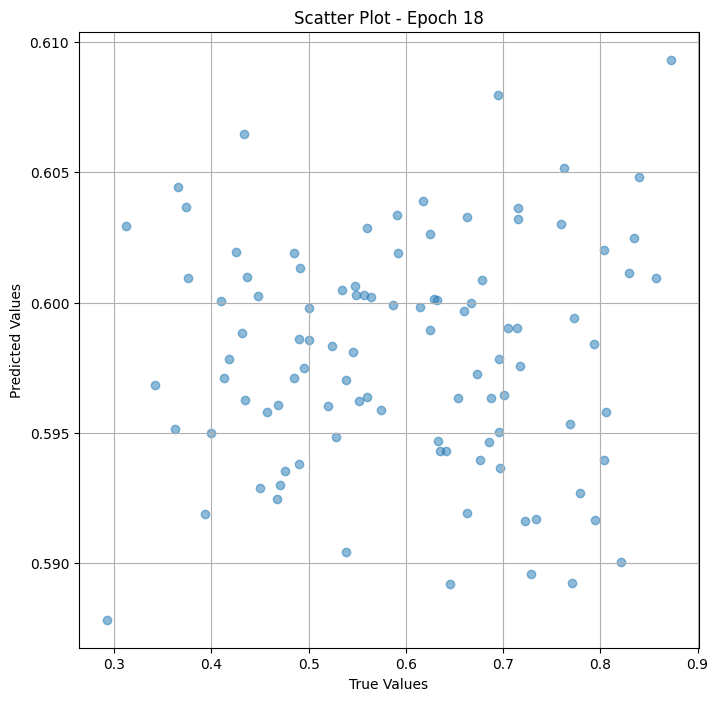

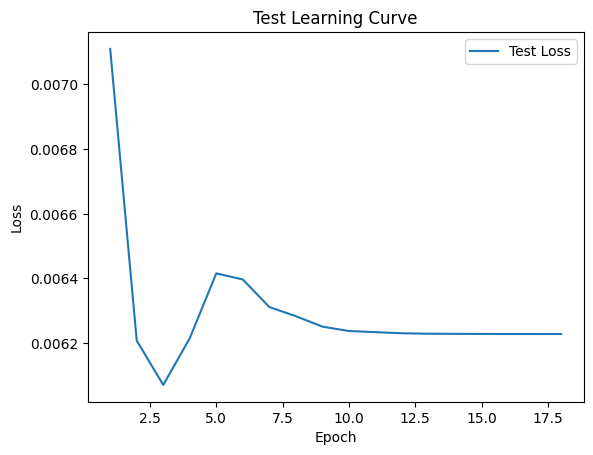


 Epoch: (19/50) Loss = 0.006228274665772915

 Epoch: (19/50) Loss_rmse = 0.078919418156147

 Epoch: (19/50) R^2 = -0.0053414106369018555

 Epoch: (19/50) MAE = 0.06857306510210037
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

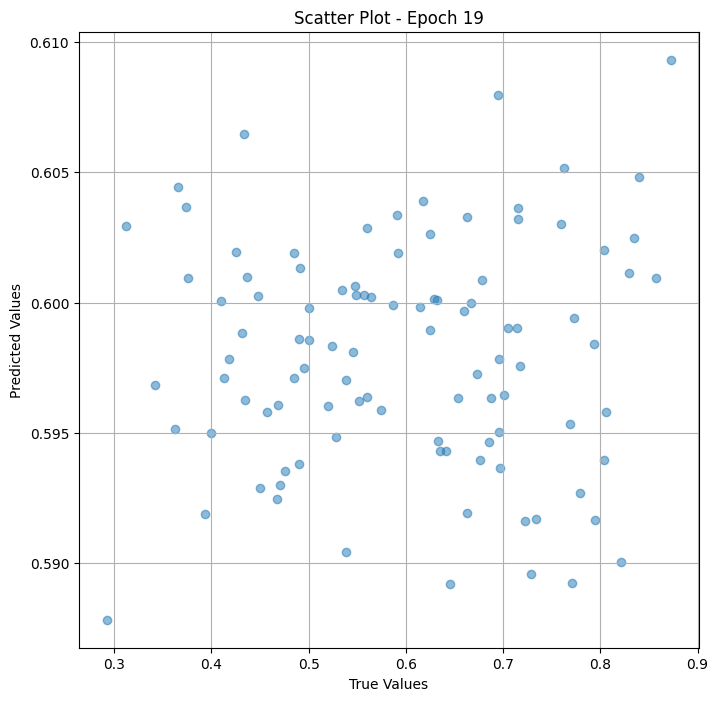

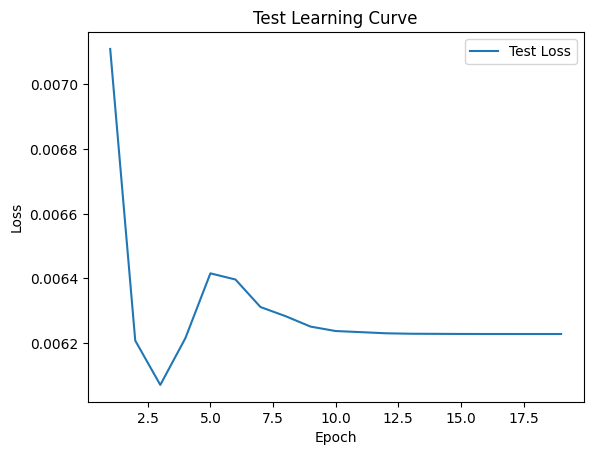


 Epoch: (20/50) Loss = 0.006228257901966572

 Epoch: (20/50) Loss_rmse = 0.07891931384801865

 Epoch: (20/50) R^2 = -0.005338788032531738

 Epoch: (20/50) MAE = 0.06857308000326157
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

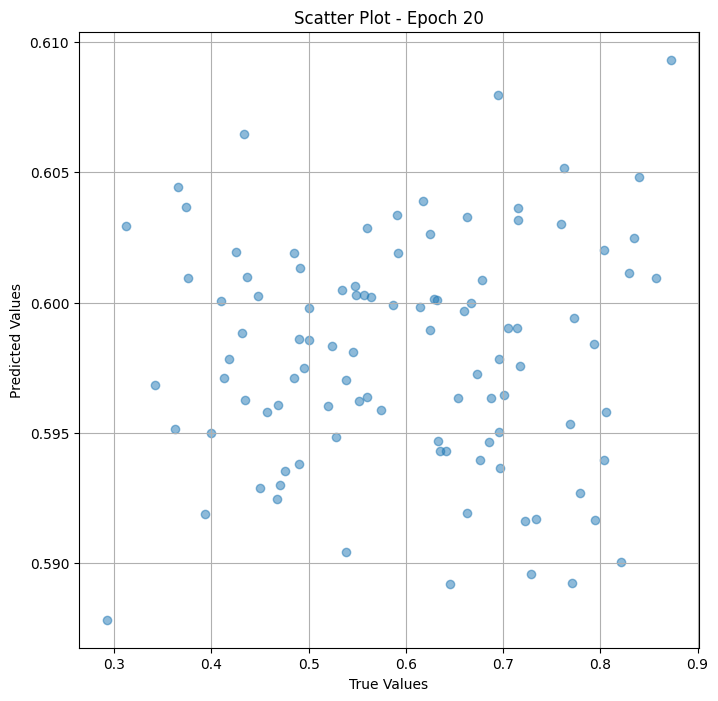

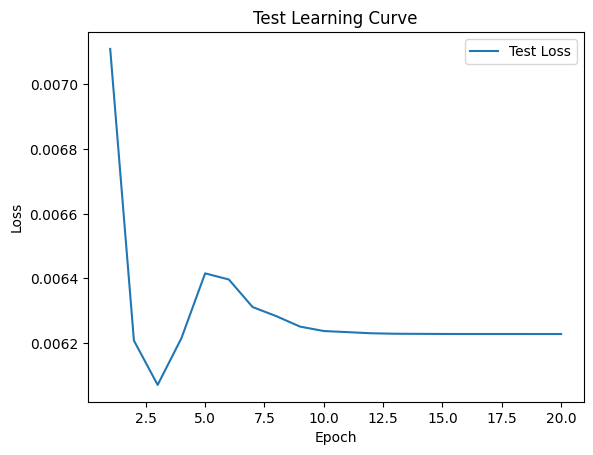


 Epoch: (21/50) Loss = 0.0062282332219183445

 Epoch: (21/50) Loss_rmse = 0.07891915738582611

 Epoch: (21/50) R^2 = -0.005334734916687012

 Epoch: (21/50) MAE = 0.06857305020093918
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0

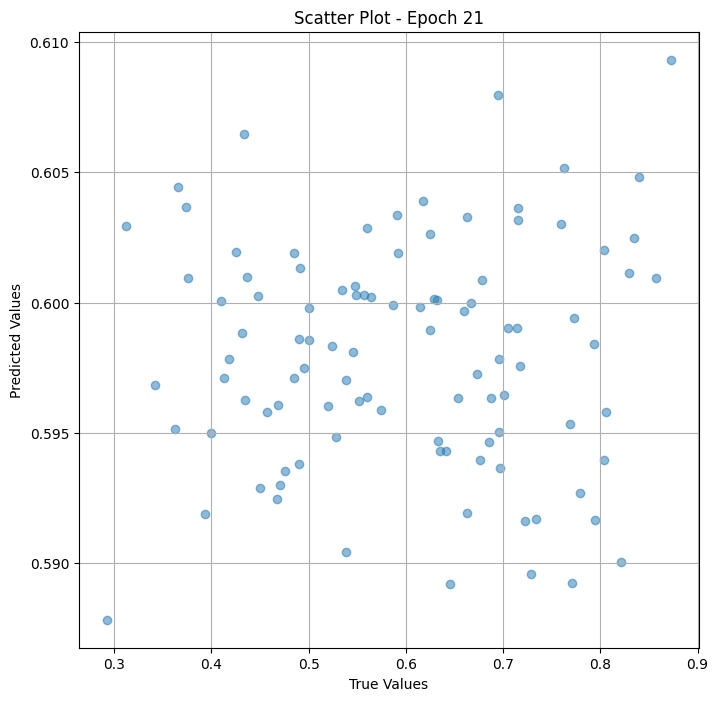

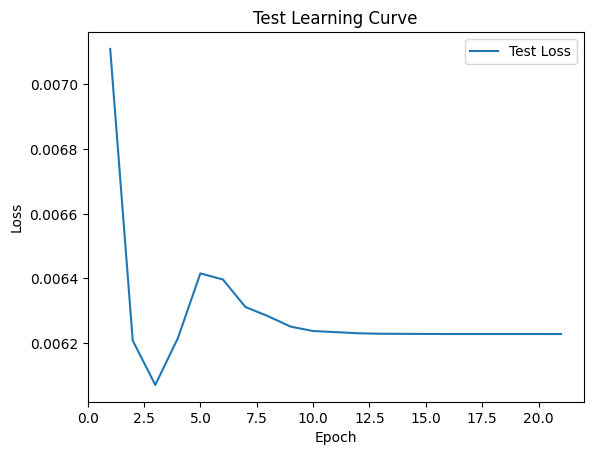


 Epoch: (22/50) Loss = 0.006228214595466852

 Epoch: (22/50) Loss_rmse = 0.07891903817653656

 Epoch: (22/50) R^2 = -0.005331754684448242

 Epoch: (22/50) MAE = 0.06857306510210037
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

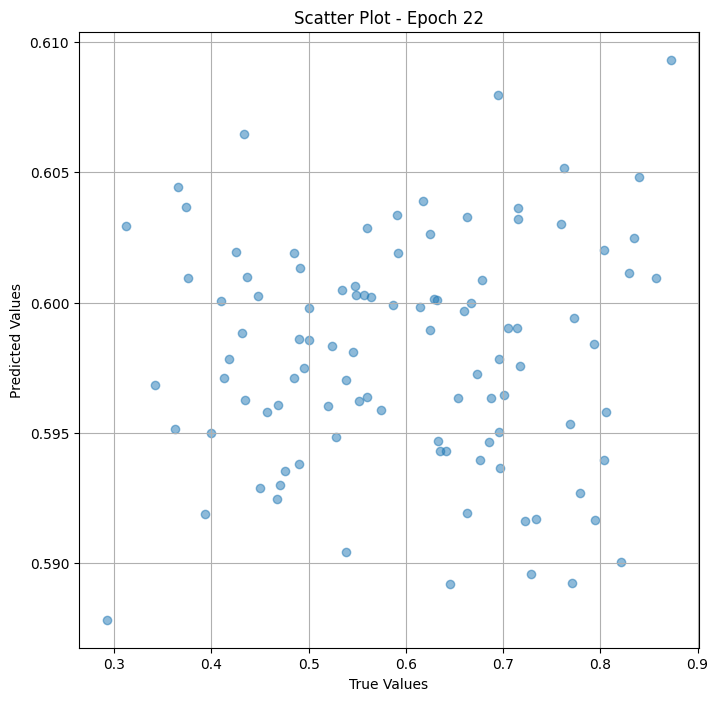

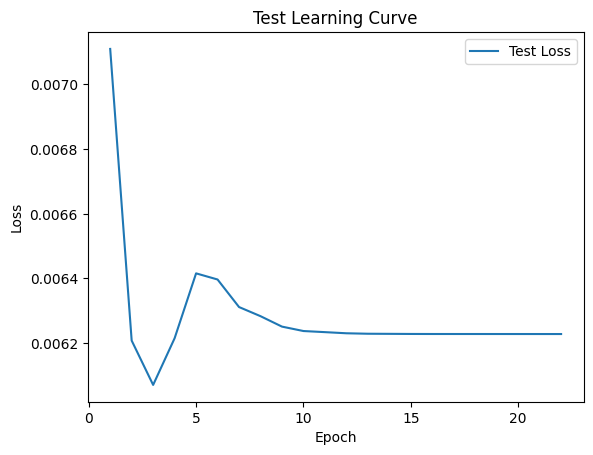


 Epoch: (23/50) Loss = 0.006228194572031498

 Epoch: (23/50) Loss_rmse = 0.07891891151666641

 Epoch: (23/50) R^2 = -0.005328536033630371

 Epoch: (23/50) MAE = 0.06857303529977798
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

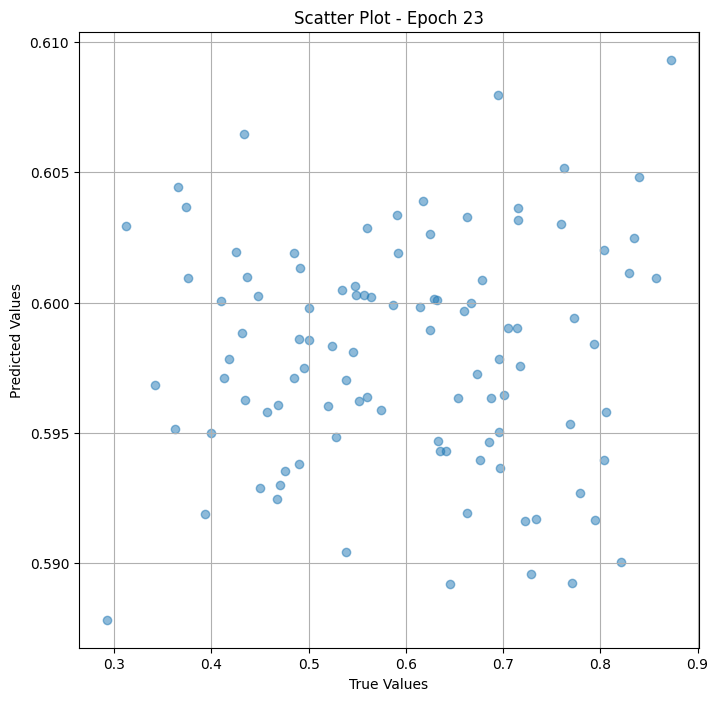

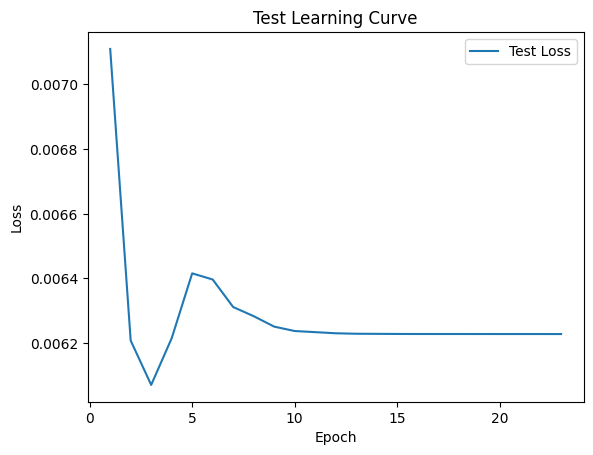


 Epoch: (24/50) Loss = 0.006228169891983271

 Epoch: (24/50) Loss_rmse = 0.07891875505447388

 Epoch: (24/50) R^2 = -0.0053244829177856445

 Epoch: (24/50) MAE = 0.0685730054974556
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

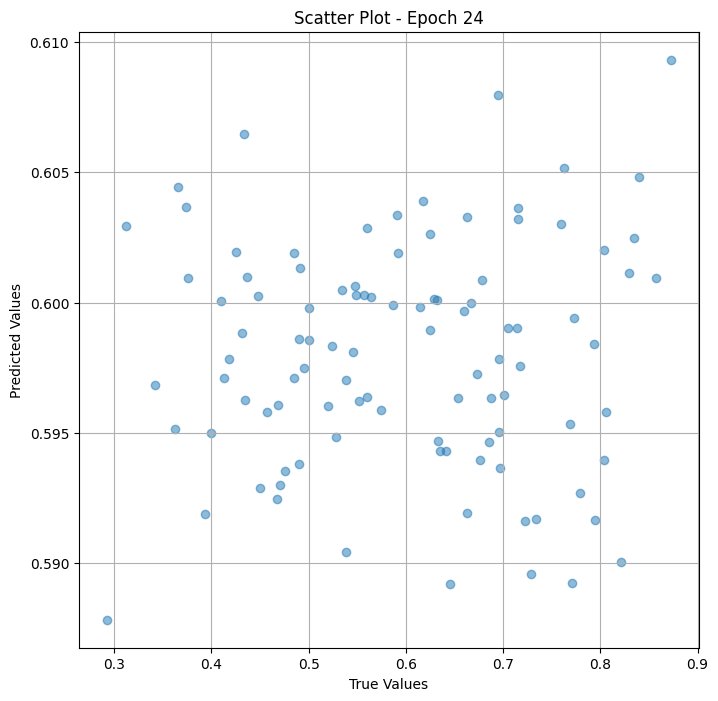

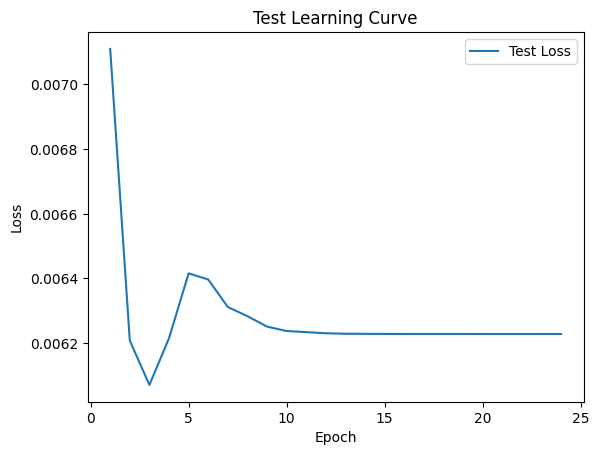


 Epoch: (25/50) Loss = 0.006228148937225342

 Epoch: (25/50) Loss_rmse = 0.07891862094402313

 Epoch: (25/50) R^2 = -0.005321145057678223

 Epoch: (25/50) MAE = 0.0685730054974556
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

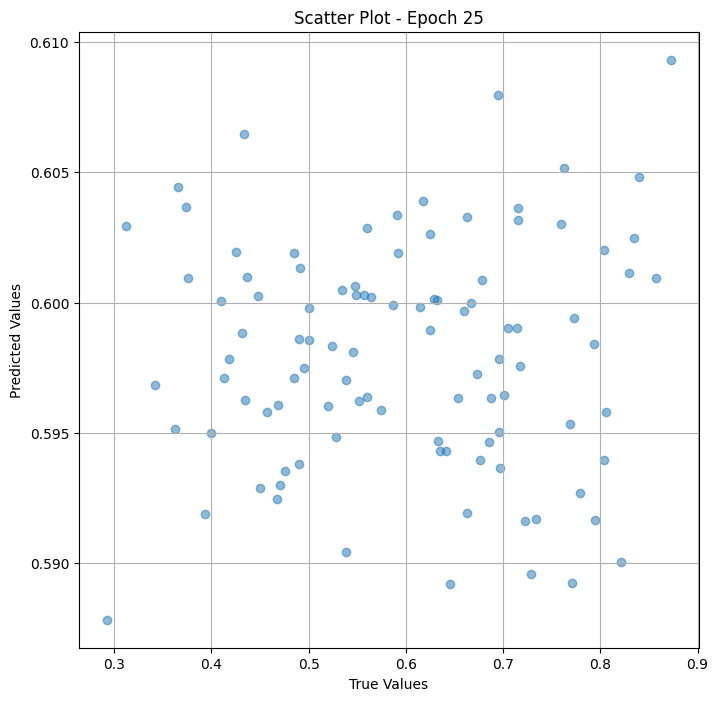

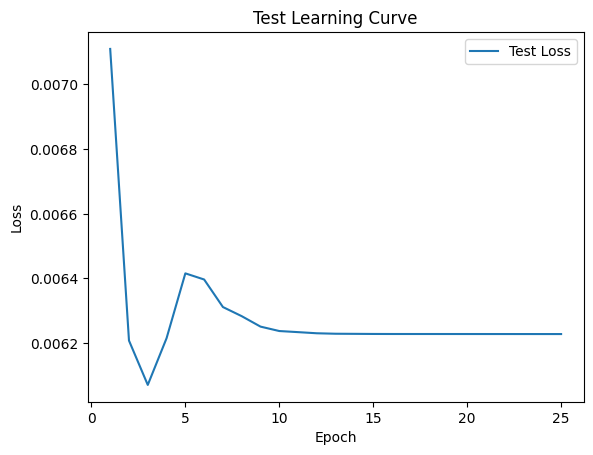


 Epoch: (26/50) Loss = 0.0062281242571771145

 Epoch: (26/50) Loss_rmse = 0.0789184644818306

 Epoch: (26/50) R^2 = -0.005317211151123047

 Epoch: (26/50) MAE = 0.06857297569513321
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

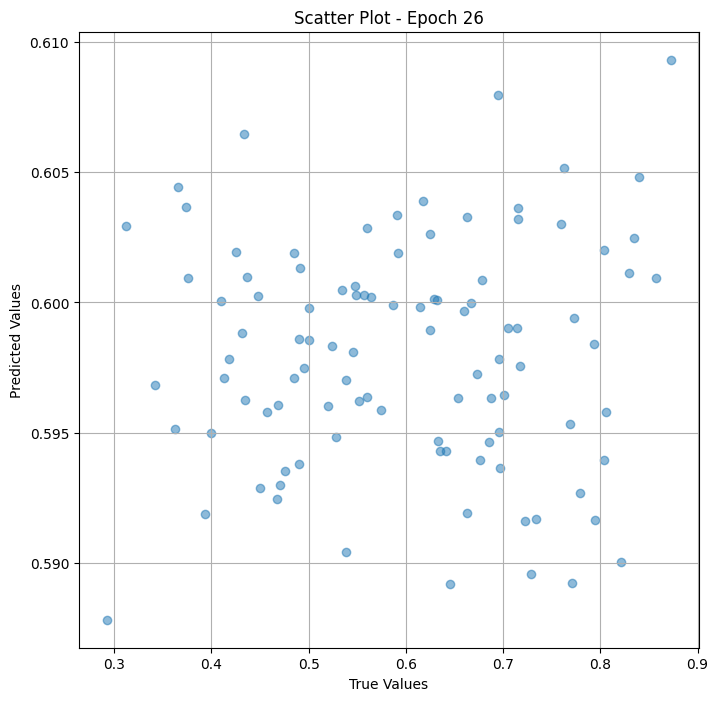

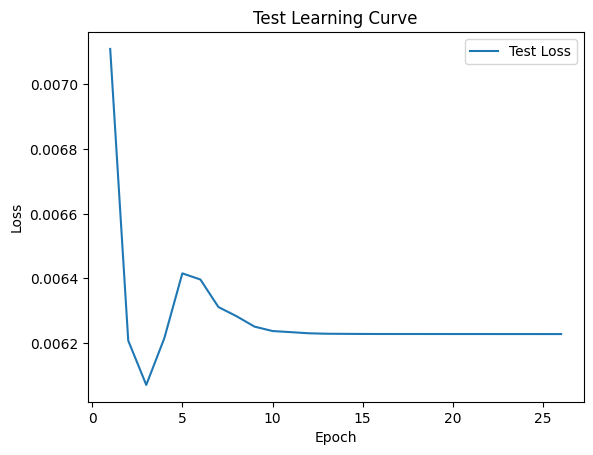


 Epoch: (27/50) Loss = 0.006228101439774036

 Epoch: (27/50) Loss_rmse = 0.07891832292079926

 Epoch: (27/50) R^2 = -0.005313515663146973

 Epoch: (27/50) MAE = 0.06857296079397202
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

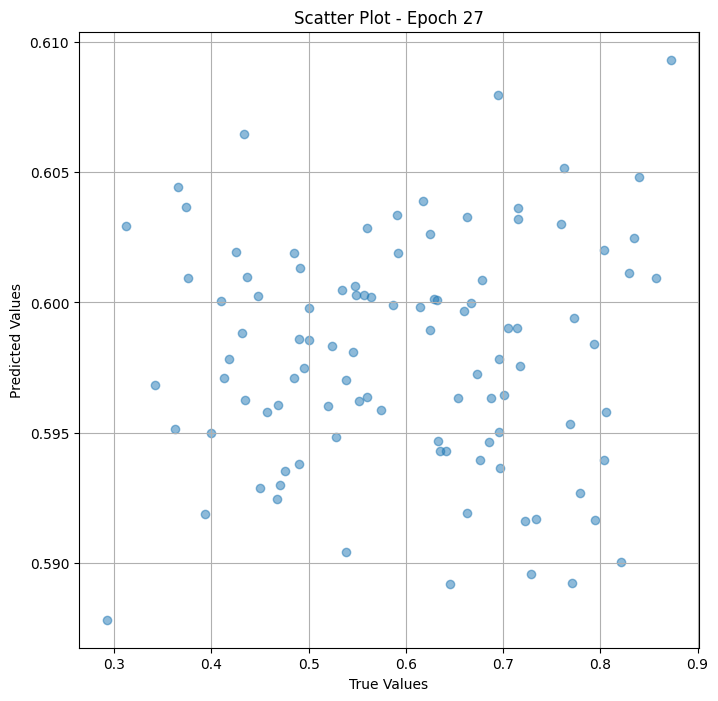

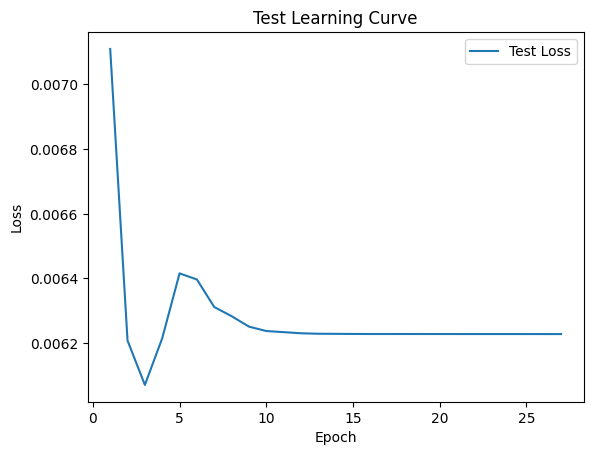


 Epoch: (28/50) Loss = 0.006228082813322544

 Epoch: (28/50) Loss_rmse = 0.0789182037115097

 Epoch: (28/50) R^2 = -0.005310535430908203

 Epoch: (28/50) MAE = 0.06857297569513321
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

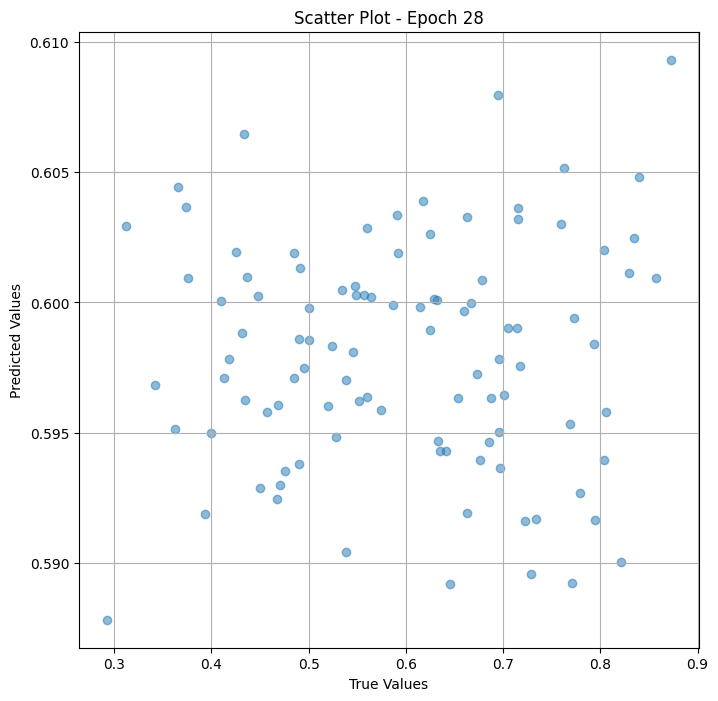

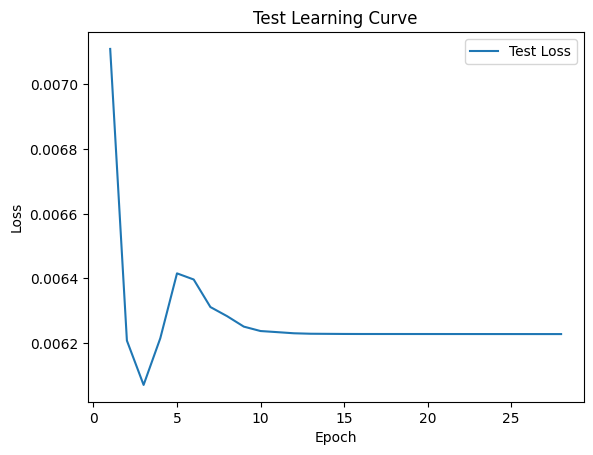


 Epoch: (29/50) Loss = 0.0062280576676130295

 Epoch: (29/50) Loss_rmse = 0.07891804724931717

 Epoch: (29/50) R^2 = -0.0053064823150634766

 Epoch: (29/50) MAE = 0.06857296079397202
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 

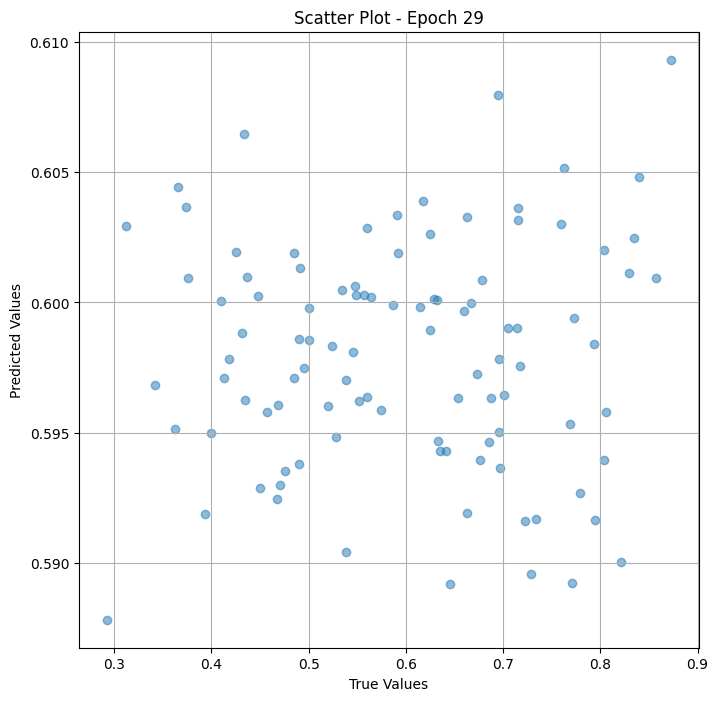

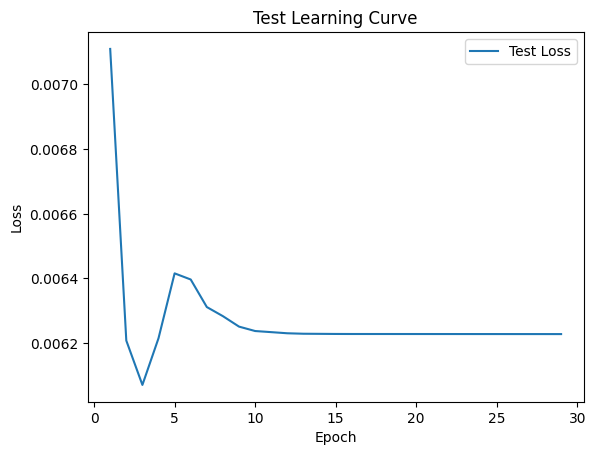


 Epoch: (30/50) Loss = 0.006228035315871239

 Epoch: (30/50) Loss_rmse = 0.07891790568828583

 Epoch: (30/50) R^2 = -0.005302786827087402

 Epoch: (30/50) MAE = 0.06857294589281082
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

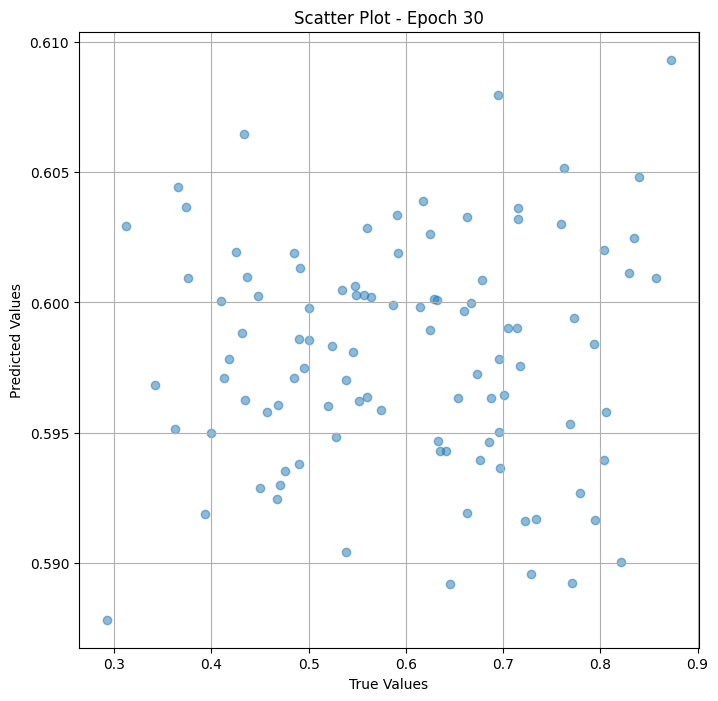

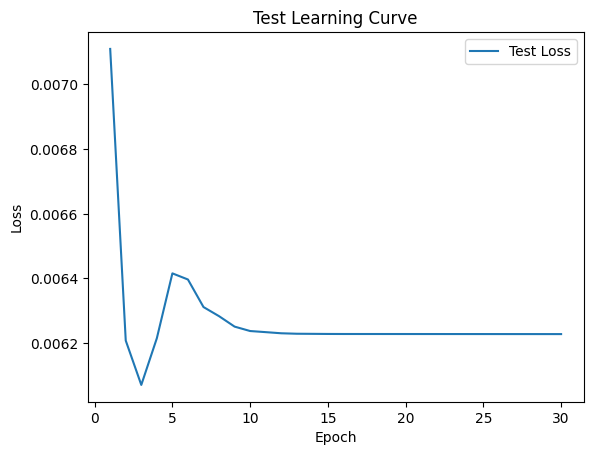


 Epoch: (31/50) Loss = 0.006228011101484299

 Epoch: (31/50) Loss_rmse = 0.07891774922609329

 Epoch: (31/50) R^2 = -0.0052988529205322266

 Epoch: (31/50) MAE = 0.06857293099164963
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0

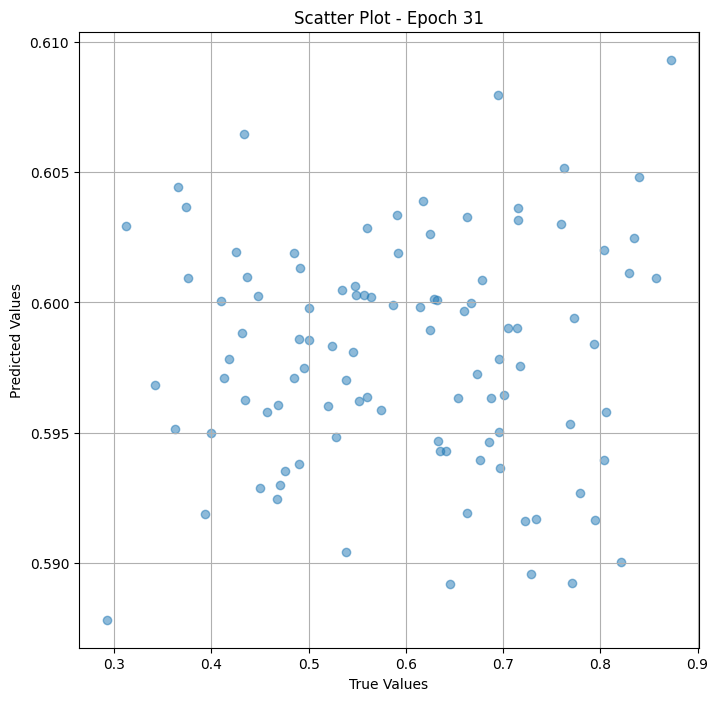

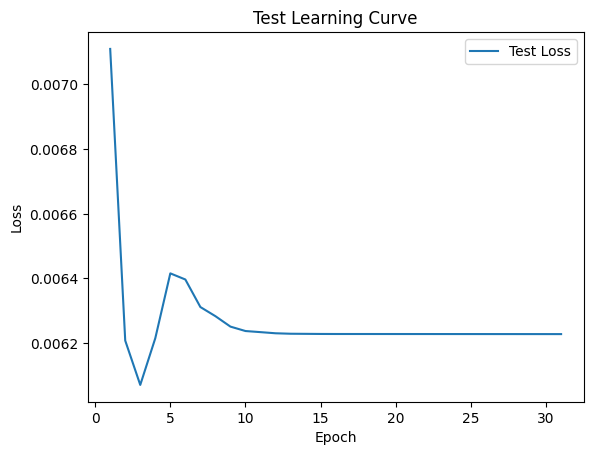


 Epoch: (32/50) Loss = 0.006227989215403795

 Epoch: (32/50) Loss_rmse = 0.07891760766506195

 Epoch: (32/50) R^2 = -0.005295395851135254

 Epoch: (32/50) MAE = 0.06857293099164963
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

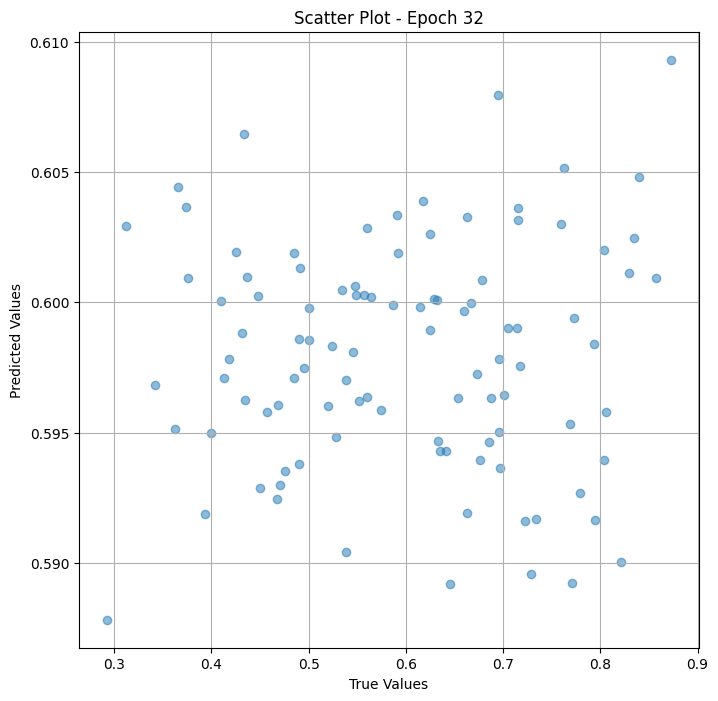

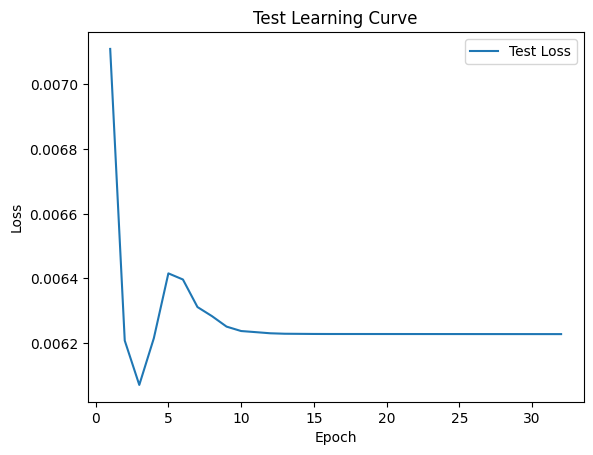


 Epoch: (33/50) Loss = 0.006227962207049131

 Epoch: (33/50) Loss_rmse = 0.07891743630170822

 Epoch: (33/50) R^2 = -0.005290985107421875

 Epoch: (33/50) MAE = 0.06857290118932724
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

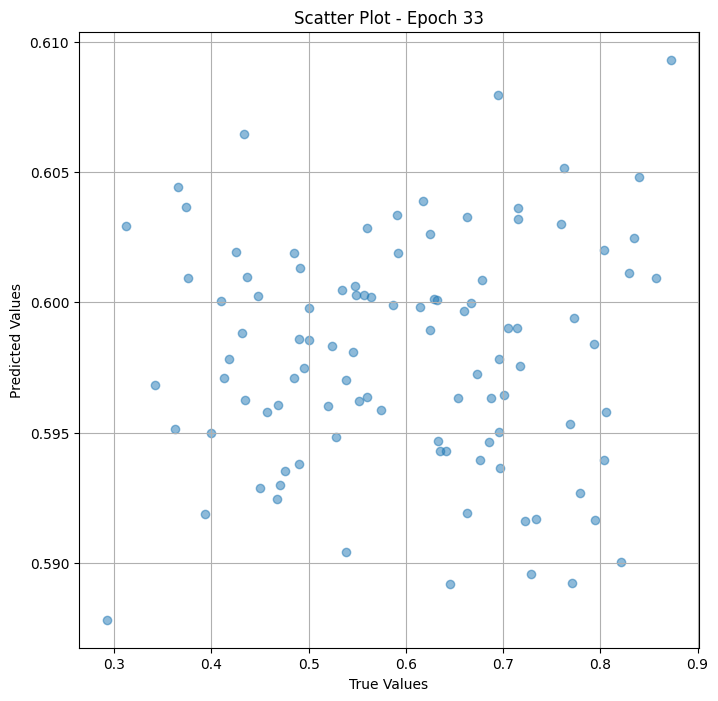

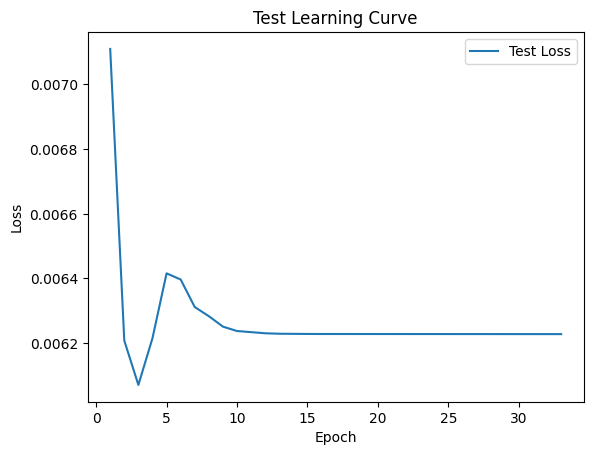


 Epoch: (34/50) Loss = 0.006227939855307341

 Epoch: (34/50) Loss_rmse = 0.07891729474067688

 Epoch: (34/50) R^2 = -0.0052874088287353516

 Epoch: (34/50) MAE = 0.06857290118932724
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0

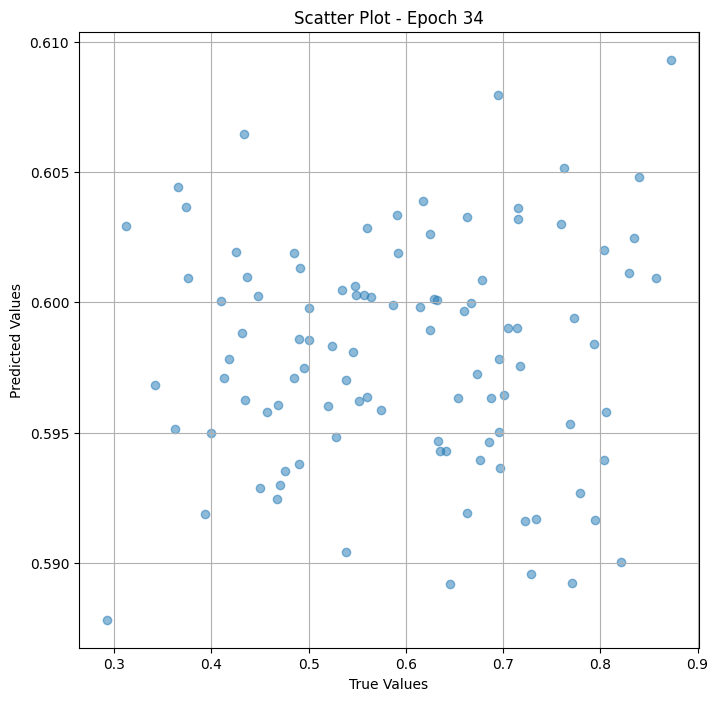

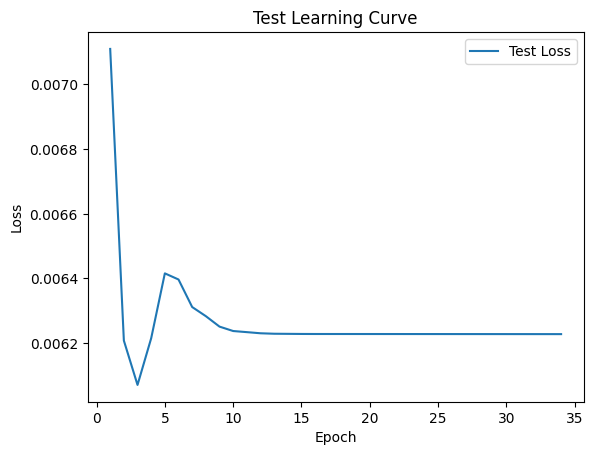


 Epoch: (35/50) Loss = 0.0062279170379042625

 Epoch: (35/50) Loss_rmse = 0.07891715317964554

 Epoch: (35/50) R^2 = -0.005283713340759277

 Epoch: (35/50) MAE = 0.06857290118932724
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0

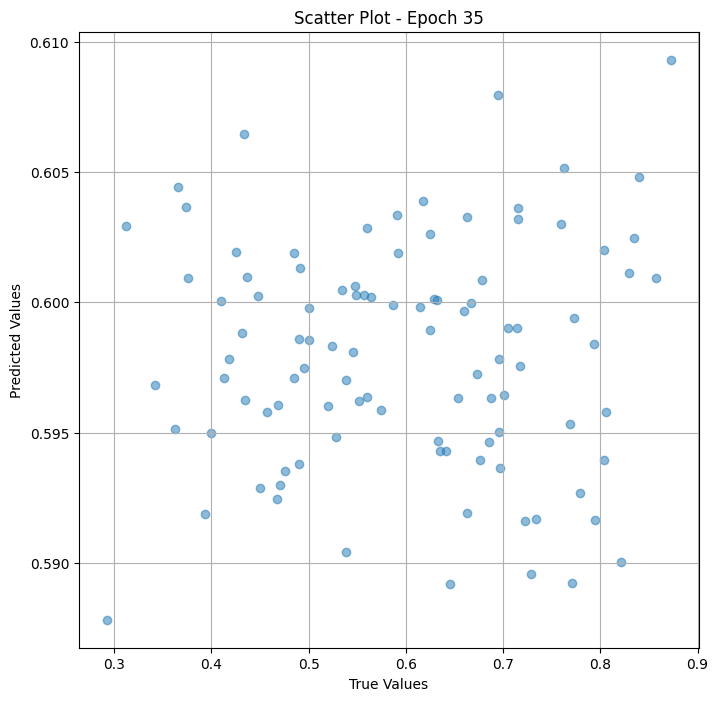

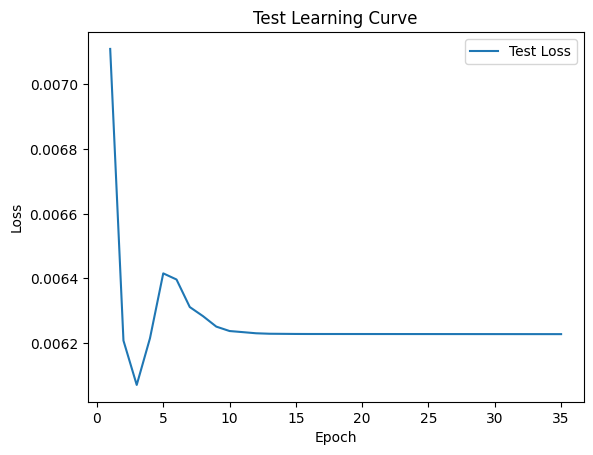


 Epoch: (36/50) Loss = 0.006227895617485046

 Epoch: (36/50) Loss_rmse = 0.0789170190691948

 Epoch: (36/50) R^2 = -0.005280256271362305

 Epoch: (36/50) MAE = 0.06857290118932724
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

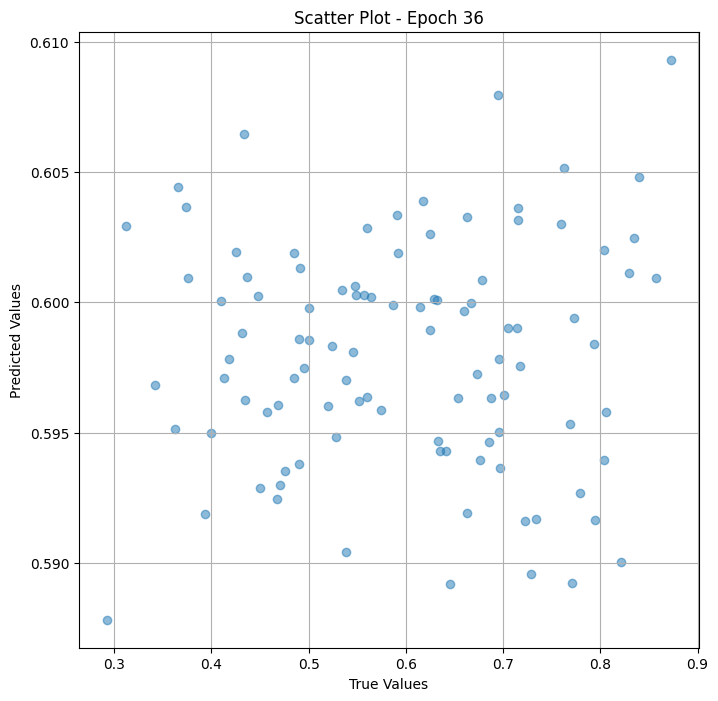

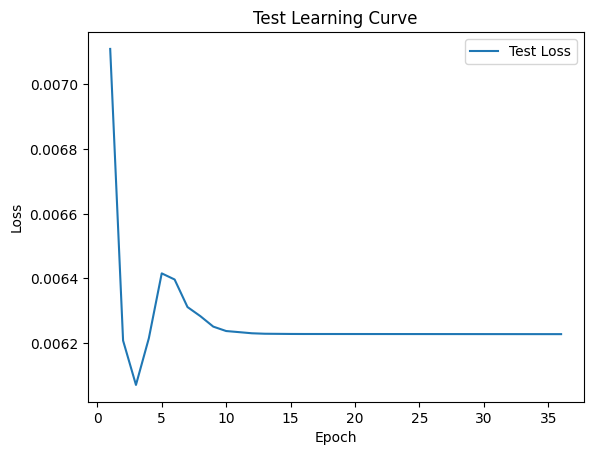


 Epoch: (37/50) Loss = 0.006227867212146521

 Epoch: (37/50) Loss_rmse = 0.07891684025526047

 Epoch: (37/50) R^2 = -0.005275726318359375

 Epoch: (37/50) MAE = 0.06857287138700485
Spearman correlation coefficient: SignificanceResult(statistic=-0.005615919912227818, pvalue=0.9566928210047412)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

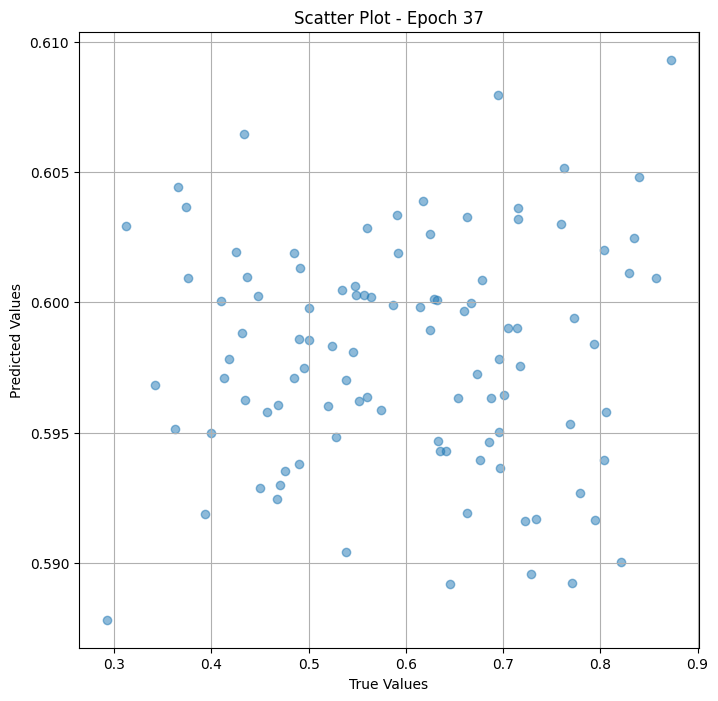

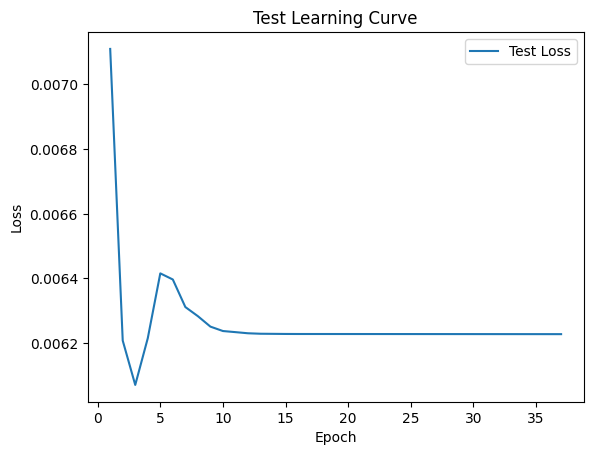


 Epoch: (38/50) Loss = 0.006227837409824133

 Epoch: (38/50) Loss_rmse = 0.07891664654016495

 Epoch: (38/50) R^2 = -0.005270838737487793

 Epoch: (38/50) MAE = 0.06857284158468246
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

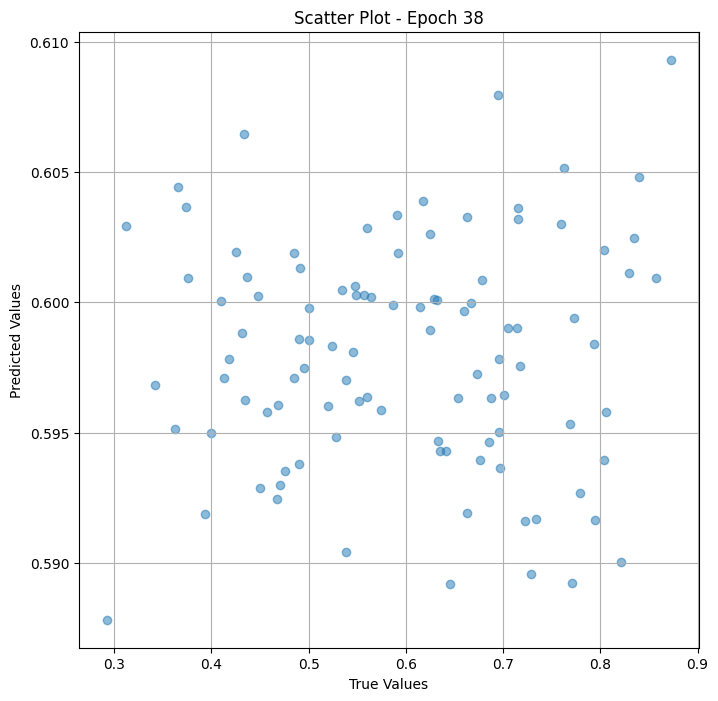

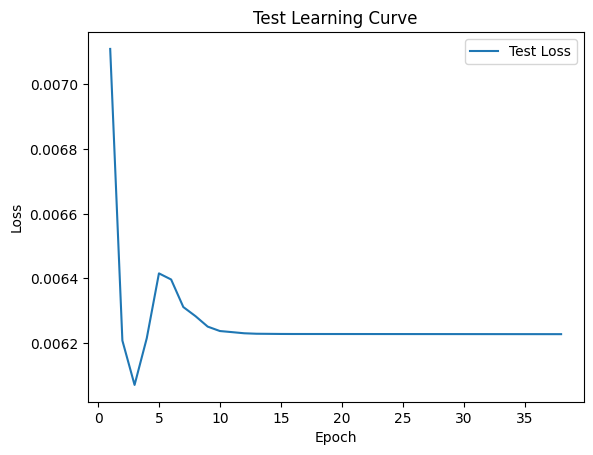


 Epoch: (39/50) Loss = 0.006227809004485607

 Epoch: (39/50) Loss_rmse = 0.07891646772623062

 Epoch: (39/50) R^2 = -0.005266308784484863

 Epoch: (39/50) MAE = 0.06857279688119888
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

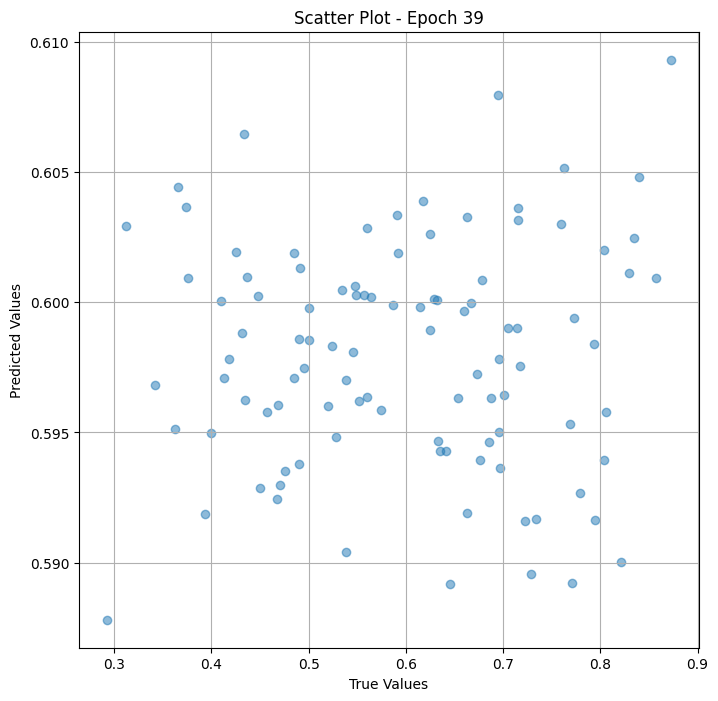

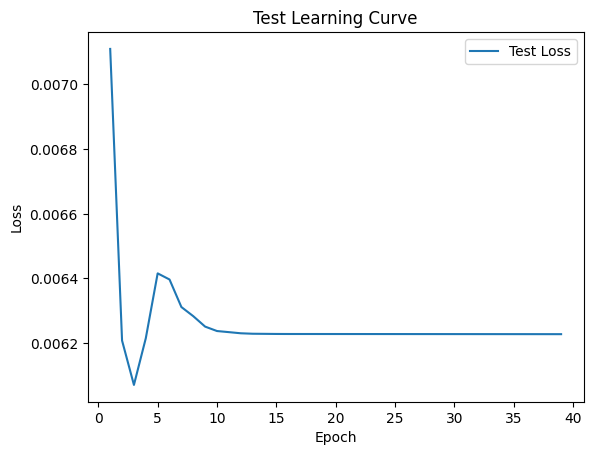


 Epoch: (40/50) Loss = 0.00622778944671154

 Epoch: (40/50) Loss_rmse = 0.07891634106636047

 Epoch: (40/50) R^2 = -0.005263090133666992

 Epoch: (40/50) MAE = 0.06857284158468246
Spearman correlation coefficient: SignificanceResult(statistic=-0.005615919912227818, pvalue=0.9566928210047412)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.51

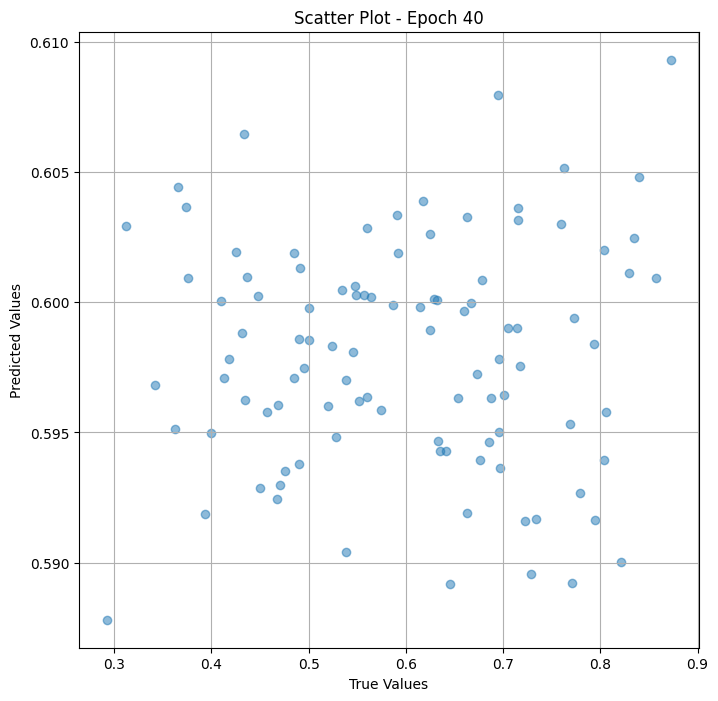

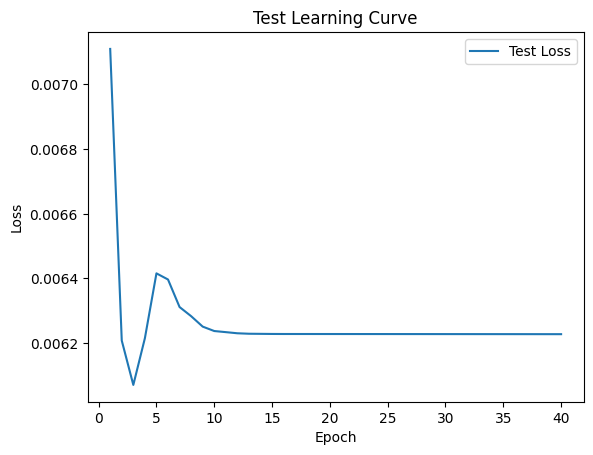


 Epoch: (41/50) Loss = 0.006227757316082716

 Epoch: (41/50) Loss_rmse = 0.07891613990068436

 Epoch: (41/50) R^2 = -0.005257964134216309

 Epoch: (41/50) MAE = 0.06857278198003769
Spearman correlation coefficient: SignificanceResult(statistic=-0.005615919912227818, pvalue=0.9566928210047412)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

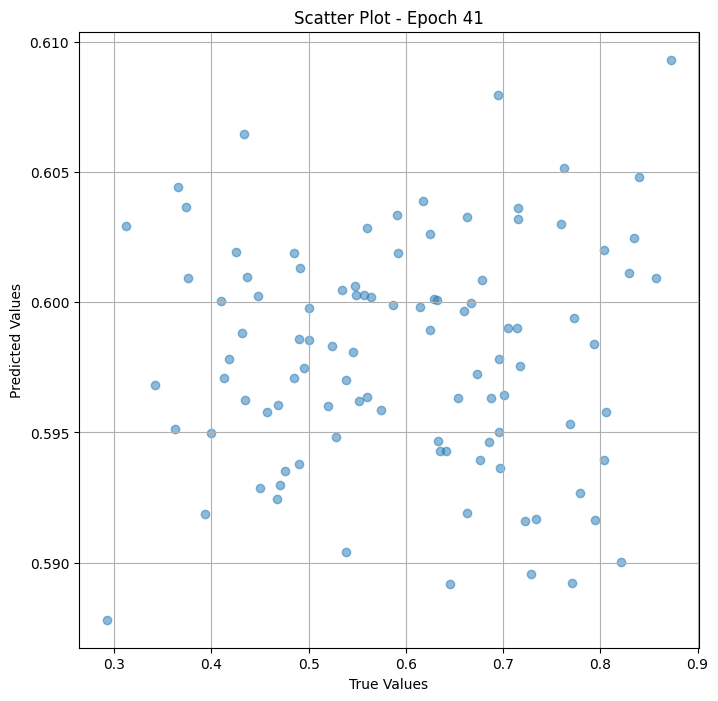

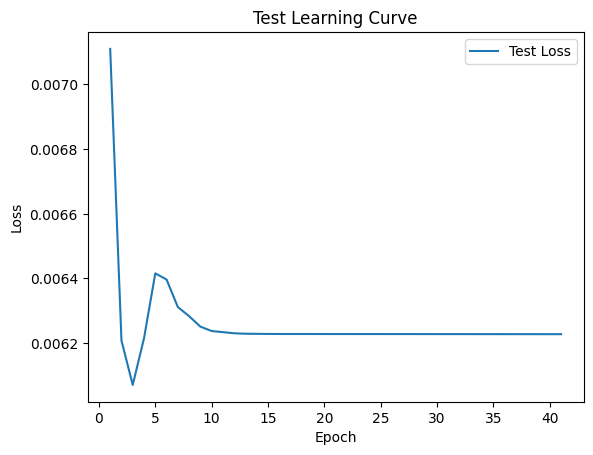


 Epoch: (42/50) Loss = 0.0062277354300022125

 Epoch: (42/50) Loss_rmse = 0.07891600579023361

 Epoch: (42/50) R^2 = -0.005254387855529785

 Epoch: (42/50) MAE = 0.06857278198003769
Spearman correlation coefficient: SignificanceResult(statistic=-0.0062127598968207435, pvalue=0.9520954719836645)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0

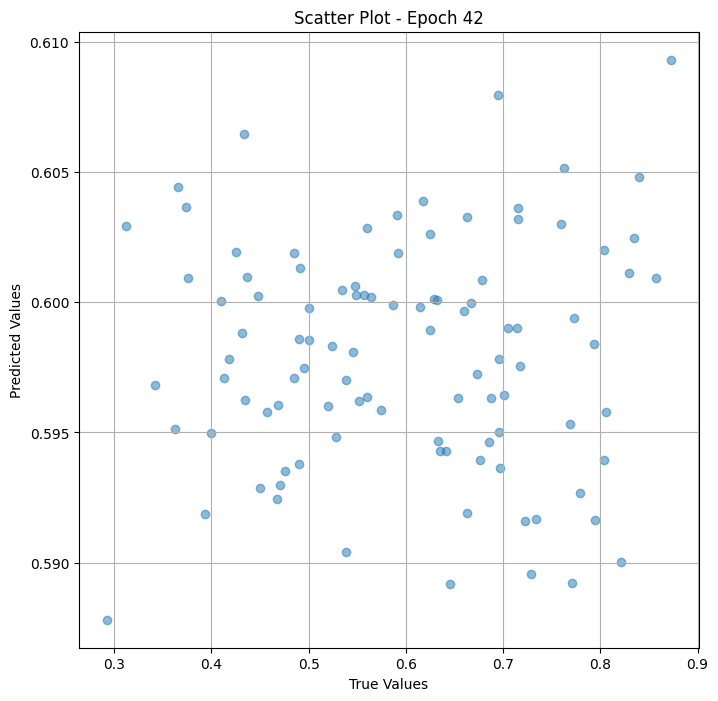

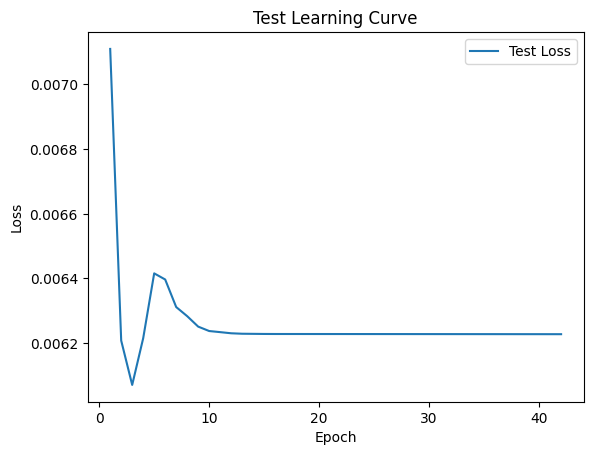


 Epoch: (43/50) Loss = 0.0062277065590023994

 Epoch: (43/50) Loss_rmse = 0.07891581952571869

 Epoch: (43/50) R^2 = -0.005249738693237305

 Epoch: (43/50) MAE = 0.0685727670788765
Spearman correlation coefficient: SignificanceResult(statistic=-0.005615919912227818, pvalue=0.9566928210047412)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

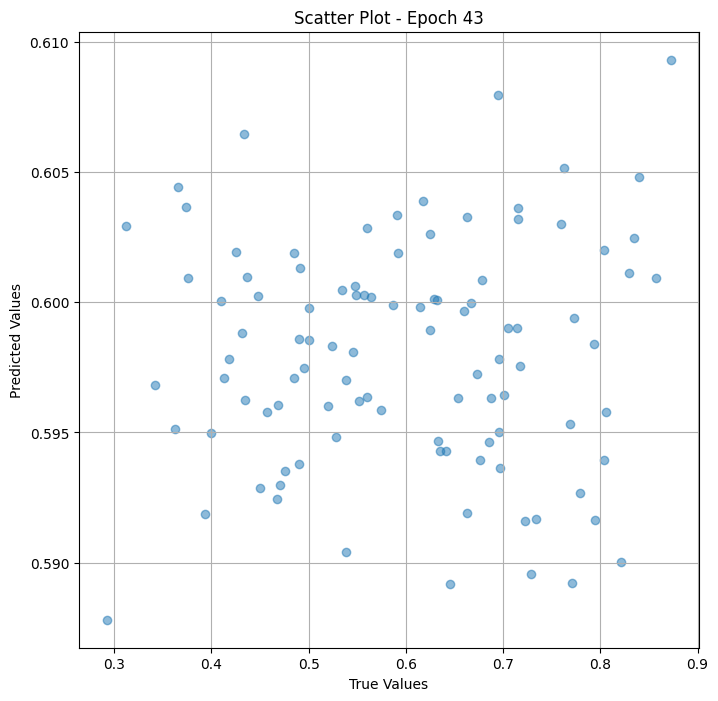

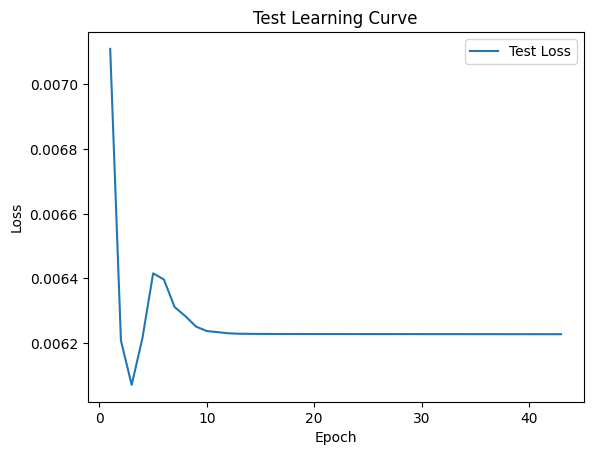


 Epoch: (44/50) Loss = 0.0062276748940348625

 Epoch: (44/50) Loss_rmse = 0.07891561836004257

 Epoch: (44/50) R^2 = -0.005244612693786621

 Epoch: (44/50) MAE = 0.06857272237539291
Spearman correlation coefficient: SignificanceResult(statistic=-0.005615919912227818, pvalue=0.9566928210047412)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

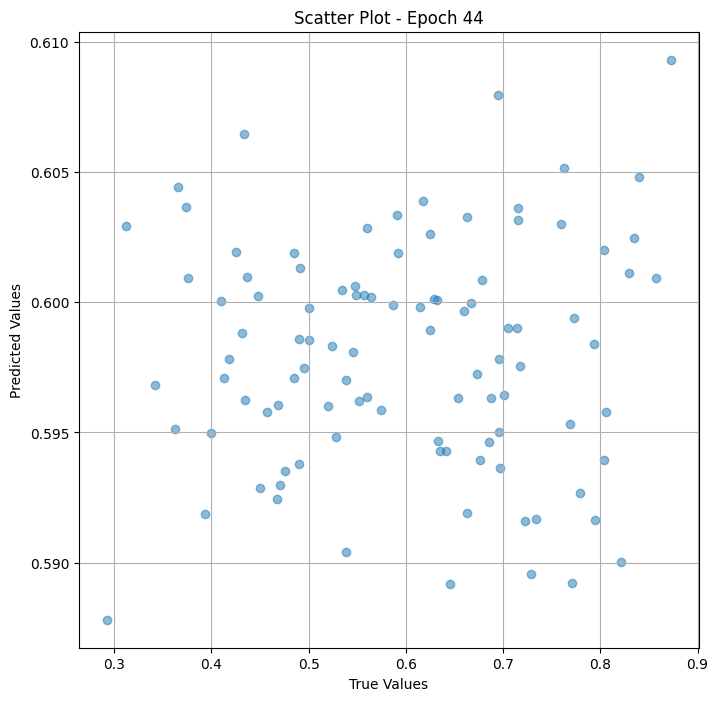

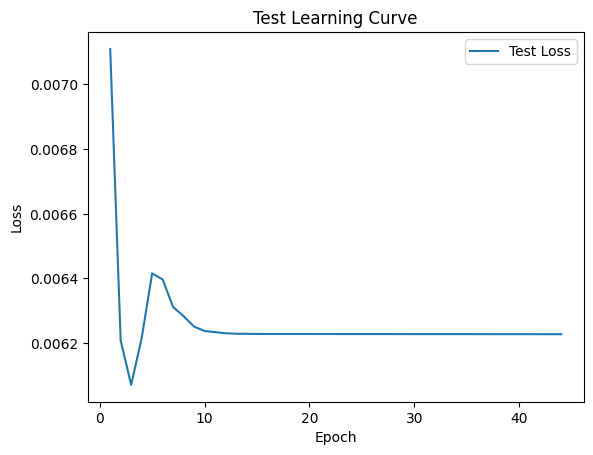


 Epoch: (45/50) Loss = 0.006227649748325348

 Epoch: (45/50) Loss_rmse = 0.07891546189785004

 Epoch: (45/50) R^2 = -0.0052405595779418945

 Epoch: (45/50) MAE = 0.06857272237539291
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

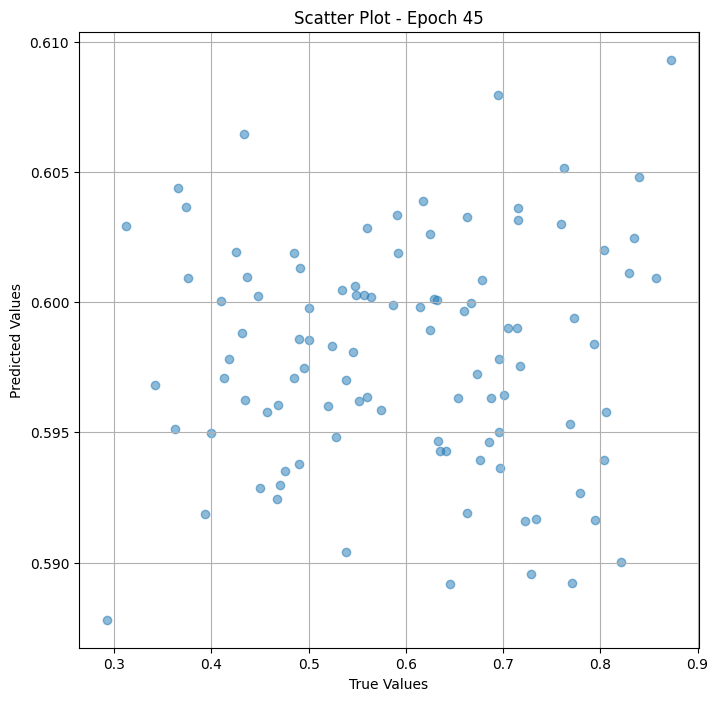

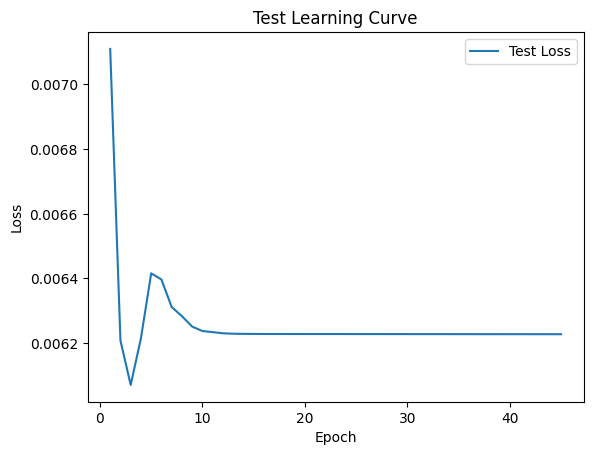


 Epoch: (46/50) Loss = 0.006227622274309397

 Epoch: (46/50) Loss_rmse = 0.07891528308391571

 Epoch: (46/50) R^2 = -0.005236148834228516

 Epoch: (46/50) MAE = 0.06857270747423172
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

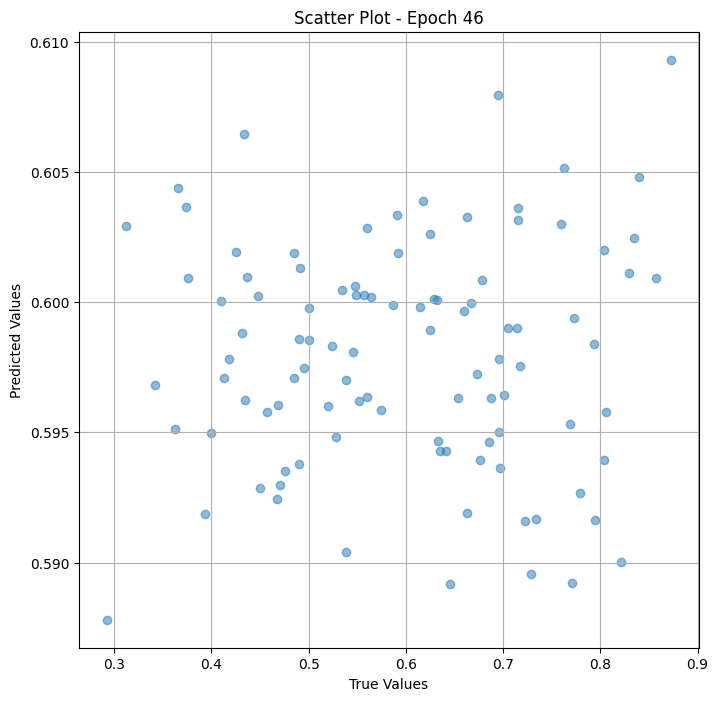

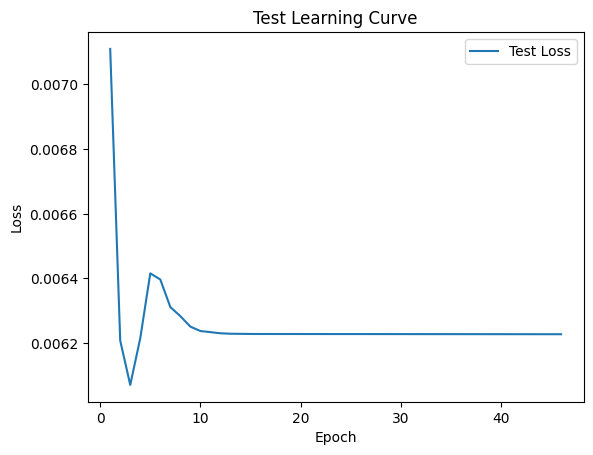


 Epoch: (47/50) Loss = 0.006227588281035423

 Epoch: (47/50) Loss_rmse = 0.0789150670170784

 Epoch: (47/50) R^2 = -0.00523066520690918

 Epoch: (47/50) MAE = 0.06857266277074814
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.519

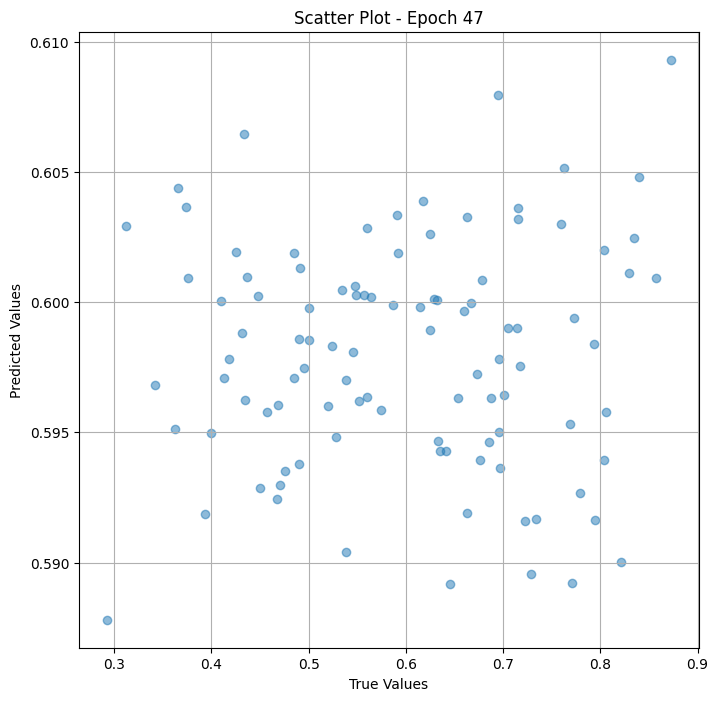

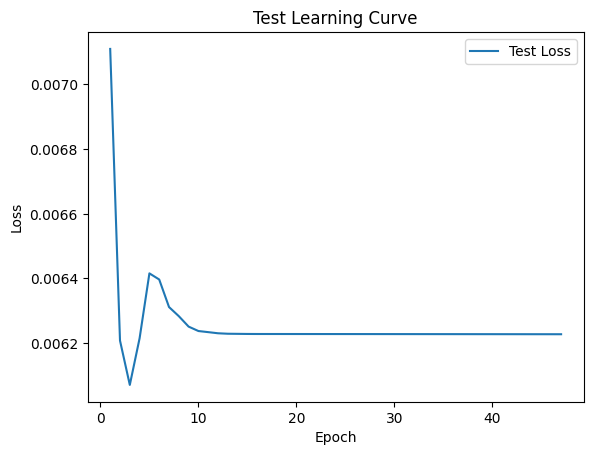


 Epoch: (48/50) Loss = 0.006227566860616207

 Epoch: (48/50) Loss_rmse = 0.07891493290662766

 Epoch: (48/50) R^2 = -0.005227208137512207

 Epoch: (48/50) MAE = 0.06857267767190933
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

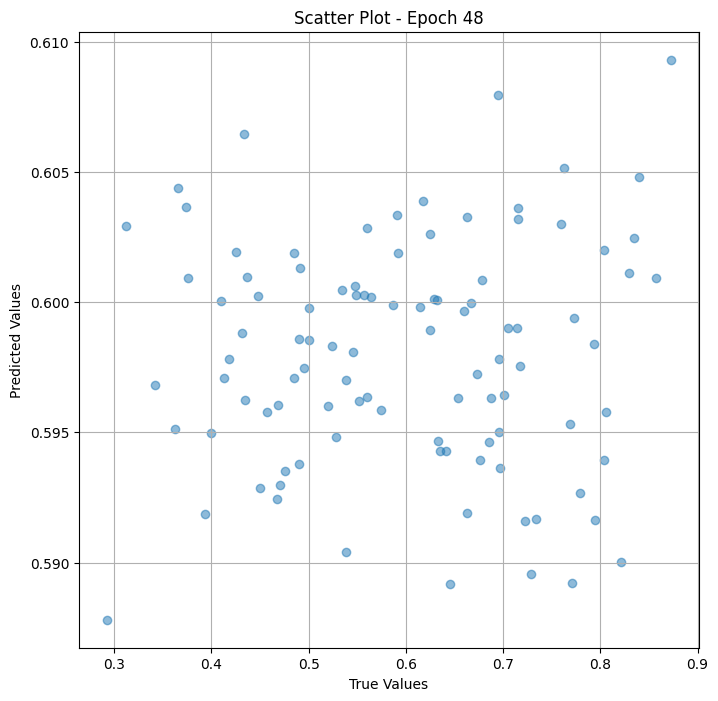

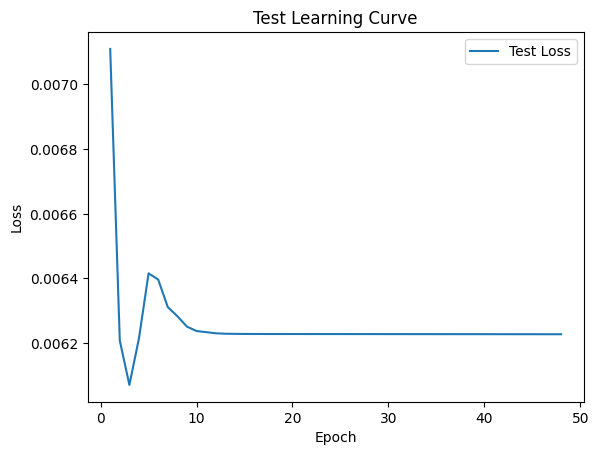


 Epoch: (49/50) Loss = 0.006227534729987383

 Epoch: (49/50) Loss_rmse = 0.07891473174095154

 Epoch: (49/50) R^2 = -0.005221962928771973

 Epoch: (49/50) MAE = 0.06857264786958694
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.5

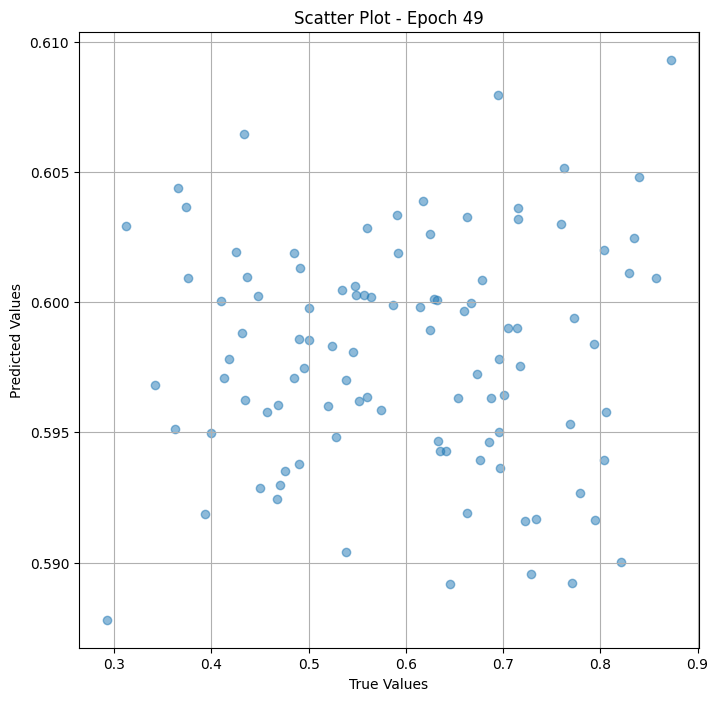

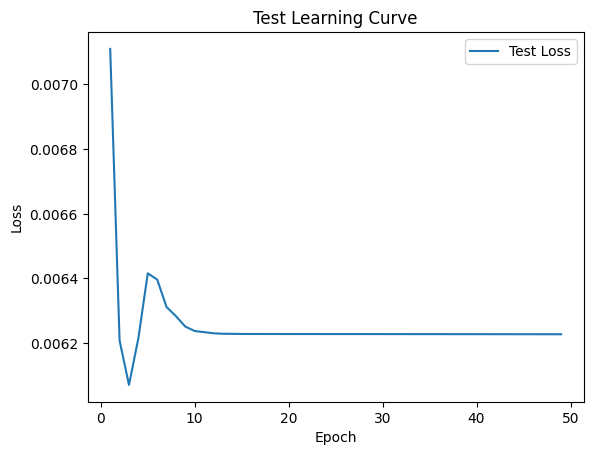


 Epoch: (50/50) Loss = 0.0062275053933262825

 Epoch: (50/50) Loss_rmse = 0.07891454547643661

 Epoch: (50/50) R^2 = -0.005217313766479492

 Epoch: (50/50) MAE = 0.06857261806726456
Spearman correlation coefficient: SignificanceResult(statistic=-0.005019041838042959, pvalue=0.9612918814818514)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.56435645, 0.8041237, 0.6952381, 0.31182796, 0.54545456, 0.7938144, 0.5283019, 0.6315789, 0.7941176, 0.559633, 0.69473684, 0.7047619, 0.5480769, 0.5568182, 0.5869565, 0.6631579, 0.6632653, 0.45, 0.6666667, 0.7592593, 0.7008547, 0.53846157, 0.49, 0.4848485, 0.76237625, 0.73333335, 0.7733333, 0.4903846, 0.7157895, 0.87234044, 0.49107143, 0.72839504, 0.6960784, 0.43137255, 0.4848485, 0.8292683, 0.4329897, 0.6785714, 0.85714287, 0.37391305, 0.29268292, 0.8396226, 0.5904762, 0.625, 0.47524753, 0.6413044, 0.63461536, 0.71568626, 0.7787611, 0.5, 0.36263737, 0.6597938, 0.71428573, 0.49514562, 0.46875, 0.7222222, 0.

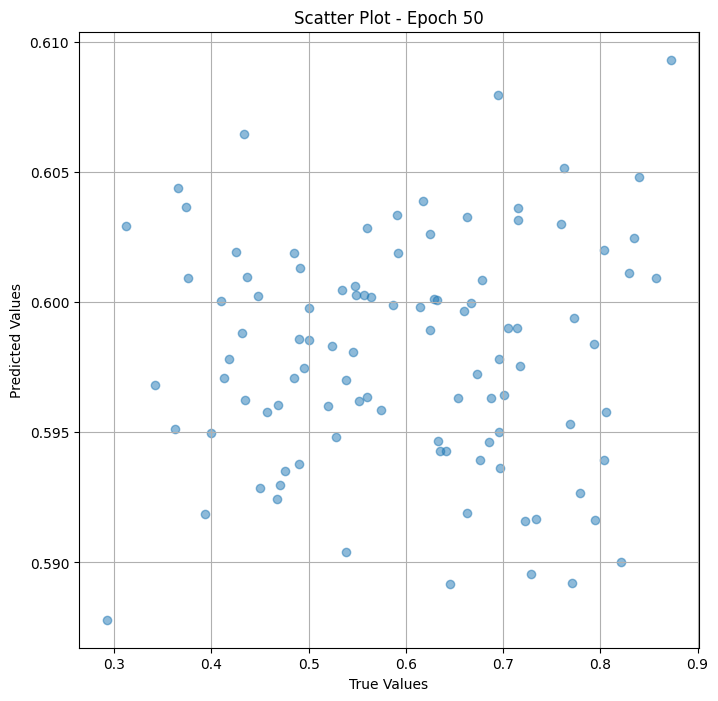

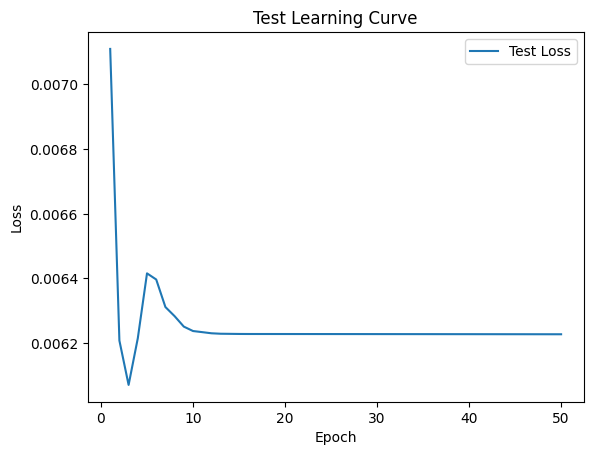

In [ ]:
# val the model and save weights
fit(50, model_vit_test , test_dl )
torch.save(model_vit_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_vit_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_vehicle' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result_fine = pd.DataFrame({
    'Image Path': df_test_landscape['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result_fine)

                                           Image Path  True Value  \
0   /content/landscape/n09415671_14500_preprocesse...    0.564356   
1   /content/landscape/n09472597_32918_preprocesse...    0.804124   
2   /content/landscape/4d8d416b795f90cc_preprocess...    0.695238   
3   /content/landscape/sun_avqahgdnxxemgnje_prepro...    0.311828   
4   /content/landscape/sun_bzbsfohnoxeimmzi_prepro...    0.545455   
..                                                ...         ...   
95  /content/landscape/n09359803_42842_preprocesse...    0.376344   
96  /content/landscape/n09415671_6622_preprocessed...    0.551724   
97  /content/landscape/n09468604_15189_preprocesse...    0.625000   
98  /content/landscape/n09421951_10110_preprocesse...    0.467290   
99  /content/landscape/n09415671_19975_preprocesse...    0.676191   

    Predicted Value  
0          0.566922  
1          0.588831  
2          0.587763  
3          0.572450  
4          0.627130  
..              ...  
95         0.5729

# ทดสอบกับรูปอื่นๆ

In [ ]:
model = ViTMem_model_test_()
image = Image.open("/content/animal/000000002066.jpg")

# Define preprocessing transforms
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to match the input size expected by the model
    transforms.ToTensor(),           # Convert to a PyTorch tensor
    #transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0])  # Normalize the image
])

# Apply preprocessing transforms
input_data = preprocess(image)

# Add batch dimension as the model expects a batch
input_data = input_data.unsqueeze(0)

# Assuming ViTMem_model is a PyTorch model
model = ViTMem_model_test_()
memorability = model(input_data)

print(f"Estimated memorability: {memorability}")



Estimated memorability: tensor([[0.6808]], grad_fn=<SigmoidBackward0>)
